In [2326]:
import os
import fnmatch
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lombscargle
import pandas as pd

data_path = "../data/"

In [309]:
# Photometry data files contain 5 columns: Hel.JD, I magnitude, magnitude error, seeing estimation (in pixels - 0.26"/pixel) and sky level

# save data as csv, merging OGLE III and IV if both are available
sources={}
dir_list = []

# search for photometry data in OGLE IV folder
for root, dirnames, filenames in os.walk(data_path+"/ogle4"):
    for filename in fnmatch.filter(filenames, "phot.dat"):
        source_name = root.split("/")[-1]
        lc_path_4 = os.path.join(root, filename)
        lc_path_3 = os.path.join(root.replace("ogle4", "ogle3"), filename)
        try: # try to merge OGLE III and IV data
            ogle3 = np.loadtxt(lc_path_3, usecols=(0,1,2))
            ogle4 = np.loadtxt(lc_path_4, usecols=(0,1,2))
            data = np.vstack((ogle3, ogle4))
            sources[root.split("/")[-1]] = "{} measurements, start: {} end: {}".format(len(data), data[0][0]-2450000,data[-1][0]-2450000)
            np.savetxt(data_path+"/ogle_merged/{}.csv".format(source_name), data, delimiter=",")
            dir_list.append(source_name)
        except: # if merging doesn't work, save only OGLE IV
            ogle4 = np.loadtxt(lc_path_4, usecols=(0,1,2))
            sources[root.split("/")[-1]] = "{} measurements, start: {} end: {}".format(len(data), data[0][0]-2450000,data[-1][0]-2450000)
            np.savetxt(data_path+"/ogle_merged/{}.csv".format(source_name), ogle4, delimiter=",")
            dir_list.append(source_name)

# save any OGLE III data that does not have an OGLE IV counterpart
for root, dirnames, filenames in os.walk(data_path+"/ogle3"):
    for filename in fnmatch.filter(filenames, "phot.dat"):
        source_name = root.split("/")[-1]
        if source_name not in dir_list:
            lc_path_3 = os.path.join(root, filename)
            ogle3 = np.loadtxt(lc_path_3, usecols=(0,1,2))
            sources[root.split("/")[-1]] = "{} measurements, start: {} end: {}".format(len(data), data[0][0]-2450000,data[-1][0]-2450000)
            np.savetxt(data_path+"/ogle_merged/{}.csv".format(source_name), ogle3, delimiter=",")
            dir_list.append(source_name)

# Get orbital periods

In [378]:
# load Mehtap's table of info for SMC objects with confirmed status
source_info = pd.read_csv("../SMC_confirmed.csv")

# data file names matching sources from Mehtap's table
ordered_file_names = [ 'sxp2.37.csv','','sxp3.34.csv','','sxp6.85.csv' ,'sxp7.78.csv', 'sxp8.80.csv', 'sxp9.13.csv','sxp11.5.csv', 'sxp15.3.csv',
                     '', 'sxp25.5.csv','sxp31.0.csv', 'sxp46.6.csv', 'sxp59.0.csv','sxp65.8.csv', 'sxp74.7.csv','sxp82.4.csv','sxp91.1.csv', 'sxp138.csv', 'sxp140.csv','',
                      '',  'sxp172.csv',  '','sxp214.csv','sxp264.csv', '', 'sxp293.csv', 'sxp323.csv','','sxp455.csv', 'sxp504.csv', 'sxp565.csv',
                      'sxp701.csv', 'sxp756.csv', 'sxp967.csv','sxp1062.csv', 'sxp1323.csv',]

# build data frame with object name, orbital period and data file name
names_period = source_info[["Object", 'P_orb (d)','P_orb (d) II']]
names_period = names_period.join(pd.DataFrame({"file": ordered_file_names}))

In [379]:
names_period

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


Source: SXP2.37 prophet model Period: 18.6


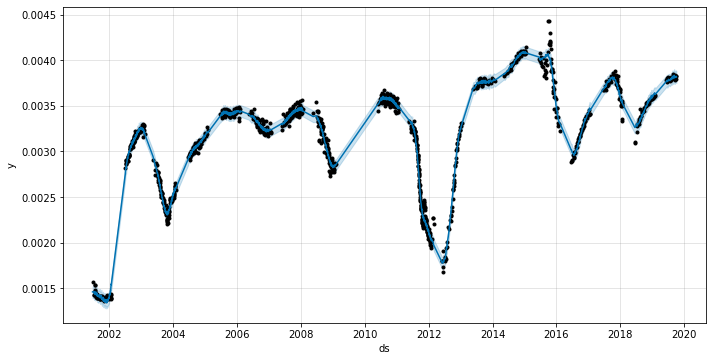

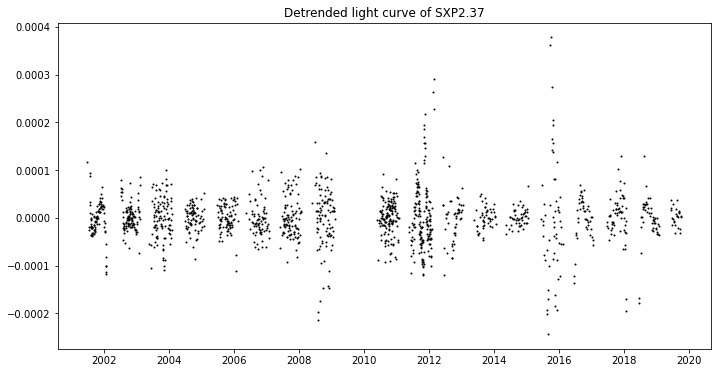

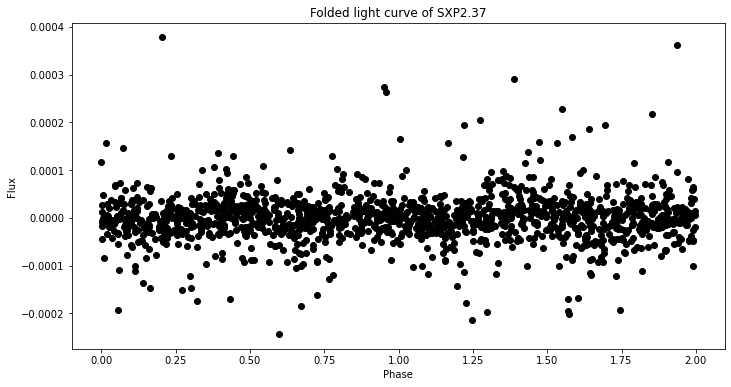

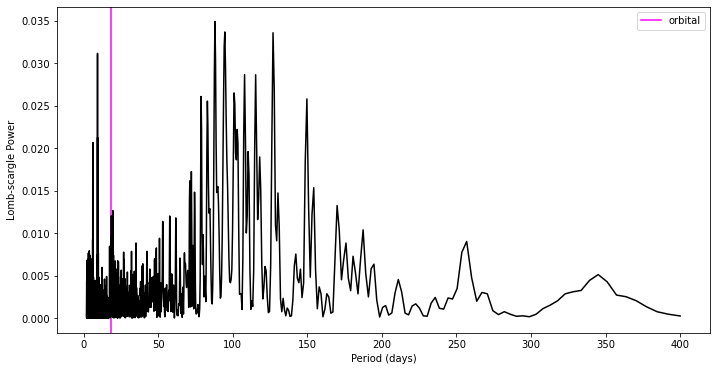

Source: SXP3.34 prophet model Period: 10.72


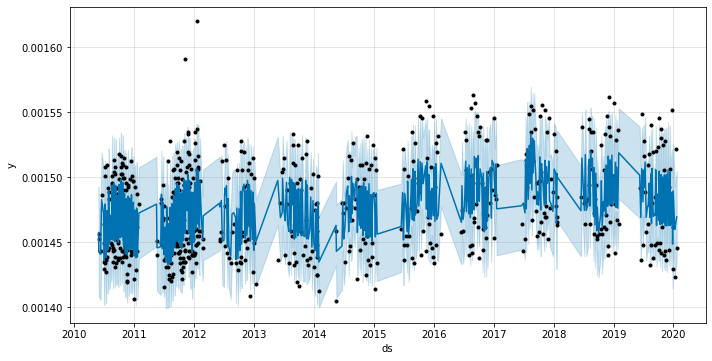

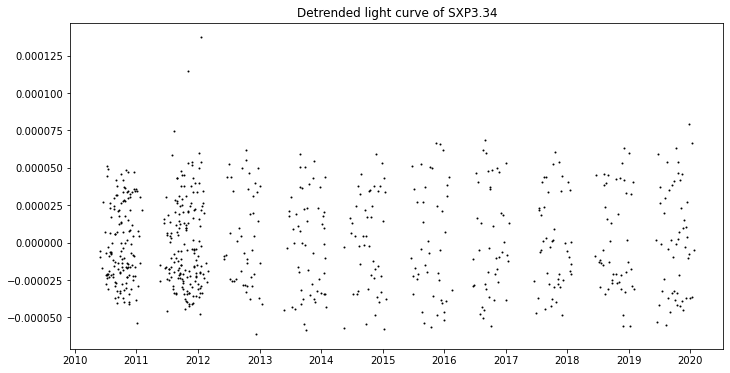

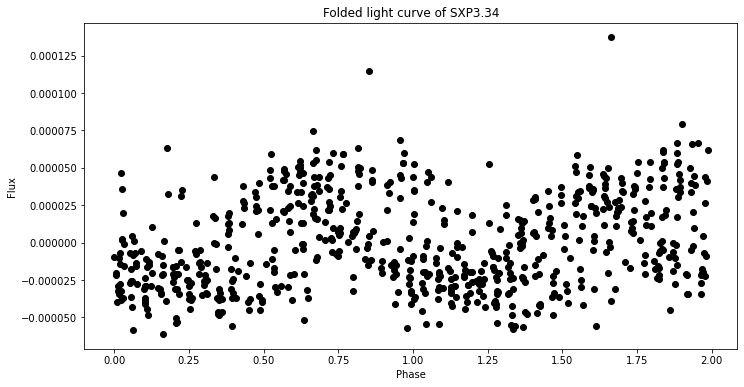

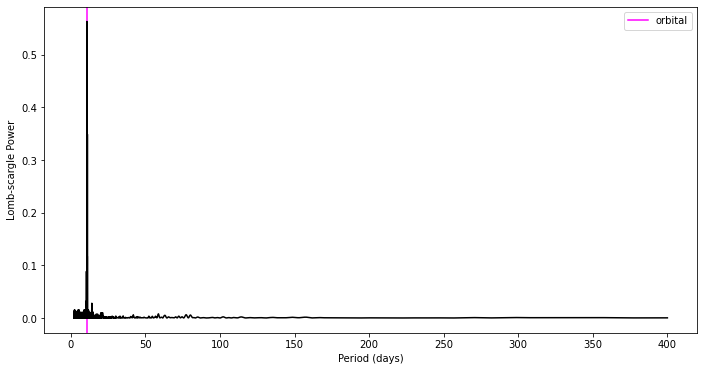

Source: SXP6.85 prophet model Period: 21.9


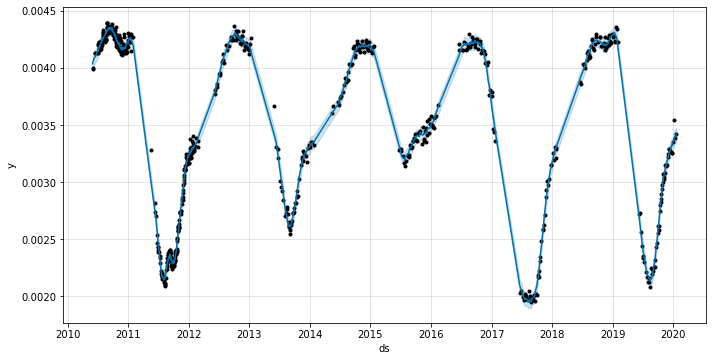

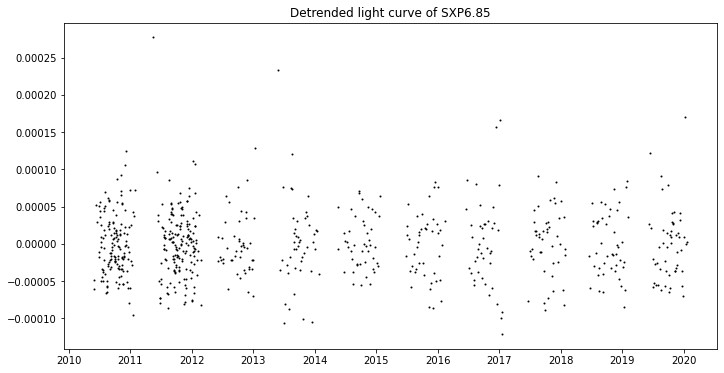

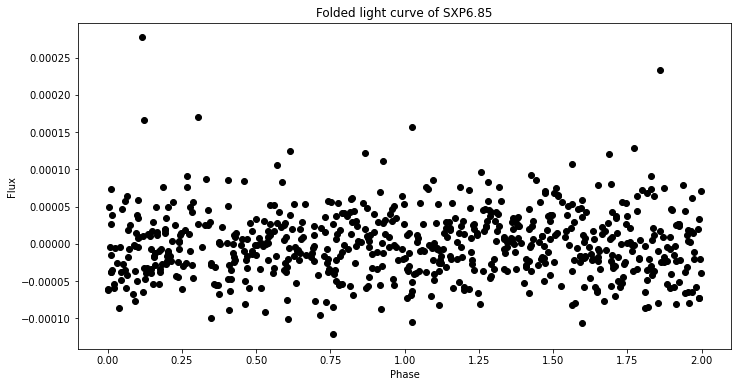

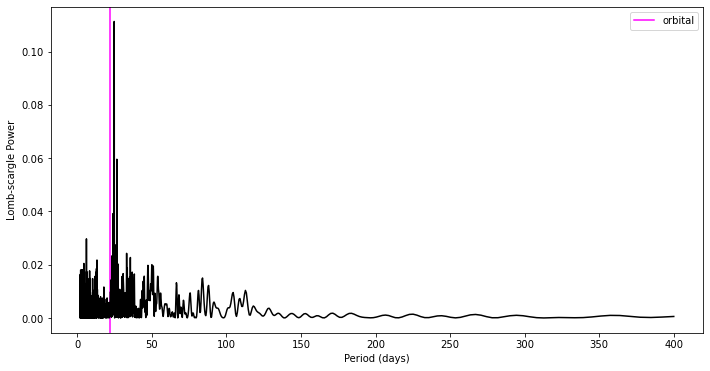

Source: SXP7.78 prophet model Period: 44.9


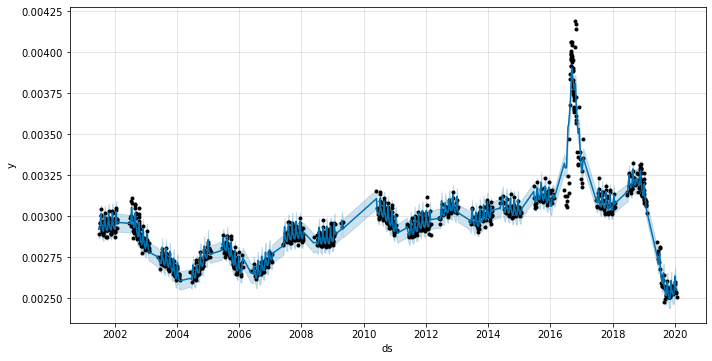

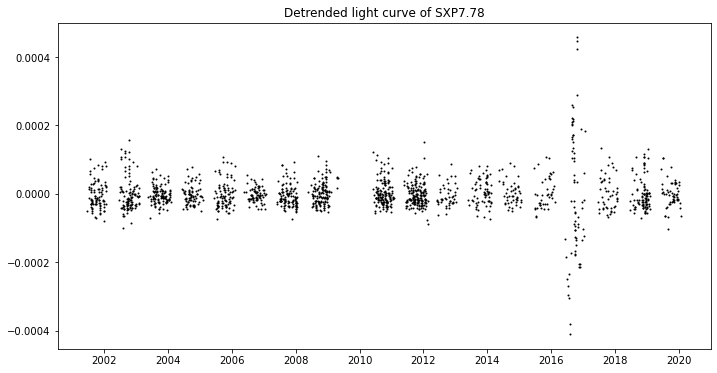

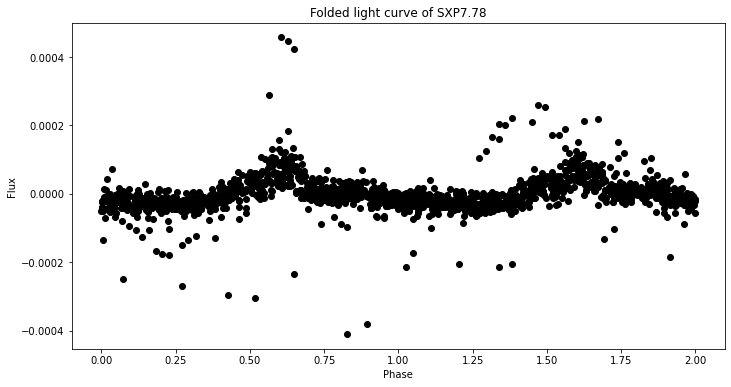

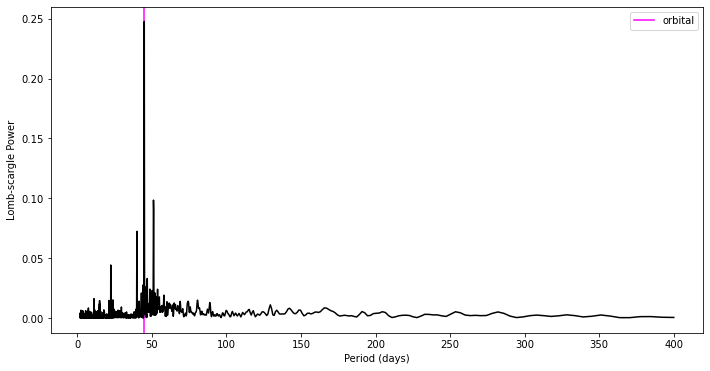

Source: SXP8.80-8.88 prophet model Period: 28.5


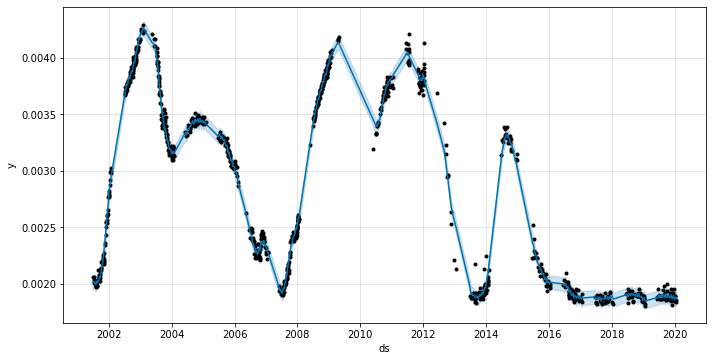

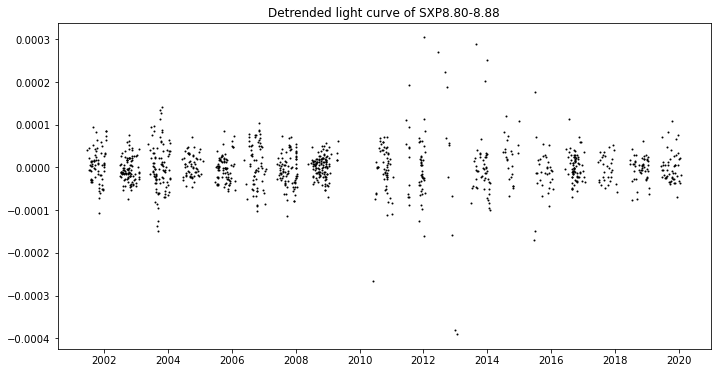

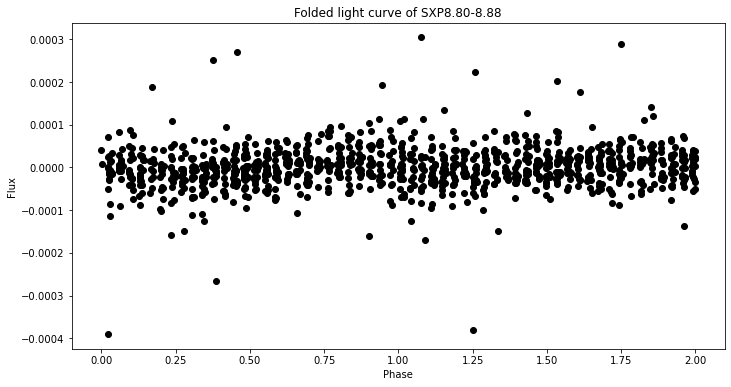

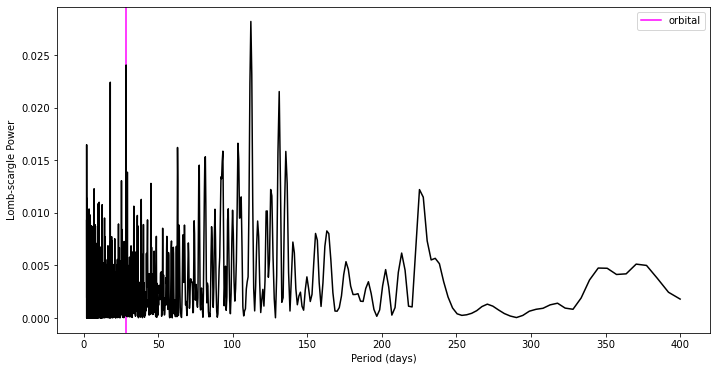

Source: SXP9.13 prophet model Period: 77.2


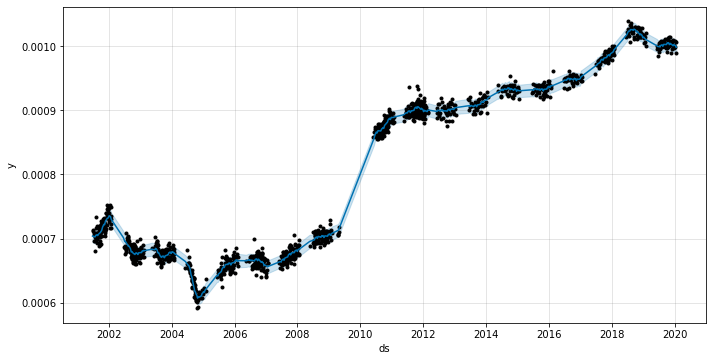

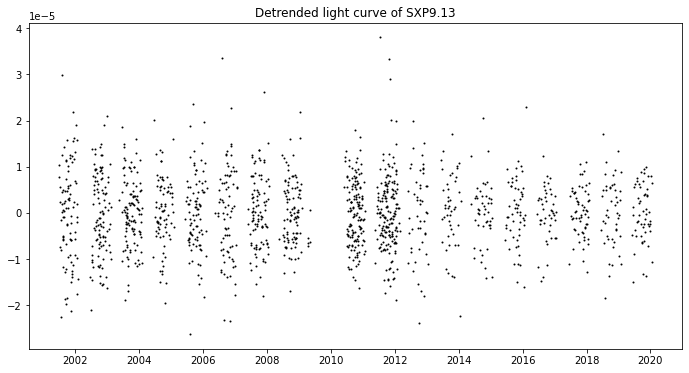

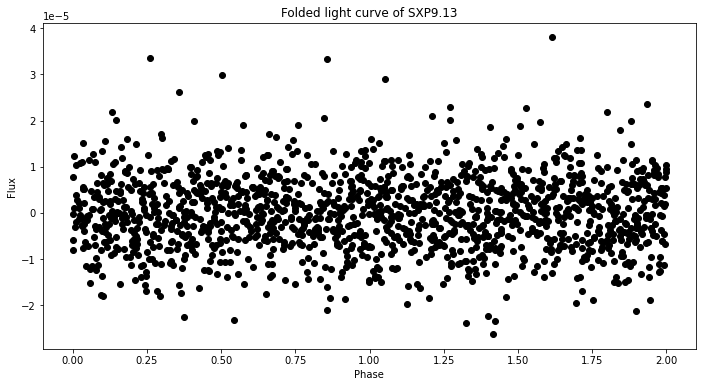

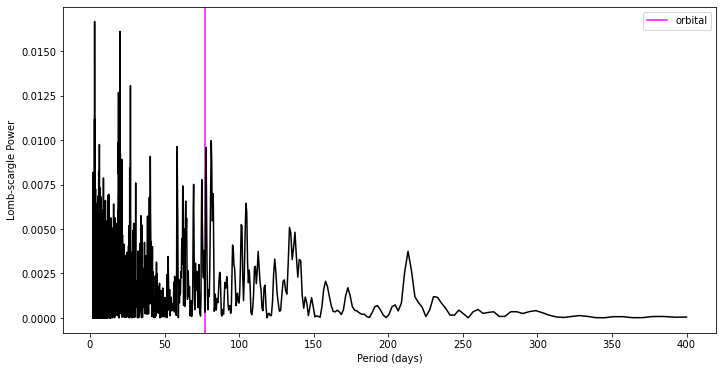

Source: SXP11.5 prophet model Period: 36.3


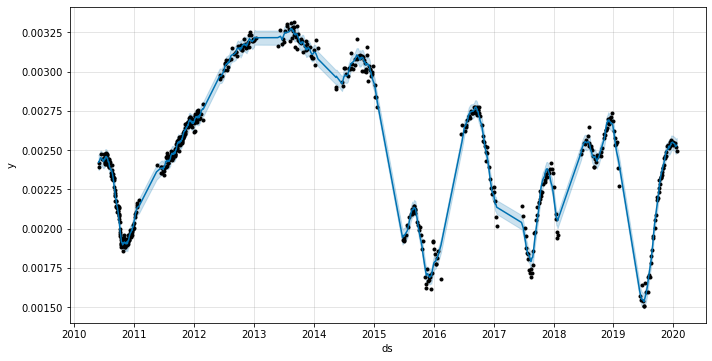

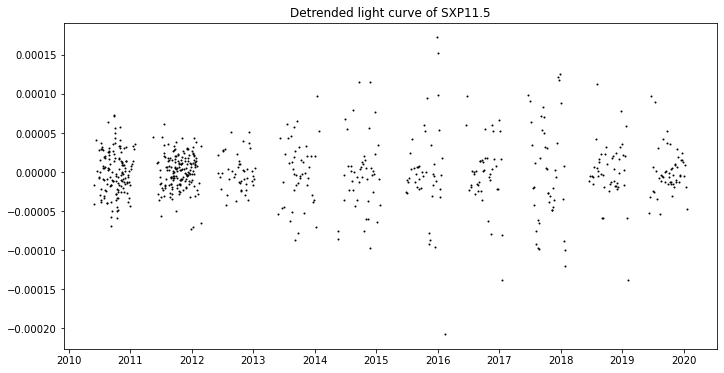

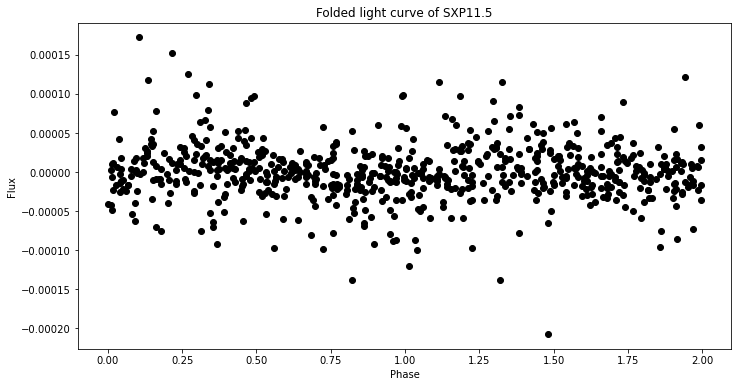

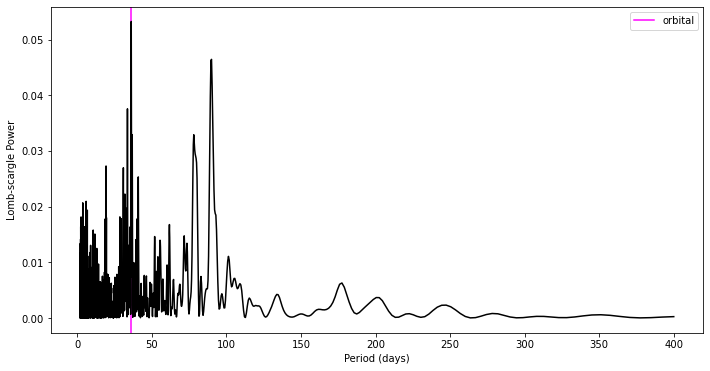

Source: SXP15.3 prophet model Period: 74.3


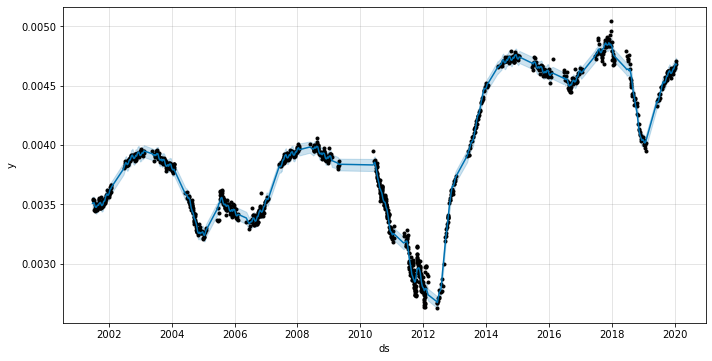

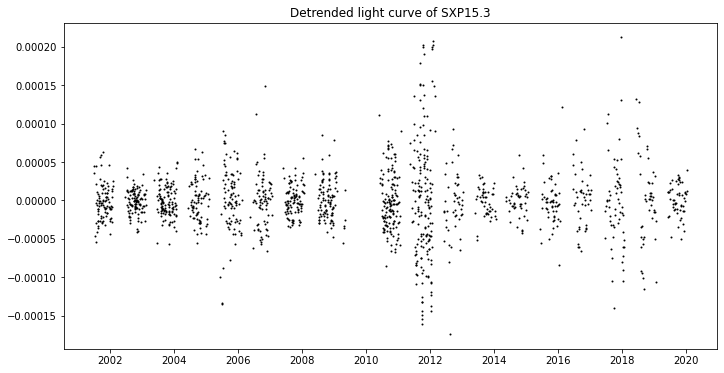

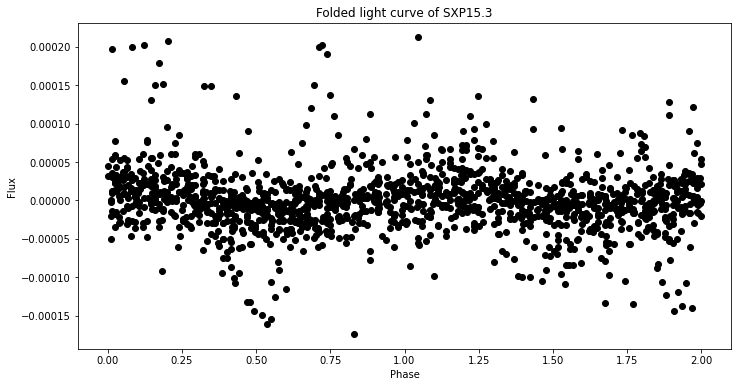

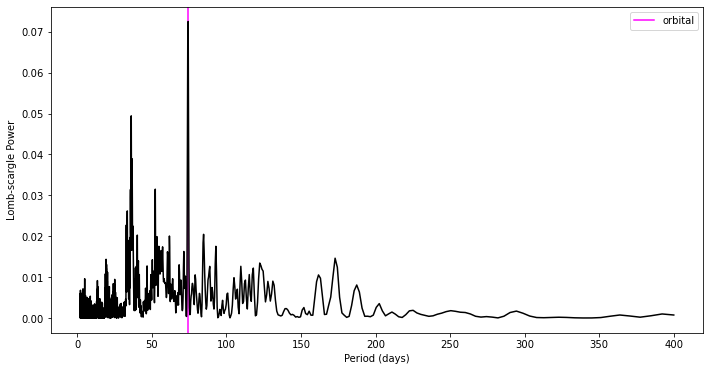

Source: SXP25.5 prophet model Period: 22.5


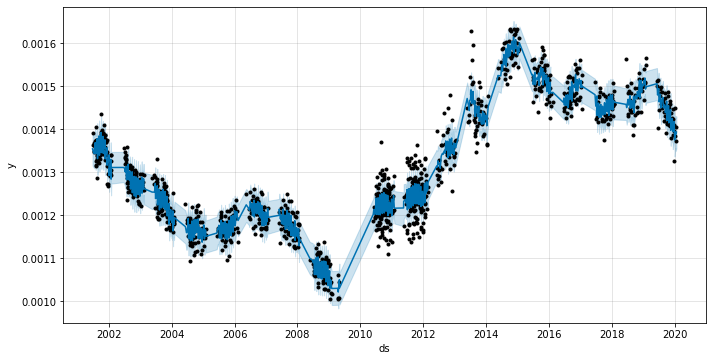

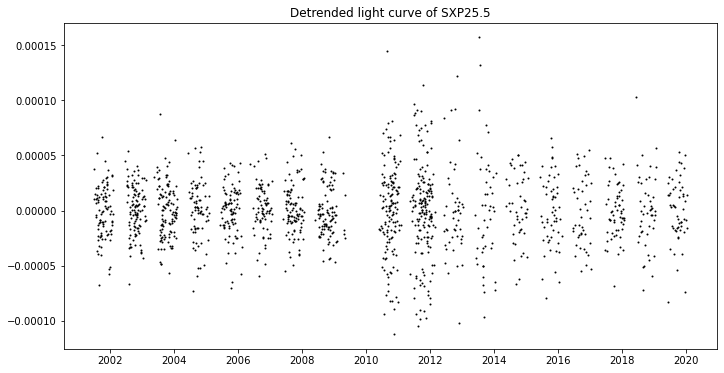

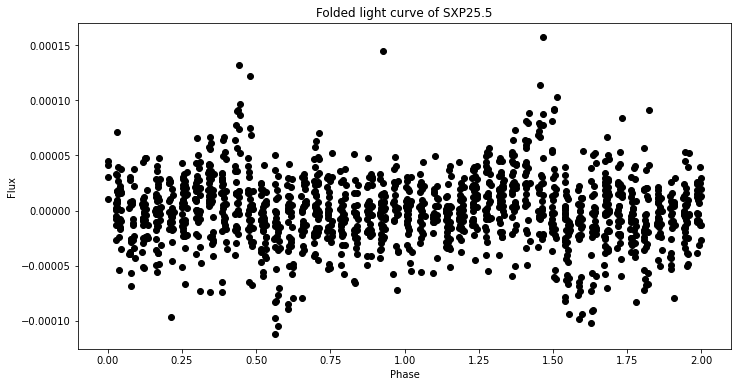

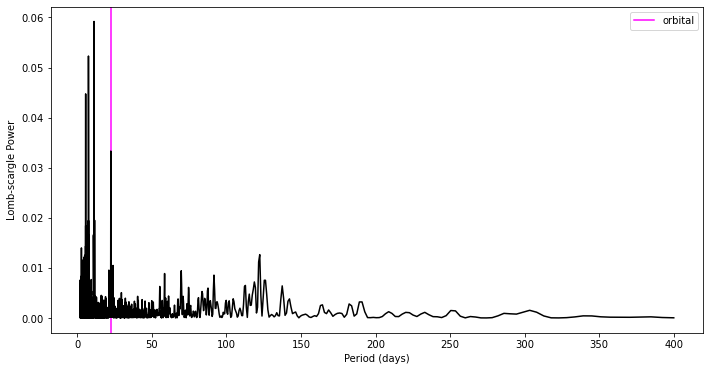

Source: SXP31.0 prophet model Period: 90.5


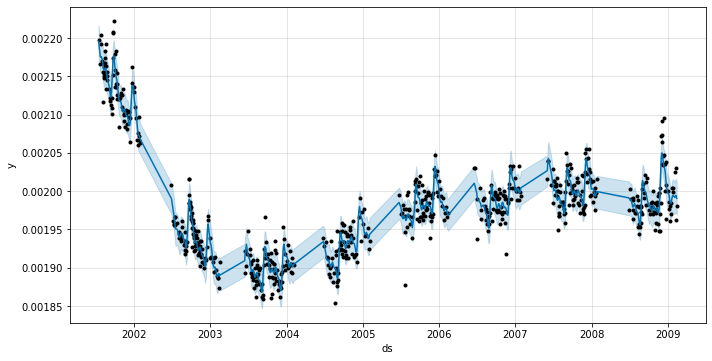

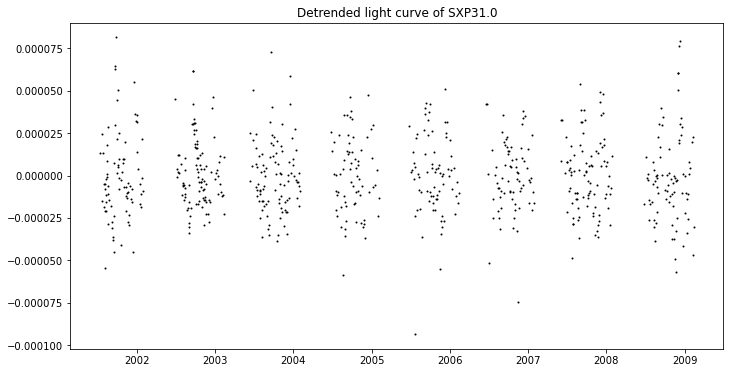

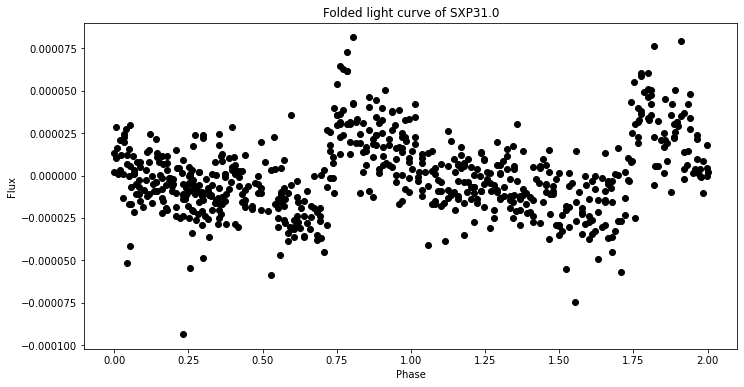

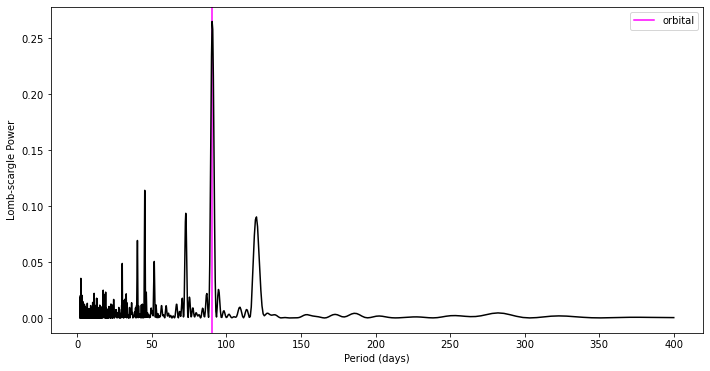

Source: SXP46.6 prophet model Period: 137.36


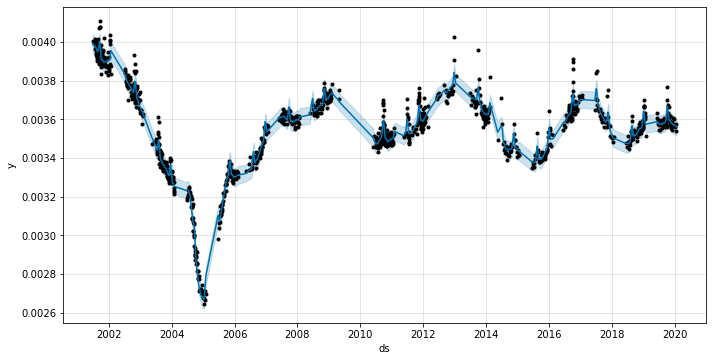

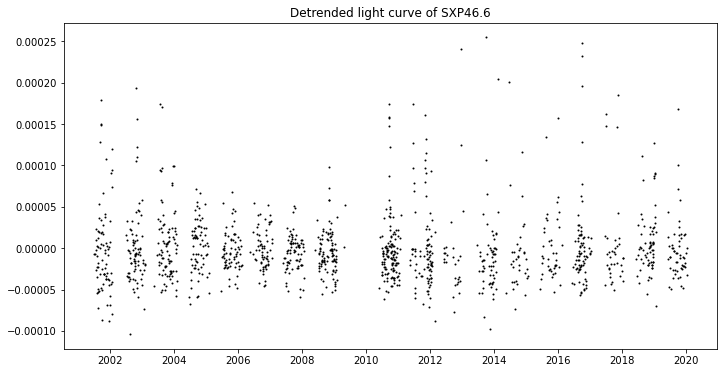

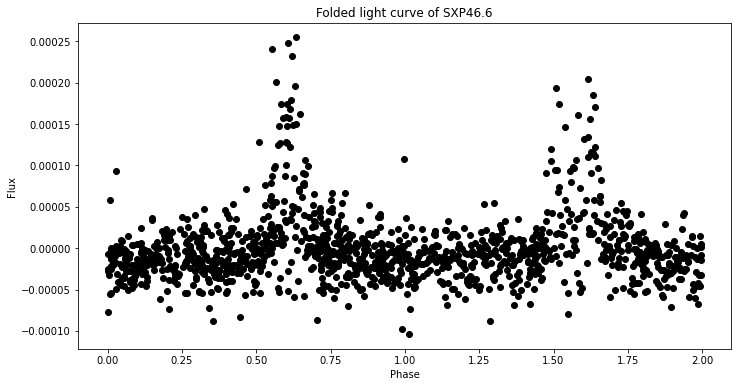

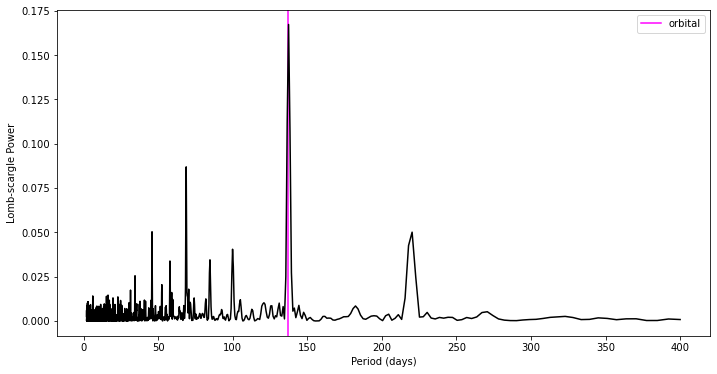

Source: SXP59.0 prophet model Period: 62.15


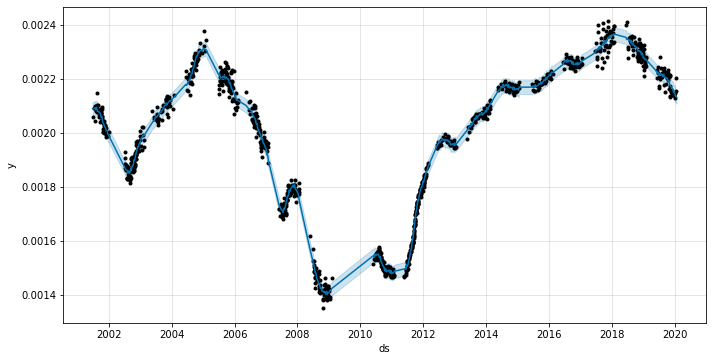

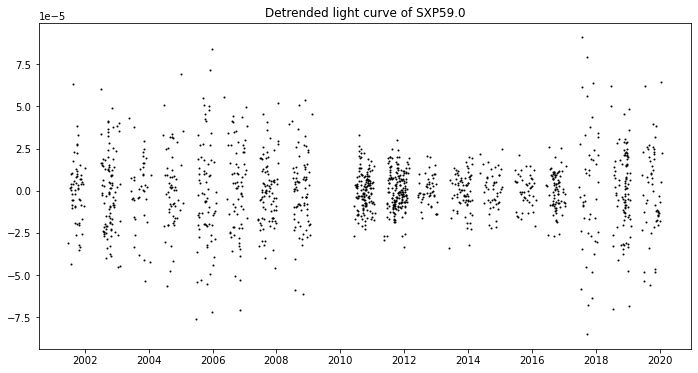

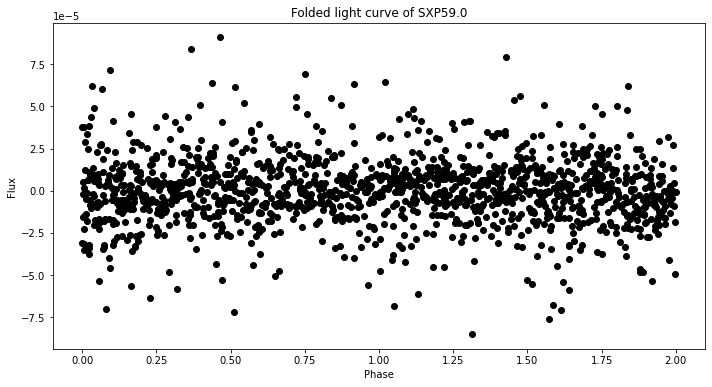

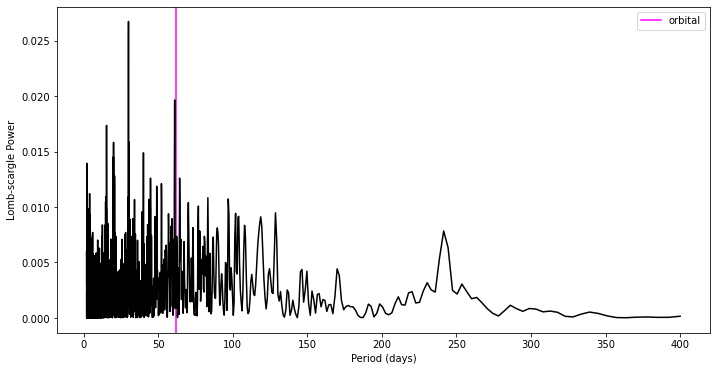

Source: SXP65.8 prophet model Period: 110.6


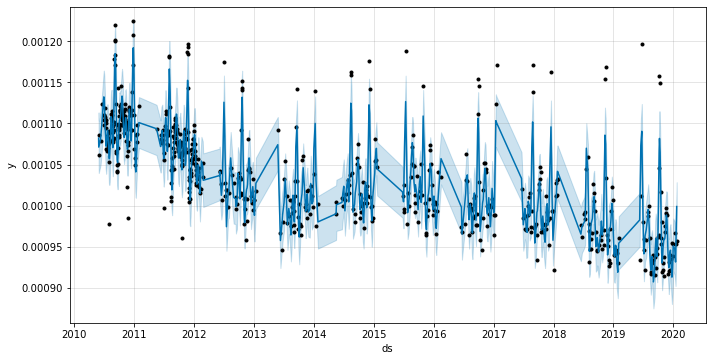

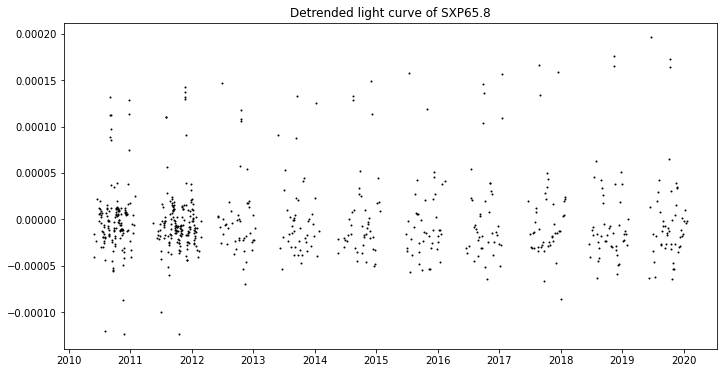

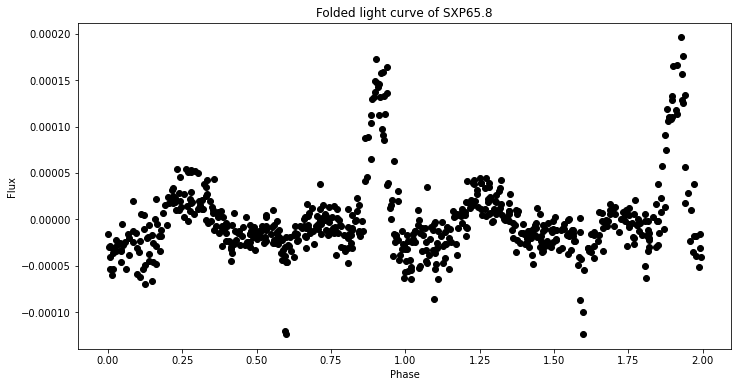

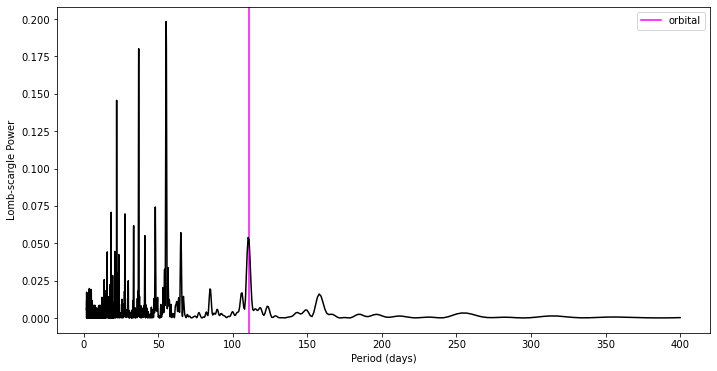

Source: SXP74.7 prophet model Period: 33.4


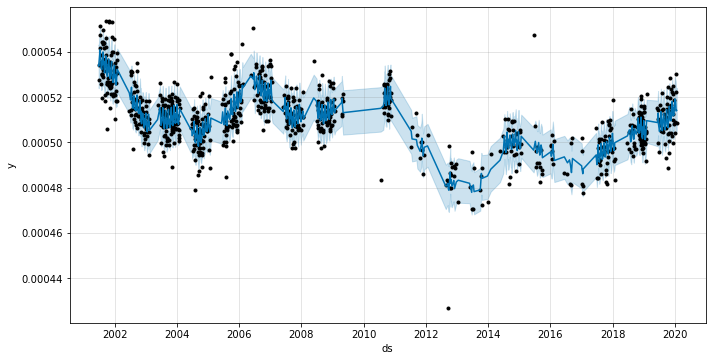

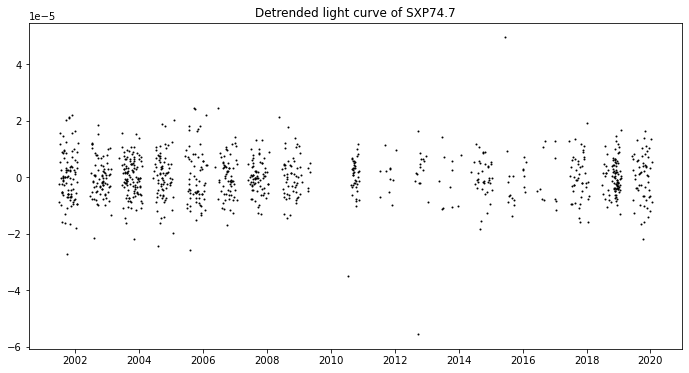

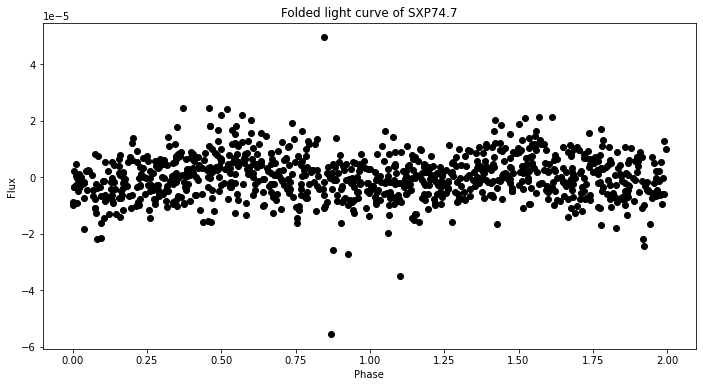

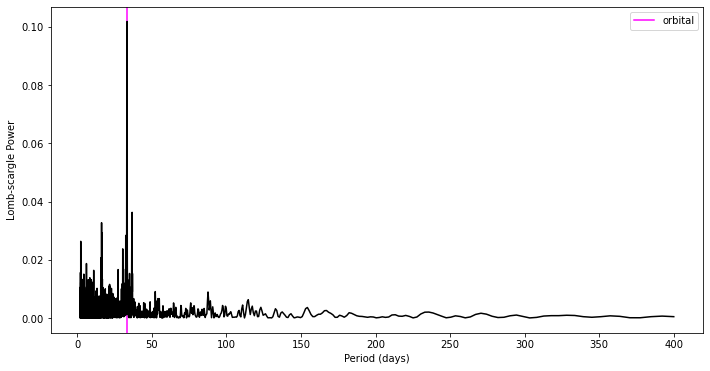

Source: SXP82.4 prophet model Period: 362.3


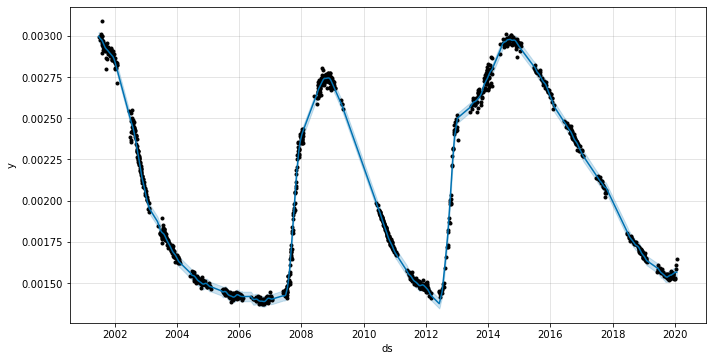

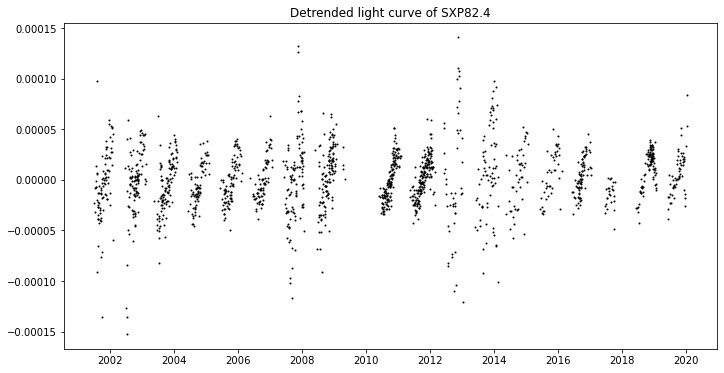

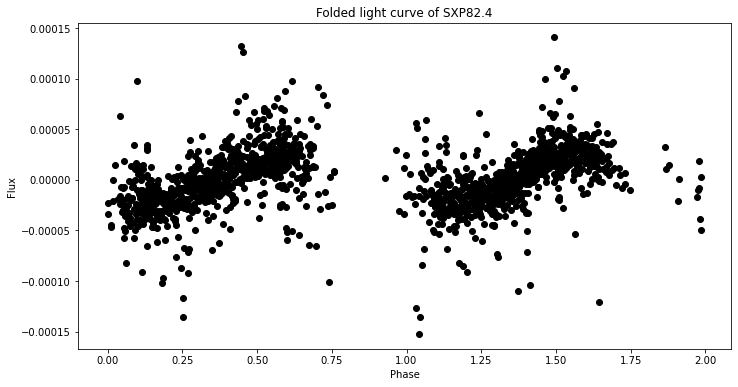

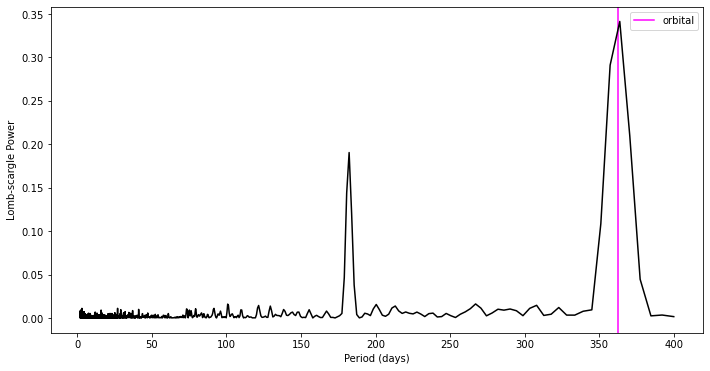

Source: SXP89.0&91.1 prophet model Period: 88.37


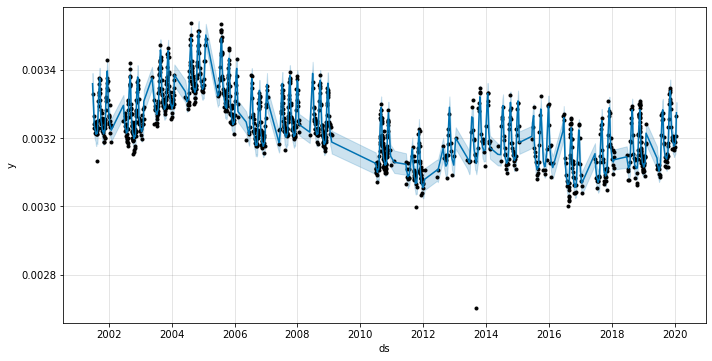

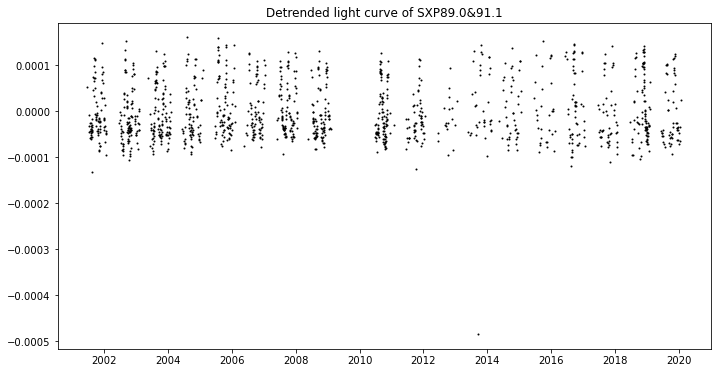

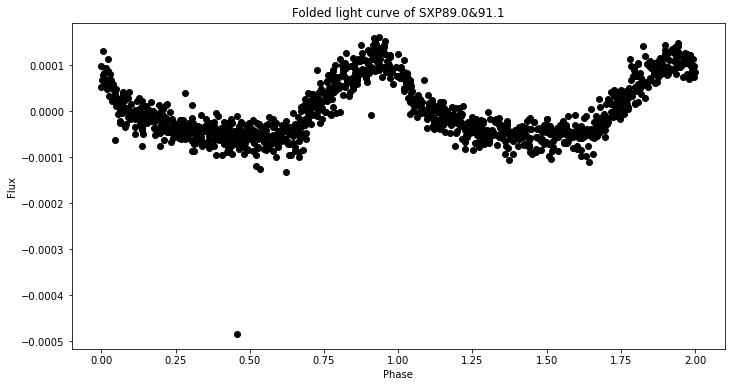

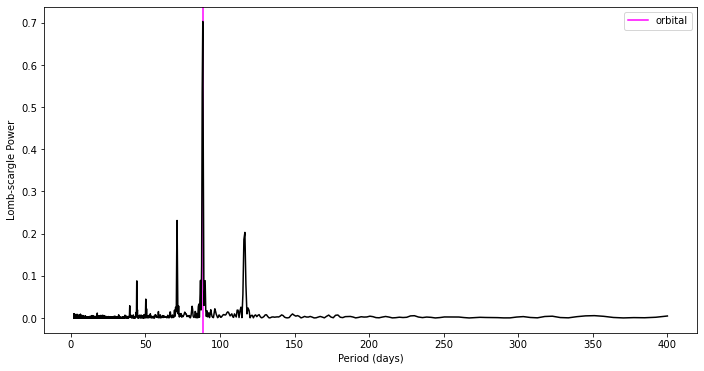

Source: SXP138 prophet model Period: 125.1


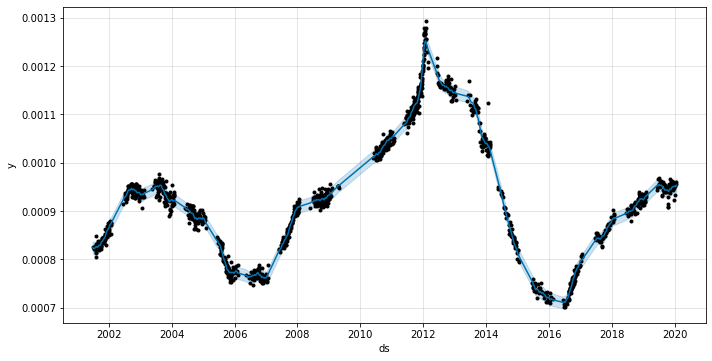

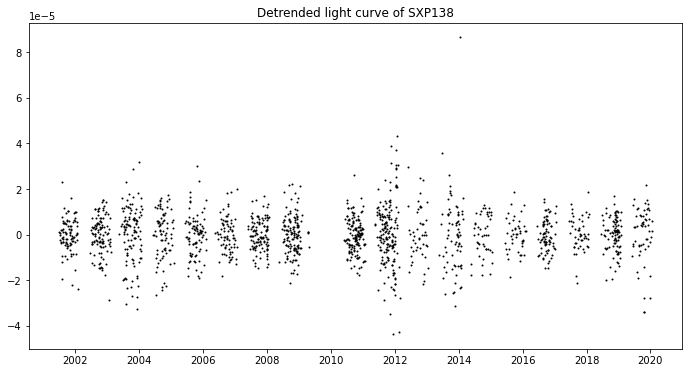

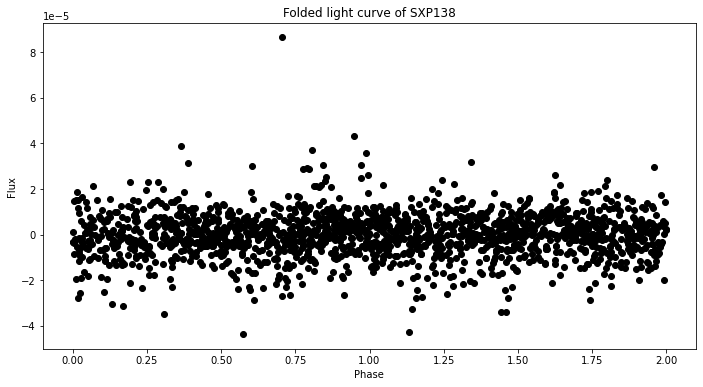

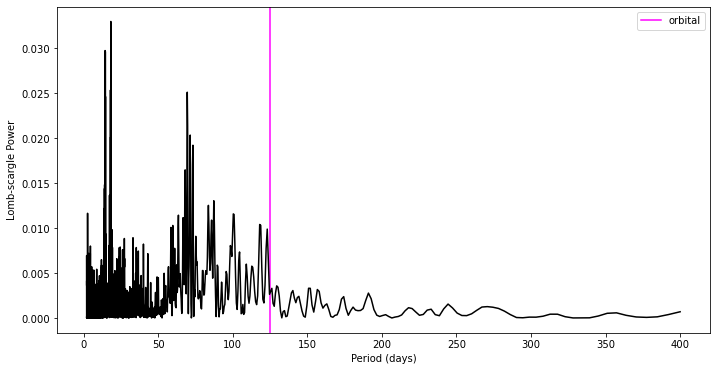

Source: SXP140 prophet model Period: 197.0


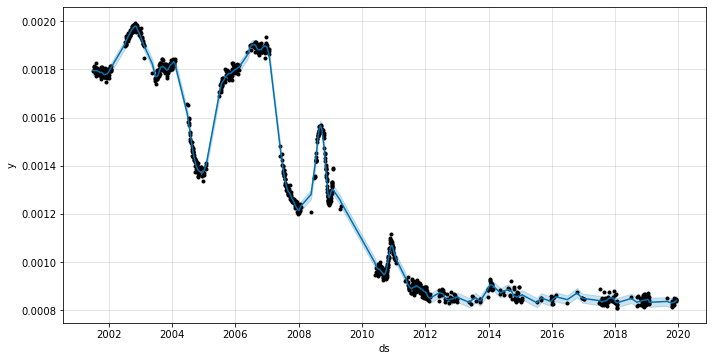

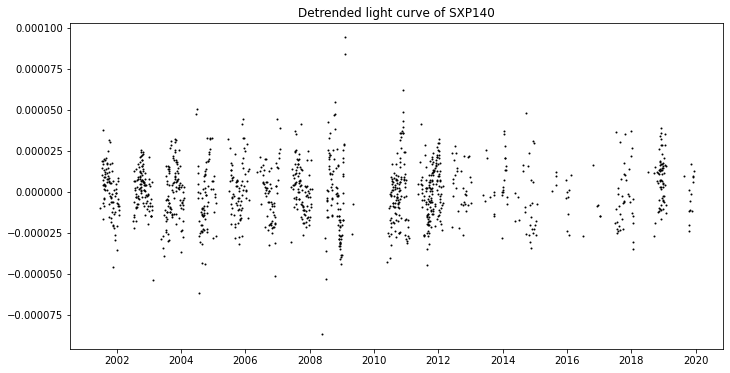

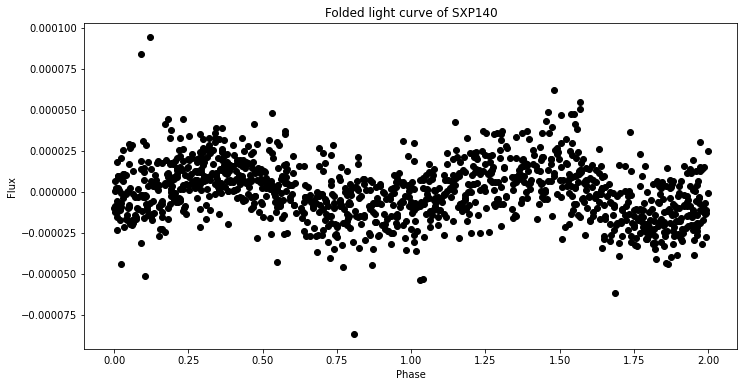

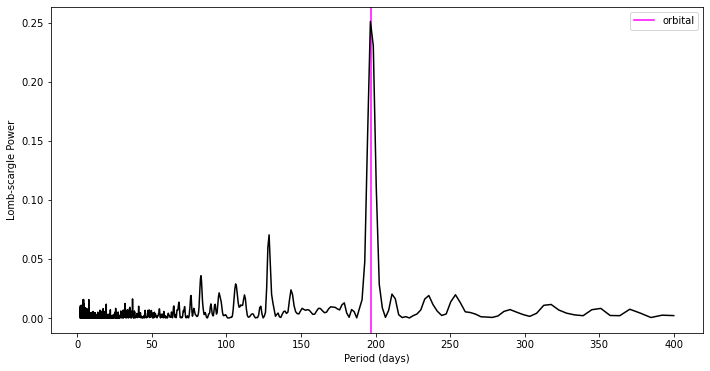

Source: SXP172 prophet model Period: 67.9


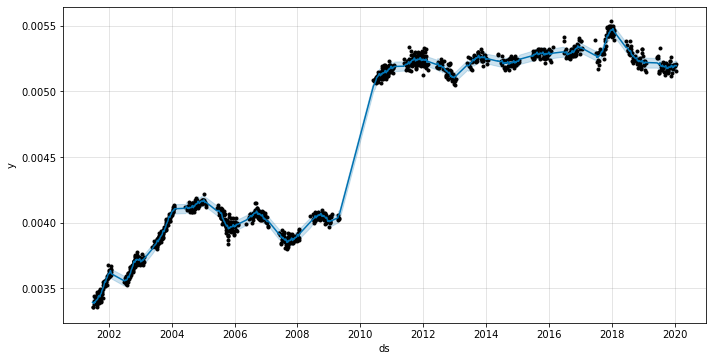

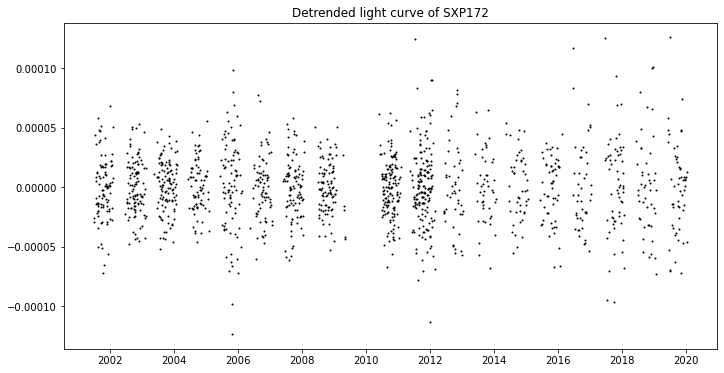

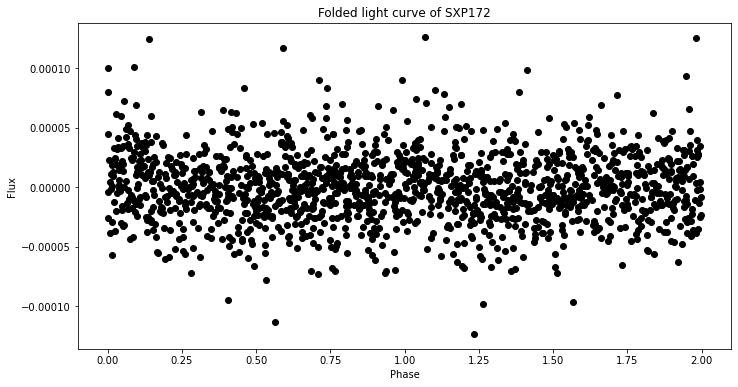

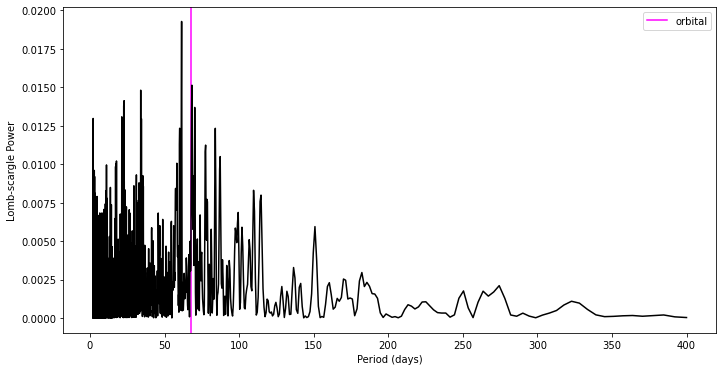

Source: SXP214 prophet model Period: 29.9


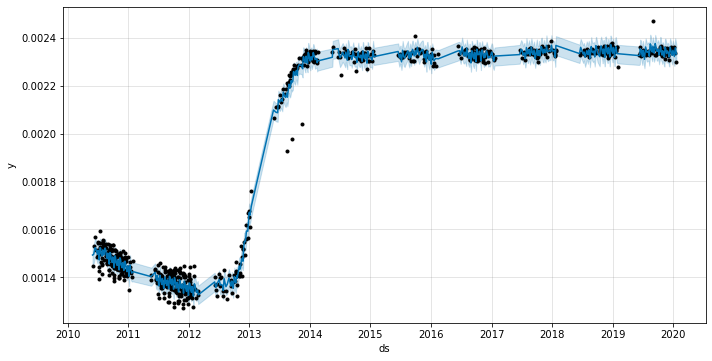

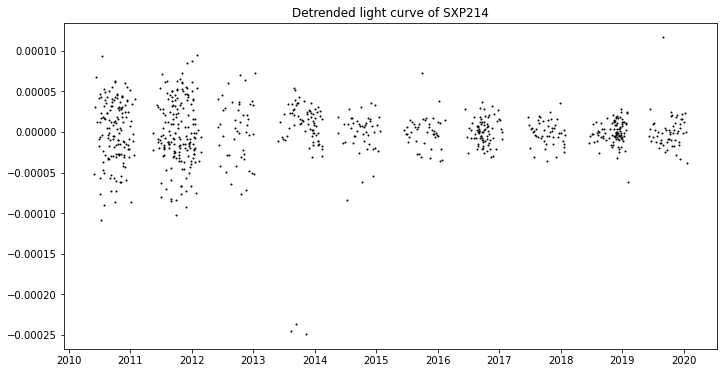

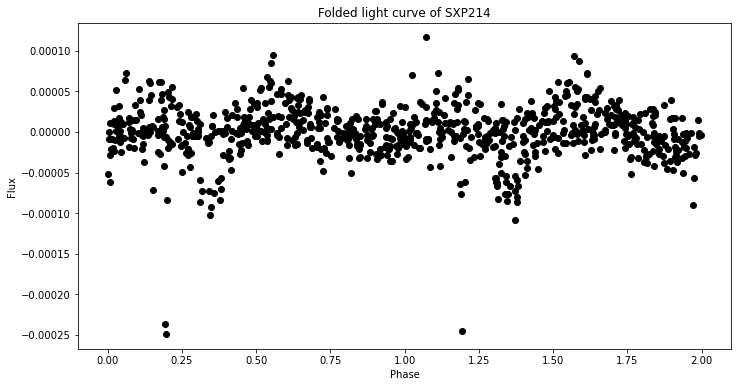

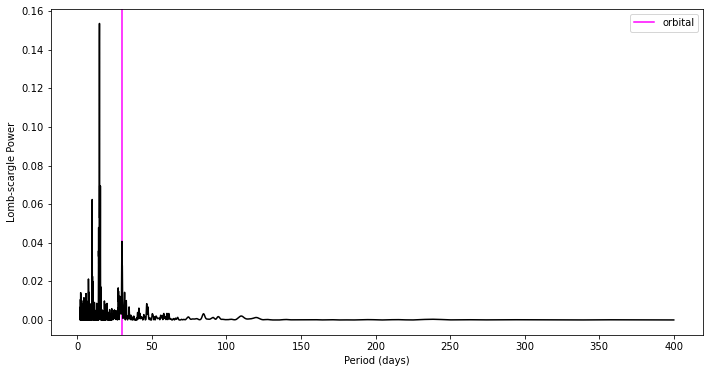

Source: SXP264 prophet model Period: 49.2


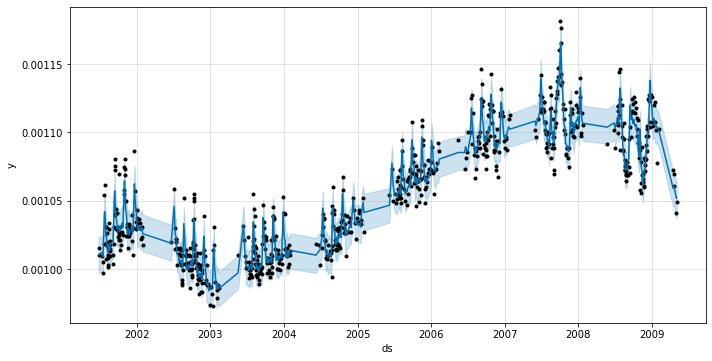

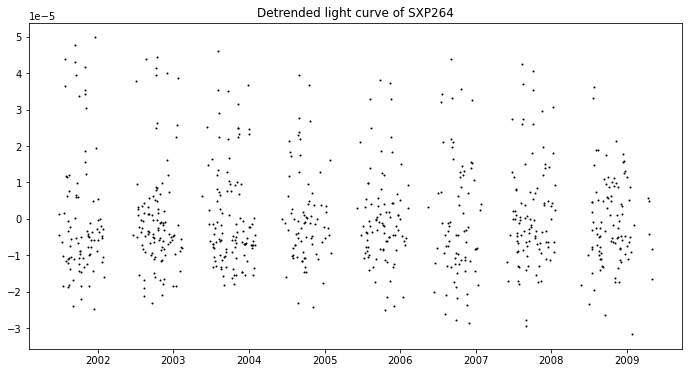

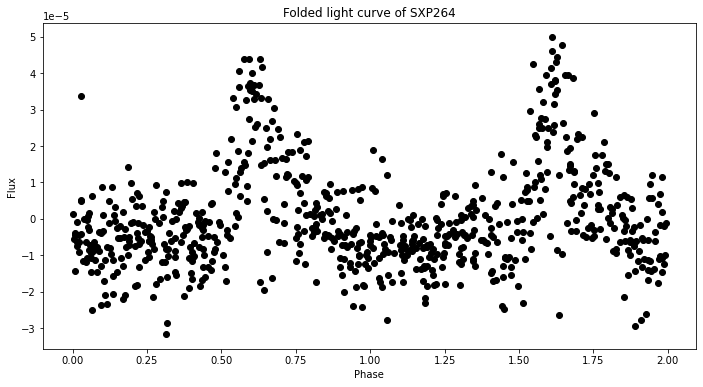

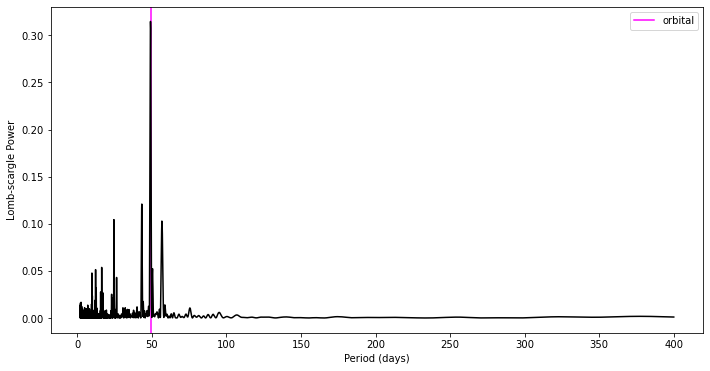

Source: SXP293 prophet model Period: 59.726000000000006


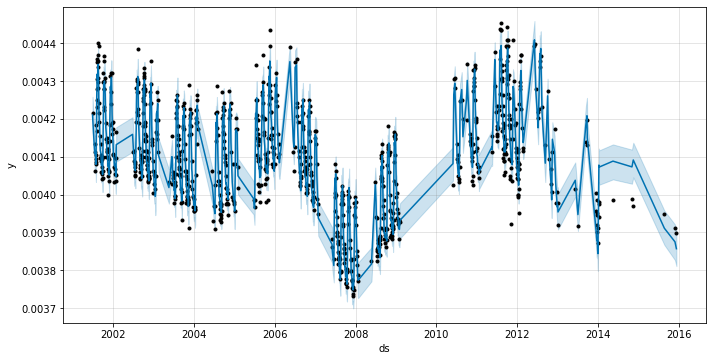

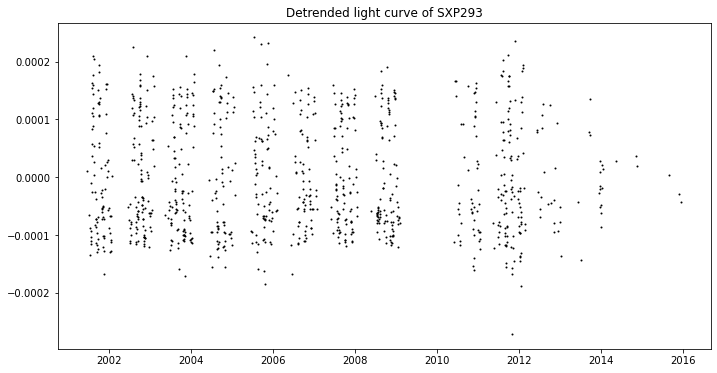

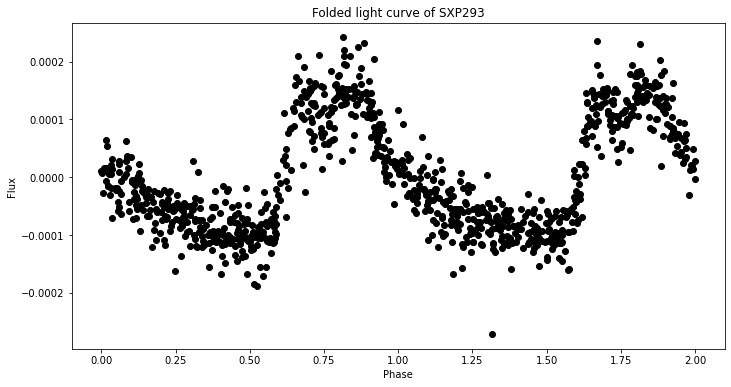

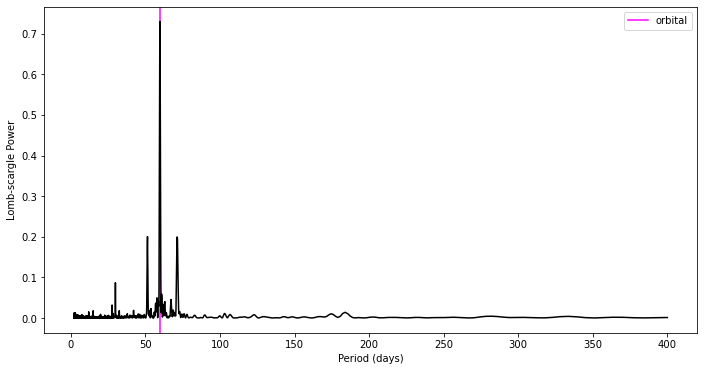

Source: SXP323 prophet model Period: 116.6


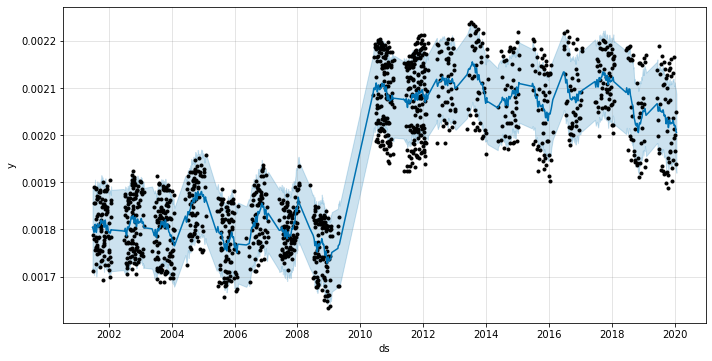

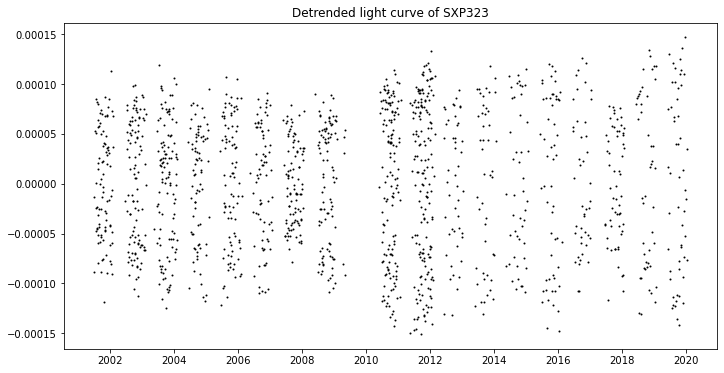

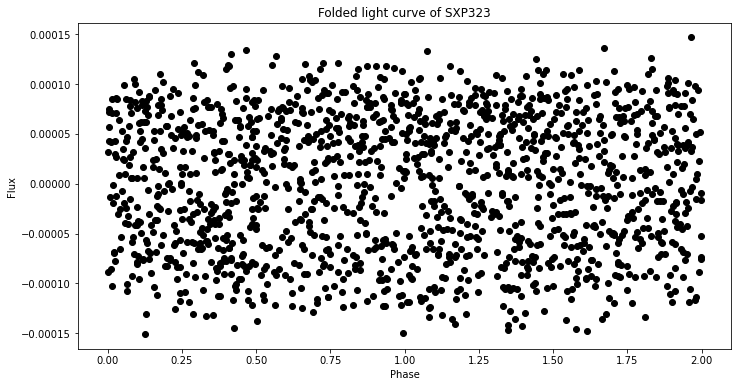

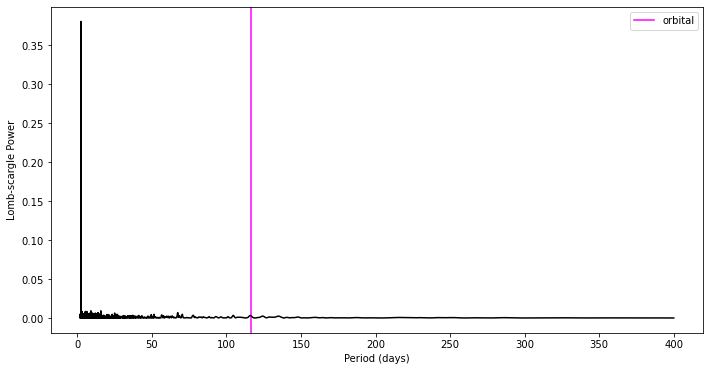

Source: SXP455 prophet model Period: 75.0


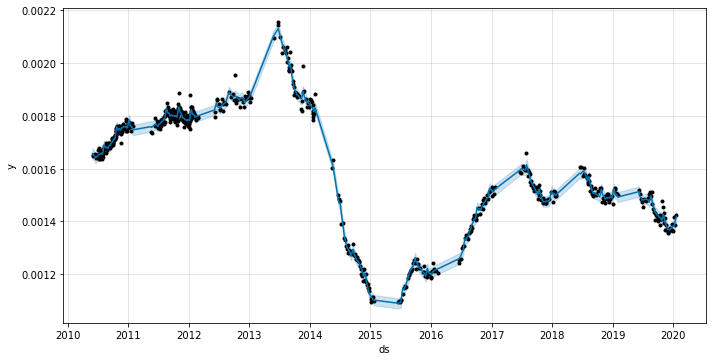

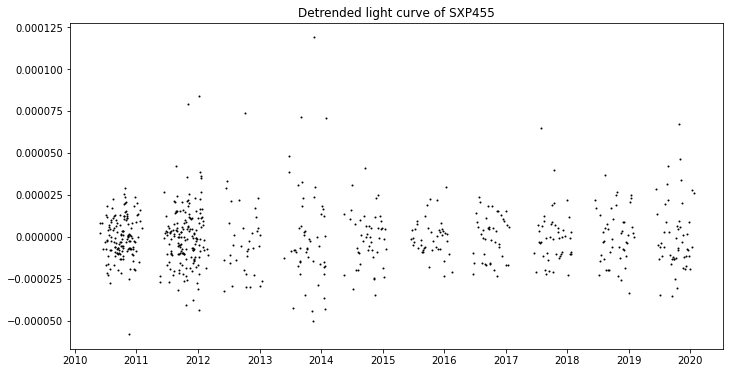

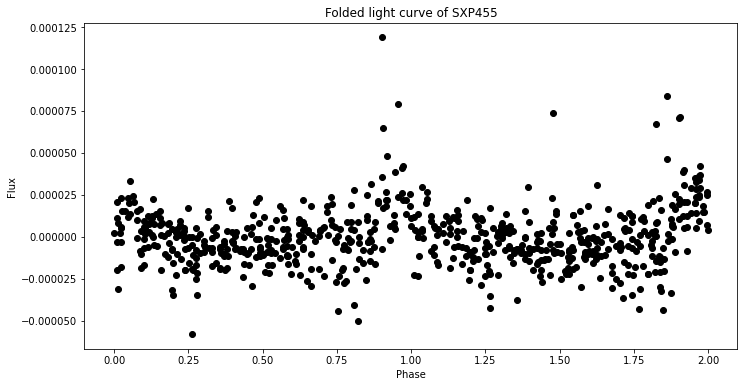

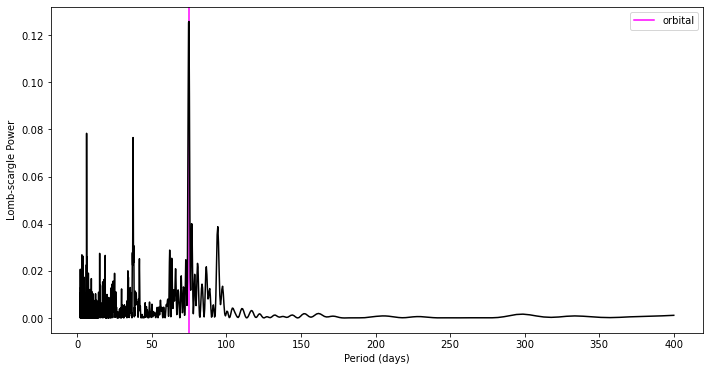

Source: SXP504 prophet model Period: 272.0


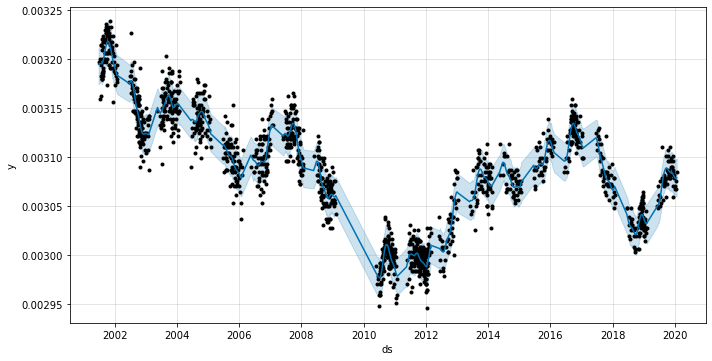

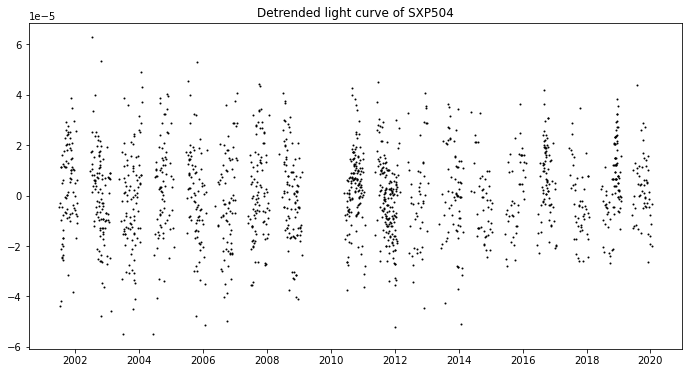

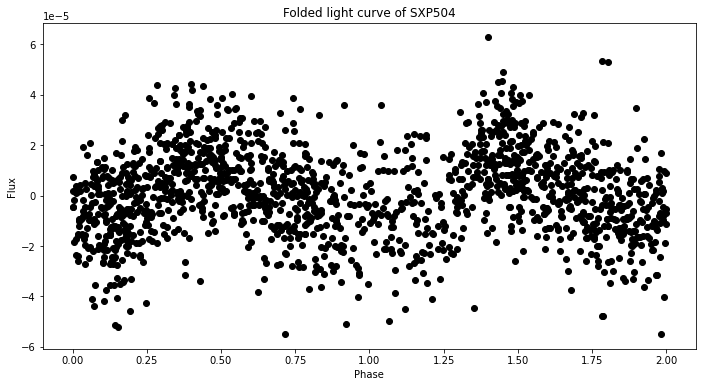

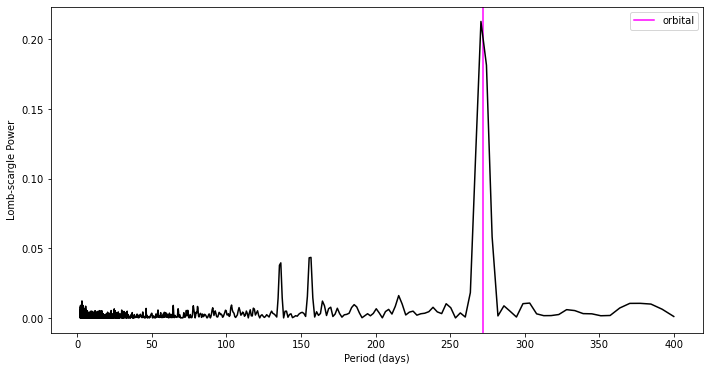

Source: SXP565 prophet model Period: 152.4


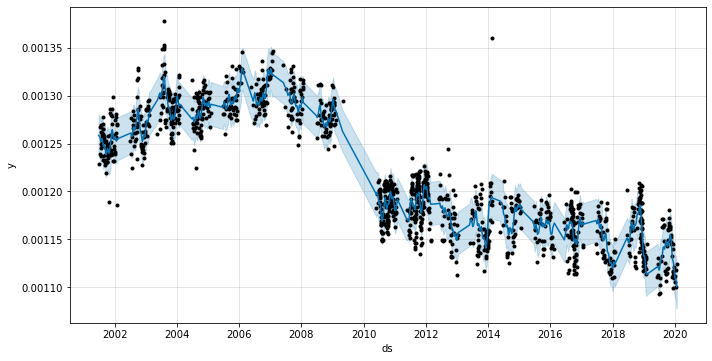

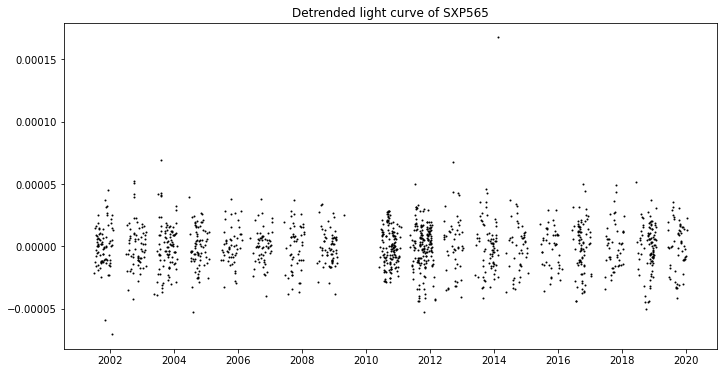

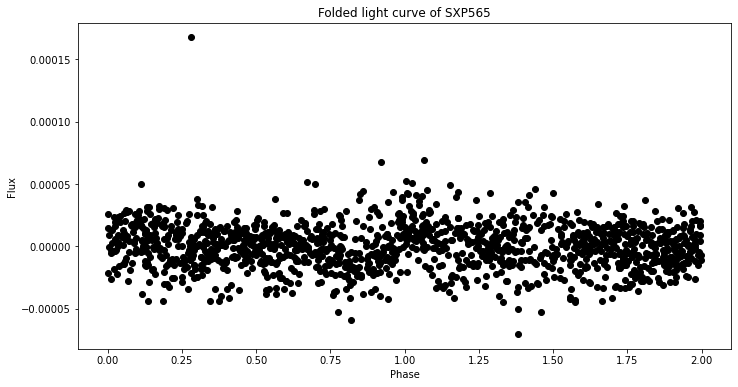

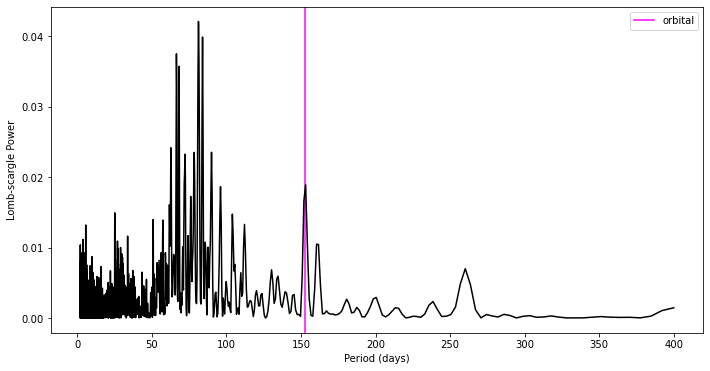

Source: SXP701 prophet model Period: 412.0


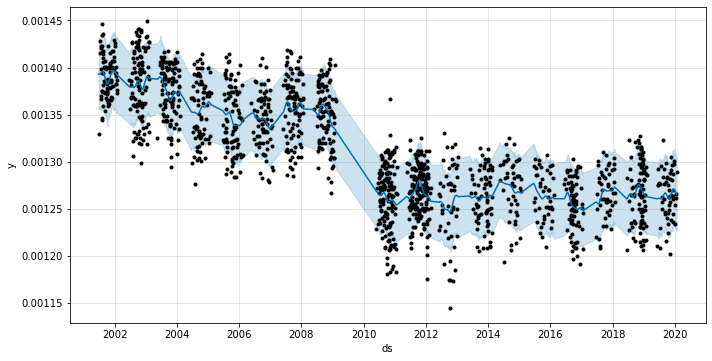

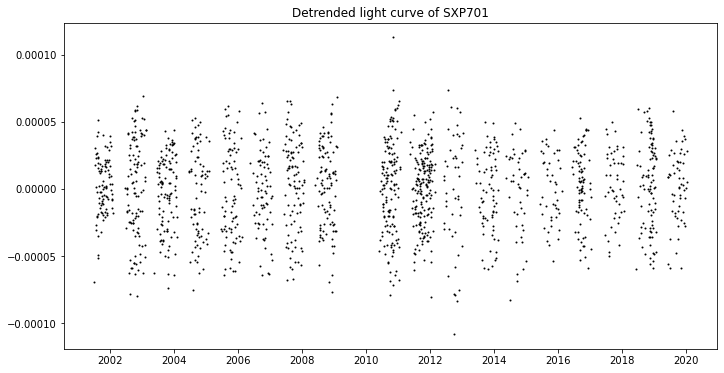

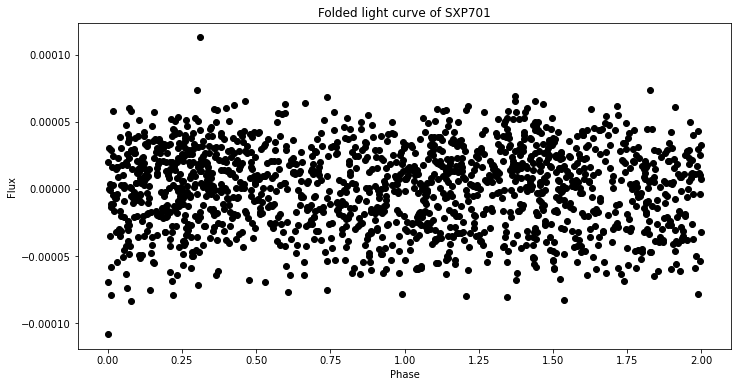

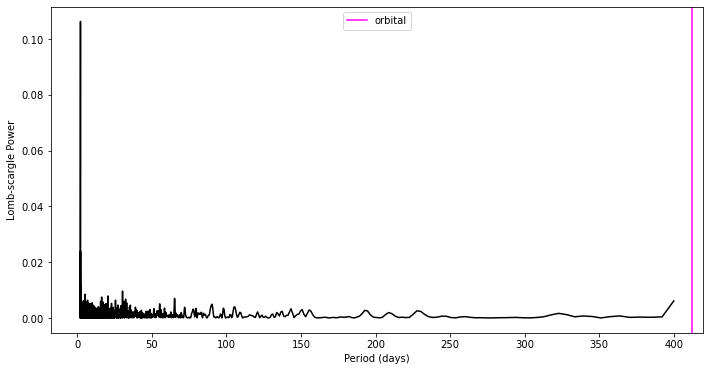

Source: SXP756 prophet model Period: 393.1


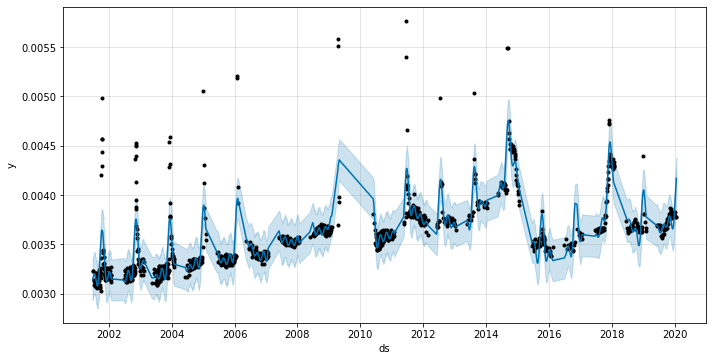

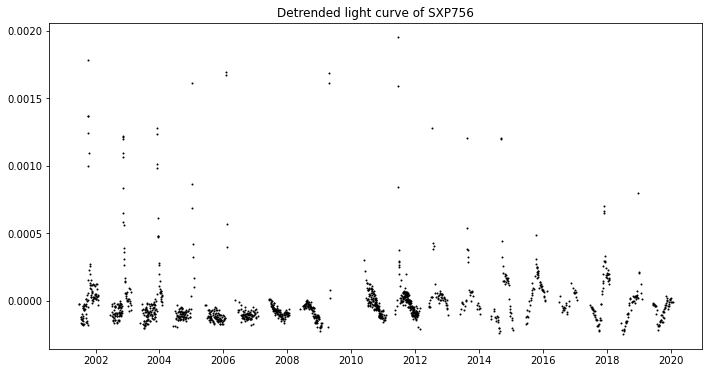

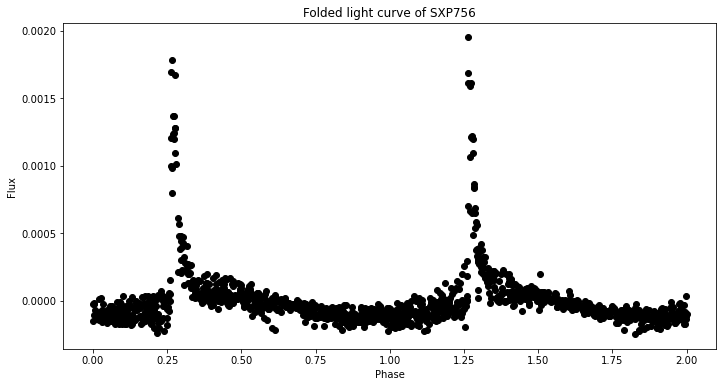

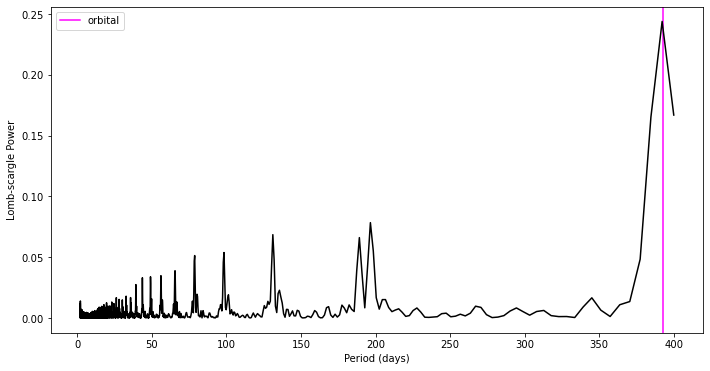

Source: SXP967 prophet model Period: 101.9


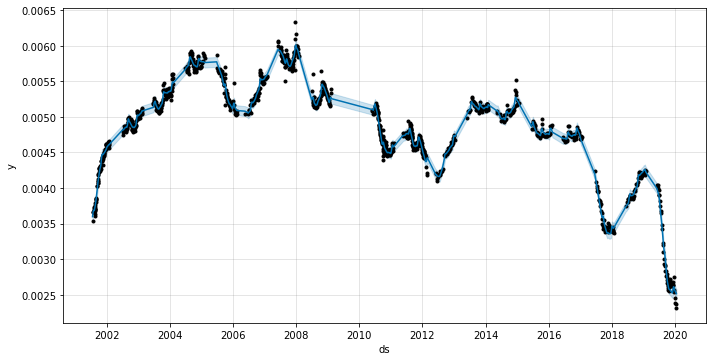

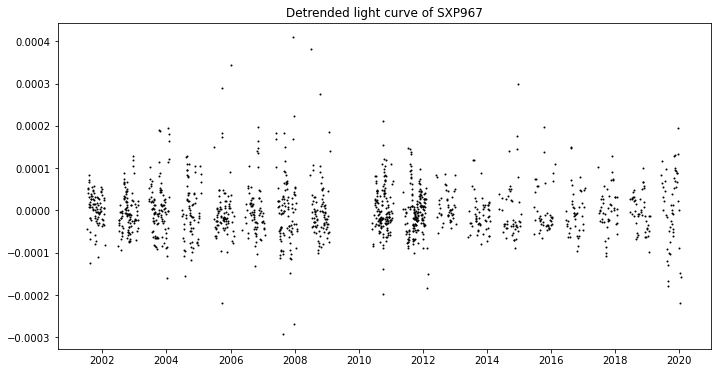

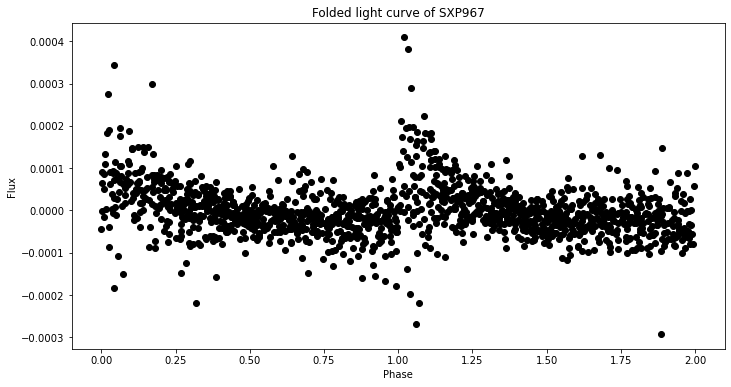

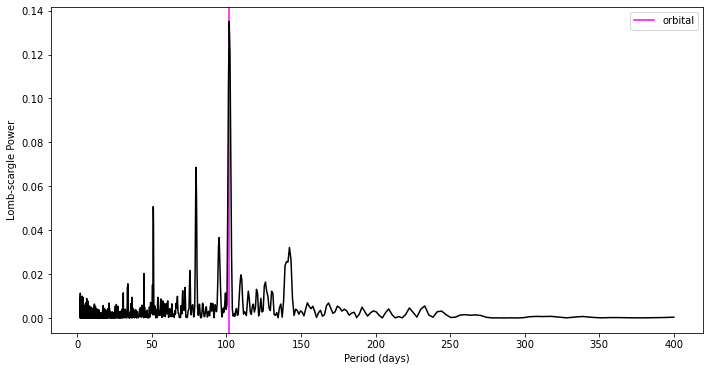

Source: SXP1062 prophet model Period: 668.0


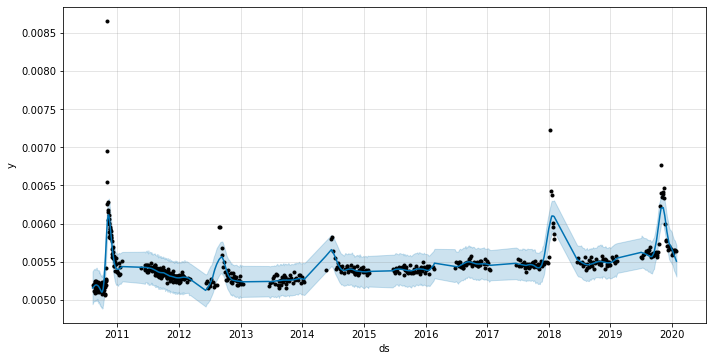

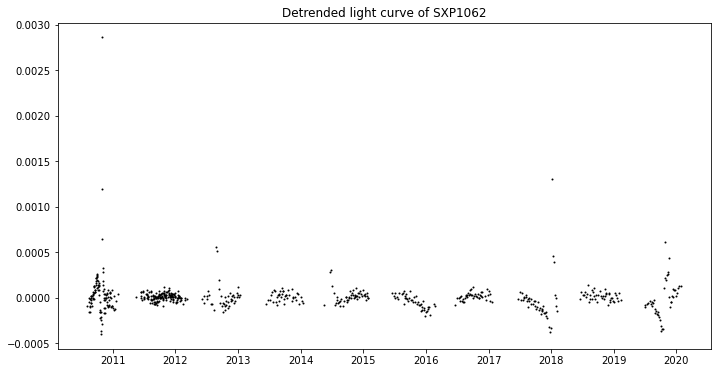

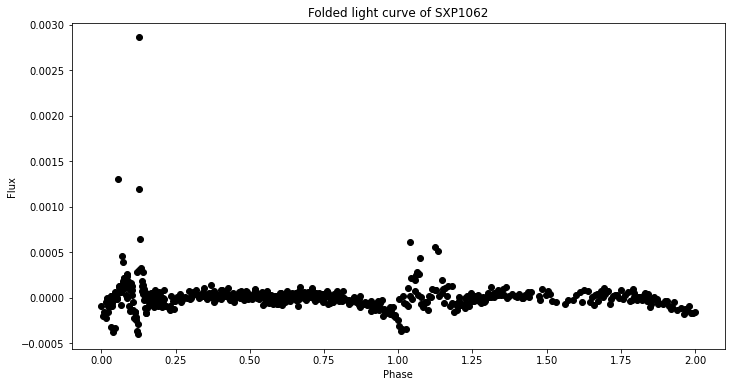

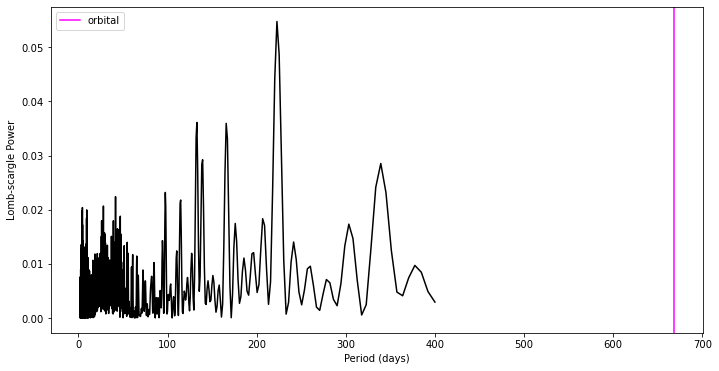

Source: SXP1323 prophet model Period: 26.188000000000002


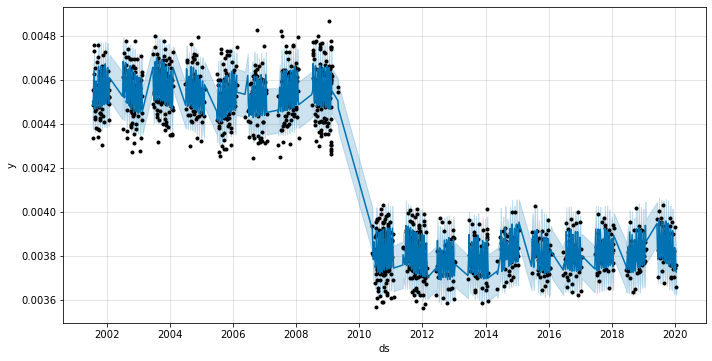

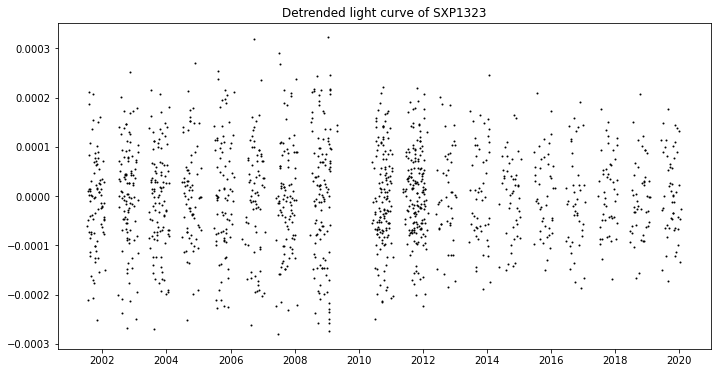

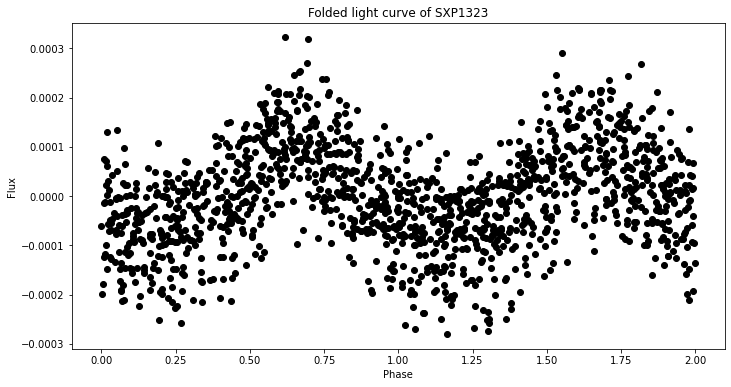

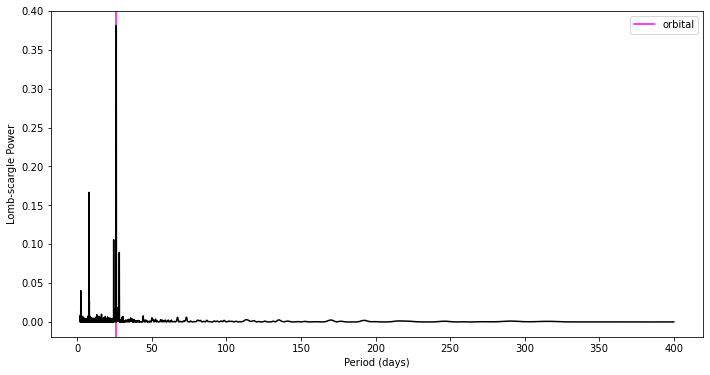

In [1512]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
f = np.linspace(1/400, 1/2, 10000)*2*np.pi
import scipy.signal as signal


for source_index, source in names_period.iterrows():
    if len(source["file"])>0:
        data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
        #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
        data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
        
        data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
        data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
        data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

        # fit prophet model with orbital periodicity component
        m = Prophet(
            growth='linear',
            changepoints=None,
            n_changepoints=200,
            changepoint_range=0.99,
            yearly_seasonality=False,
            weekly_seasonality=False,
            daily_seasonality=False,
            holidays=None,
            seasonality_mode='additive',
            seasonality_prior_scale=10.0,
            holidays_prior_scale=10.0,
            changepoint_prior_scale=15,
            mcmc_samples=0,
            interval_width=0.8,
            uncertainty_samples=1000,
            stan_backend=None,
        ) #"07-09-2009"
        m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
        m.fit(data_df)
        
        forecast = m.predict(pd.DataFrame(data_df["ds"]))
        forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()
        
        # plot data with prophet model
        print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
        fig1 = m.plot(forecast)
        fig = plt.gcf()
        fig.set_size_inches(10,5)
        plt.show()
        # plot data with trend subtracted
        detrended = data_df.copy(deep=True)
        detrended["y"] = data_df["y"].values-forecast['trend'].values
        plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
        plt.title("Detrended light curve of {}".format(source["Object"]))
        plt.show()
        
#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])
        
        # fold detrended lightcurve
        foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
        foldTimes=foldTimes%2
        plt.scatter(foldTimes, detrended["y"], color="black")
    #     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
        #     plt.ylim([10,20])
        plt.xlabel("Phase")
        plt.ylabel("Flux")
        plt.title("Folded light curve of {}".format(source["Object"]))
        # plt.ylim([-17,-13])
        plt.show()
        
        # 

        pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
        plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
        plt.xlabel('Period (days)')
        plt.ylabel('Lomb-scargle Power')
        plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta", label="orbital")
        plt.legend()
        plt.show()
    #     break
    
#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [939]:
# future = m.make_future_dataframe(periods=1)
# future.tail()

In [318]:
list(os.listdir(data_path+"/ogle_merged"))

['sxp82.4.csv',
 'rx-j0052.1-7319.csv',
 'sxp455b.csv',
 'sxp565.csv',
 'sxp3.34.csv',
 'sxp323.csv',
 'sxp280.4.csv',
 'sxp202.csv',
 'sxp967.csv',
 'sxp152.1a.csv',
 'lxp4.4b.csv',
 'sxp202ba.csv',
 'lxp169.csv',
 'xmmuj010743.1-715953.csv',
 'sxp264.csv',
 'rx-j0516.0-6916.csv',
 'lxp272.csv',
 'sxp31.0.csv',
 'sxp6.88.csv',
 'sxp348.csv',
 'sxp25.5.csv',
 'sxp0.92.csv',
 'swift_j0208.4-7428.csv',
 'sxp1323.csv',
 'rx-j0513.9-6951.csv',
 'lxp4.10.csv',
 'sxp9.13.csv',
 'lxp69.5.csv',
 'ma93-798.csv',
 'igr_j015712-7259a.csv',
 'sxp202b.csv',
 'sxp455a.csv',
 'sxp8.80.csv',
 'sxp523.csv',
 'sxp74.7.csv',
 'lxp4.40.csv',
 'rx-j0544.1-7100.csv',
 'sxp2.763.csv',
 'sxp31.0b.csv',
 'sxp65.8.csv',
 'lin_358.csv',
 'srga_j124404.1-632232.csv',
 'sxp2.763b.csv',
 'rx_j0513.9-6951.csv',
 'sxp138.csv',
 'erasst_j100130.9-614021.csv',
 'sxp304.csv',
 'sxp2.37.csv',
 'sxp202bb.csv',
 'igr_j015712-7259b.csv',
 'igr_j00569-7226.csv',
 'swift_j0513.4-6547.csv',
 'sxp893.csv',
 'cal83.csv',
 '1a053

TJD = MJD - 40000, assuming you know the MJD. If you only know the JD, TJD = JD - 2440000.5

In [13]:
# candidate sources from Bird+2012 that I could try to analyse
candidates = ['sxp2.37', 'sxp2.763', 'sxp7.78', 'sxp22.07', 'sxp31.0',
              'sxp46.6', 'sxp91.1', 'sxp101', 'sxp169.3', 'sxp280.4', 'sxp327', 'sxp967']

for root, dirnames, filenames in os.walk(data_path+"/ogle3"):
#     for filename in fnmatch.filter(filenames, "phot.astronomical Julian day numberdat"):
    source_name = root.split("/")[-1]
    if source_name in candidates:
        lc_path = os.path.join(root, filename)
        lc = np.loadtxt(lc_path)
        print(source_name)

NameError: name 'filename' is not defined

In [6]:
lc_path_4 = os.path.join(root, filename)
        lc_path_3 = os.path.join(root.replace("ogle4", "ogle3"), filename)
        try:
            ogle3 = np.loadtxt(lc_path_3)
            ogle4 = np.loadtxt(lc_path_4)
            data = np.vstack((ogle3, ogle4))
            sources[root.split("/")[-1]] = len(data)
#             np.savetxt(data_path+"/ogle_merge/{}.csv".format(source_name), data, delimiter=",")
        except:
            pass

IndentationError: unexpected indent (<ipython-input-6-39d42b5cf08e>, line 2)

In [38]:
print(candidates*12)

['sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37', 'sxp2.37']


In [28]:
#data[0][0] - 2440000.5 #+0.5-10000 # need to subtract 9999.5 from TJD to get Tony's first timestamp for SXP2.37
# 2086.9 TJD is 08-02-1974, 12086.4 is 26-06-2001
# it's actually AJD - 2450000
data[0][0] - 2450000

2086.892119999975

In [38]:
data = np.loadtxt(data_path+"/ogle_merge/sxp0.92.csv", delimiter=",")
ogle3_sxp092 = data[np.where(data[:,0]<2455081.5)[0]]
ogle4_sxp092 = data[np.where(data[:,0]>2455081.5)[0]]
# plt.hist(ogle3_sxp092[:,1])
# plt.hist(ogle4_sxp092[:,1], alpha=0.5)
plt.show()

16.202 16.202


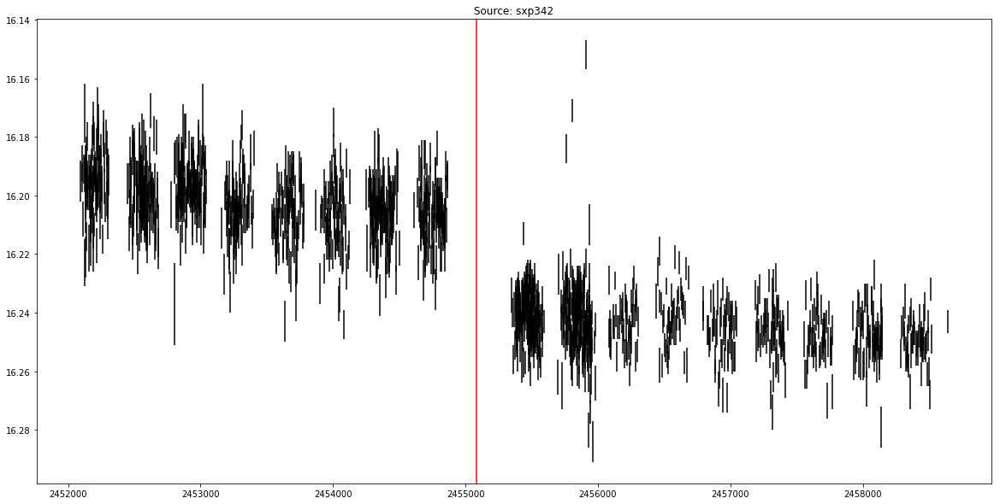

In [25]:
data = np.loadtxt(data_path+"/ogle_merge/"+"sxp0.92.csv", delimiter=",")
plt.axvline(2455081.5, color="r")
#     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
plt.errorbar(data[:,0], data[:,1], yerr=data[:,2], ecolor="black", fmt=" ")
plt.gca().invert_yaxis()
#     plt.ylim([10,20])
plt.title("Source: {}".format(filename[:-4]))
# plt.ylim([-17,-13])
plt.show()

In [34]:
data[:,0][:722][-1]

2454866.55206

In [38]:
print(np.mean(data[:,1][:722]), np.std(data[:,1][:722]))

16.202376731301936 0.01135583666819506


In [37]:
print(np.mean(data[:,1][722:]), np.std(data[:,1][722:]))

16.244159817351598 0.010765397749424765


In [41]:
(np.mean(data[:,1][722:])-np.mean(data[:,1][:722]))/np.std(data[:,1][:722])

3.679437039340876

# get orbital info

In [2]:
source_info = pd.read_csv(data_path+"SMC_confirmed.csv")

In [3]:
# data file names matching sources from Mehtap's table
ordered_file_names = [ 'sxp2.37.csv','','','','' ,'sxp7.78.csv', 'sxp8.80.csv', 'sxp9.13.csv','', 'sxp15.3.csv',
                     '', 'sxp25.5.csv','', 'sxp46.6.csv', 'sxp59.0.csv','', 'sxp74.7.csv','sxp82.4.csv','sxp91.1.csv', 'sxp138.csv', 'sxp140.csv','',
                      'sxp169.3.csv',  'sxp172.csv',  'sxp202.csv','','', 'sxp280.4.csv', 'sxp293.csv', 'sxp323.csv','','', 'sxp504.csv', 'sxp565.csv',
                      'sxp701.csv', 'sxp756.csv', 'sxp967.csv','', 'sxp1323.csv',]

In [56]:
len(ordered_file_names)

39

In [53]:
len(source_info.Object.values)

39

In [49]:
source_info.Object.values

array(['SXP2.37', 'SXP2.76', 'SXP3.34', 'SXP5.05', 'SXP6.85', 'SXP7.78',
       'SXP8.80-8.88', 'SXP9.13', 'SXP11.5', 'SXP15.3', 'SXP22.1',
       'SXP25.5', 'SXP31.0', 'SXP46.6', 'SXP59.0', 'SXP65.8', 'SXP74.7',
       'SXP82.4', 'SXP89.0&91.1', 'SXP138', 'SXP140', 'SXP153', 'SXP169',
       'SXP172', 'SXP202A', 'SXP214', 'SXP264', 'SXP280', 'SXP293',
       'SXP323', 'SXP343', 'SXP455', 'SXP504', 'SXP565', 'SXP701',
       'SXP756', 'SXP967', 'SXP1062', 'SXP1323'], dtype=object)

In [9]:
names_period = source_info[["Object", 'P_orb (d)','P_orb (d) II']]
names_period = names_period.join(pd.DataFrame({"file": ordered_file_names}))

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,
9,SXP15.3,74.300,0,sxp15.3.csv


In [14]:
source[1]

Object              SXP2.37
P_orb (d)              18.6
P_orb (d) II              0
file            sxp2.37.csv
Name: 0, dtype: object

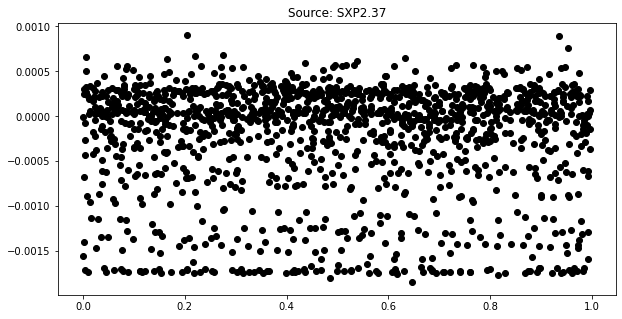

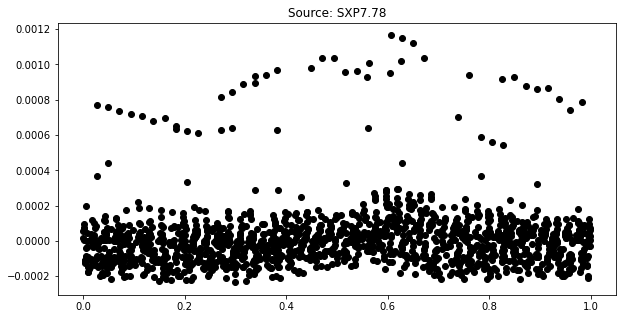

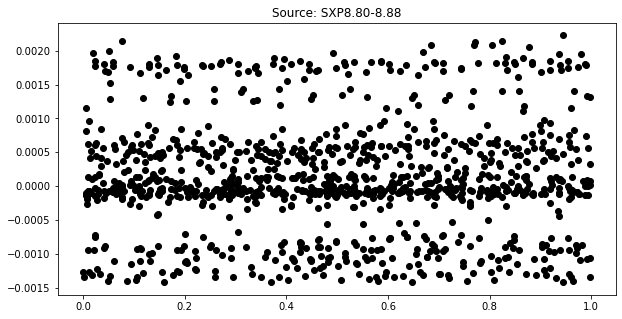

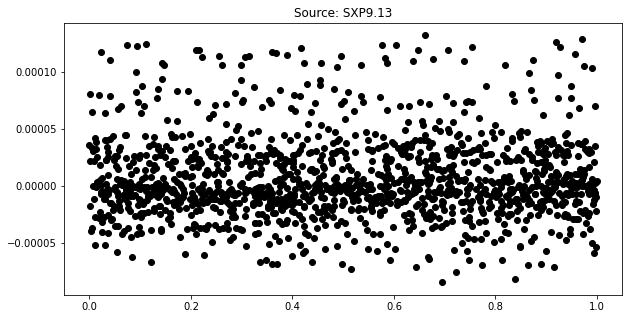

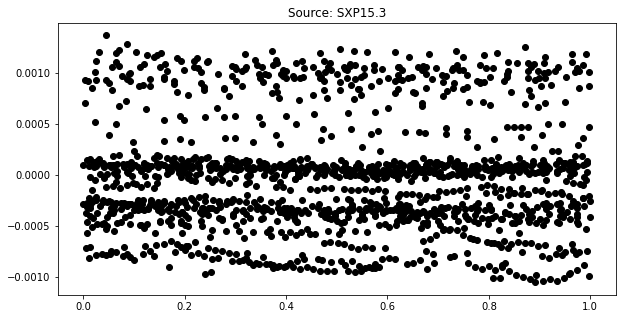

...

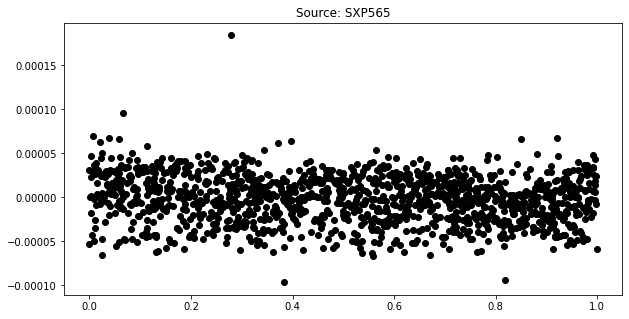

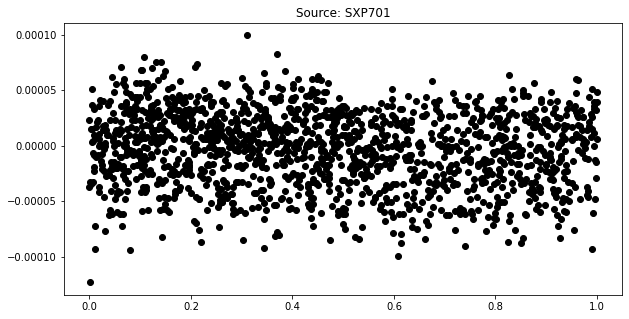

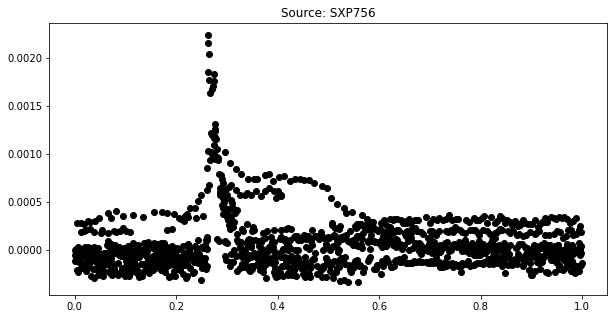

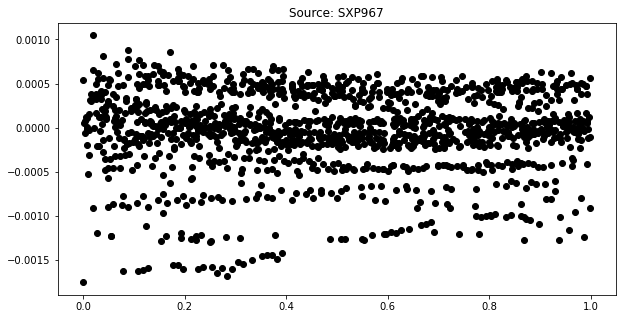

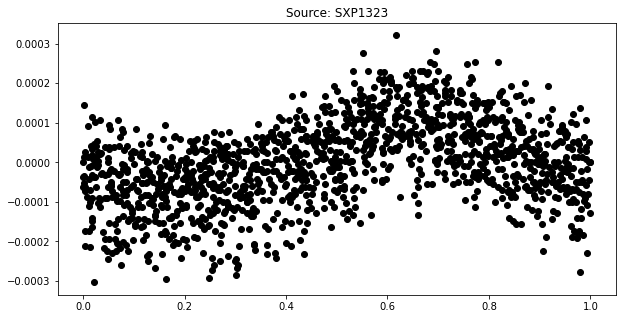

In [145]:
for source_?    RXTE pulsar – sky location unclear, source in names_period.iterrows():
    if len(source["file"])>0:
        data = np.loadtxt(data_path+"ogle_merge/"+source["file"], delimiter=",", dtype=float)
        #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
        data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
        data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
        data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
        data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])
        
        foldTimes=(data_df["ds"]-data_df["ds"][0])/source["P_orb (d)"]
        foldTimes=foldTimes%1
        plt.scatter(foldTimes, data_df["y"], color="black")
    #     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
        #     plt.ylim([10,20])
        plt.title("Source: {}".format(source["Object"]))
        # plt.ylim([-17,-13])
        plt.show()
    #     break
    
#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [ ]:
for source_index, source in names_period.iterrows():
    if len(source["file"])>0:
        data = np.loadtxt(data_path+"ogle_merge/"+source["file"], delimiter=",")
        #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
        foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
        foldTimes=foldTimes%1
        plt.errorbar(foldTimes, data[:,1], yerr=data[:,2], ecolor="black", fmt=" ")
    #     plt.axvline(2455081.5-data[:,0][0], color="r")
        plt.gca().invert_yaxis()
        #     plt.ylim([10,20])
        plt.title("Source: {}".format(source["Object"]))
        # plt.ylim([-17,-13])
        plt.show()
    #     break
    
#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [ ]:
# Photometry data files contain 5 columns: Hel.JD, I magnitude, magnitude error, seeing estimation (in pixels - 0.26"/pixel) and sky level

sources={}

data_path = "../"


for root, dirnames, filenames in os.walk(data_path+"/ogle4"):
    for filename in fnmatch.filter(filenames, "phot.dat"):
        source_name = root.split("/")[-1]
        lc_path_4 = os.path.join(root, filename)
        lc_path_3 = os.path.join(root.replace("ogle4", "ogle3"), filename)
        try:
            ogle3 = np.loadtxt(lc_path_3)
            ogle4 = np.loadtxt(lc_path_4)
            data = np.vstack((ogle3, ogle4))
            sources[root.split("/")[-1]] = len(data)
#             np.savetxt(data_path+"/ogle_merge/{}.csv".format(source_name), data, delimiter=",")
        except:
            pass

In [32]:
# Python
import pandas as pd
from fbprophet import Prophet

Importing plotly failed. Interactive plots will not work.


In [41]:
data = np.loadtxt(data_path+"/ogle_merge/"+"sxp756.csv", delimiter=",")

In [42]:
data[0][0]

2452085.90914

<ErrorbarContainer object of 3 artists>

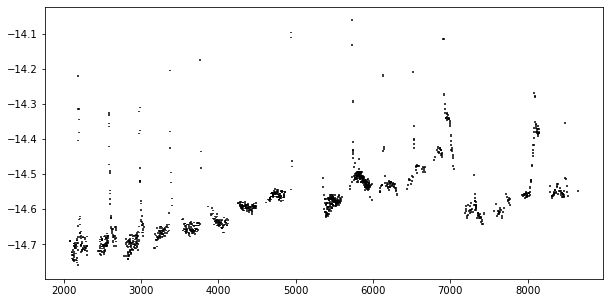

In [44]:
plt.errorbar(data[:,0]-2450000, data[:,1]*-1, yerr=data[:,2], ecolor="black", fmt=" ")

In [40]:
2452086.92527 - 2440000.5

12086.425270000007

In [ ]:
# ogle date is HJD
#data[0][0] - 2440000.5 #+0.5-10000 # need to subtract 9999.5 from TJD to get Tony's first timestamp for SXP2.37 (data[0][0] is 2452086.92527)
# 2086.9 TJD is 08-02-1974, 12086.4 is 26-06-2001
# it's actually AJD - 2450000
# TJD=Floor [ JD[mo,day,yr] ] - 2440000.5
data[0][0] - 2450000

In [353]:
data = np.loadtxt(data_path+"ogle_merged/"+"sxp91.1.csv", delimiter=",") # "rx-j0052.1-7319.csv"

In [354]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)
# data_df["y"][data_df["ds"]<"2010-01-01"] = data_df["y"][data_df["ds"]<"2010-01-01"]- np.median(data_df["y"][data_df["ds"]<"2010-01-01"])
# data_df["y"][data_df["ds"]>"2010-01-01"] = data_df["y"][data_df["ds"]>"2010-01-01"]- np.median(data_df["y"][data_df["ds"]>"2010-01-01"])
# data_df["y"] = data_df["y"]+15

In [355]:
# Python
m = Prophet(
    growth='linear',
    changepoints=None,
    n_changepoints=25,
    changepoint_range=0.8,
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=False,
    holidays=None,
    seasonality_mode='additive',
    seasonality_prior_scale=10.0,
    holidays_prior_scale=10.0,
    changepoint_prior_scale=0.05,
    mcmc_samples=0,
    interval_width=0.8,
    uncertainty_samples=1000,
    stan_backend=None,
) #"07-09-2009"
m.add_seasonality(name='orbital', period=88.4, fourier_order=5)
m.fit(data_df)

In [356]:
# future = m.make_future_dataframe(periods=1)
# future.tail()

In [357]:
forecast = m.predict(pd.DataFrame(data_df["ds"]))
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1270,2019-12-27 01:27:08.928,0.003141,0.003104,0.003173
1271,2019-12-31 02:14:15.936,0.003145,0.003109,0.003184
1272,2020-01-09 01:52:08.832,0.003143,0.003104,0.003181
1273,2020-01-14 02:11:13.632,0.003159,0.003122,0.003195
1274,2020-01-21 01:45:21.024,0.003222,0.003187,0.003260


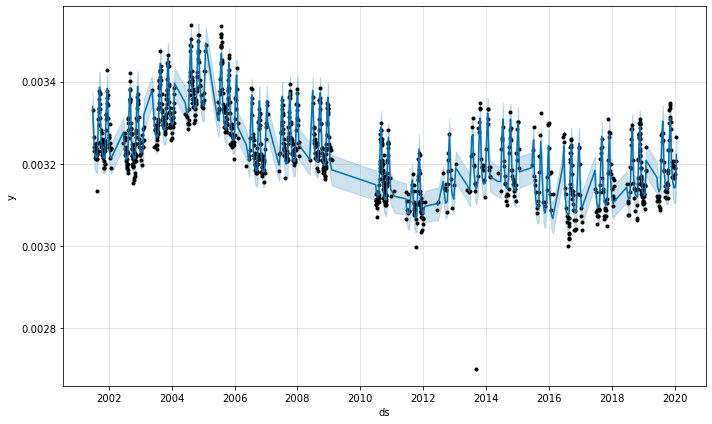

In [358]:
fig1 = m.plot(forecast)

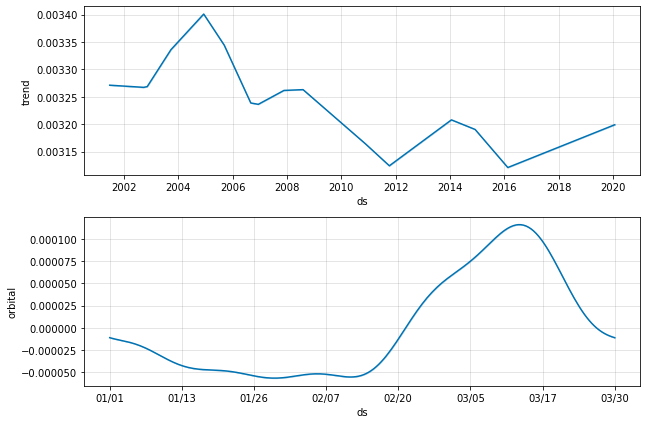

In [359]:
fig = m.plot_components(forecast)

In [360]:
forecast['trend'].values.shape

(1275,)

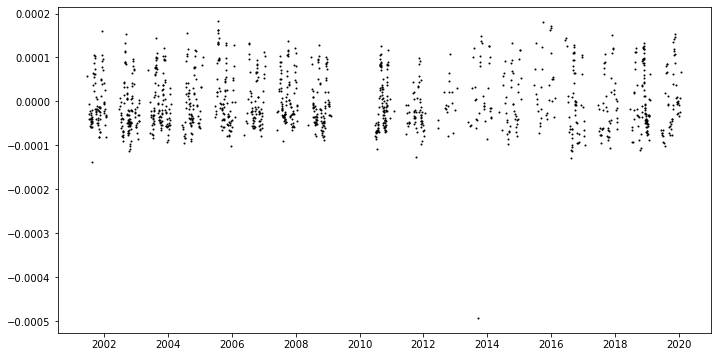

In [361]:
plt.scatter(data_df["ds"].values,data_df["y"].values-forecast['trend'].values, s=1, c="black")
plt.show()

In [362]:
print(forecast['trend'])

0       0.003271
1       0.003271
2       0.003271
3       0.003271
4       0.003271
          ...   
1270    0.003198
1271    0.003198
1272    0.003198
1273    0.003199
1274    0.003199
Name: trend, Length: 1275, dtype: float64


Init signature:
Prophet(
    growth='linear',
    changepoints=None,
    n_changepoints=25,
    changepoint_range=0.8,
    yearly_seasonality='auto',
    weekly_seasonality='auto',
    daily_seasonality='auto',
    holidays=None,
    seasonality_mode='additive',
    seasonality_prior_scale=10.0,
    holidays_prior_scale=10.0,
    changepoint_prior_scale=0.05,
    mcmc_samples=0,
    interval_width=0.8,
    uncertainty_samples=1000,
    stan_backend=None,
)
Docstring:     
Prophet forecaster.

Parameters
----------
growth: String 'linear' or 'logistic' to specify a linear or logistic
    trend.
changepoints: List of dates at which to include potential changepoints. If
    not specified, potential changepoints are selected automatically.
n_changepoints: Number of potential changepoints to include. Not used
    if input `changepoints` is supplied. If `changepoints` is not supplied,
    then n_changepoints potential changepoints are selected uniformly from
    the first `changepoint_range` proportion of the history.
changepoint_range: Proportion of history in which trend changepoints will
    be estimated. Defaults to 0.8 for the first 80%. Not used if
    `changepoints` is specified.
yearly_seasonality: Fit yearly seasonality.
    Can be 'auto', True, False, or a number of Fourier terms to generate.
weekly_seasonality: Fit weekly seasonality.
    Can be 'auto', True, False, or a number of Fourier terms to generate.
daily_seasonality: Fit daily seasonality.
    Can be 'auto', True, False, or a number of Fourier terms to generate.
holidays: pd.DataFrame with columns holiday (string) and ds (date type)
    and optionally columns lower_window and upper_window which specify a
    range of days around the date to be included as holidays.
    lower_window=-2 will include 2 days prior to the date as holidays. Also
    optionally can have a column prior_scale specifying the prior scale for
    that holiday.
seasonality_mode: 'additive' (default) or 'multiplicative'.
seasonality_prior_scale: Parameter modulating the strength of the
    seasonality model. Larger values allow the model to fit larger seasonal
    fluctuations, smaller values dampen the seasonality. Can be specified
    for individual seasonalities using add_seasonality.
holidays_prior_scale: Parameter modulating the strength of the holiday
    components model, unless overridden in the holidays input.
changepoint_prior_scale: Parameter modulating the flexibility of the
    automatic changepoint selection. Large values will allow many
    changepoints, small values will allow few changepoints.
mcmc_samples: Integer, if greater than 0, will do full Bayesian inference
    with the specified number of MCMC samples. If 0, will do MAP
    estimation.
interval_width: Float, width of the uncertainty intervals provided
    for the forecast. If mcmc_samples=0, this will be only the uncertainty
    in the trend using the MAP estimate of the extrapolated generative
    model. If mcmc.samples>0, this will be integrated over all model
    parameters, which will include uncertainty in seasonality.
uncertainty_samples: Number of simulated draws used to estimate
    uncertainty intervals. Settings this value to 0 or False will disable
    uncertainty estimation and speed up the calculation.
stan_backend: str as defined in StanBackendEnum default: None - will try to
    iterate over all available backends and find the working one
File:           ~/anaconda3/envs/py38/lib/python3.8/site-packages/fbprophet/forecaster.py
Type:           type
Subclasses:     

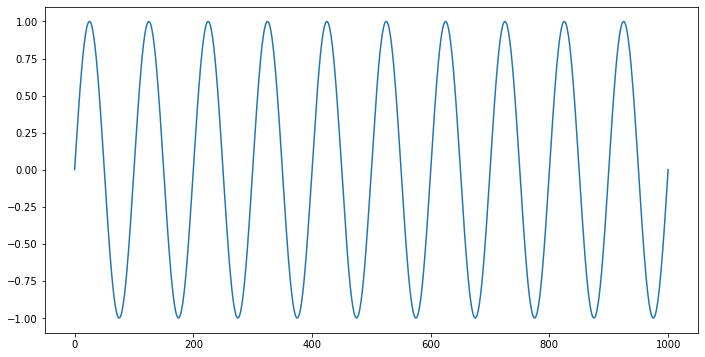

In [443]:
x = np.linspace(0,1000,num=1000)
period = 100
f=1/period
y = np.sin(x*f*np.pi*2)
show=int(len(x))
plt.plot(x[:show],y[:show])
plt.show()

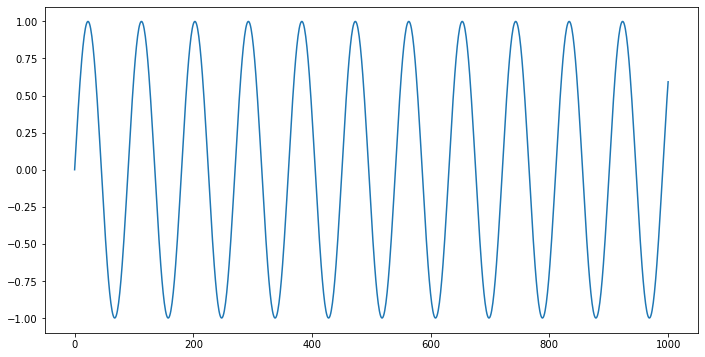

In [902]:
x = np.linspace(0,1000,num=1000)
period = 0.99
f=1/period
y = np.sin(x*f*np.pi*2)
show=int(len(x))
plt.plot(x[:show],y[:show])
plt.show()

In [901]:
0.98

0.98

In [543]:
1000/0.22*2

9090.90909090909

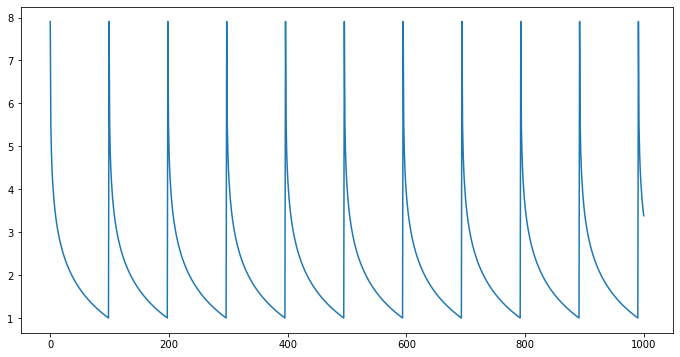

In [899]:
x = np.linspace(0,1000,num=1000)
period = 0.99
f=1/period
log_fix = 0.001
y = np.ones(len(x))-np.log((np.arange(len(x))%period)/period+log_fix)
show=int(len(x)/1)
plt.plot(x[:show],y[:show])
plt.show()

In [ ]:
Signature:
libwwz.wwt(
    timestamps: numpy.ndarray,
    magnitudes: numpy.ndarray,
    time_divisions: int,
    freq_params: list,
    decay_constant: float,
    method: str = 'linear',
    parallel: bool = True,
) -> numpy.ndarray
Docstring:
The code is based on G. Foster's FORTRAN
code as well as eaydin's python 2.7 code. The code is updated to use numpy methods and allow for float value tau.
It returns an array with matrix of new evenly spaced timestamps, frequencies, wwz-power, amplitude, coefficients,
and effective number. Specific equations can be found on Grant Foster's "WAVELETS FOR PERIOD ANALYSIS OF UNEVENLY
SAMPLED TIME SERIES". Some of the equations are labeled in the code with corresponding numbers.

:param timestamps: An array with corresponding times for the magnitude (payload).
:param magnitudes: An array with payload values
:param time_divisions: number of divisions for the new timestamps
:param freq_params: A list containing parameters for making frequency bands to analyze over with given 'method'
        'linear' -> [freq_low, freq_high, freq_step, override]
        'octave' -> [freq_tg, freq_low, freq_high, band_order, log_scale_base, override]
:param decay_constant: decay constant for the Morlet wavelet (should be <0.02) eq. 1-2
        c = 1/(2w), the wavelet decays significantly after a single cycle of 2 * pi / w
:param method: determines method of creating freq ('linear', 'octave') default 'linear'
:param parallel: boolean indicate to use parallel processing or not
:return: Tau, Freq, WWZ, AMP, COEF, NEFF in a numpy array
File:      ~/anaconda3/envs/py38/lib/python3.8/site-packages/libwwz/wwz.py
Type:      function

In [548]:
import libwwz

wwz_result = libwwz.wwt(timestamps = x, magnitudes =y)

TypeError: wwt() missing 3 required positional arguments: 'time_divisions', 'freq_params', and 'decay_constant'

In [720]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
# data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
# data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

In [562]:
data_df["ds"].values#,detrended["y"]

array([2452086.89595, 2452103.90274, 2452105.93288, ..., 2458857.57788,
       2458862.59113, 2458869.57316])

In [568]:
detrended["y"].values

array([ 5.82762224e-05, -5.32860688e-06, -2.92830741e-05, ...,
       -4.70145943e-05, -1.55965579e-05,  4.27565888e-05])

# wavelet WWZ

Source: SXP89.0&91.1 prophet model Period: 88.37


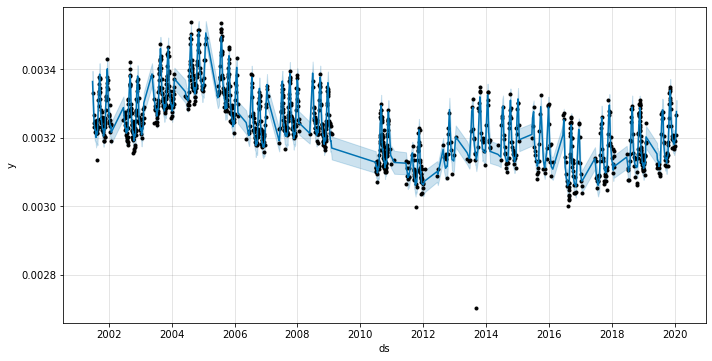

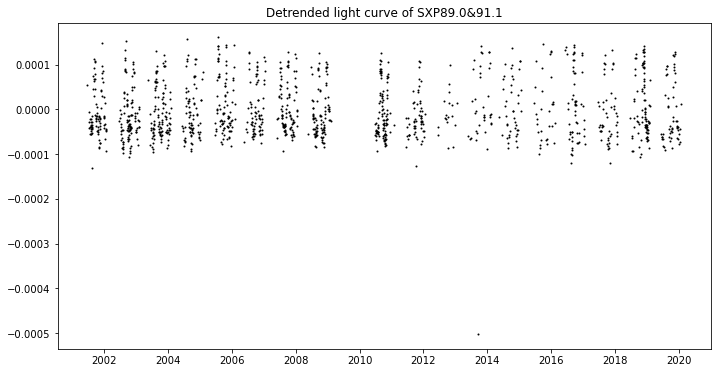

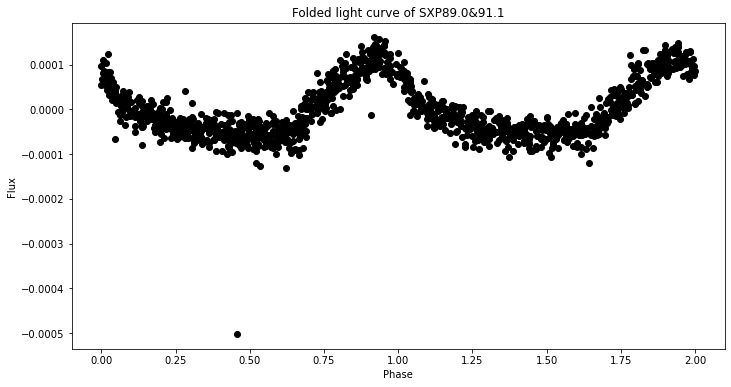

In [1218]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[18,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=50,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=15)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

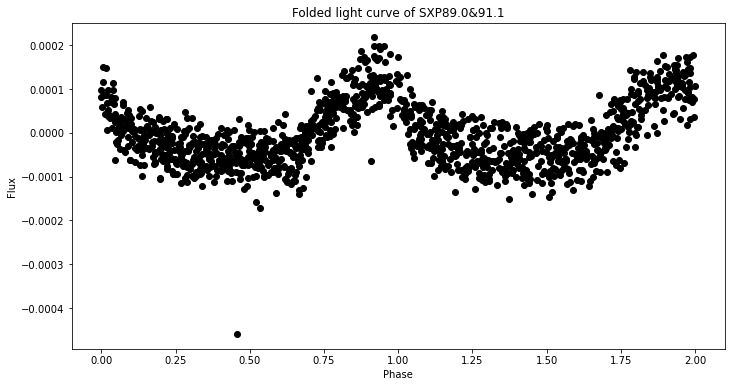

In [1142]:
foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"] #14.06#
foldTimes=foldTimes%2
plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
#     plt.ylim([10,20])
plt.xlabel("Phase")
plt.ylabel("Flux")
plt.title("Folded light curve of {}".format(source["Object"]))
# plt.ylim([-17,-13])
plt.show()

Source: SXP89.0&91.1 prophet model Period: 88.37


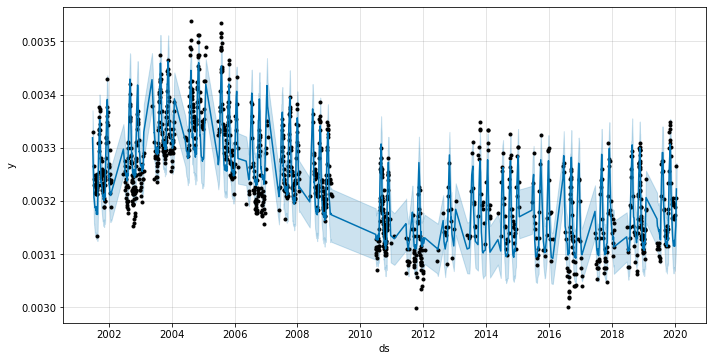

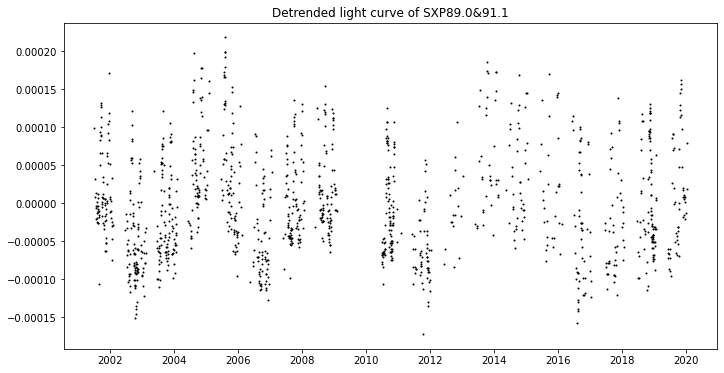

In [1029]:
data_df = pd.DataFrame({"ds": xss,"y": yss})
m = Prophet(
    growth='linear',
    changepoints=None,
    n_changepoints=5,
    changepoint_range=0.99,
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=False,
    holidays=None,
    seasonality_mode='additive',
    seasonality_prior_scale=10.0,
    holidays_prior_scale=10.0,
    changepoint_prior_scale=0.05,
    mcmc_samples=0,
    interval_width=0.8,
    uncertainty_samples=1000,
    stan_backend=None,
) #"07-09-2009"
m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=15)
m.add_seasonality(name='super-orbital', period=267, fourier_order=5)
m.fit(data_df)

forecast = m.predict(pd.DataFrame(data_df["ds"]))
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

# plot data with prophet model
print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
fig1 = m.plot(forecast)
fig = plt.gcf()
fig.set_size_inches(10,5)
plt.show()
# plot data with trend subtracted
detrended = data_df.copy(deep=True)
detrended["y"] = data_df["y"].values-forecast['trend'].values
plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
plt.title("Detrended light curve of {}".format(source["Object"]))
plt.show()

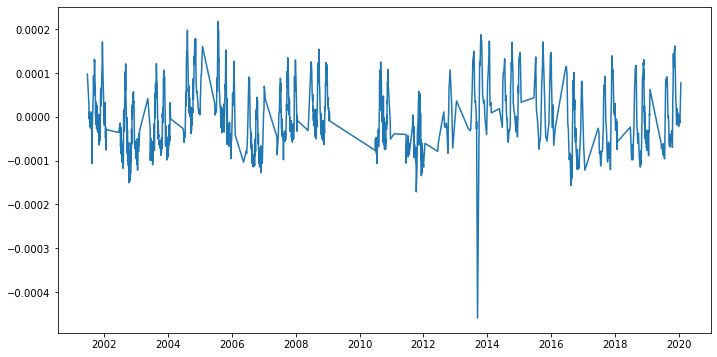

In [1096]:
plt.plot(data_df["ds"].values,detrended["y"])
plt.show()

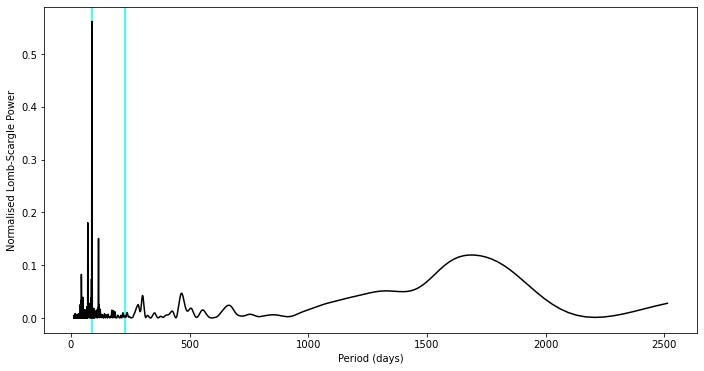

In [1125]:
f = np.linspace(1/400, 1/2, 10000)

pgram = signal.lombscargle(data[:,0],detrended["y"], f, normalize=True)

plt.subplot(1, 1, 1)
plt.axvline(x=88.37, c="cyan")
plt.axvline(x=230, c="cyan")


plt.plot((1/f)*(2*np.pi), pgram, c="black")
plt.xlabel("Period (days)")
plt.ylabel("Normalised Lomb-Scargle Power")
plt.show()

In [1123]:
88.37*6.28

554.9636

In [1106]:
data[:,0][-1]-data[:,0][0]

6782.677210000344

In [1102]:
88.37/(1/f[np.argmax(pgram)])

6.284177267726773

In [1108]:
(1/f[np.argmax(pgram)])*(2*np.pi)

88.35605075098613

In [1181]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 1200

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
frequency_steps = np.linspace(frequency_low, frequency_high, num=2000)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 50     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1172]:
decay_constant

0.0031662869888230555

In [1151]:
np.argmin(data_df["y"].values)

921

In [1152]:
xss = np.concatenate((data_df["ds"].values[:921], data_df["ds"].values[922:]))

In [1182]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=xss,#data_df["ds"].values,
                     magnitudes=yss,#detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.493
largest tau window is  5.657
4406.26 seconds has passed to complete Weighted Wavelet Z-transform 



In [1159]:
"""
This module provides functions for plotting the outcomes of wwz.py. It focuses on making proper grids for pcolormesh.
"""

import matplotlib.ticker as ticker
import matplotlib.axes as axes
import numpy as np


def make_linear_freq_plot_grid(freq_mat: np.ndarray) -> np.ndarray:
    """
    Used for linear method.
    Takes the FREQ output from wwz.py and creates a grid for pcolormesh.
    :param freq_mat: FREQ output from wwz.py
    :return: freq_grid: np.ndarray with the boundaries for the FREQ output
    """

    # Get the array of center frequencies from the freq_mat
    freq_centers = freq_mat[0, :]

    # Get the freq_steps by subtracting the first two freq_centers
    freq_step = freq_centers[1] - freq_centers[0]

    # Subtract half of the freq_step from the freq_centers to get lower bound
    freq_lows = freq_centers - freq_step / 2

    # Append the high frequency bound to get all the boundaries
    freq_highest = freq_centers.max() + freq_step / 2
    freq_bounds = np.append(freq_lows, freq_highest)

    # Tile the freq_bounds to create a grid
    freq_grid = np.tile(freq_bounds, (freq_mat.shape[0] + 1, 1))

    return freq_grid


def make_octave_freq_plot_grid(freq_mat: np.ndarray, band_order: float, log_scale_base: float) -> np.ndarray:
    """
    Used for octave method.
    Takes the FREQ output from wwz.py and creates a grid for pcolormesh
    :param freq_mat: FREQ output from wwz.py
    :param band_order: octave band order (N => 1) *Recommend N = (1, 3, 6, 12, 24,...)
    :param log_scale_base: logarithmic scale base to create the octaves
    :return:req_grid: np.ndarray with the boundaries for the FREQ output
    """

    # Get the array of the center frequencies from the freq_mat
    freq_centers = freq_mat[0, :]

    # Convert the center frequencies to low frequencies
    freq_lows = freq_centers / log_scale_base**(1 / (2 * band_order))

    # Append the high frequency at the end to get all the boundaries
    freq_highest = freq_centers.max() * log_scale_base**(1 / (2 * band_order))
    freq_bounds = np.append(freq_lows, freq_highest)

    # Tile the freq_bounds to create a grid
    freq_grid = np.tile(freq_bounds, (freq_mat.shape[0] + 1, 1))

    return freq_grid


def make_tau_plot_grid(tau_mat: np.ndarray) -> np.ndarray:
    """
    Used for both octave and linear.
    Takes the TAU output from wwz.py and creates a grid for pcolormesh
    :param tau_mat: TAU output from wwz.py
    :return:
    """

    # Get the tau values from tau_mat
    taus = tau_mat[:, 0]

    # Append one tau value for edge limit by adding the step to the largest tau
    taus = np.append(taus, taus[-1] + taus[1] - taus[0])

    # Tile the taus with an additional column to create grid that matches freq_grid
    tau_grid = np.tile(taus, (tau_mat.shape[1] + 1, 1)).transpose()

    return tau_grid


def linear_plotter(ax: axes, TAU: np.ndarray, FREQ: np.ndarray, DATA: np.ndarray):
    """
    Creates a plot for the 'linear' method.
    You can add titles after calling the plotter.
    :param ax: axis from a matplotlib.pyplot.subplots() to plot the data
    :param TAU: TAU output of the wwz.py (the time shifts)
    :param FREQ: FREQ output of the wwz.py (the frequencies)
    :param DATA: Desired data to be plotted
    :return:
    """

    # Create grid for pcolormesh boundaries
    tau_grid = make_tau_plot_grid(TAU)
    freq_grid = make_linear_freq_plot_grid(FREQ)

    # Plot using subplots
    im = ax.pcolormesh(tau_grid, freq_grid, DATA)

    # Add color bar and fix y_ticks
    ax.figure.colorbar(im, ax=ax)
    ax.set_yticks(FREQ[0, :])
    ax.get_yaxis().set_major_formatter(ticker.ScalarFormatter())


def octave_plotter(ax: axes, TAU: np.ndarray, FREQ: np.ndarray, DATA: np.ndarray,
                   band_order: float, log_scale_base: float, log_y_scale: bool = True):
    """
    Creates a plot for the 'linear' method.
    You can add titles after calling the plotter.
    :param ax: axis from a matplotlib.pyplot.subplots() to plot the data
    :param TAU: TAU output of the wwz.py (the time shifts)
    :param FREQ: FREQ output of the wwz.py (the frequencies)
    :param DATA: Desired data to be plotted
    :param band_order: octave band order (N => 1) *Recommend N = (1, 3, 6, 12, 24,...)
    :param log_scale_base: logarithmic scale base to create the octaves
    :param log_y_scale: determines if the plot y_scale should be 'log' or not.
    :return:
    """
    # Create grid for pcolormesh boundaries
    tau_grid = make_tau_plot_grid(TAU)
    freq_grid = make_octave_freq_plot_grid(FREQ, band_order, log_scale_base)

    # Plot using subplots
    im = ax.pcolormesh(tau_grid, freq_grid, DATA)

    # Add color bar, fix y_scale, and fix y_ticks
    ax.figure.colorbar(im, ax=ax)
    if log_y_scale is True:
        ax.set_yscale('log', base=log_scale_base)
    ax.set_yticks(FREQ[0, :])
    ax.get_yaxis().set_major_formatter(ticker.ScalarFormatter())

In [1163]:
import matplotlib.colors as colors
def linear_plotter_log(ax: axes, TAU: np.ndarray, FREQ: np.ndarray, DATA: np.ndarray):
    """
    Creates a plot for the 'linear' method.
    You can add titles after calling the plotter.
    :param ax: axis from a matplotlib.pyplot.subplots() to plot the data
    :param TAU: TAU output of the wwz.py (the time shifts)
    :param FREQ: FREQ output of the wwz.py (the frequencies)
    :param DATA: Desired data to be plotted
    :return:
    """

    # Create grid for pcolormesh boundaries
    tau_grid = make_tau_plot_grid(TAU)
    freq_grid = make_linear_freq_plot_grid(FREQ)

    # Plot using subplots
    im = ax.pcolormesh(tau_grid, freq_grid, DATA, norm=colors.LogNorm(vmin=DATA.min(), vmax=DATA.max()))

    # Add color bar and fix y_ticks
    ax.figure.colorbar(im, ax=ax)
    ax.set_yticks(FREQ[0, :])
    ax.get_yaxis().set_major_formatter(ticker.ScalarFormatter())

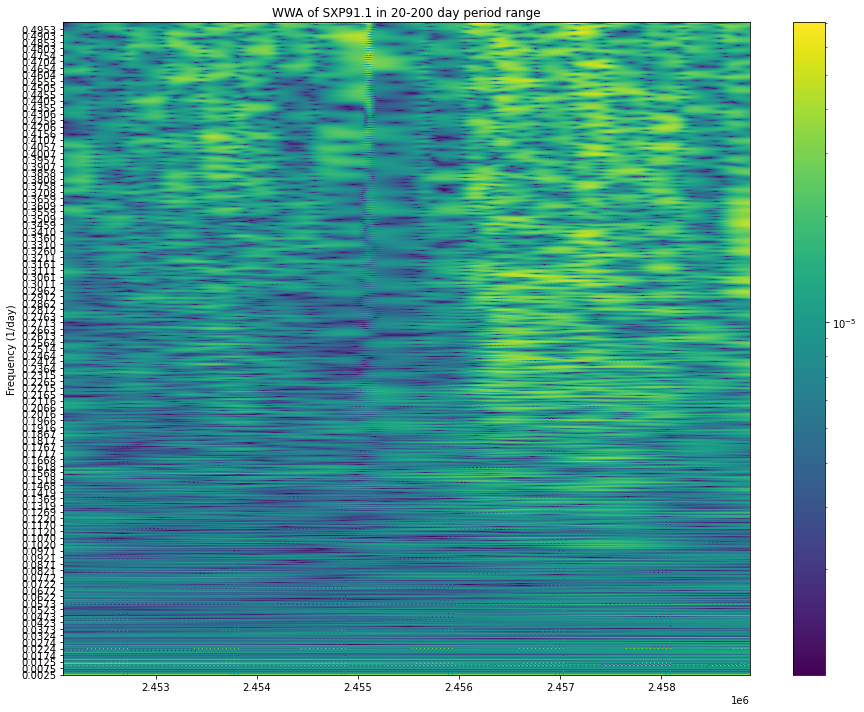

In [1183]:
import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.000001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP91.1 in 20-200 day period range')

plt.tight_layout()

In [ ]:
#ax.xaxis.set_major_locator(plt.MaxNLocator(3))

In [1167]:
np.min(wwt_sxp89[3])

0.0

In [862]:
data_df

,ds,y
0,2001-06-26 09:30:10.080000000,0.003330
1,2001-07-13 09:39:56.736000000,0.003266
2,2001-07-15 10:23:20.832000000,0.003242
3,2001-07-16 09:33:51.263999999,0.003230
4,2001-07-22 08:25:17.760000000,0.003248
...,...,...
1270,2019-12-27 01:27:08.928000000,0.003165
1271,2019-12-31 02:14:15.936000000,0.003189
1272,2020-01-09 01:52:08.832000000,0.003174
1273,2020-01-14 02:11:13.632000000,0.003206


In [1091]:
f = np.linspace(1/400, 1/2, 10000)

data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)


import scipy.signal as signal
pgram = signal.lombscargle(data_df["ds"].values, detrended["y"].values, f, normalize=True)

plt.subplot(1, 1, 1)
plt.axvline(x=88.37, c="cyan")
plt.plot(1/f, pgram, c="black")
plt.xlabel("Period (days)")
plt.ylabel("Normalised Lomb-Scargle Power")
plt.show()

ValueError: Input arrays do not have the same size.

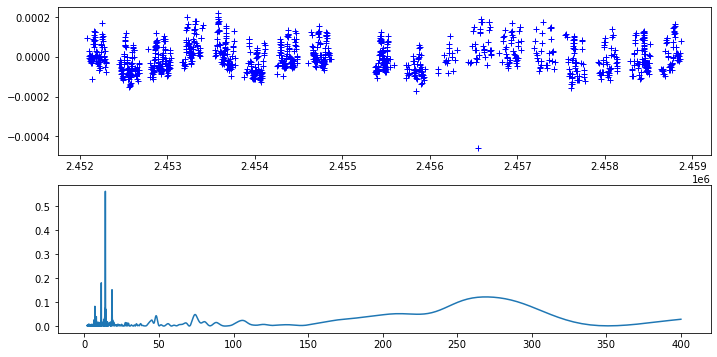

In [931]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)

plt.subplot(2, 1, 1)
plt.plot(data_df["ds"].values, detrended["y"].values, 'b+')

plt.subplot(2, 1, 2)
plt.plot(1/f, pgram)
plt.show()



In [880]:
1/f[np.argsort(pgram)][-20:]

array([11.32790484, 14.15141404, 13.97430567, 14.141457  , 13.98402864,
       14.13151395, 13.99376515, 14.12158488, 14.00351523, 14.11166975,
       14.01327891, 14.10176854, 14.02305621, 14.09188121, 14.03284716,
       14.08200773, 14.0426518 , 14.05247014, 14.07214808, 14.06230223])

In [919]:
forecast['high power'].values.shape

(1275,)

In [921]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,high power,high power_lower,high power_upper,orbital,orbital_lower,orbital_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2001-06-26 09:30:10.080000000,0.003234,0.003268,0.003373,0.003234,0.003234,0.000087,0.000087,0.000087,0.000002,0.000002,0.000002,0.000085,0.000085,0.000085,0.0,0.0,0.0,0.003321
1,2001-07-13 09:39:56.736000000,0.003236,0.003171,0.003272,0.003236,0.003236,-0.000017,-0.000017,-0.000017,0.000006,0.000006,0.000006,-0.000024,-0.000024,-0.000024,0.0,0.0,0.0,0.003219
2,2001-07-15 10:23:20.832000000,0.003237,0.003153,0.003255,0.003237,0.003237,-0.000034,-0.000034,-0.000034,-0.000003,-0.000003,-0.000003,-0.000030,-0.000030,-0.000030,0.0,0.0,0.0,0.003203
3,2001-07-16 09:33:51.263999999,0.003237,0.003158,0.003264,0.003237,0.003237,-0.000029,-0.000029,-0.000029,0.000005,0.000005,0.000005,-0.000034,-0.000034,-0.000034,0.0,0.0,0.0,0.003208
4,2001-07-22 08:25:17.760000000,0.003238,0.003137,0.003244,0.003238,0.003238,-0.000048,-0.000048,-0.000048,0.000001,0.000001,0.000001,-0.000049,-0.000049,-0.000049,0.0,0.0,0.0,0.003190
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1270,2019-12-27 01:27:08.928000000,0.003185,0.003070,0.003177,0.003185,0.003185,-0.000063,-0.000063,-0.000063,-0.000005,-0.000005,-0.000005,-0.000058,-0.000058,-0.000058,0.0,0.0,0.0,0.003123
1271,2019-12-31 02:14:15.936000000,0.003186,0.003080,0.003181,0.003186,0.003186,-0.000052,-0.000052,-0.000052,0.000001,0.000001,0.000001,-0.000054,-0.000054,-0.000054,0.0,0.0,0.0,0.003133
1272,2020-01-09 01:52:08.832000000,0.003186,0.003084,0.003184,0.003186,0.003186,-0.000049,-0.000049,-0.000049,0.000003,0.000003,0.000003,-0.000052,-0.000052,-0.000052,0.0,0.0,0.0,0.003136
1273,2020-01-14 02:11:13.632000000,0.003186,0.003101,0.003207,0.003186,0.003186,-0.000032,-0.000032,-0.000032,0.000001,0.000001,0.000001,-0.000033,-0.000033,-0.000033,0.0,0.0,0.0,0.003154


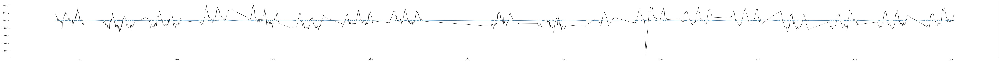

In [925]:
plt.rcParams['figure.figsize'] = (101.7, 6.0)
plt.plot(data_df["ds"].values,detrended["y"], lw=1, c="black")
plt.plot(data_df["ds"].values,forecast['high power'].values)
plt.show()

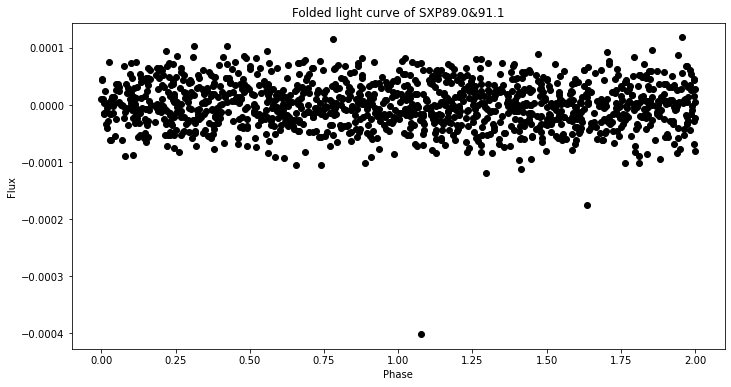

In [924]:
# fold detrended lightcurve
plt.rcParams['figure.figsize'] = (11.7, 6.0)

foldTimes=(data[:,0]-data[:,0][0])/14.06230223#source["P_orb (d)"]
foldTimes=foldTimes%2
plt.scatter(foldTimes, detrended["y"]-forecast['orbital'], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
#     plt.ylim([10,20])
plt.xlabel("Phase")
plt.ylabel("Flux")
plt.title("Folded light curve of {}".format(source["Object"]))
# plt.ylim([-17,-13])
plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

Source: SXP89.0&91.1 prophet model Period: 88.37


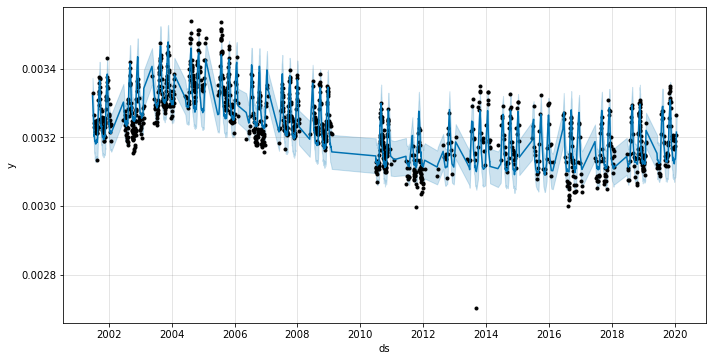

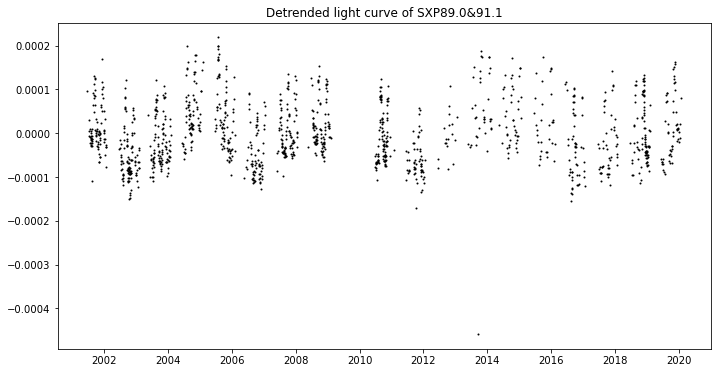

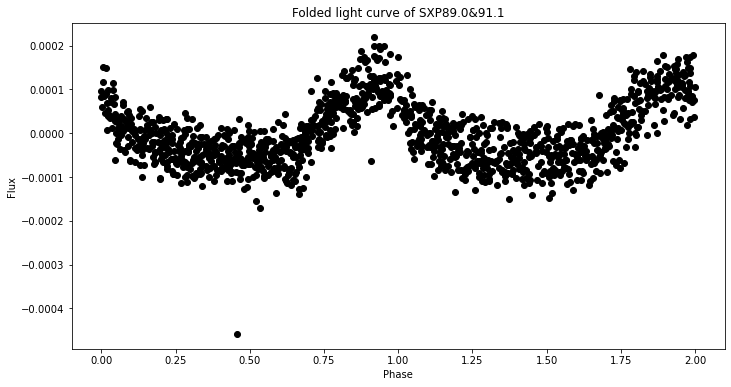

In [914]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[18,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=5,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
    m.add_seasonality(name='high power', period=14.062, fourier_order=5)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

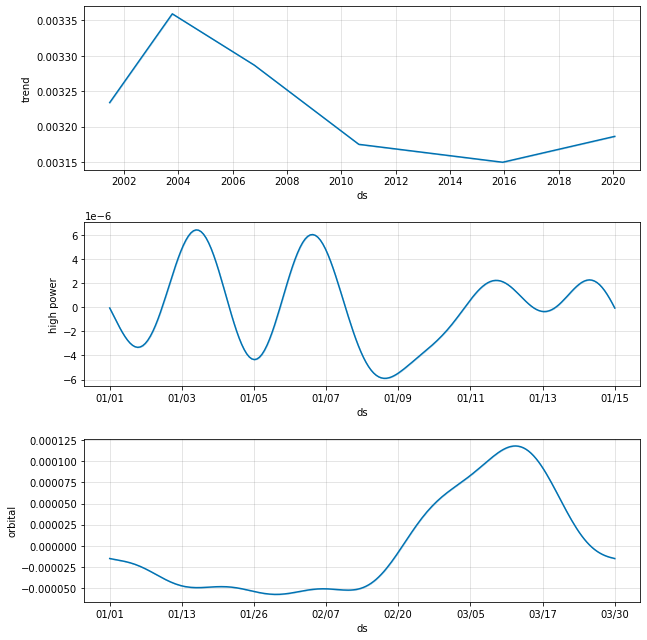

In [915]:
fig = m.plot_components(forecast)

In [893]:
1/14.06

0.07112375533428164

In [870]:
88.37/6

14.728333333333333

Source: SXP214 prophet model Period: 29.9


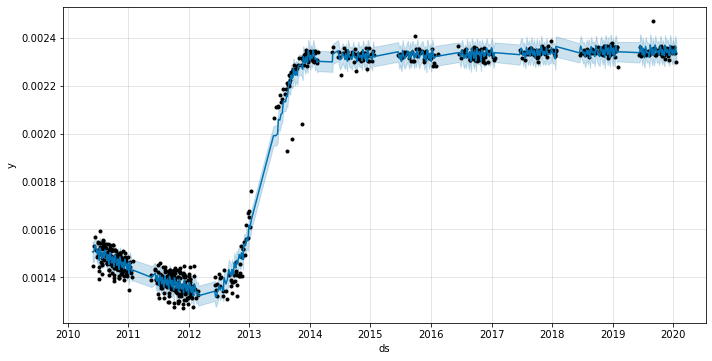

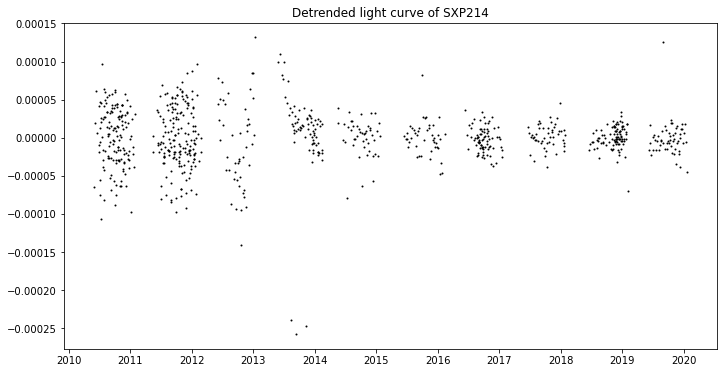

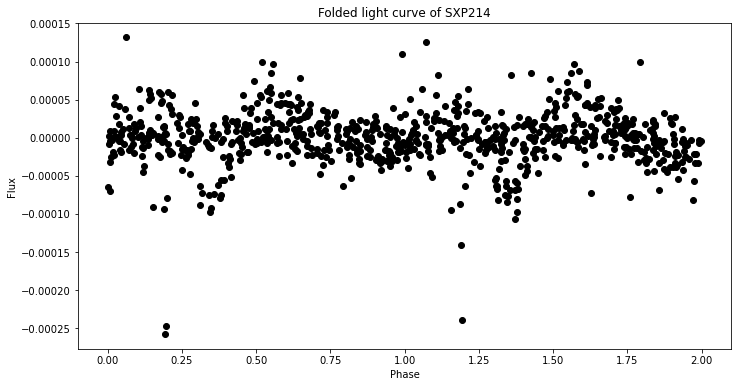

In [818]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[25,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=25,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [848]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 1000

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/50
frequency_high = 1/2
frequency_steps = np.linspace(frequency_low, frequency_high, num=100)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 0.5     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [849]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
3.57 seconds has passed to complete Weighted Wavelet Z-transform 



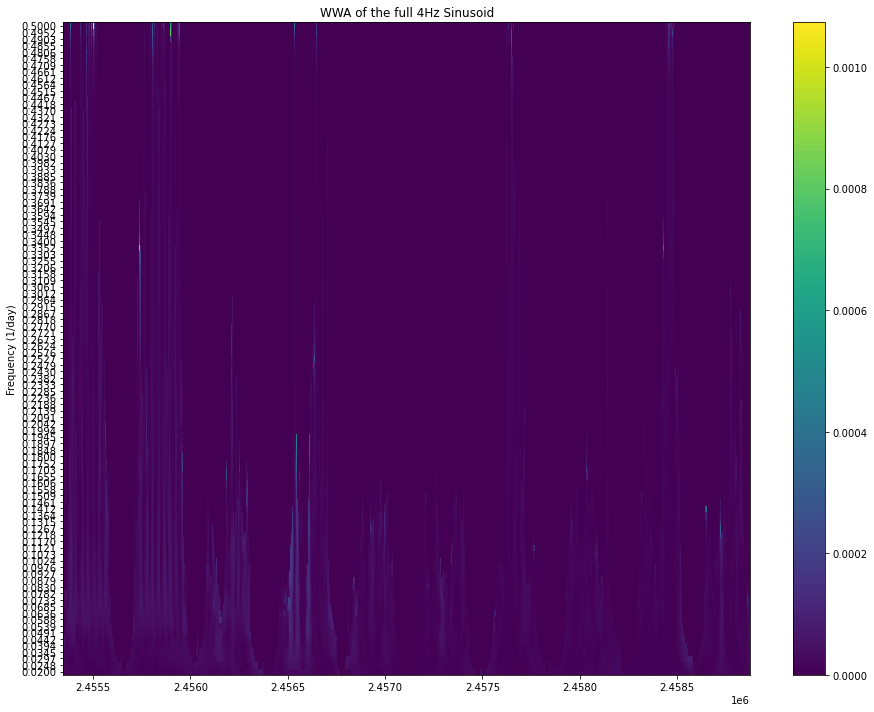

In [850]:
import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')

plt.tight_layout()

In [1158]:
np.max(wwt_sxp89[3])

0.000258050745445313

In [ ]:
timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,

In [731]:
source

Object              SXP31.0
P_orb (d)              90.5
P_orb (d) II              0
file            sxp31.0.csv
Name: 12, dtype: object

Source: SXP31.0 prophet model Period: 90.5


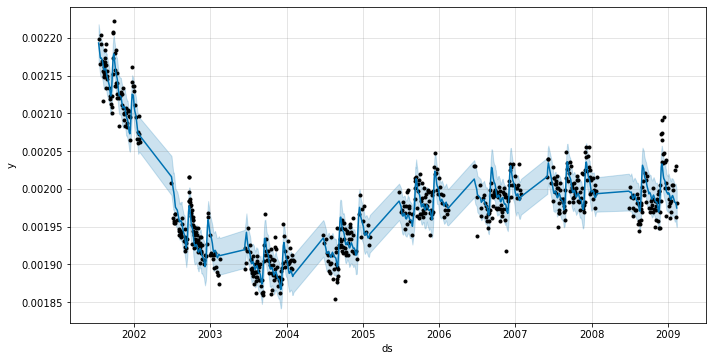

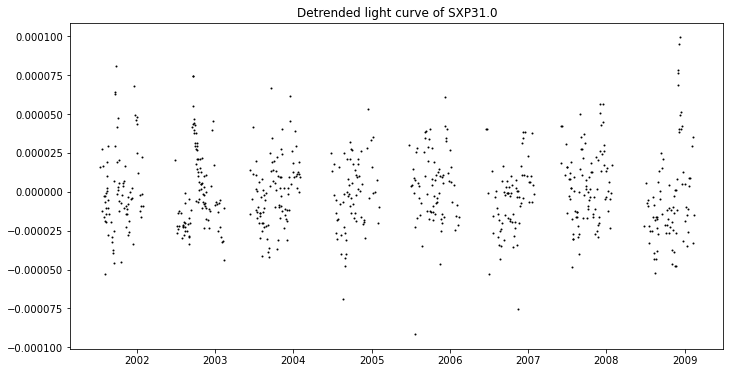

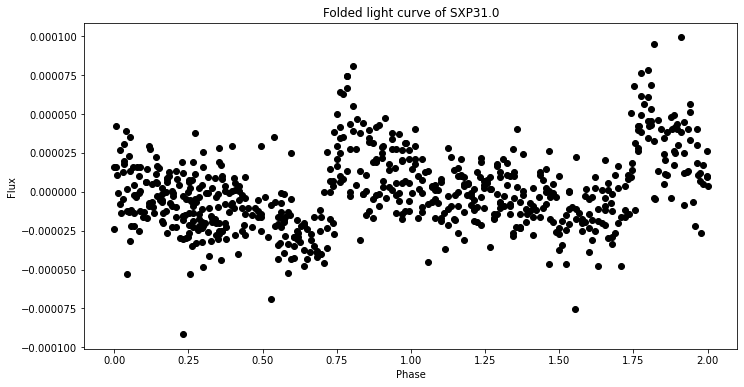

In [889]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[12,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=5,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [804]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 300

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/200
frequency_high = 1/20
frequency_steps = np.linspace(frequency_low, frequency_high, num=100)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 5     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [805]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.497
largest tau window is  9.26
43.55 seconds has passed to complete Weighted Wavelet Z-transform 



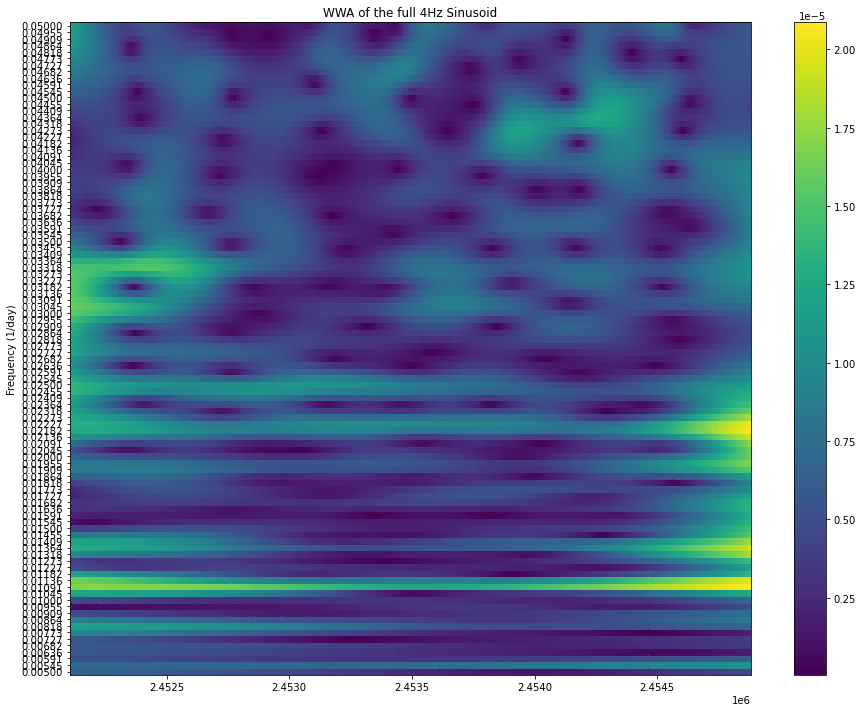

In [806]:
import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')

plt.tight_layout()

In [892]:
1/90.5

0.011049723756906077

In [890]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)


f = np.linspace(1/400, 1/2, 100000)

import scipy.signal as signal
pgram = signal.lombscargle(data_df["ds"].values, detrended["y"].values, f, normalize=True)



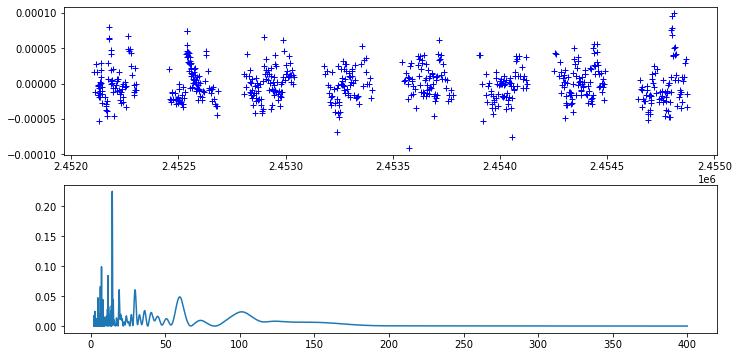

In [891]:
plt.subplot(2, 1, 1)
plt.plot(data_df["ds"].values, detrended["y"].values, 'b+')

plt.subplot(2, 1, 2)
plt.plot(1/f, pgram)
plt.show()



In [854]:
1/90.5

0.011049723756906077

Source: SXP65.8 prophet model Period: 110.6


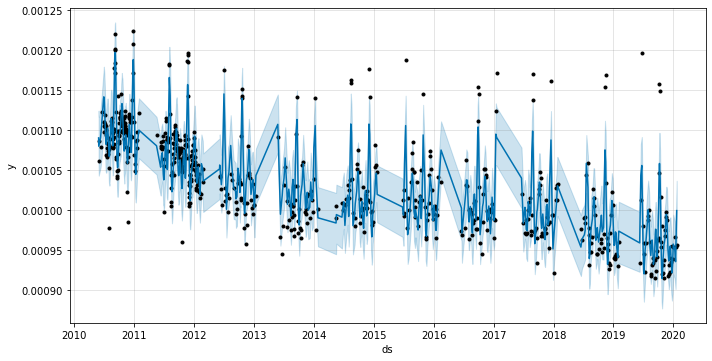

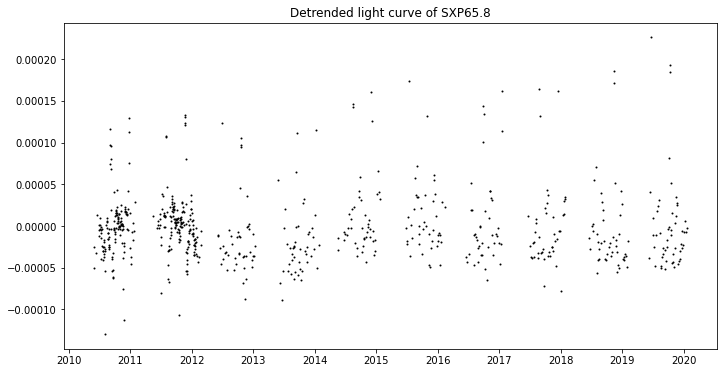

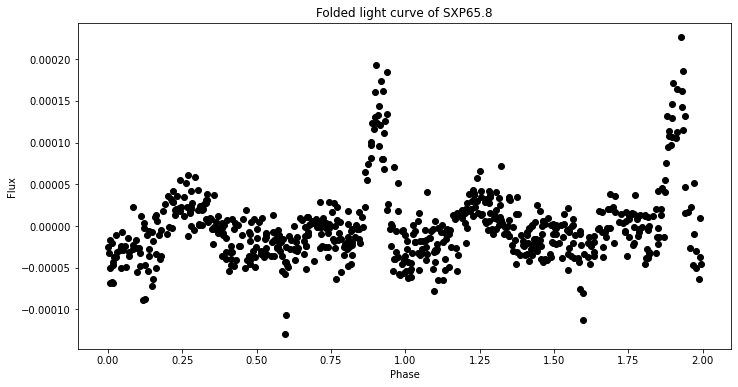

In [807]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[15,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=5,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [799]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 300

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/200
frequency_high = 1/20
frequency_steps = np.linspace(frequency_low, frequency_high, num=100)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 5     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [800]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.334
largest tau window is  11.781
36.74 seconds has passed to complete Weighted Wavelet Z-transform 



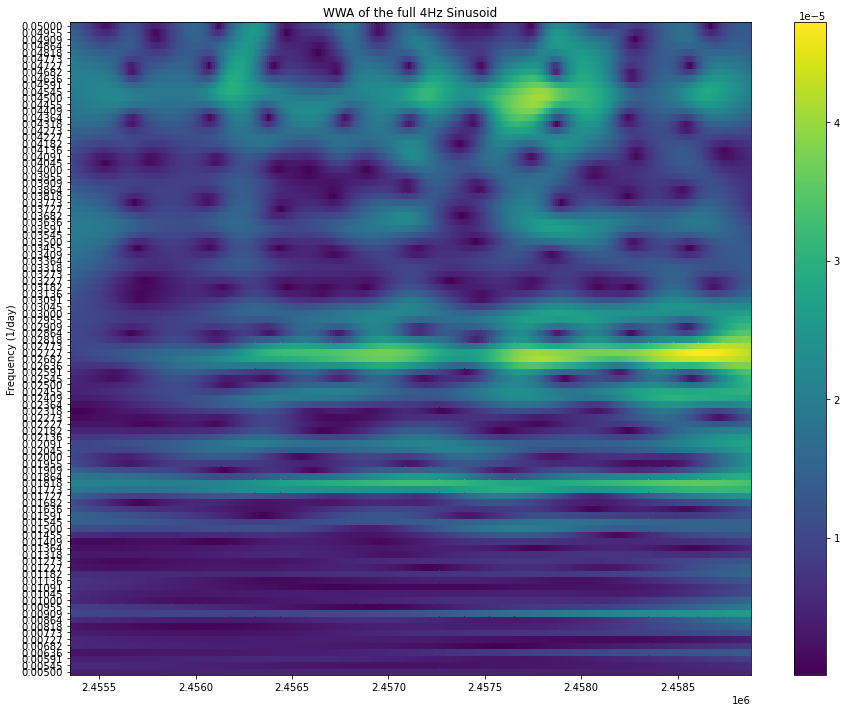

In [801]:
import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')

plt.tight_layout()

In [798]:
1/0.04545

110.01100110011002

In [785]:
source

Object              SXP65.8
P_orb (d)             110.6
P_orb (d) II              0
file            sxp65.8.csv
Name: 15, dtype: object

Source: SXP293 prophet model Period: 59.726000000000006


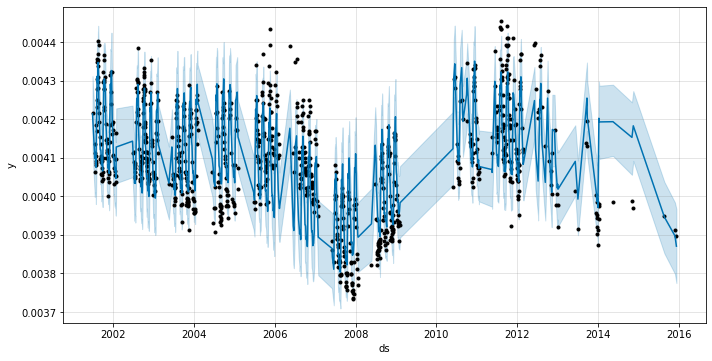

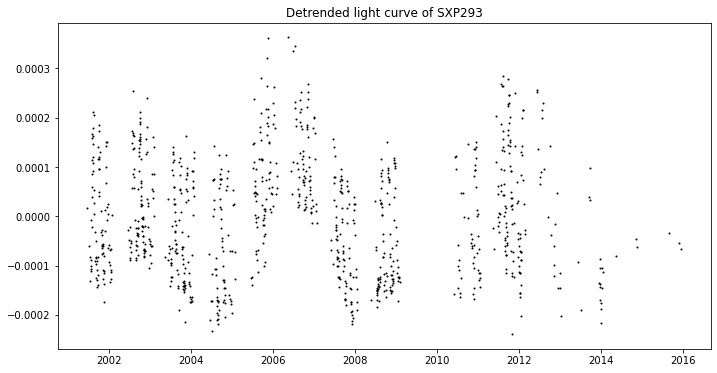

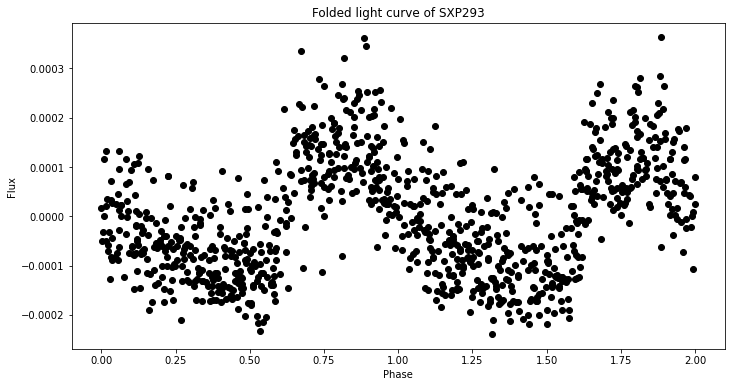

In [855]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[28,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=5,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [770]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 600

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/200
frequency_high = 1/20
frequency_steps = np.linspace(frequency_low, frequency_high, num=100)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 5     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [772]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.499
largest tau window is  8.816
86.39 seconds has passed to complete Weighted Wavelet Z-transform 



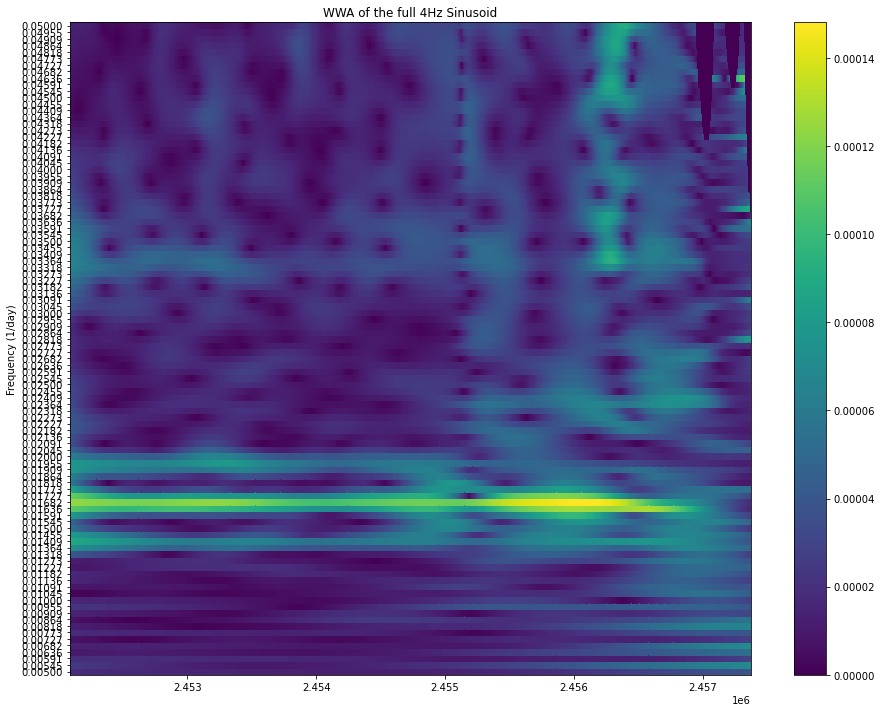

In [773]:
import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')

plt.tight_layout()

In [858]:
1/59.7

0.01675041876046901

In [856]:
f = np.linspace(1/400, 1/2, 100000)

import scipy.signal as signal
pgram = signal.lombscargle(data_df["ds"].values, detrended["y"].values, f, normalize=True)



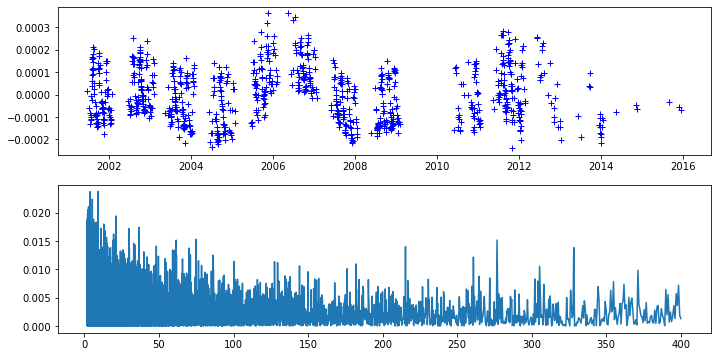

In [857]:
plt.subplot(2, 1, 1)
plt.plot(data_df["ds"].values, detrended["y"].values, 'b+')

plt.subplot(2, 1, 2)
plt.plot(1/f, pgram)
plt.show()



In [769]:
1/0.01409

70.97232079489

In [776]:
0.01682*2

0.03364

In [742]:
1/f[np.argsort(pgram)[-10:]]

TypeError: 'float' object is not subscriptable

In [705]:
88.37/14.06253955

6.284071215287711

In [1090]:
1/(f[np.argmax(pgram)]* 2.0*np.pi)

6.3311198121254835

In [708]:
names_period

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


In [577]:
names_period.iloc[18,:]

Object          SXP89.0&91.1
P_orb (d)              88.37
P_orb (d) II            88.4
file             sxp91.1.csv
Name: 18, dtype: object

In [1305]:
data[:,0][-1]-data[:,0][0]

6764.70673999982

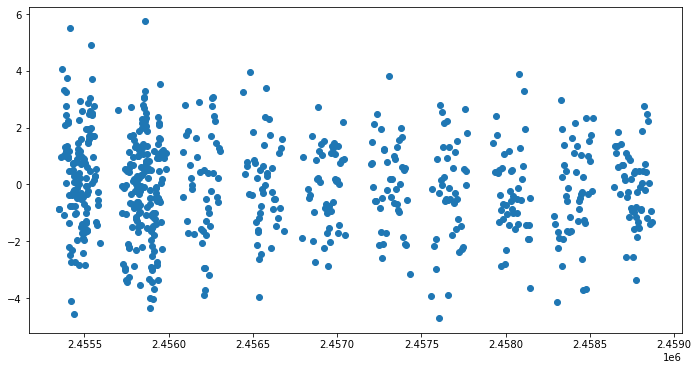

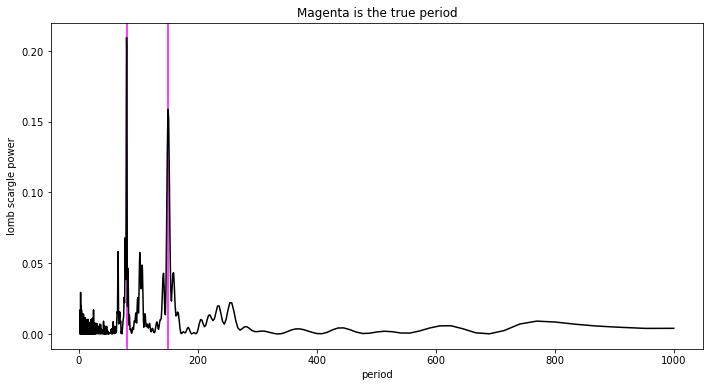

In [1320]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp6.85.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 150
period1 = 80
f=1/period
f1 = 1/period1
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

y += np.sin(x*f1*np.pi*2)+np.random.normal(0,1,size=len(x))

plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

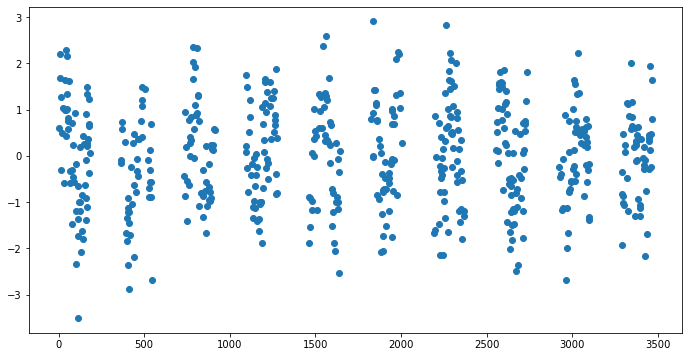

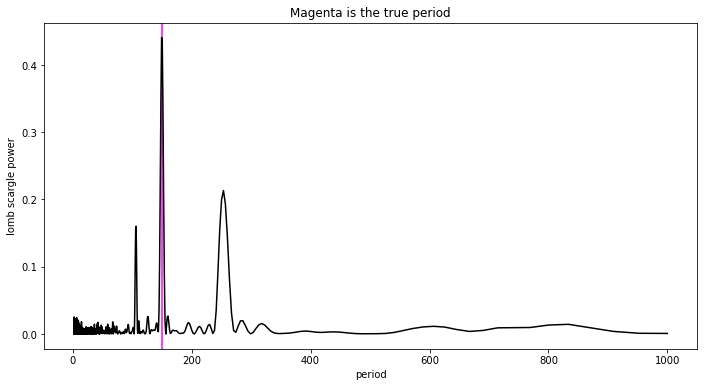

In [1325]:
# generate data for a sine wave observed for 10 years with random noise added
no_observations=3650
no_days = 3650
x = np.linspace(0,no_days,num=no_observations)
period = 150
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.8,size=no_observations)

# randomly remove data
keep = np.random.choice([False,True], size=no_observations, p=[0.7,0.3])

# make observing epochs, removing data outside of yearly observins seasons
total_exposure_prop = 0.5
no_epochs = 10
epoch_len = no_days/no_epochs
epoch_len*total_exposure_prop

for n,i in enumerate(keep):
    if (n%epoch_len) > epoch_len*total_exposure_prop:
        keep[n] = 0
x = x[keep]
y = y[keep]

plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1257]:
1/(f/(2.0*np.pi))[np.argsort(pgram)][-10:]

array([105.44242795, 250.35679411, 256.77306695, 253.52434077,
       106.56392877, 106.00021202, 151.75983123, 148.38834145,
       150.61910644, 149.49540256])

In [1281]:
len(xes[keep[:-1]])

IndexError: boolean index did not match indexed array along dimension 0; dimension is 3650 but corresponding boolean dimension is 3649

(array([65., 46., 47., 17., 21.,  4.,  3.,  7.,  4.,  2.,  2.,  0.,  0.,
         0.]),
 array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
        14., 15.]),
 <a list of 14 Patch objects>)

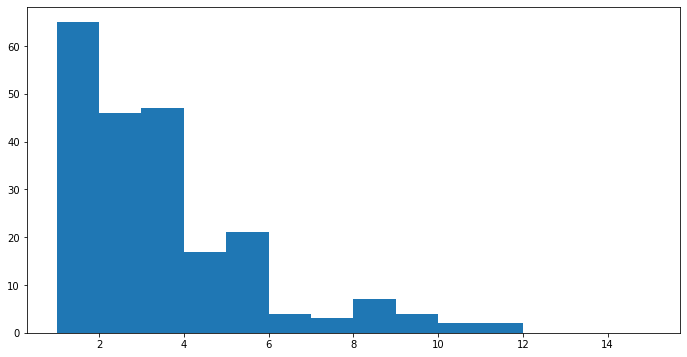

In [1300]:
xes = np.array(range(3650))
plt.hist(xes[keep][1:]-xes[keep][:-1], range=[1,15], bins=14)

In [1291]:
(xes[keep])[1:]

IndexError: boolean index did not match indexed array along dimension 0; dimension is 3649 but corresponding boolean dimension is 3650

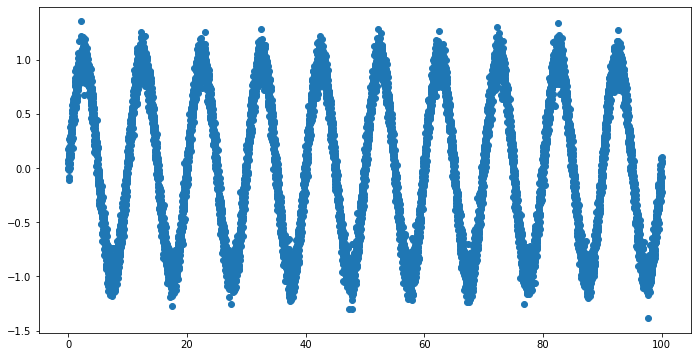

In [1077]:
import numpy as np
rand = np.random.RandomState(42)
t = np.linspace(0,100, num=10000)
y = np.sin(2 * np.pi * t* 1/10)+ 0.1 * rand.randn(10000)
plt.scatter(t,y)
plt.show()

In [1078]:
from astropy.timeseries import LombScargle
frequency, power = LombScargle(t, y).autopower()

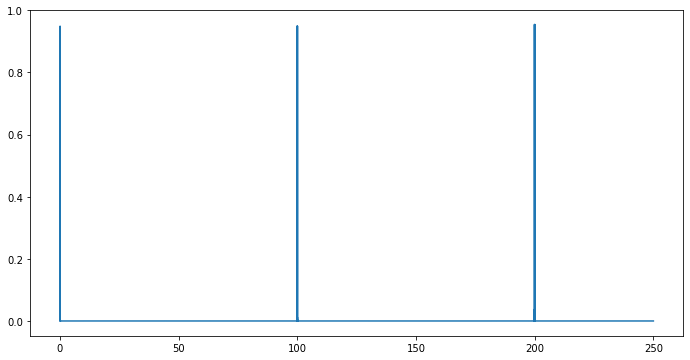

In [1079]:
import matplotlib.pyplot as plt  
plt.plot(frequency, power)      

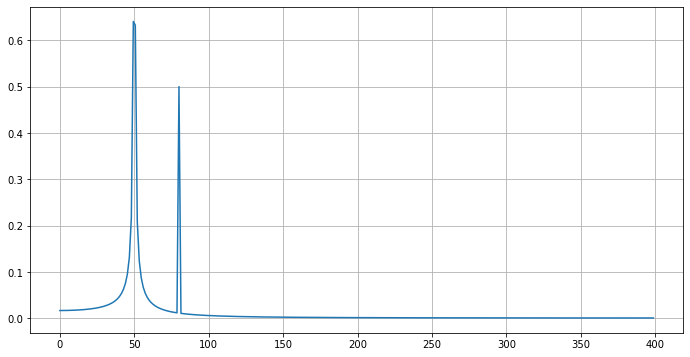

In [1080]:
from scipy.fft import fft, fftfreq
# Number of sample points
N = 600
# sample spacing
T = 1.0 / 800.0
x = np.linspace(0.0, N*T, N, endpoint=False)
y = np.sin(50.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x)
yf = fft(y)
xf = fftfreq(N, T)[:N//2]
import matplotlib.pyplot as plt
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()

In [1081]:
N//2

300

In [ ]:
from scipy.fft import fft, fftfreq
# Number of sample points
N = 600
# sample spacing
T = 1.0 / 800.0
x = np.linspace(0.0, N*T, N, endpoint=False)
y = np.sin(50.0 * 2.0*np.pi*x) + 0.5*np.sin(80.0 * 2.0*np.pi*x)
yf = fft(y)
xf = fftfreq(N, T)[:N//2]

f = np.linspace(1/400, 1/2, 10000)
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.plot(1/f, pgram)
plt.show()


plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]))
plt.grid()
plt.show()

In [1185]:
names_period

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


Source: SXP1323 prophet model Period: 26.188000000000002


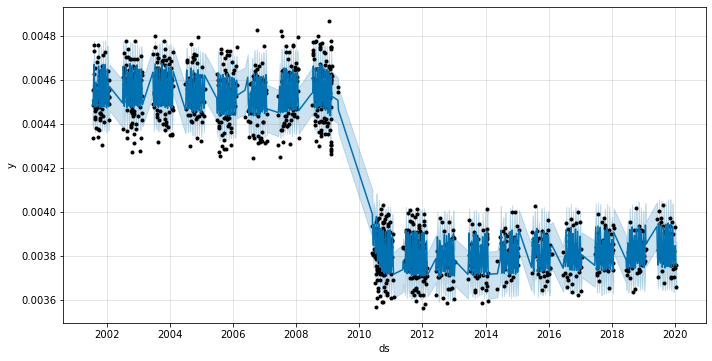

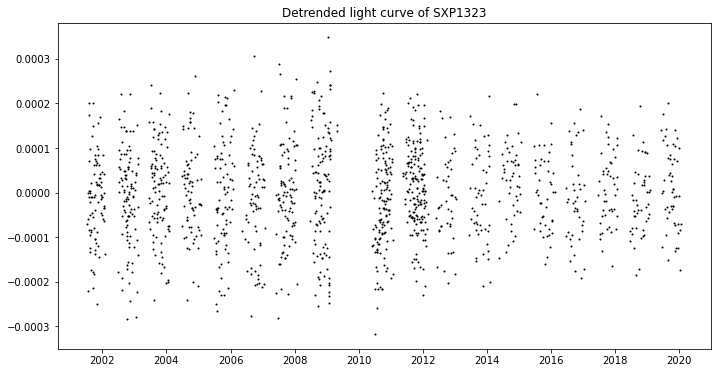

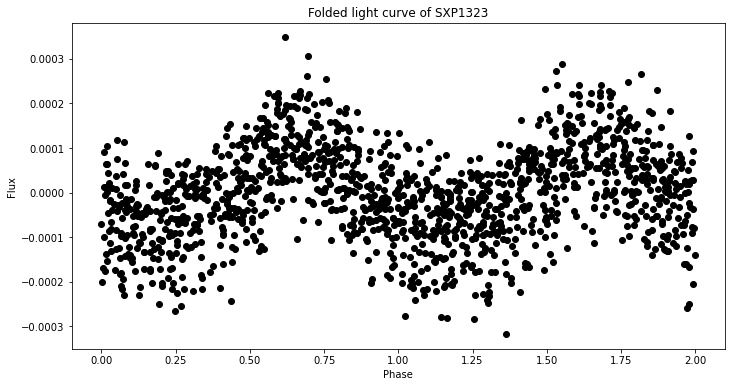

In [1187]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[38,:]
    
if len(source["file"])>0:
    data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
    #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=25,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=0.05,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=15)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [ ]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 1000

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
frequency_steps = np.logspace(frequency_low, frequency_high, num=2000)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = [frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f
f = 50     # we choose 4 since our signal of interest is at 4 hz
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True



data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = libwwz.wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)


import libwwz.plot_methods as libplot

#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])

plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')

plt.tight_layout()

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.492
largest tau window is  6.771


In [1193]:
1/0.5

2.0

In [1191]:
1/0.1269

7.880220646178092

In [1331]:
names_period

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


Source: SXP264 prophet model Period: 49.2


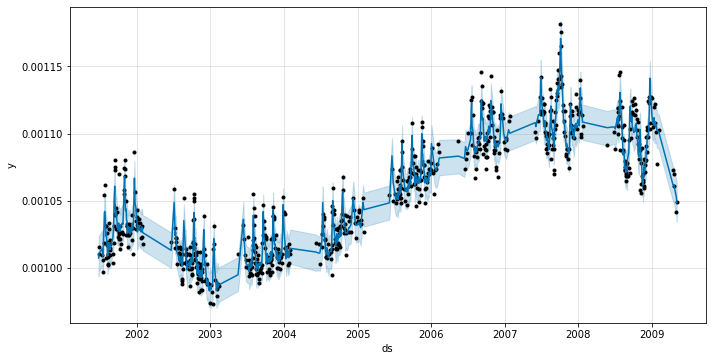

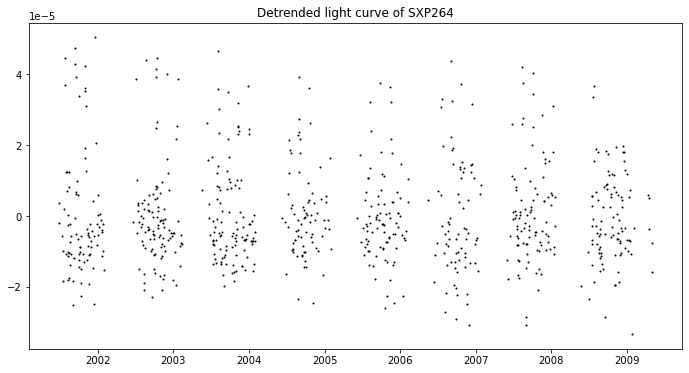

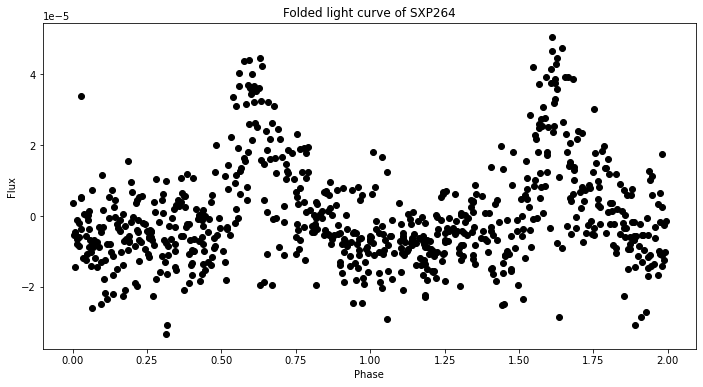

In [1332]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[26,:]


if len(source["file"])>0:
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=100,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=5,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=15)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

100


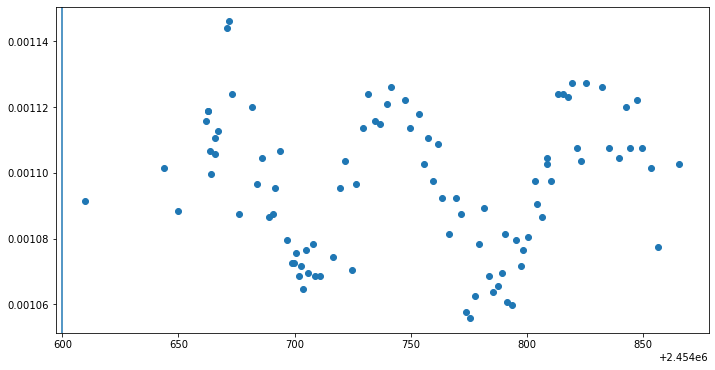

In [1501]:
plt.scatter(data_df["ds"][-100:-5], data_df["y"][-100:-5])
plt.axvline(x=2454600)
print(np.sum(2454600<data_df["ds"]))
plt.show()

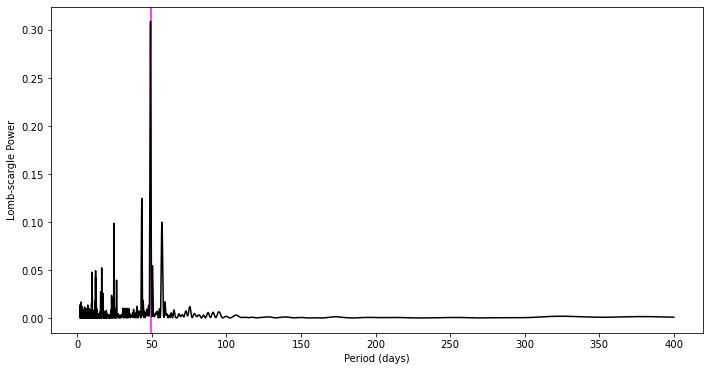

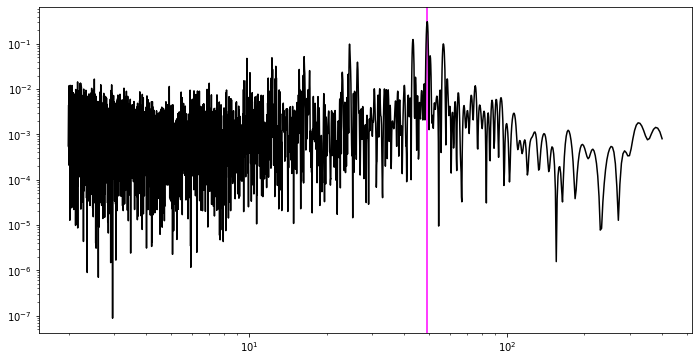

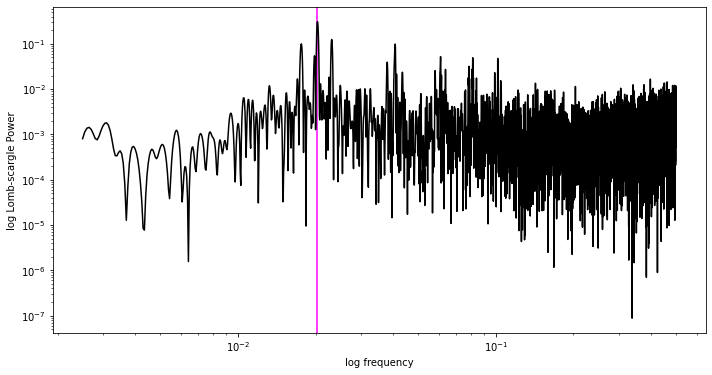

In [1476]:
f = np.linspace(1/400, 1/2, 10000)*2*np.pi


pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.xlabel('Period (days)')
plt.ylabel('Lomb-scargle Power')
plt.show()

pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
plt.yscale("log")
plt.xscale("log")
plt.xlabel('log Period (days)')
plt.ylabel('log Lomb-scargle Power')
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.show()

pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot((f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=1/source["P_orb (d)"], zorder=1, c="magenta")
plt.yscale("log")
plt.xscale("log")
plt.xlabel('log frequency')
plt.ylabel('log Lomb-scargle Power')
plt.show()

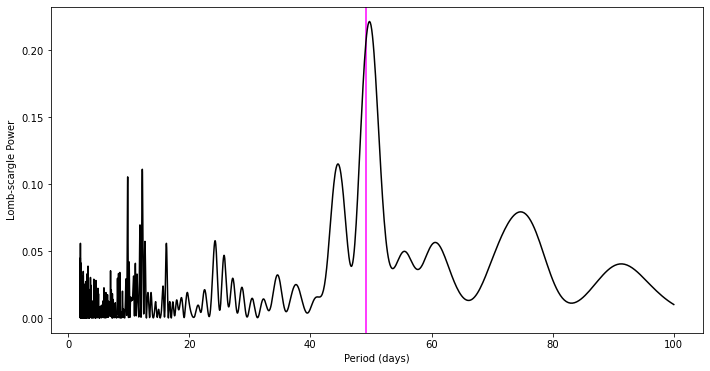

In [1505]:
f = np.linspace(1/100, 1/2, 10000)*2*np.pi


pgram = signal.lombscargle(data[-196:-5,0], detrended["y"].values[-196:-5], f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.xlabel('Period (days)')
plt.ylabel('Lomb-scargle Power')
plt.show()

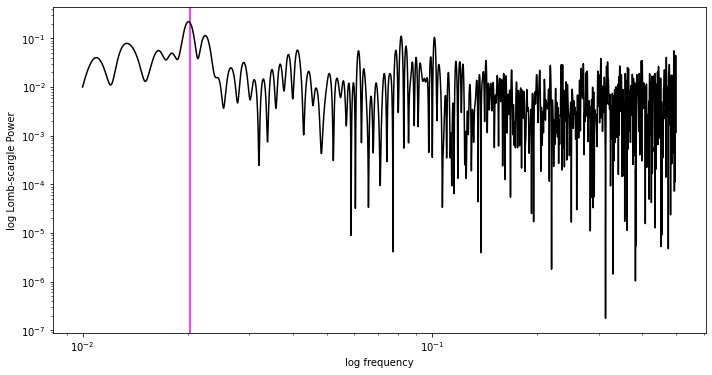

In [1506]:
pgram = signal.lombscargle(data[-196:-5,0], detrended["y"].values[-196:-5], f, normalize=True) # angular frequencies
plt.plot((f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=1/source["P_orb (d)"], zorder=1, c="magenta")
plt.yscale("log")
plt.xscale("log")
plt.xlabel('log frequency')
plt.ylabel('log Lomb-scargle Power')
plt.show()

In [1503]:
detrended["y"].values[-100:-5]

array([-1.96021958e-05, -1.02509934e-05, -2.34949042e-05,  2.77696519e-06,
        5.78070336e-06,  5.76961216e-06, -6.61034820e-06, -1.37396131e-05,
       -2.72246031e-06, -7.83468714e-06, -7.77736146e-07,  3.37400404e-05,
        3.66141255e-05,  1.55470419e-05, -1.85892315e-05,  1.89410749e-05,
       -2.86523367e-06,  6.90558936e-06, -7.87273158e-06, -4.66410335e-06,
        4.52777987e-06,  1.81536153e-05, -5.64497742e-06, -1.03903446e-05,
       -9.25078273e-06, -5.09376494e-06, -1.18972616e-05, -8.82654043e-06,
       -1.56160411e-05, -3.67423760e-06, -1.04838836e-05, -1.36673461e-06,
       -1.11392447e-05, -1.34769023e-05, -1.48777623e-05,  2.45647216e-06,
        8.13139986e-06, -2.86030229e-05, -4.97019545e-06,  8.65968925e-06,
        1.83333675e-05,  9.17915040e-06,  7.55766919e-06,  1.28459231e-05,
        1.73928071e-05,  1.14771889e-05,  2.63537655e-06,  5.51567175e-06,
       -5.88811598e-06,  6.18171172e-06, -3.06678794e-06,  1.19967826e-05,
       -2.50105848e-07, -

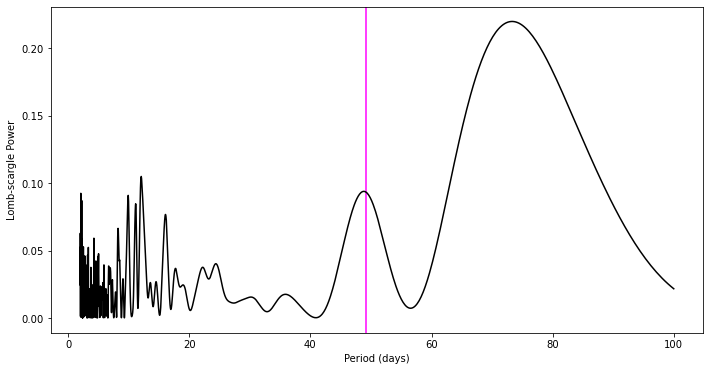

In [1502]:
f = np.linspace(1/100, 1/2, 10000)*2*np.pi


pgram = signal.lombscargle(data[-100:-5,0], detrended["y"].values[-100:-5], f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.xlabel('Period (days)')
plt.ylabel('Lomb-scargle Power')
plt.show()

In [1498]:
data[-1,0]-data[-100,0]

344.99242000002414

In [1472]:
pgram[350]

0.03432619666457504

In [1458]:
1/(f/(2*np.pi))[np.argmax(pgram)]

49.11100196463655

In [1473]:
1/(f[:350]/(2*np.pi))[np.argmax(pgram[:350])]

56.73593871905809

In [1404]:
data = np.loadtxt(data_path+"ogle_merged/"+"sxp264.csv", delimiter=",", dtype=float)

data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

# data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

In [1446]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/200
frequency_high = 1/20
frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

f = 2     # we choose 4 since our signal of interest is at 4 h
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)

# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1447]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp264 = wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  5.749
641.99 seconds has passed to complete Weighted Wavelet Z-transform 



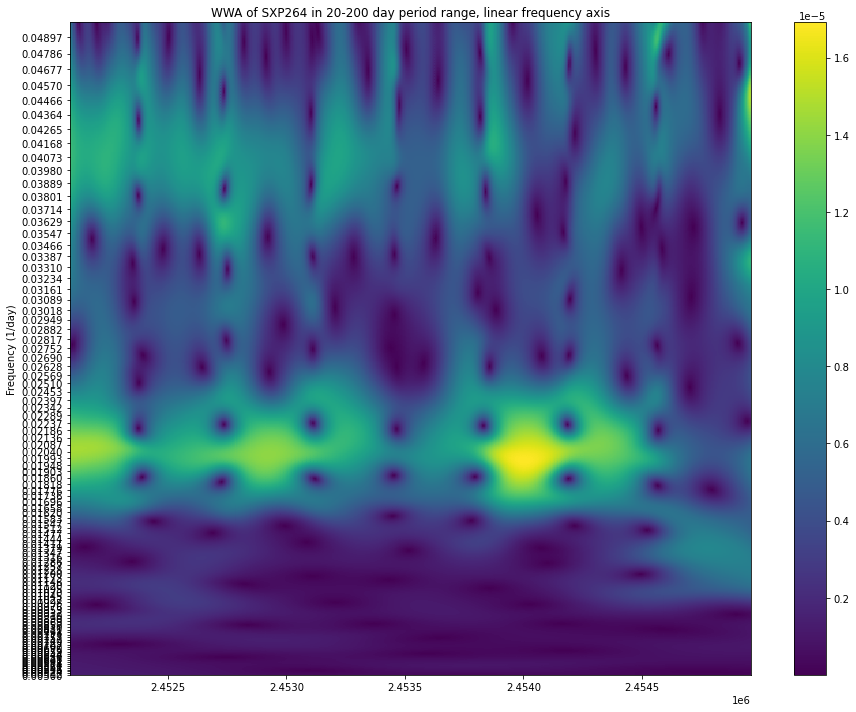

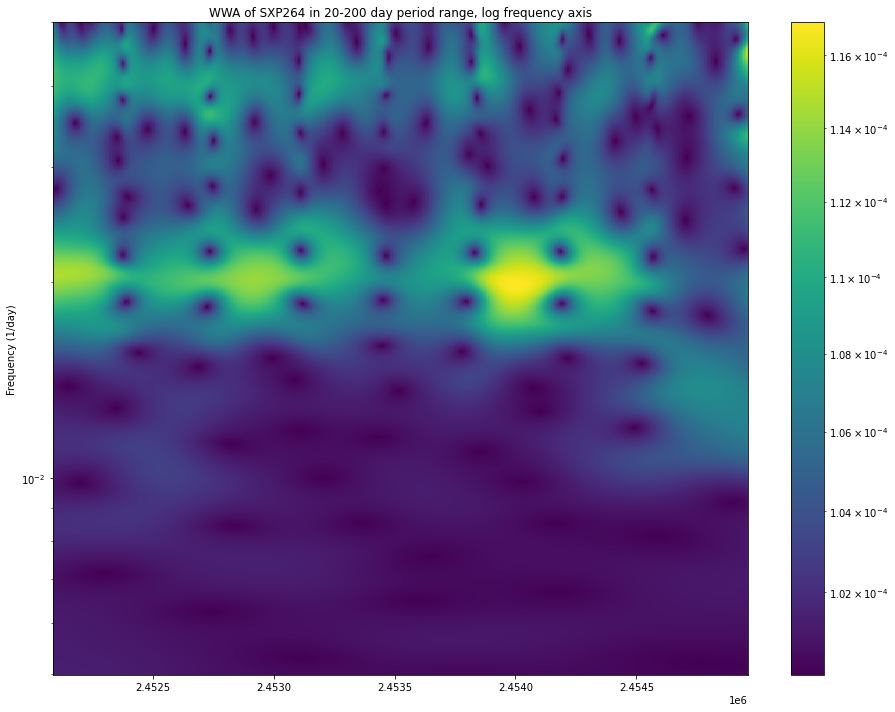

In [1448]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp264[0],
                       FREQ=wwt_sxp264[1],
                       DATA=wwt_sxp264[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp264[0],
                       FREQ=wwt_sxp264[1],
                       DATA=wwt_sxp264[3]+0.0001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

In [1413]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  5.749
1017.62 seconds has passed to complete Weighted Wavelet Z-transform 



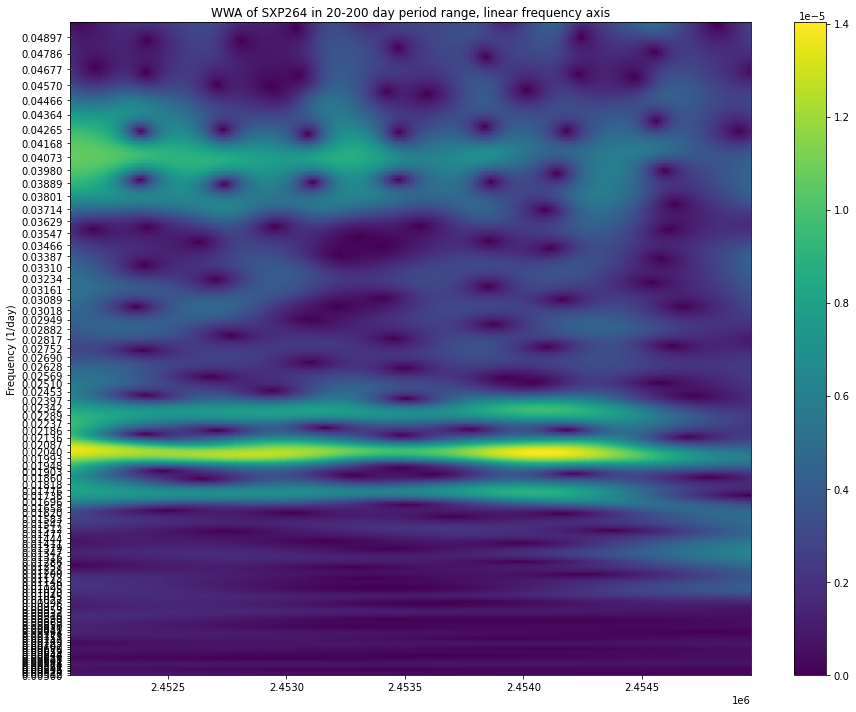

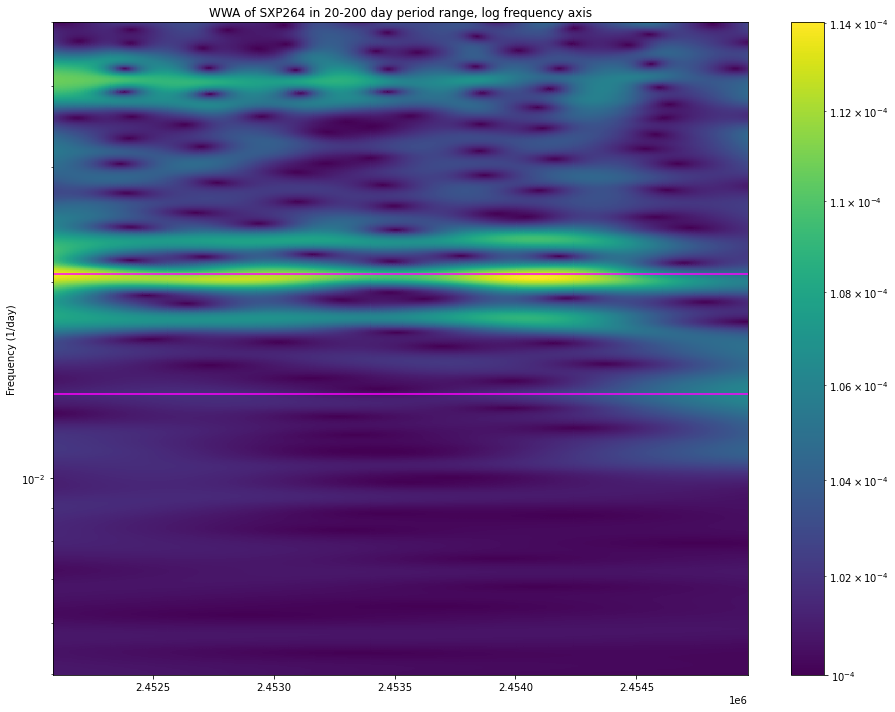

In [1479]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.0001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/74.2334363895153, zorder=1, c="magenta")
plt.axhline(y=1/48.68737747086222, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

In [1480]:
1/0.4

2.5

In [1439]:
1/(np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)[np.argmax(wwt_sxp89[3][-10:], axis=1)[0]])

74.2334363895153

In [1441]:
1/(np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)[np.argmax(wwt_sxp89[3], axis=1)[0]])

48.68737747086222

In [1425]:
1/0.02

50.0

In [1435]:
np.argmax(wwt_sxp89[3][-10:], axis=1)[0]

430

In [ ]:
import libwwz.plot_methods as libplot

#ntau 2000, f=10, period range 2-400

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 2-400 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 2-400 day period range, log frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

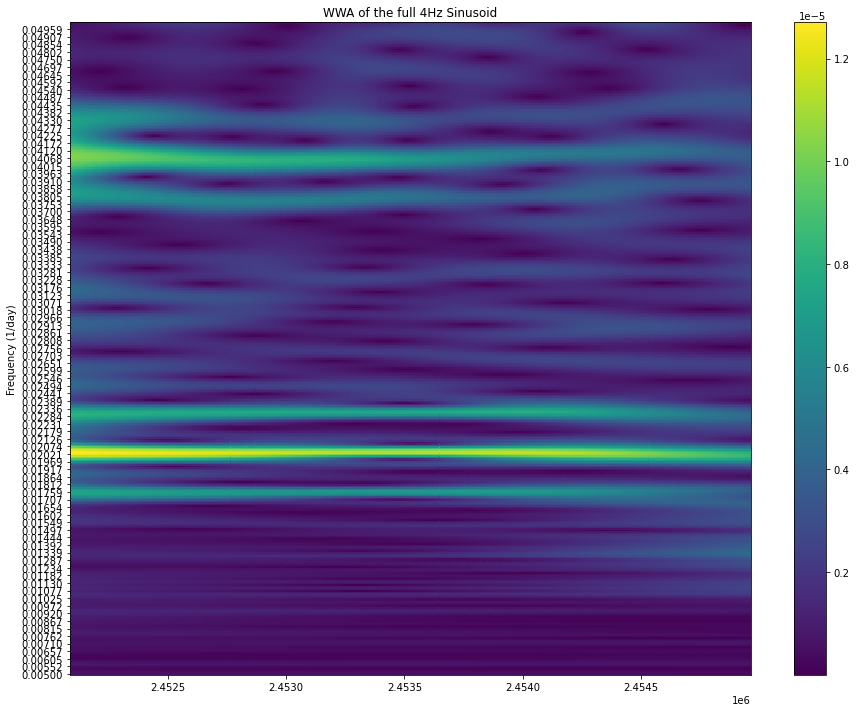

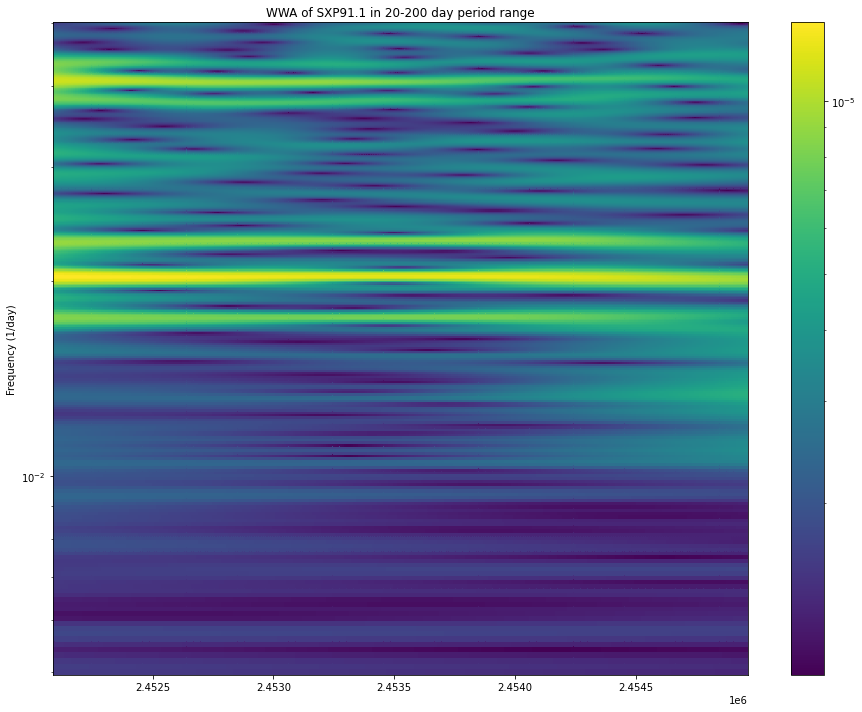

In [1348]:
import libwwz.plot_methods as libplot

#ntau 300, f=10, period range 20-200

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.000001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP91.1 in 20-200 day period range')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

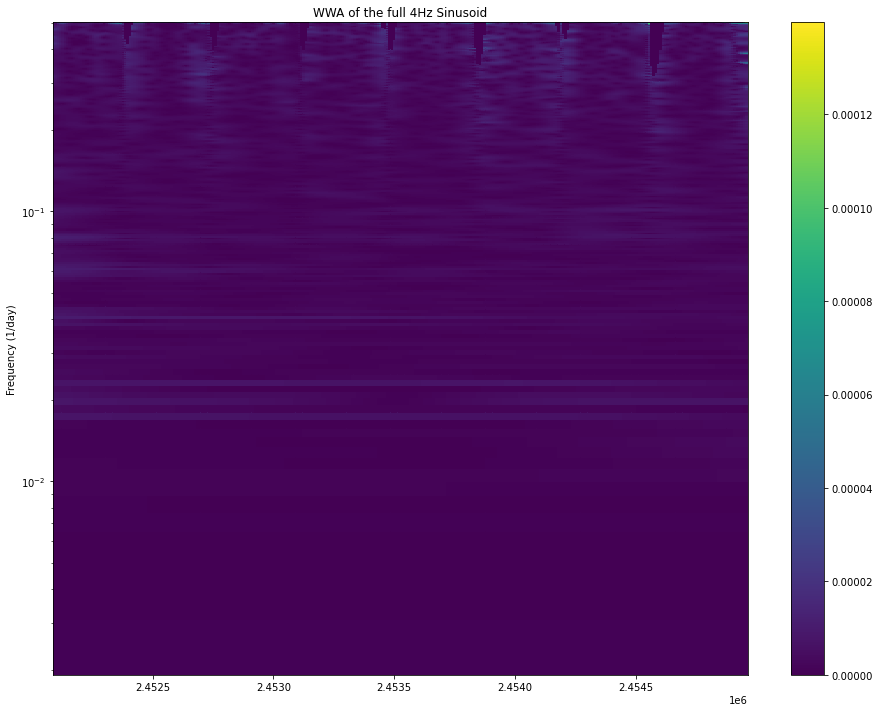

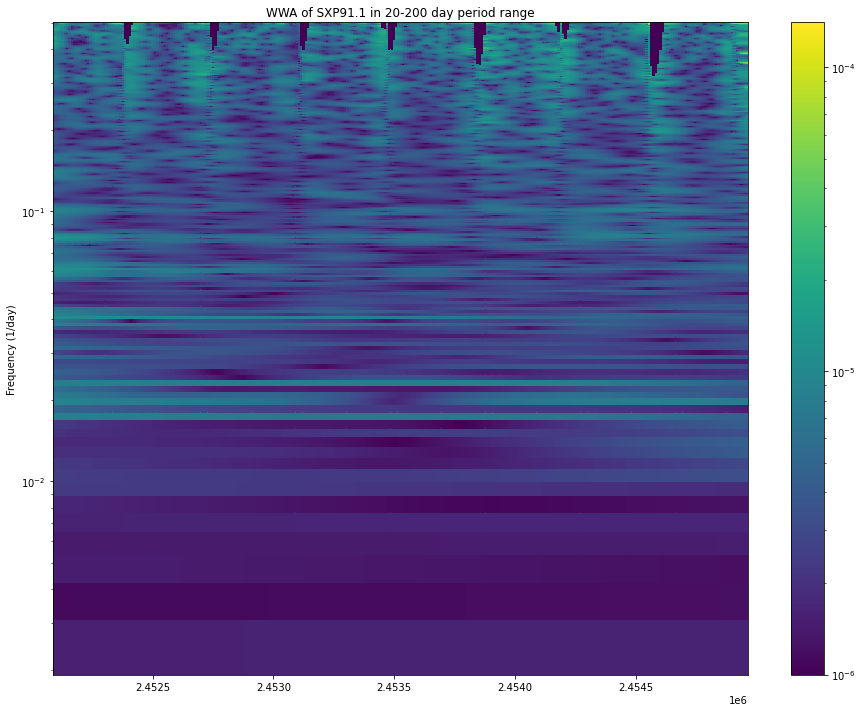

In [1344]:
import libwwz.plot_methods as libplot

#ntau 300, f=10, period range 2-400

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.000001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP91.1 in 20-200 day period range')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

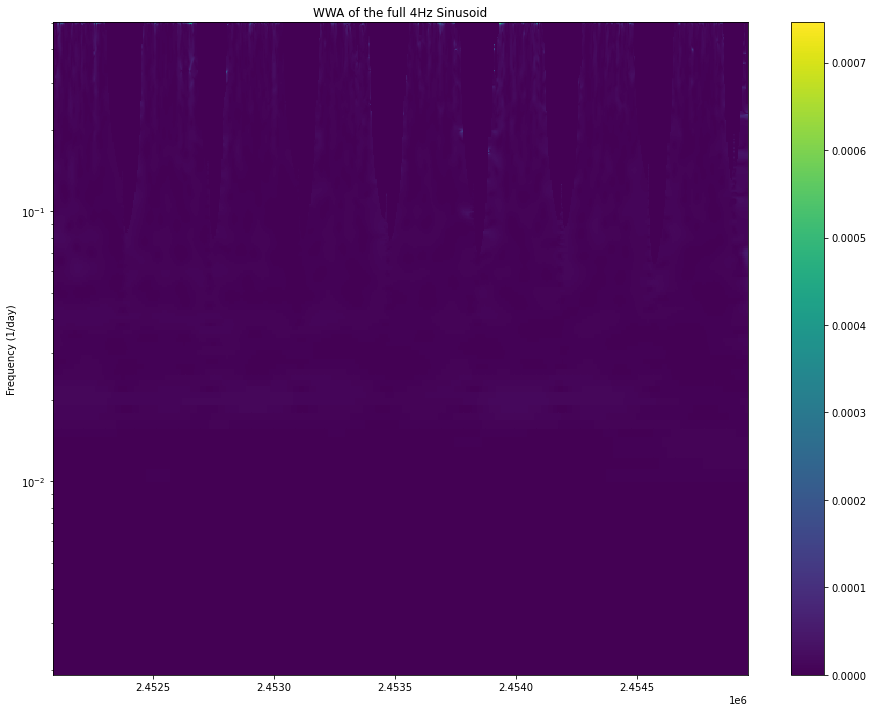

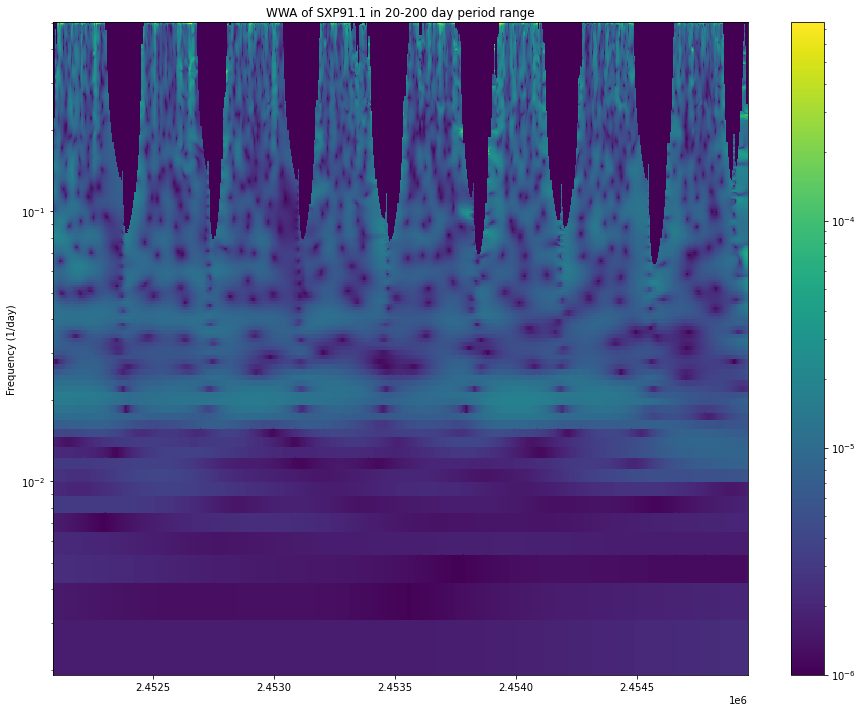

In [1341]:
import libwwz.plot_methods as libplot

#ntau 600, f=2

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of the full 4Hz Sinusoid')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.000001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP91.1 in 20-200 day period range')
plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

In [3081]:
import time

In [1829]:
"""
This module provides functions for computing the weighted wavelet z transform over input values.
"""

from typing import List

# noinspection Mypy
import numpy as np
# noinspection Mypy
from joblib import Parallel, delayed
import multiprocessing
import time


def make_tau(timestamps: np.ndarray,
             time_divisions: int) -> np.ndarray:
    """
    Creates an array of times with given timestamps and time divisions to iterate over in the wwt code.
    :param timestamps: An array with corresponding times for the magnitude (payload).
    :param time_divisions: number of divisions for the new timestamps
    :return: tau
    """

    # Check to see if time_divisions is smaller than timestamps (replace if larger)
    if time_divisions > len(timestamps):
        time_divisions = len(timestamps)
        print('adjusted time_divisions to: ', time_divisions)

    # Make tau
    tau: np.ndarray = np.linspace(timestamps[0], timestamps[-1], time_divisions)

    return tau


def make_freq(freq_low: float,
              freq_high: float,
              freq_steps: float, ) -> np.ndarray:
    """
    Creates an array of frequencies with given low, high, and steps to iterate over in the wwt code.
    :param freq_low: The low end of frequency to cast WWZ
    :param freq_high: The high end of frequency to cast WWZ
    :param freq_steps: The frequency steps for casting WWZ
    :return: freq
    """
    freq: np.ndarray = np.arange(freq_low, freq_high + freq_steps, freq_steps)

    return freq


def make_octave_freq(freq_target: float,
                     freq_low: float,
                     freq_high: float,
                     band_order: float,
                     log_scale_base: float,
                     freq_pseudo_sr: float,
                     largest_tau_window: float,
                     override: bool) -> np.ndarray:
    """
    Creates an array of frequencies based on Milton Garces' Constant-Q standardized Inferno framework (2013)
    Recommend "Constant-Q Gabor Atoms for Sparse Binary Representations of Cyber-Physical Signatures" (Garces 2020)
    :param freq_target: target frequency / frequency of interest
    :param freq_low: desired minimum frequency to be contained
    :param freq_high: desired maximum frequncy to be contained
    :param band_order: octave band order (N => 1) *Recommend N = (1, 3, 6, 12, 24,...)
    :param log_scale_base: logarithmic scale base to create the octaves
    :param freq_pseudo_sr: pseudo sample rate of the data by taking the average
    :param largest_tau_window: largest tau window made from make_tau function
    :param override: Override the freq_low and freq_high restrictions
    :return:
    """
    # Check and fix if the freq_low and freq_high meet requirements [CAN BE OVERRIDE]
    # Calculate j_min / j_max (band number min / max)
    if freq_low <= 2 / largest_tau_window and override is False:
        print('largest data window duration is too small for freq_low... taking lowest possible...')
        # This is taken from equation 69b
        j_min = np.floor(band_order * np.log2(2 / (largest_tau_window * freq_target))) + 1
    else:
        j_min = np.floor(band_order * np.log2(freq_low / freq_target))

    if freq_high >= freq_pseudo_sr / 2 and override is False:
        print('Nyquist Frequency is too small for freq_high... taking largest possible...')
        # This is taken from equation 69a
        j_max = np.ceil(band_order * np.log2(freq_pseudo_sr / (2 * freq_target))) - 1
    else:
        j_max = np.ceil(band_order * np.log2(freq_high / freq_target))

    # Create an array with the j_min to j_max (equation 70)
    band_numbers = np.arange(j_min, j_max + 1)

    # Compute the octave frequency bands (center frequencies) (equation 70)
    freq = freq_target * log_scale_base ** (band_numbers / band_order)

    return freq


def wwt(timestamps: np.ndarray,
        magnitudes: np.ndarray,
        time_divisions: int,
        freq_params: list,
        decay_constant: float,
        method: str = 'linear',
        parallel: bool = True) -> np.ndarray:
    """
    The code is based on G. Foster's FORTRAN
    code as well as eaydin's python 2.7 code. The code is updated to use numpy methods and allow for float value tau.
    It returns an array with matrix of new evenly spaced timestamps, frequencies, wwz-power, amplitude, coefficients,
    and effective number. Specific equations can be found on Grant Foster's "WAVELETS FOR PERIOD ANALYSIS OF UNEVENLY
    SAMPLED TIME SERIES". Some of the equations are labeled in the code with corresponding numbers.

    :param timestamps: An array with corresponding times for the magnitude (payload).
    :param magnitudes: An array with payload values
    :param time_divisions: number of divisions for the new timestamps
    :param freq_params: A list containing parameters for making frequency bands to analyze over with given 'method'
            'linear' -> [freq_low, freq_high, freq_step, override]
            'octave' -> [freq_tg, freq_low, freq_high, band_order, log_scale_base, override]
    :param decay_constant: decay constant for the Morlet wavelet (should be <0.02) eq. 1-2
            c = 1/(2w), the wavelet decays significantly after a single cycle of 2 * pi / w
    :param method: determines method of creating freq ('linear', 'octave') default 'linear'
    :param parallel: boolean indicate to use parallel processing or not
    :return: Tau, Freq, WWZ, AMP, COEF, NEFF in a numpy array
    """

    # Starting Weighted Wavelet Z-transform and start timer...
    print("*** Starting Weighted Wavelet Z-transform ***\n")
    process_starttime: float = time.time()

    # Get taus to compute WWZ (referred in paper as "time shift(s)")
    tau: np.ndarray = make_tau(timestamps, time_divisions)
    ntau: int = len(tau)

    # Calculate pseudo sample rate and largest time window to check for requirements
    freq_pseudo_sr = 1 / np.median(np.diff(timestamps))  # 1 / median period

    # noinspection PyArgumentList
    largest_tau_window = tau[1] - tau[0]
    print('Pseudo sample frequency (median) is ', np.round(freq_pseudo_sr, 3))
    print('largest tau window is ', np.round(largest_tau_window, 3))

    # Frequencies to compute WWZ
    if method == 'linear':
        freq: np.ndarray = freq_params
            #np.arange(freq_params[0], freq_params[1] + freq_params[2], freq_params[2])
            #np.ndarray = make_freq(freq_low=freq_params[0],
             #                        freq_high=freq_params[1],
              #                       freq_steps=freq_params[2])
        nfreq: int = len(freq)

    elif method == 'octave':
        freq = make_octave_freq(freq_target=freq_params[0],
                                freq_low=freq_params[1],
                                freq_high=freq_params[2],
                                band_order=freq_params[3],
                                log_scale_base=freq_params[4],
                                freq_pseudo_sr=freq_pseudo_sr,
                                largest_tau_window=largest_tau_window,
                                override=freq_params[5])
        nfreq = len(freq)

    # Get number of data from timestamps
    numdat: int = len(timestamps)

    # Get number of CPU cores on current device (used for parallel)
    num_cores = multiprocessing.cpu_count()

    # WWT Stars Here
    def tau_loop(dtau):
        """
        Replaced the for loop of the taus ("time shifts") for parallel processing.
        Comments include connections to the formula given in the Foster96.
        :param dtau: one of the taus being iterated
        :return: a single entry of Tau, Freq, WWZ, AMP, COEF, NEFF corresponding to dtau
        """
        # Initialize the outputs for each iteration
        index: int = 0
        output: np.ndarray = np.empty((len(freq), 6))
        nstart: int = 1
        dvarw: float = 0.0

        # loop over each interested "frequency" over the "time shifts"
        for dfreq in freq:
            # Initialize a vector (3) and matrix (3,3) and dweight2 (sum of dweight**2)
            dvec: np.ndarray = np.zeros(3)
            dmat: np.ndarray = np.zeros([3, 3])
            dweight2: float = 0.0
            # Get Scale Factor (referred in paper as "frequency")
            domega: float = 2.0 * np.pi * dfreq

            # Discrete wavelet transform (DWT)
            # Lots of math here, but basically doing the summations shown in the paper
            for idat in range(nstart, numdat):
                # Get dweight (an element of "local data number" viewed as "weights" in the paper)
                dz: float = domega * (timestamps[idat] - dtau)
                dweight: float = np.exp(-1 * decay_constant * dz ** 2)

                # get upper triangular matrix of the weights and vector
                # These are used later to calculate Neff, DWT, DWP, etc in the paper
                if dweight > 10 ** -9:
                    cos_dz: float = np.cos(dz)
                    sin_dz: float = np.sin(dz)
                    dweight2 += dweight ** 2
                    dvarw += dweight * magnitudes[idat] ** 2  # Used to get "weighted variation" later

                    dmat[0, 0] += dweight
                    dmat[0, 1] += dweight * cos_dz
                    dmat[0, 2] += dweight * sin_dz
                    dmat[1, 1] += dweight * cos_dz ** 2
                    dmat[1, 2] += dweight * cos_dz * sin_dz
                    dmat[2, 2] += dweight * sin_dz ** 2

                    # parallel to the 3 trial functions (5-5, 6, 7)
                    dvec[0] += dweight * magnitudes[idat]
                    dvec[1] += dweight * magnitudes[idat] * cos_dz
                    dvec[2] += dweight * magnitudes[idat] * sin_dz

                elif dz > 0:
                    break
                else:
                    nstart = idat + 1

            # Get dneff ("effective number" for weighted projection)
            if dweight2 > 0:
                # This is equation 5-4 in the paper
                dneff: float = (dmat[0, 0] ** 2) / dweight2
            else:
                dneff = 0.0

            # Get damp, dpower, dpowz
            dcoef: List[int] = [0, 0, 0]

            if dneff > 3:
                dvec = dvec / dmat[0, 0]
                # avoid for loops
                dmat[..., 1:] /= dmat[0, 0]

                if dmat[0, 0] > 0.005:
                    dvarw = dvarw / dmat[0, 0]
                else:
                    dvarw = 0.0

                # some initialize
                dmat[0, 0] = 1.0
                davew: float = dvec[0]
                dvarw = dvarw - (davew ** 2)  # "weighted variation" eq. 5-9

                if dvarw <= 0.0:
                    dvarw = 10 ** -12

                # avoid for loops
                dmat[1, 0] = dmat[0, 1]
                dmat[2, 0] = dmat[0, 2]
                dmat[2, 1] = dmat[1, 2]

                if np.linalg.det(dmat) == 0:
                    dmat = np.linalg.pinv(dmat)
                    print("determinant is zero, using pseudo-inverse.")
                else:
                    dmat = np.linalg.inv(dmat)

                # set dcoef and dpower
                dcoef = dmat.dot(dvec)  # y1, y2, and y3 from eq. 4-4, with 5-5, 6, 7
                dpower = np.dot(dcoef, dvec) - (davew ** 2)  # weighted model function eq. 5-10

                dpowz: float = (dneff - 3.0) * dpower / (2.0 * (dvarw - dpower))  # WWZ eq. 5-12
                damp = np.sqrt(dcoef[1] ** 2 + dcoef[2] ** 2)  # WWA eq. 5-14
            else:
                dpowz = 0.0
                damp = 0.0

            if dneff < (10 ** (-9)):
                dneff = 0.0

            if damp < (10 ** (-9)):
                damp = 0.0

            if dpowz < (10 ** (-9)):
                dpowz = 0.0

            # Let's write everything out.
            output[index] = [dtau, dfreq, dpowz, damp, dcoef[0], dneff]

            index = index + 1

        return output

    # Check if parallel or not
    if parallel:
        output = np.array(Parallel(n_jobs=num_cores)(delayed(tau_loop)(dtau) for dtau in tau))
    else:
        output = np.empty([ntau, nfreq, 6])
        for i, dtau in enumerate(tau):
            output[i] = tau_loop(dtau)

    # Format the output to be in len(tau) by len(freq) matrix for each value with correct labels

    tau_mat: np.ndarray = output[:, :, 0].reshape([ntau, nfreq])
    freq_mat: np.ndarray = output[:, :, 1].reshape([ntau, nfreq])
    wwz_mat: np.ndarray = output[:, :, 2].reshape([ntau, nfreq])
    amp_mat: np.ndarray = output[:, :, 3].reshape([ntau, nfreq])
    dcoef_mat: np.ndarray = output[:, :, 4].reshape([ntau, nfreq])
    dneff_mat: np.ndarray = output[:, :, 5].reshape([ntau, nfreq])

    output = np.array([tau_mat, freq_mat, wwz_mat, amp_mat, dcoef_mat, dneff_mat])

    # Finished Weighted Wavelet Z-transform and finish timer...
    print(round(time.time() - process_starttime, 2), 'seconds has passed to complete Weighted Wavelet Z-transform \n')

    return output

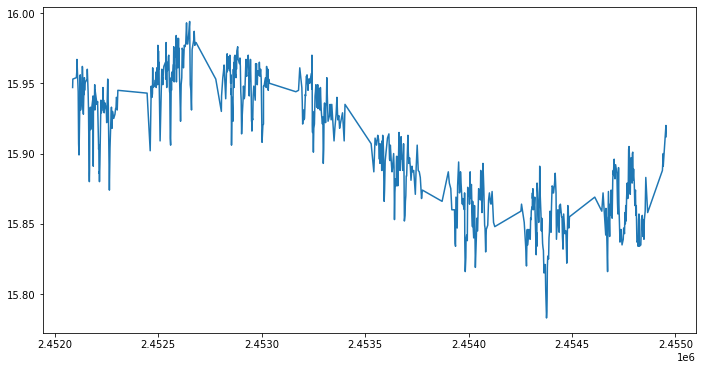

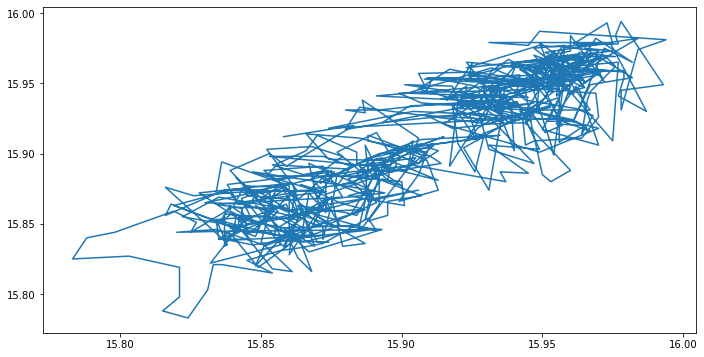

In [1509]:
plt.plot(data[:,0],data[:,1])
plt.show()
plt.plot(data[:-5,1],data[5:,1])
plt.show()

In [1564]:
data = np.loadtxt(data_path+"ogle_merged/"+"sxp264.csv", delimiter=",", dtype=float)

data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

# data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

In [1565]:
data_df.ds.iloc[-1]-data_df.ds[0]

2868.9792200000957

In [1566]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 1000

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

f = 20     # we choose 4 since our signal of interest is at 4 h
w = 2 * np.pi * f
decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1562]:
names_period

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


Source: SXP264 prophet model Period: 49.2


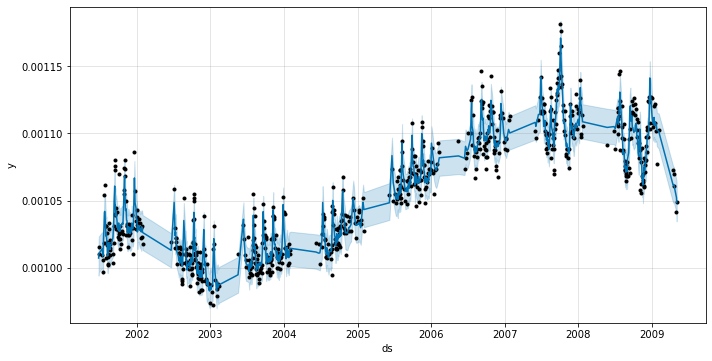

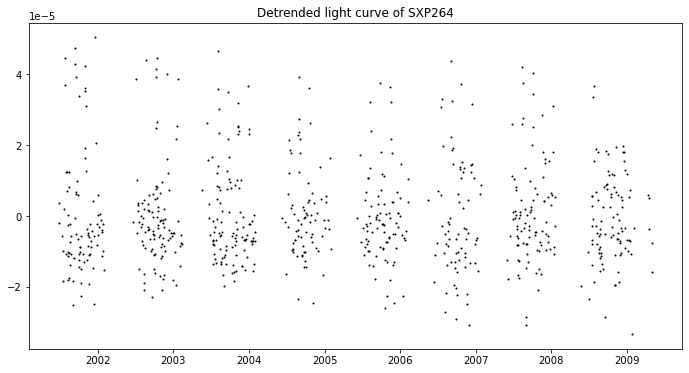

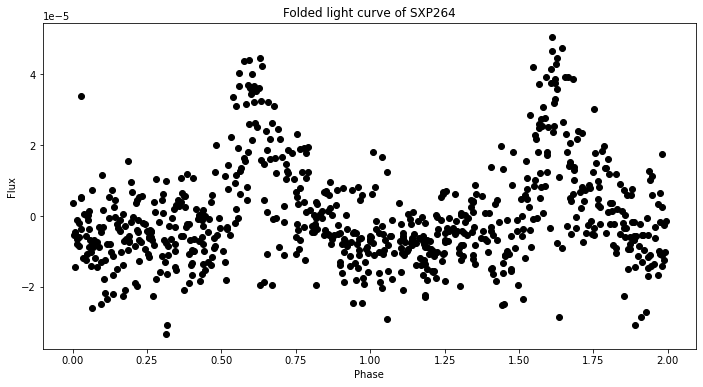

In [1567]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
source = names_period.iloc[26,:]


if len(source["file"])>0:
    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

    data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
    data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
    data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

    # fit prophet model with orbital periodicity component
    m = Prophet(
        growth='linear',
        changepoints=None,
        n_changepoints=100,
        changepoint_range=0.99,
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False,
        holidays=None,
        seasonality_mode='additive',
        seasonality_prior_scale=10.0,
        holidays_prior_scale=10.0,
        changepoint_prior_scale=5,
        mcmc_samples=0,
        interval_width=0.8,
        uncertainty_samples=1000,
        stan_backend=None,
    ) #"07-09-2009"
    m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=15)
    m.fit(data_df)

    forecast = m.predict(pd.DataFrame(data_df["ds"]))
    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

    # plot data with prophet model
    print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
    fig1 = m.plot(forecast)
    fig = plt.gcf()
    fig.set_size_inches(10,5)
    plt.show()
    # plot data with trend subtracted
    detrended = data_df.copy(deep=True)
    detrended["y"] = data_df["y"].values-forecast['trend'].values
    plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
    plt.title("Detrended light curve of {}".format(source["Object"]))
    plt.show()

#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])

    # fold detrended lightcurve
    foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
    foldTimes=foldTimes%2
    plt.scatter(foldTimes, detrended["y"], color="black")
#     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
    #     plt.ylim([10,20])
    plt.xlabel("Phase")
    plt.ylabel("Flux")
    plt.title("Folded light curve of {}".format(source["Object"]))
    # plt.ylim([-17,-13])
    plt.show()
#     break

#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

In [1568]:
data = np.loadtxt(data_path+"ogle_merged/"+"sxp264.csv", delimiter=",", dtype=float)

data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

# data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp82_4 = wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  747
Pseudo sample frequency (median) is  0.5
largest tau window is  3.846
532.69 seconds has passed to complete Weighted Wavelet Z-transform 



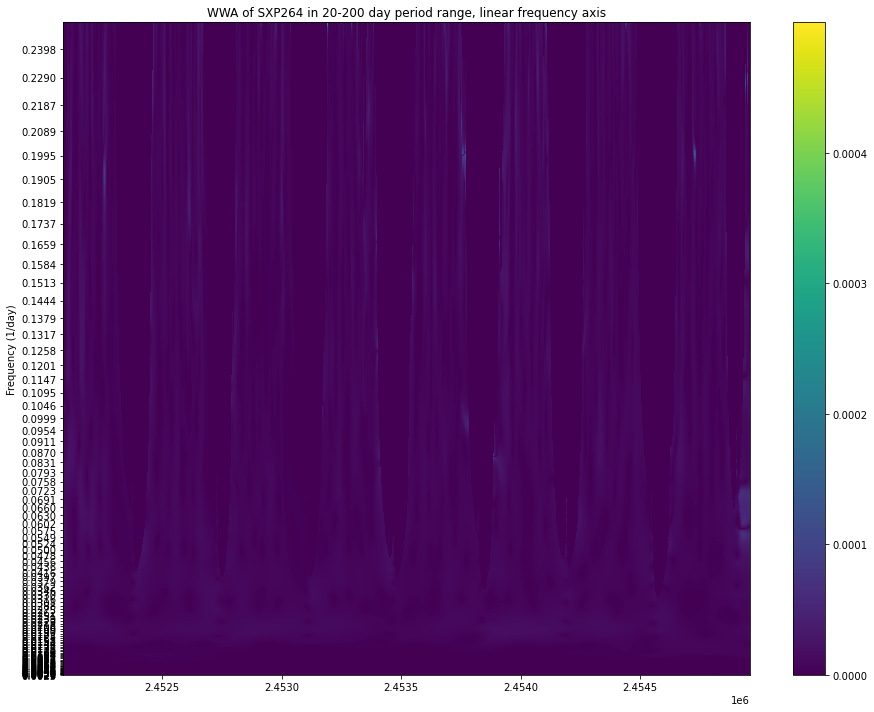

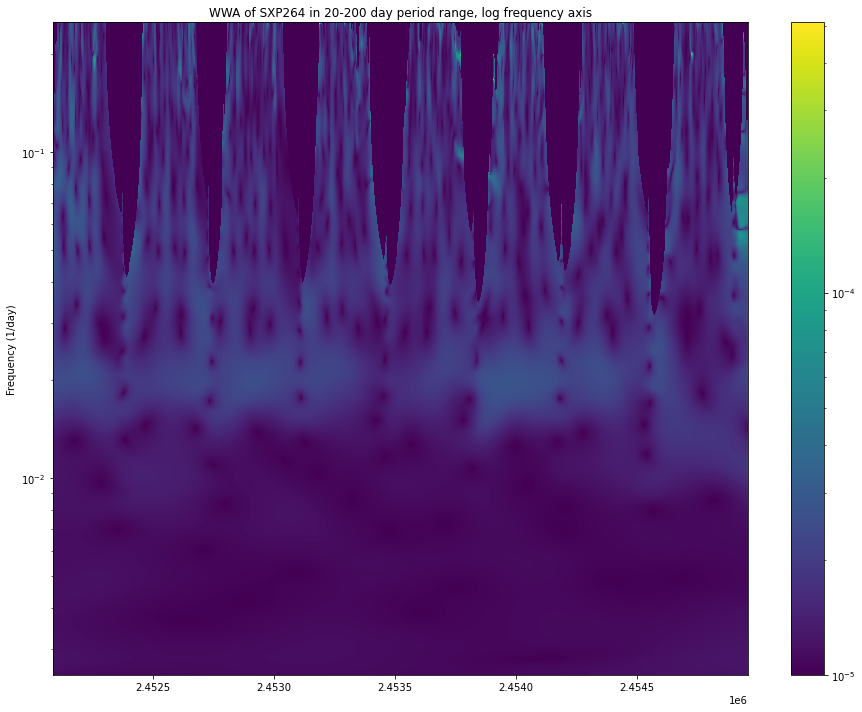

In [1569]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp82_4[0],
                       FREQ=wwt_sxp82_4[1],
                       DATA=wwt_sxp82_4[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp82_4[0],
                       FREQ=wwt_sxp82_4[1],
                       DATA=wwt_sxp82_4[3]+0.00001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

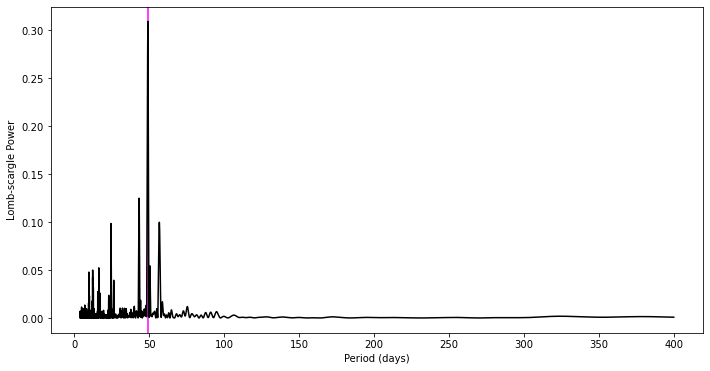

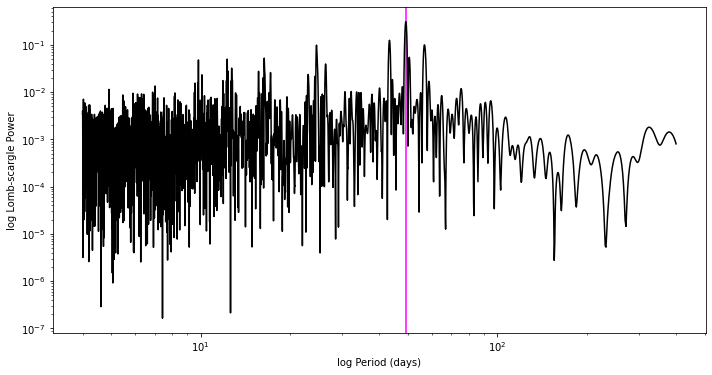

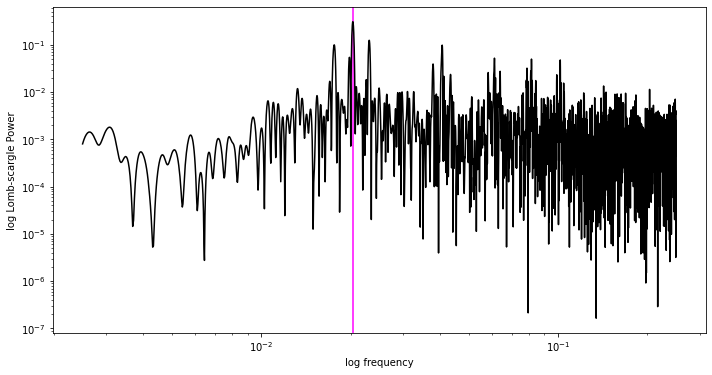

In [1571]:
f = np.linspace(1/400, 1/4, 10000)*2*np.pi


pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.xlabel('Period (days)')
plt.ylabel('Lomb-scargle Power')
plt.show()

pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
plt.yscale("log")
plt.xscale("log")
plt.xlabel('log Period (days)')
plt.ylabel('log Lomb-scargle Power')
plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta")
plt.show()

pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
plt.plot((f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
plt.axvline(x=1/source["P_orb (d)"], zorder=1, c="magenta")
plt.yscale("log")
plt.xscale("log")
plt.xlabel('log frequency')
plt.ylabel('log Lomb-scargle Power')
plt.show()

In [1553]:
np.argsort(wwt_sxp82_4[3], axis=None)

array([999999, 444855, 444854, ..., 178999, 178998, 680999])

In [1544]:
np.argmax(wwt_sxp82_4[3][:,-200:], axis=1)

array([194, 194, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199,
       199, 199, 179, 179, 179, 179, 179, 179, 179,  63,  63,  63, 194,
       194, 194, 194, 194, 199, 199, 199, 199, 199, 199, 199, 199, 199,
       199, 199, 199, 186, 186, 199, 199, 199, 199, 199, 199, 199, 199,
       199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 150, 152,
       152, 183, 183, 183, 183, 183, 183, 183, 183, 183, 183, 182, 182,
       182, 182, 182, 125, 125, 125, 125, 125, 199, 199, 199, 199, 199,
       199, 171, 171, 171, 171, 171, 119, 119, 119, 119, 199, 199, 199,
       199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199,
       199, 199, 199, 199, 199, 199, 199,  41,  41,  41,  41,  41,  41,
        41, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199, 199,
        41,  41,  41, 147, 150, 184, 187, 190, 190, 198, 198, 198, 198,
       198, 172, 184, 181, 181, 181, 181, 181, 181, 180, 180, 180, 180,
       180, 180, 179, 179, 179, 180, 180, 199, 199, 199, 199, 15

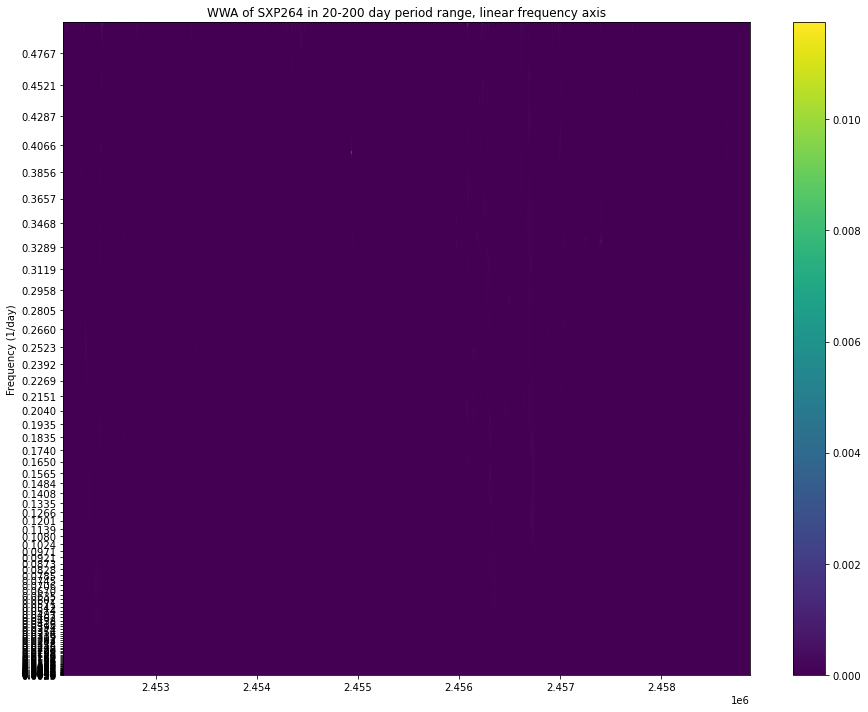

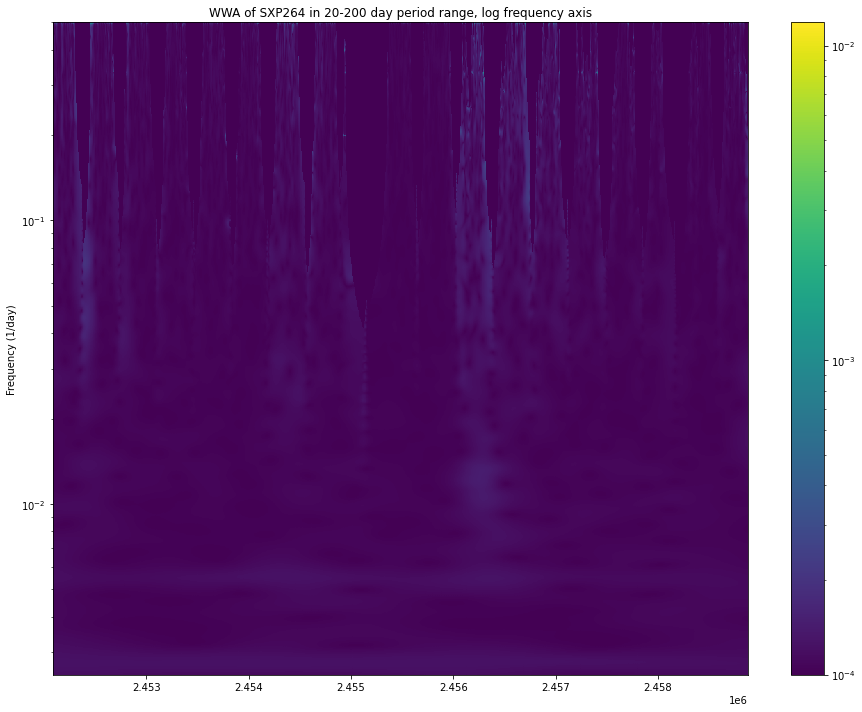

In [1531]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp82_4[0],
                       FREQ=wwt_sxp82_4[1],
                       DATA=wwt_sxp82_4[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp82_4[0],
                       FREQ=wwt_sxp82_4[1],
                       DATA=wwt_sxp82_4[3]+0.0001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.tight_layout()
plt.show()

In [1413]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=data_df["ds"].values,
                     magnitudes=detrended["y"].values,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  5.749
1017.62 seconds has passed to complete Weighted Wavelet Z-transform 



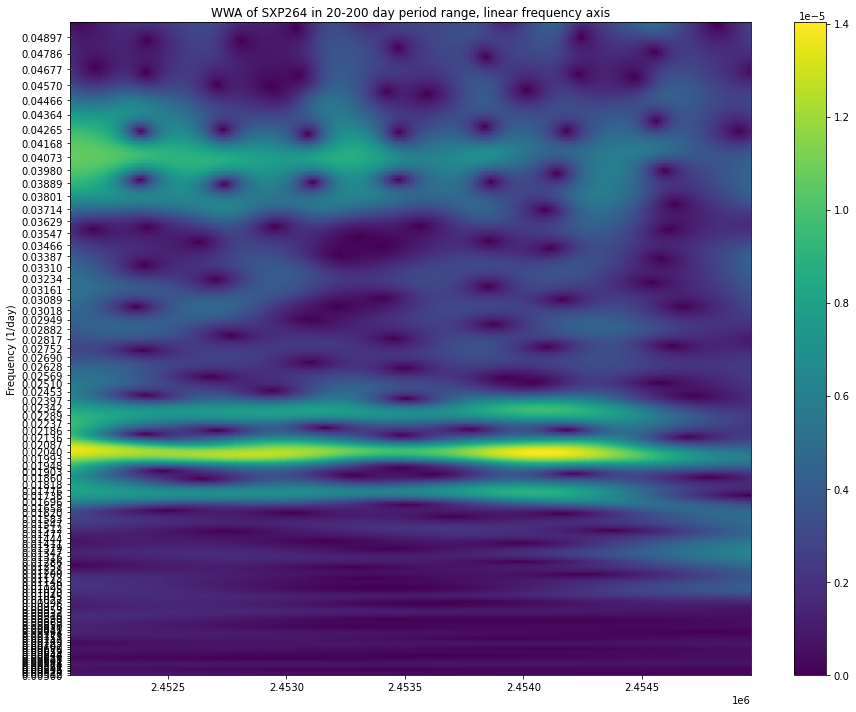

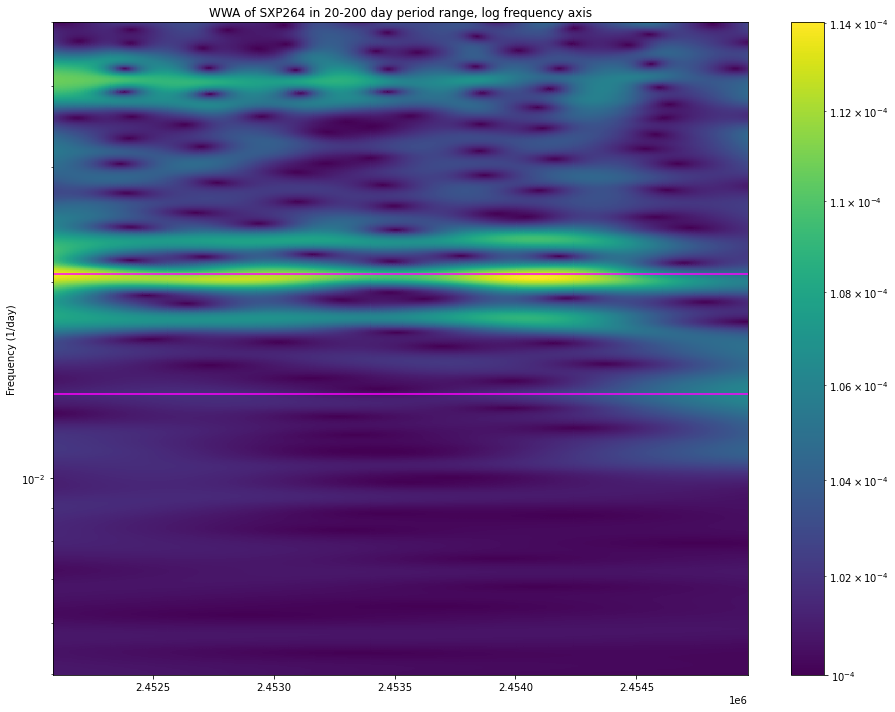

In [1479]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()


#1000 freq steps

# Next we will look at WWA for both full and removed data...
# WWA is better at discerning the amplitudes of the signal

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.0001)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
# plt.axhline(y=1/74.2334363895153, zorder=1, c="magenta")
# plt.axhline(y=1/48.68737747086222, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

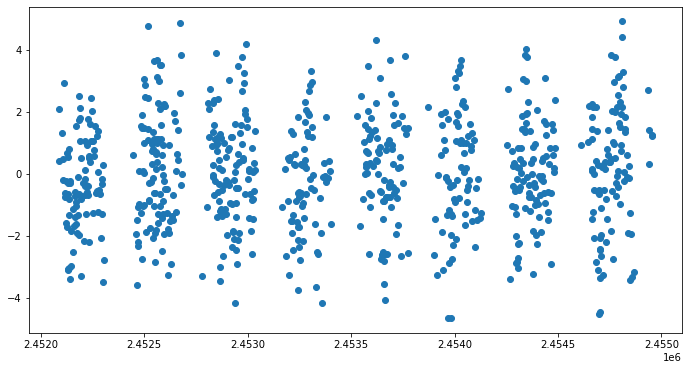

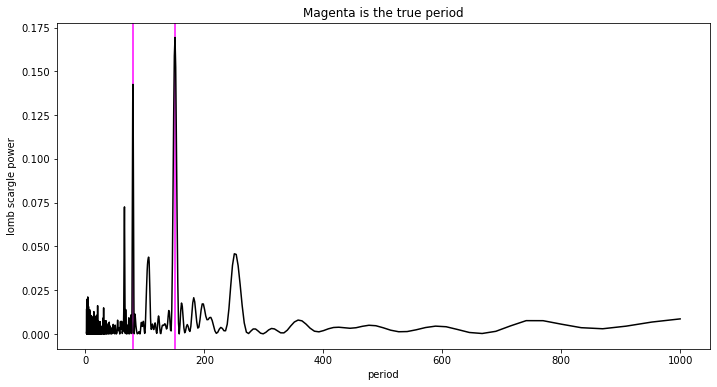

In [1630]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp264.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 150
period1 = 80
f=1/period
f1 = 1/period1
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

y += np.sin(x*f1*np.pi*2)+np.random.normal(0,1,size=len(x))

plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1631]:
(x[-1]-x[0])/4

717.2448050000239

In [1634]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/100
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1635]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
258.97 seconds has passed to complete Weighted Wavelet Z-transform 



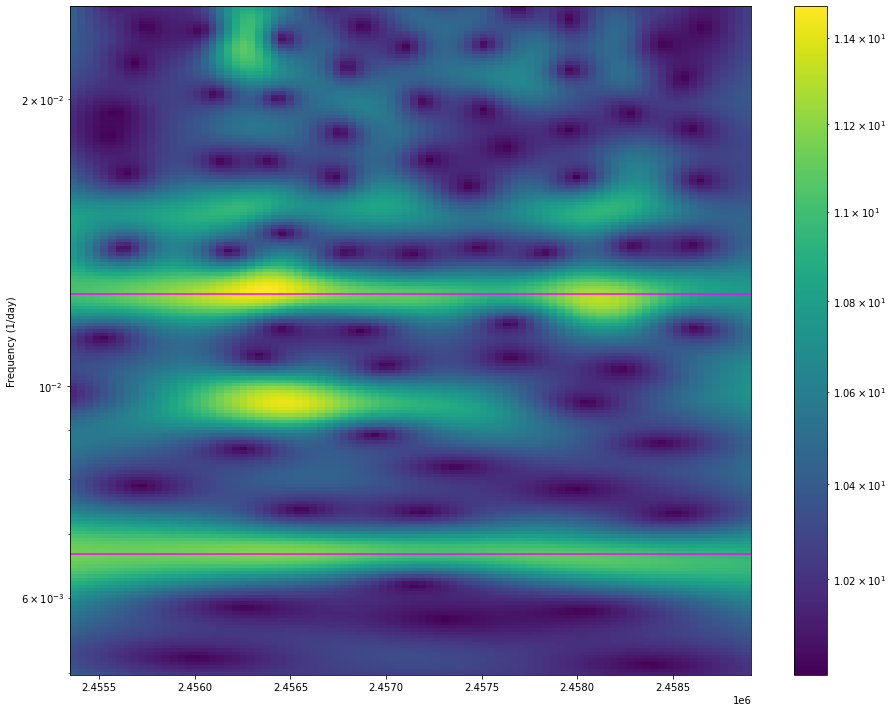

In [1607]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/150, zorder=1, c="magenta")
plt.axhline(y=1/80, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

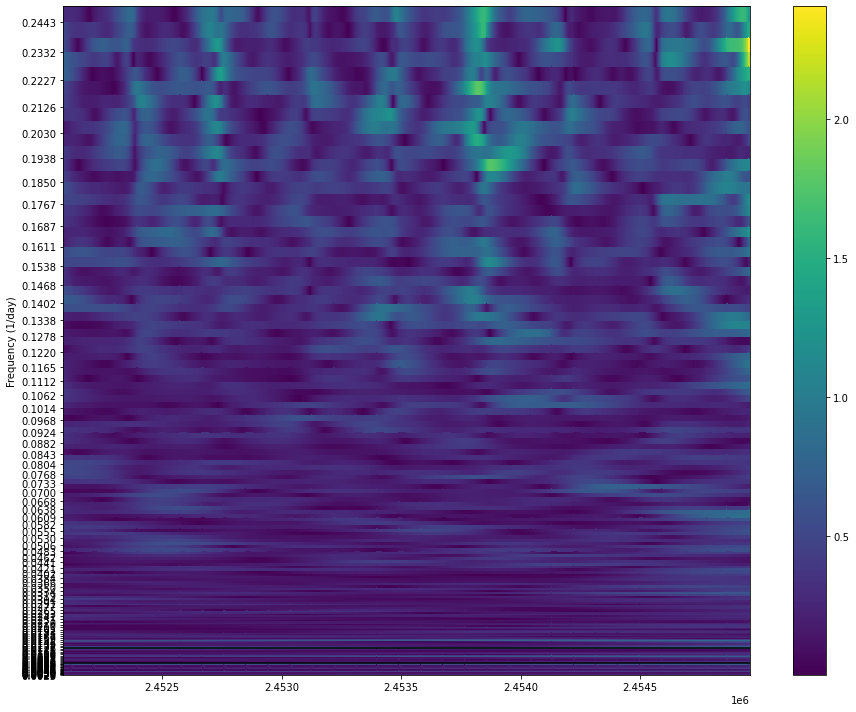

In [1636]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

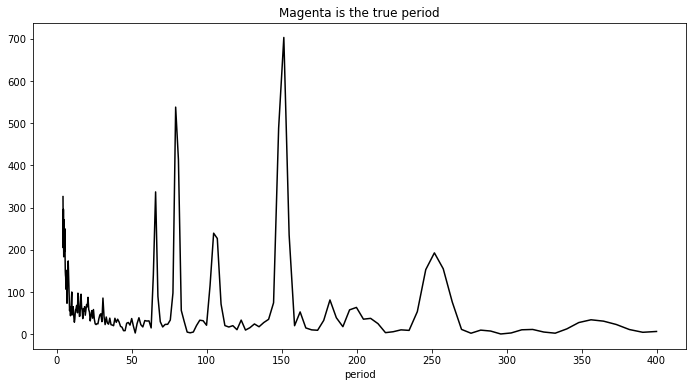

In [1637]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

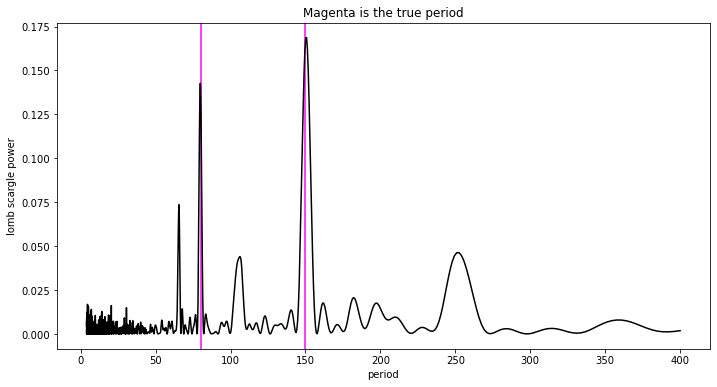

In [1639]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1640]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1646]:
decay_constant

0.0012665147955292222

In [1641]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
180.21 seconds has passed to complete Weighted Wavelet Z-transform 



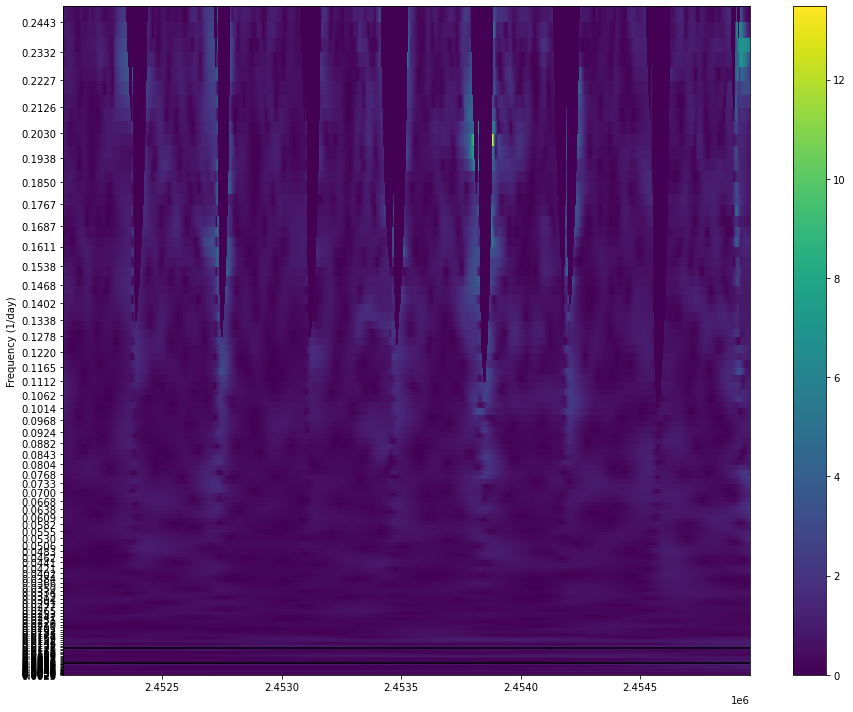

In [1643]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

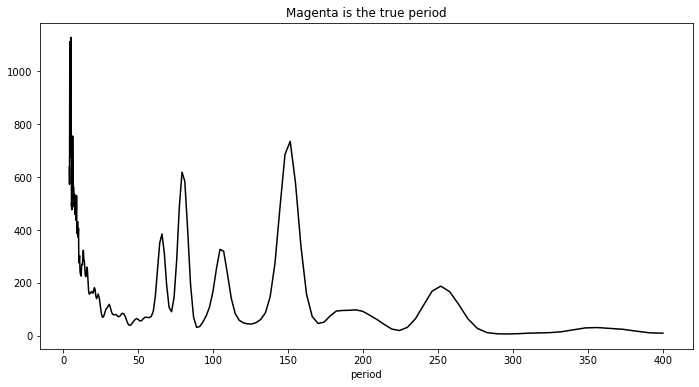

In [1644]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

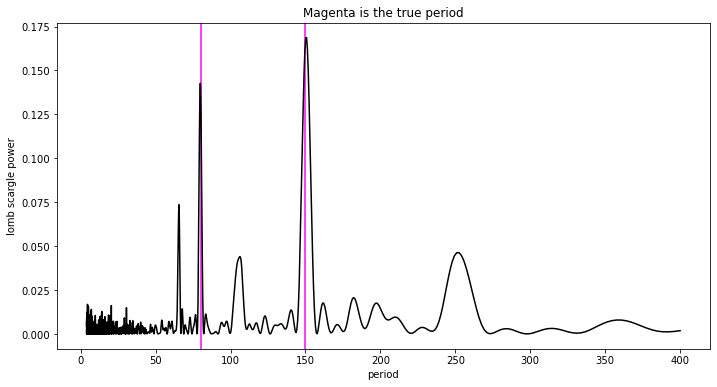

In [1645]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1647]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 0#1/(8*np.pi**2)/10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1648]:
decay_constant

0

In [1649]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
342.53 seconds has passed to complete Weighted Wavelet Z-transform 



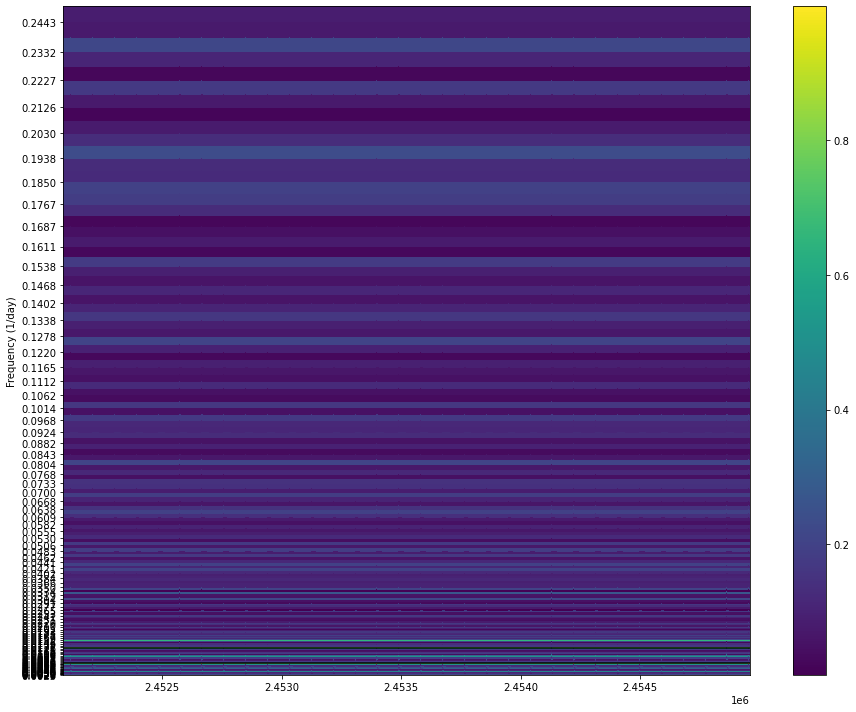

In [1650]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

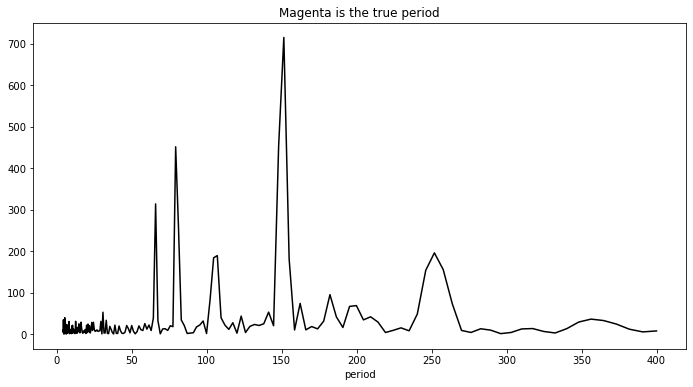

In [1651]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

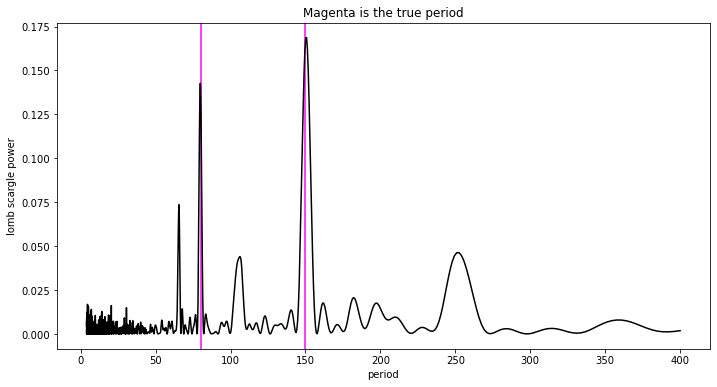

In [1652]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1653]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1655]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
100.65 seconds has passed to complete Weighted Wavelet Z-transform 



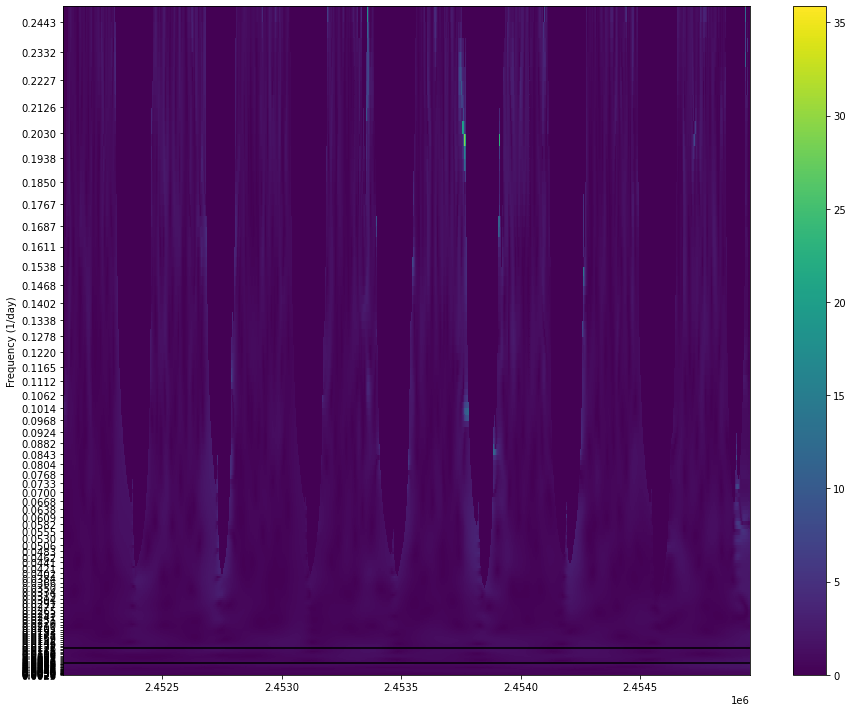

In [1656]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

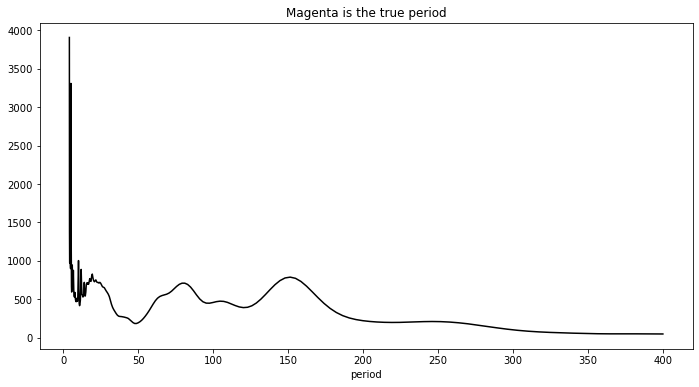

In [1657]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

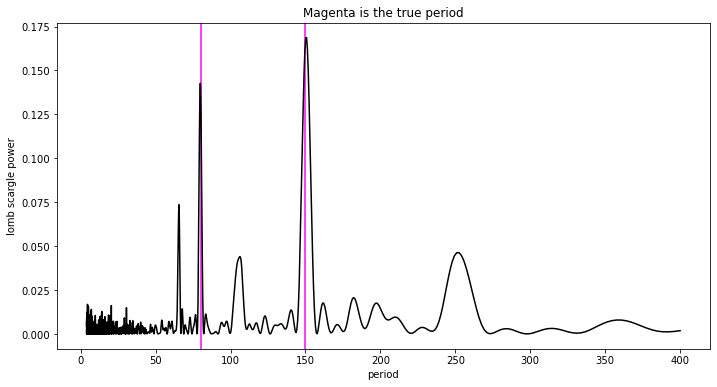

In [1652]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1658]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/20
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1659]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
149.31 seconds has passed to complete Weighted Wavelet Z-transform 



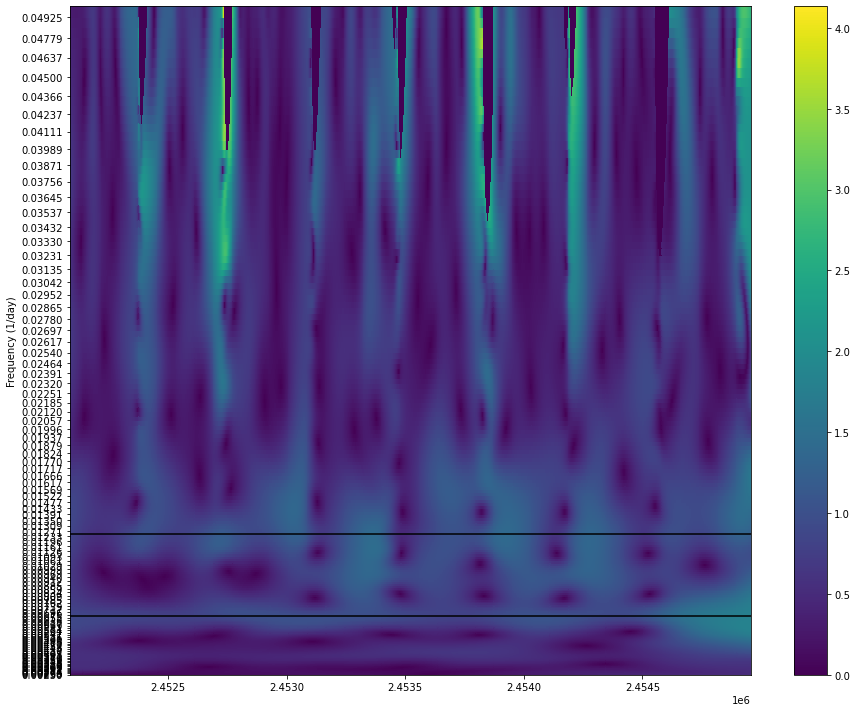

In [1660]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

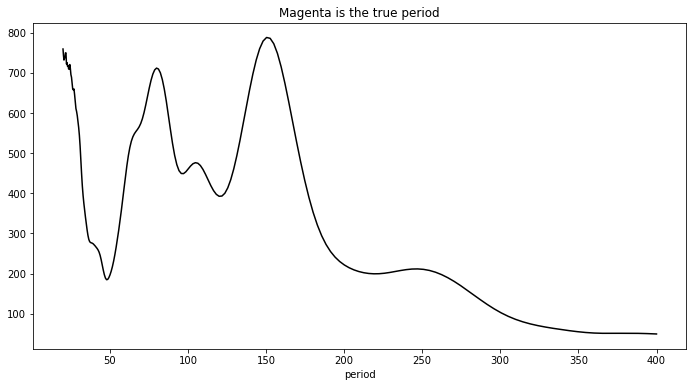

In [1661]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

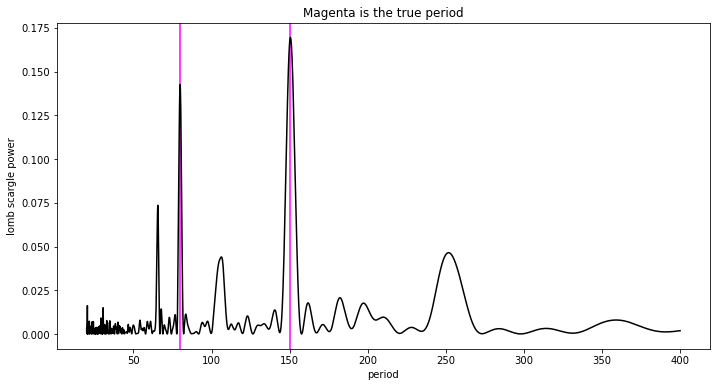

In [1662]:
f = np.linspace(1/400, 1/20, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1663]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 718 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/50
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1664]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.001
191.19 seconds has passed to complete Weighted Wavelet Z-transform 



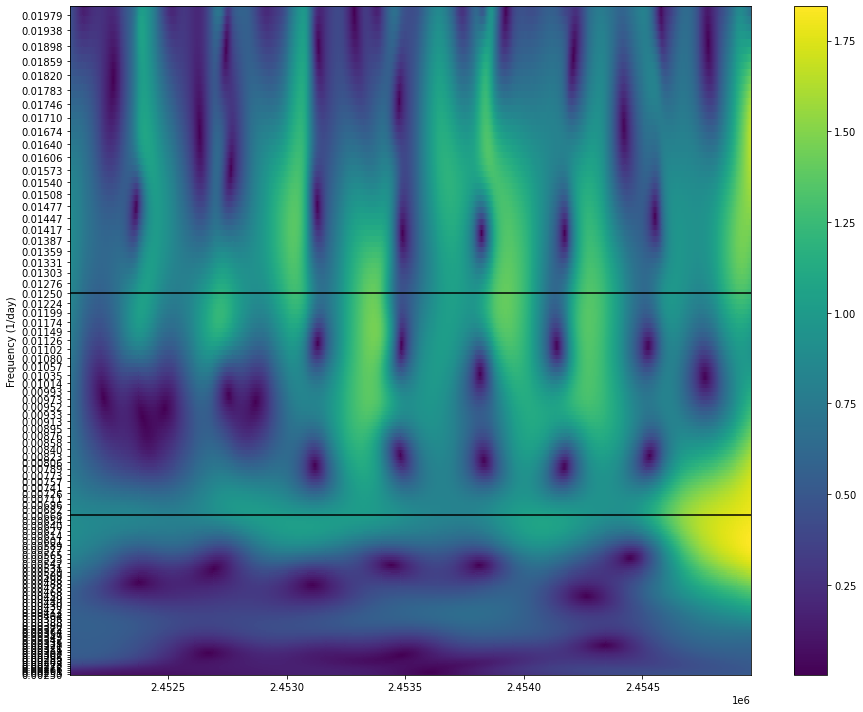

In [1665]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

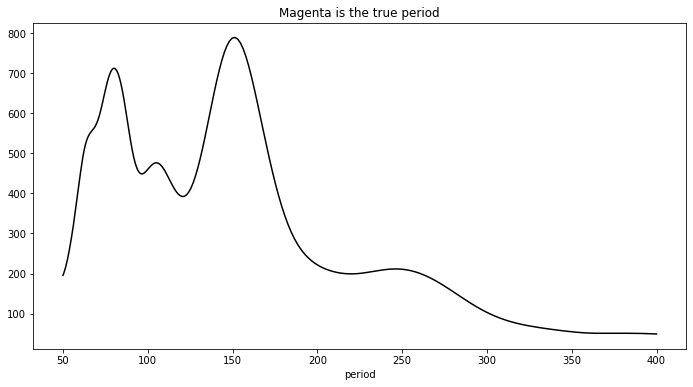

In [1666]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

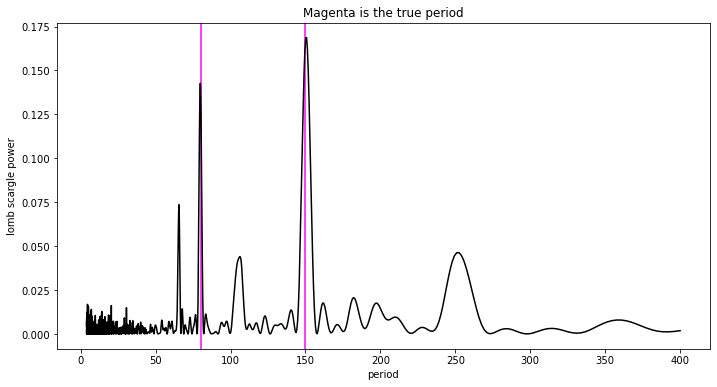

In [1652]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1715]:
(x[-1]-x[0])/20

143.44896100000477

In [1720]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 288 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/20
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1721]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  9.996
100.27 seconds has passed to complete Weighted Wavelet Z-transform 



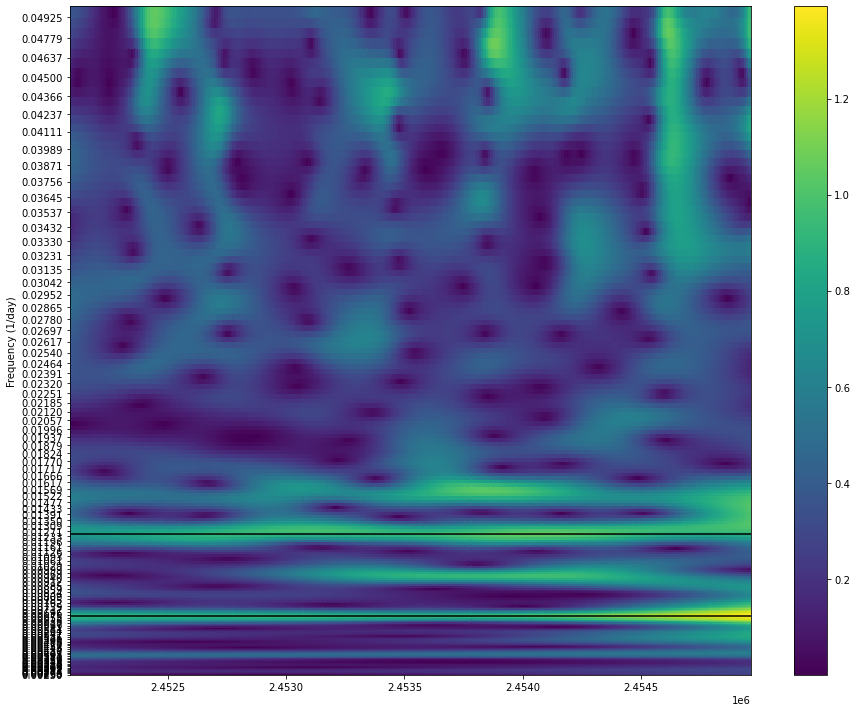

In [1722]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

In [1672]:
1/wwt_sxp89[1][0][np.argmax(np.sum(np.abs(wwt_sxp89[3])**2, axis=0))]

150.34896577386618

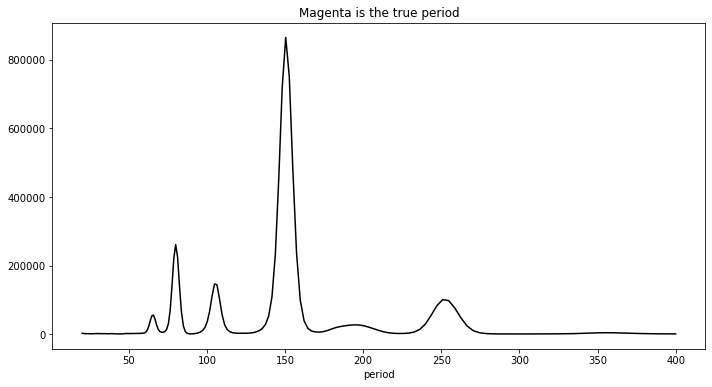

In [1674]:
plt.plot(1/wwt_sxp89[1][0], np.sum(wwt_sxp89[2]**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

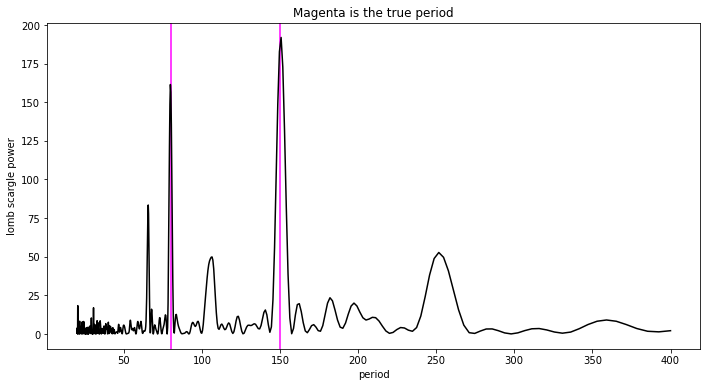

In [1713]:
f = np.linspace(1/400, 1/20, 1000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=False)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

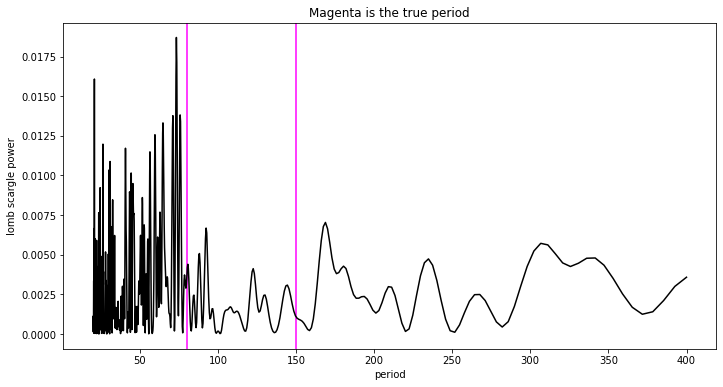

In [1698]:
f = np.linspace(1/400, 1/20, 1000)*np.pi*2
pgram = signal.lombscargle(x,np.random.permutation(y), f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1707]:
from IPython.display import clear_output

In [1710]:
f = np.linspace(1/400, 1/20, 1000)*np.pi*2
boots = np.zeros((10000,1000))
for i in range(10000):
    boots[i] = signal.lombscargle(x,np.random.permutation(y), f, normalize=False)
    print(i)
    clear_output(wait=True)

9999


(array([7.15503e+05, 2.04037e+05, 5.77610e+04, 1.63730e+04, 4.58600e+03,
        1.23500e+03, 3.71000e+02, 1.03000e+02, 2.30000e+01, 8.00000e+00]),
 array([1.42848276e-09, 3.34411219e-03, 6.68822296e-03, 1.00323337e-02,
        1.33764445e-02, 1.67205552e-02, 2.00646660e-02, 2.34087768e-02,
        2.67528875e-02, 3.00969983e-02, 3.34411091e-02]),
 <a list of 10 Patch objects>)

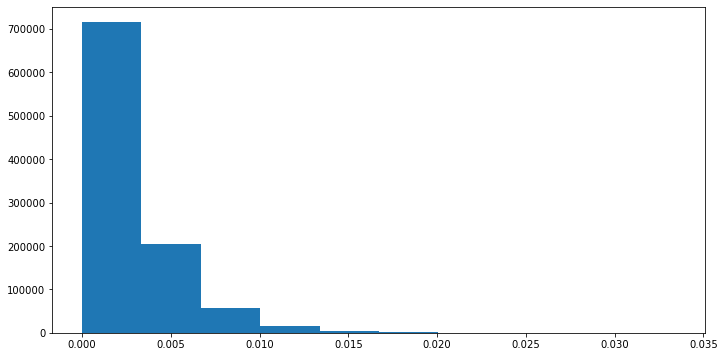

In [1703]:
plt.hist(boots.flatten())

In [1712]:
# test again with alternative temporal structure

27.988835195898826

In [1727]:
data.shape

(747, 3)

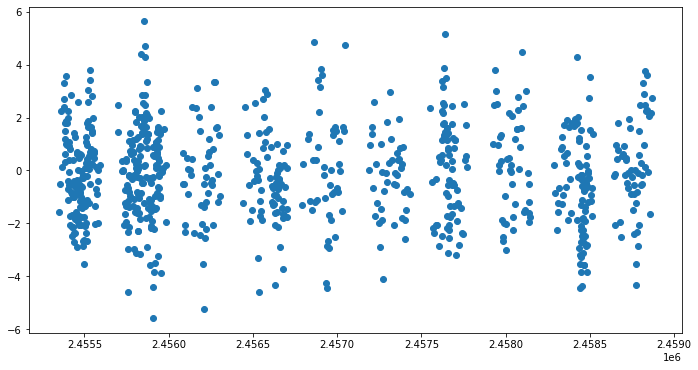

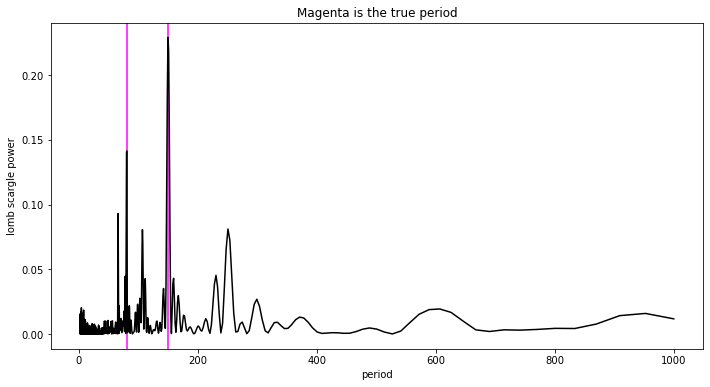

In [1742]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp6.88.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 150
period1 = 80
f=1/period
f1 = 1/period1
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

y += np.sin(x*f1*np.pi*2)+np.random.normal(0,1,size=len(x))

plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1743]:
(x[-1]-x[0])/4

880.6635574999964

In [1758]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/100
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1759]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
293.74 seconds has passed to complete Weighted Wavelet Z-transform 



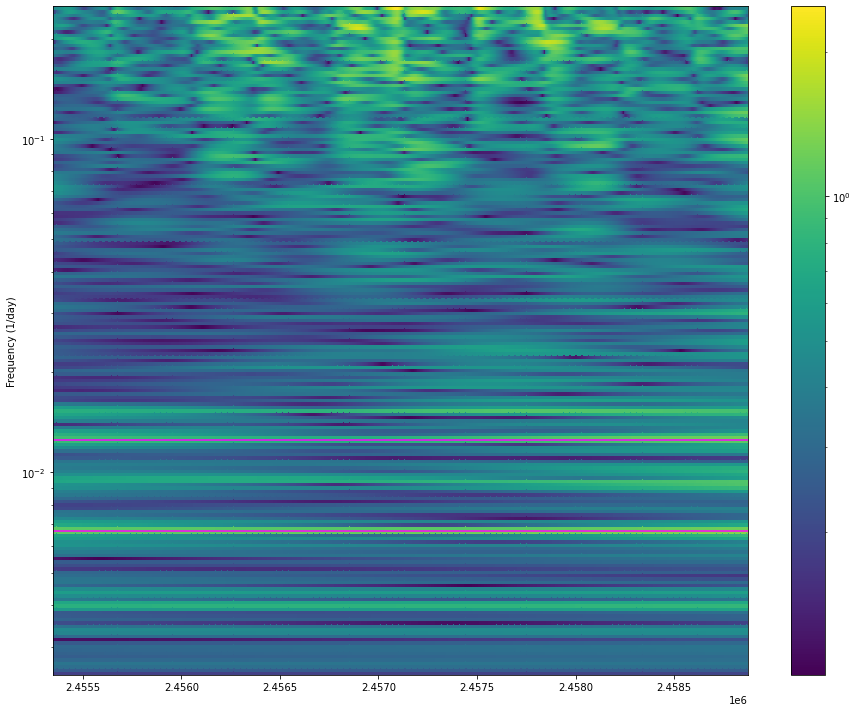

In [1760]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/150, zorder=1, c="magenta")
plt.axhline(y=1/80, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

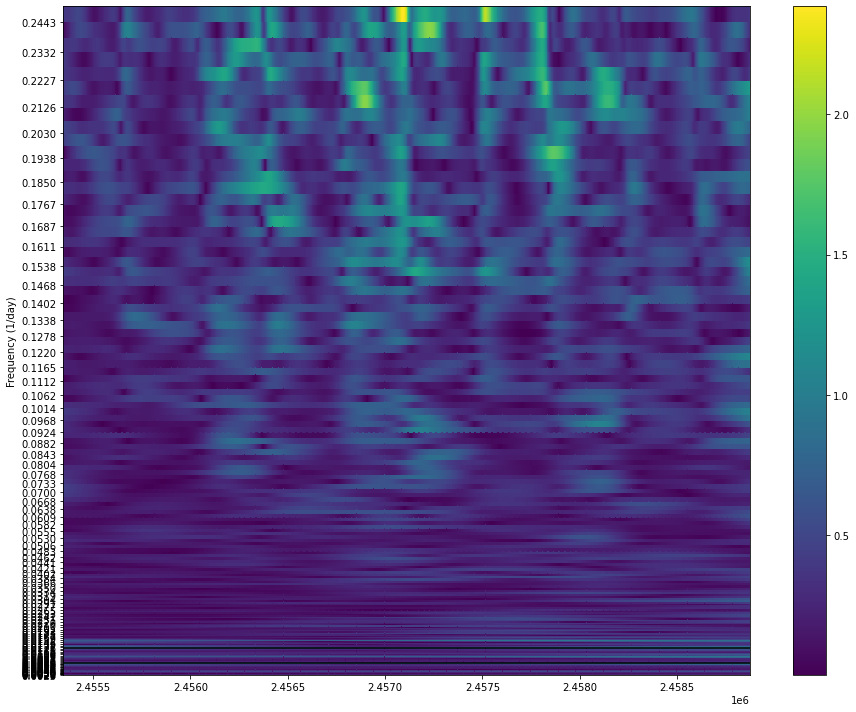

In [1761]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

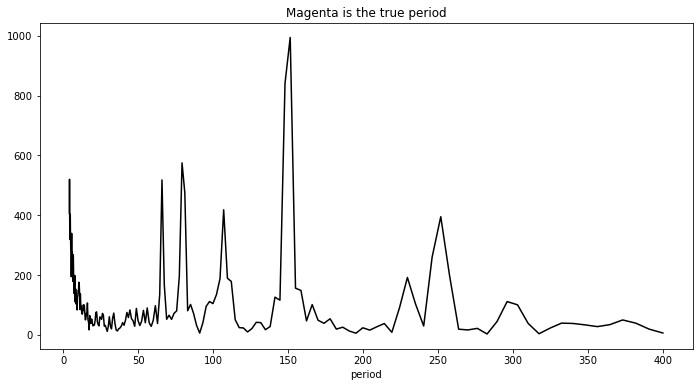

In [1762]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

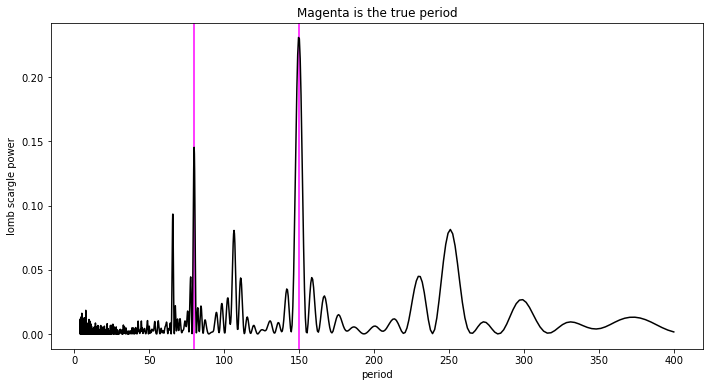

In [1757]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1763]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/100
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1753]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
153.43 seconds has passed to complete Weighted Wavelet Z-transform 



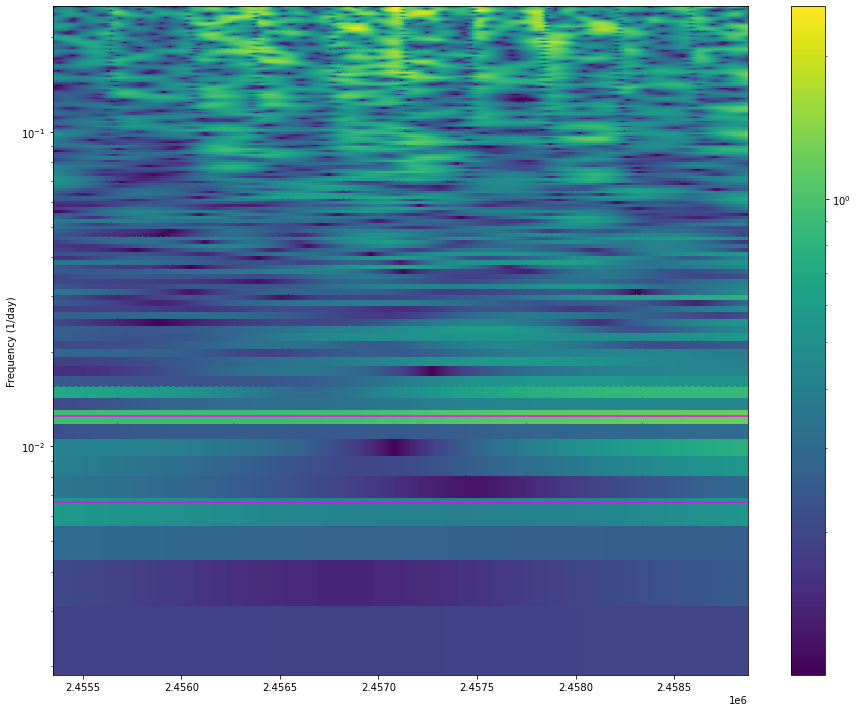

In [1754]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/150, zorder=1, c="magenta")
plt.axhline(y=1/80, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

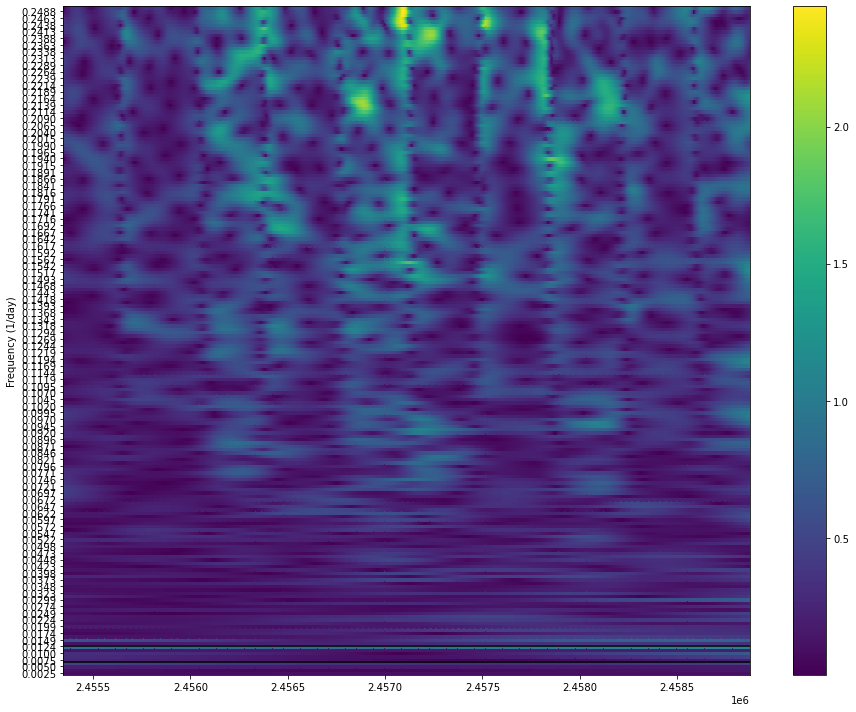

In [1755]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

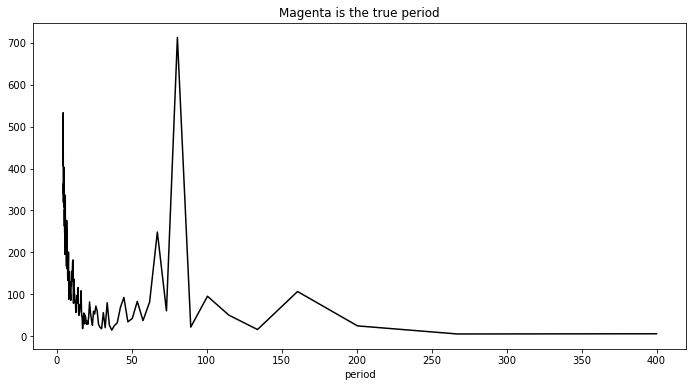

In [1756]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1765]:
len(x)

809

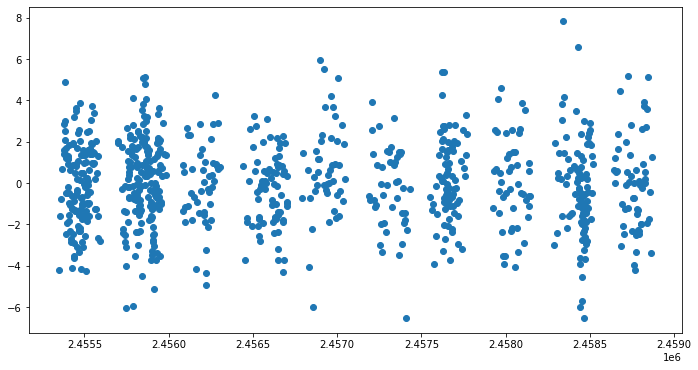

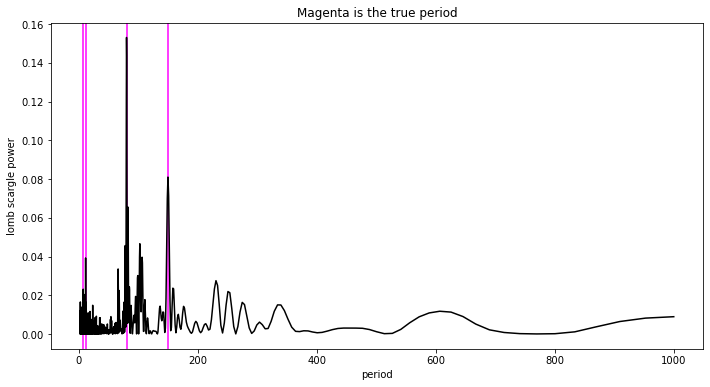

In [1768]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp6.88.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 150
period1 = 80
period2 = 7
period3 = 11
f=1/period
f1 = 1/period1
f2=1/period2
f3 = 1/period3
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

y += np.sin(x*f1*np.pi*2)+np.random.normal(0,1,size=len(x))
y[:400] += np.sin(x[:400]*f2*np.pi*2)+np.random.normal(0,1,size=len(x[:400]))
y[400:] += np.sin(x[400:]*f3*np.pi*2)+np.random.normal(0,1,size=len(x[400:]))


plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.axvline(x=period2, c="magenta", zorder=1)
plt.axvline(x=period3, c="magenta", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1769]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
288.87 seconds has passed to complete Weighted Wavelet Z-transform 



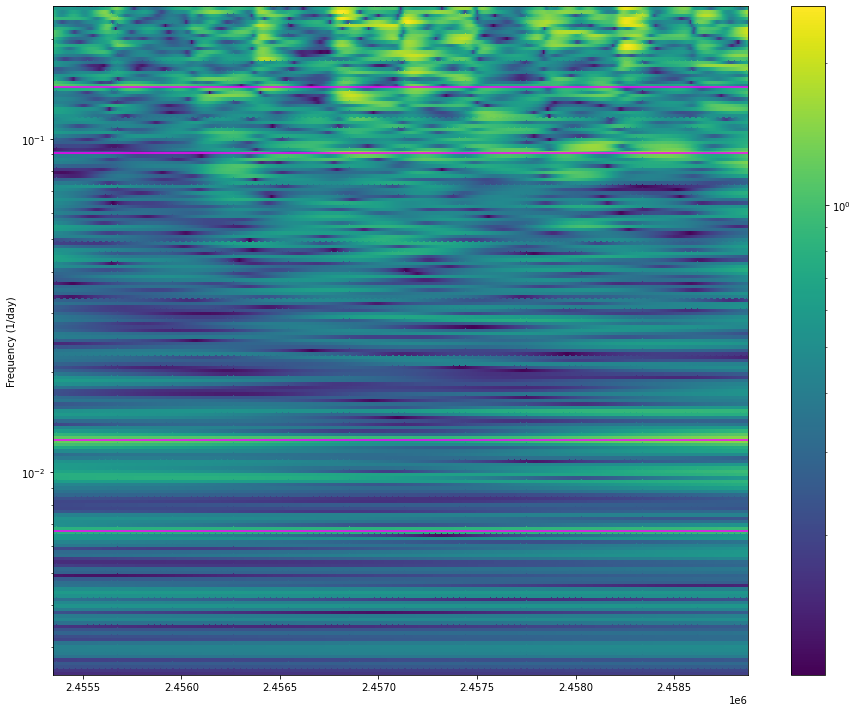

In [1772]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/150, zorder=1, c="magenta")
plt.axhline(y=1/80, zorder=1, c="magenta")
plt.axhline(y=1/11, zorder=1, c="magenta")
plt.axhline(y=1/7, zorder=1, c="magenta")

plt.tight_layout()
plt.show()

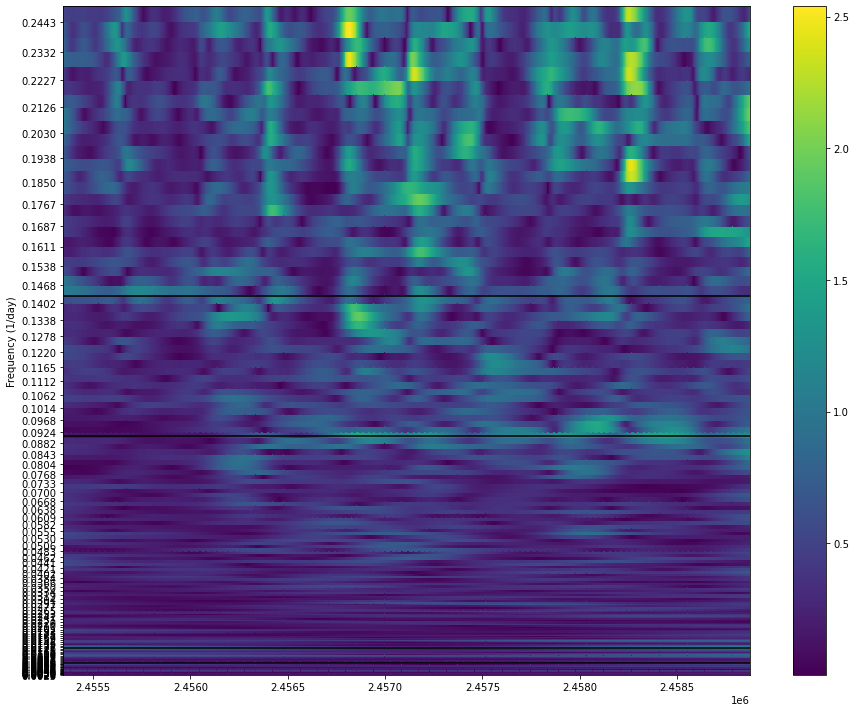

In [1778]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[3])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
plt.axhline(y=1/11, zorder=1, c="black")
plt.axhline(y=1/7, zorder=1, c="black")
plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

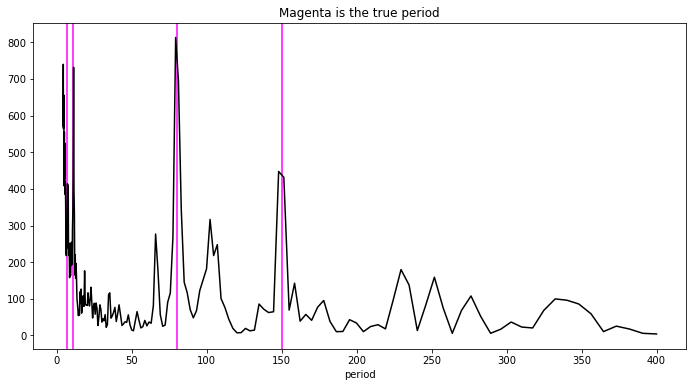

In [1777]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.axvline(x=period2, c="magenta", zorder=1)
plt.axvline(x=period3, c="magenta", zorder=1)

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

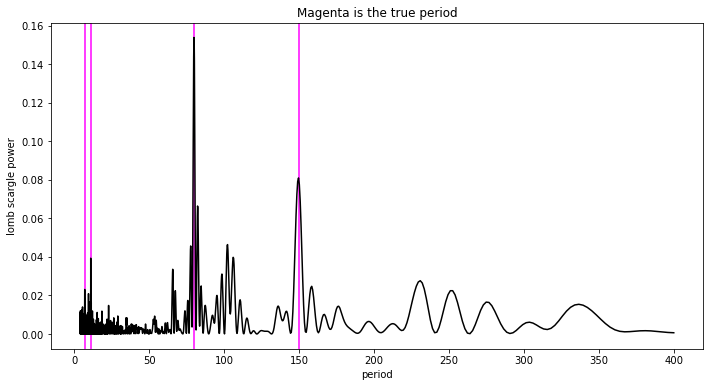

In [1776]:
f = np.linspace(1/400, 1/4, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.axvline(x=period2, c="magenta", zorder=1)
plt.axvline(x=period3, c="magenta", zorder=1)
plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1792]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1793]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_sxp89 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
101.5 seconds has passed to complete Weighted Wavelet Z-transform 



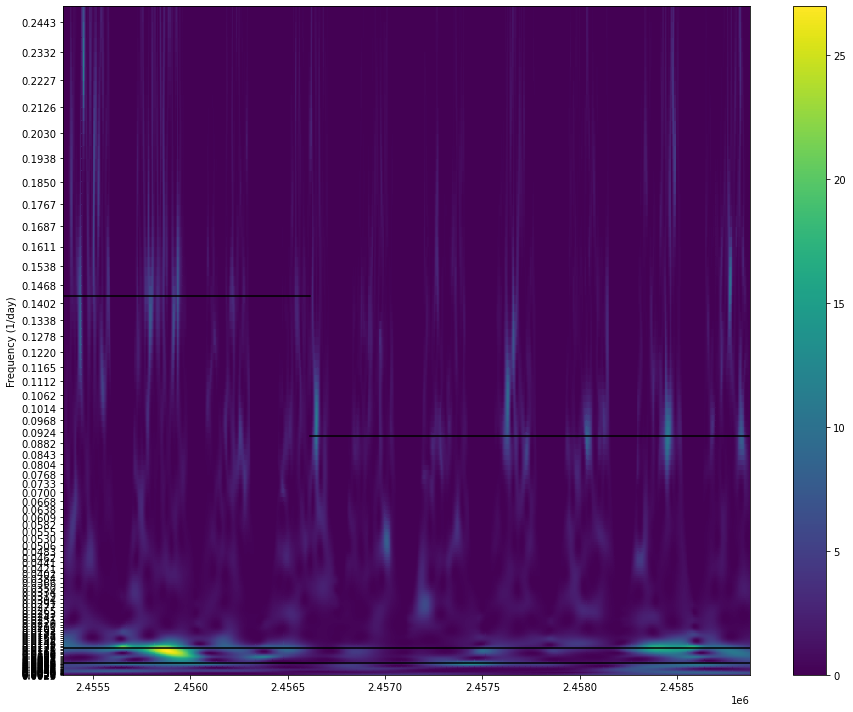

In [1794]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[2])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
# plt.axhline(y=1/11, zorder=1, c="black")
# plt.axhline(y=1/7, zorder=1, c="black")
# plt.axvline(x=x[400], zorder=1, c="black")
plt.plot([x[0],x[400]],[1/7,1/7], zorder=1, c="black")
plt.plot([x[400],x[-1]],[1/11,1/11], zorder=1, c="black")

plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

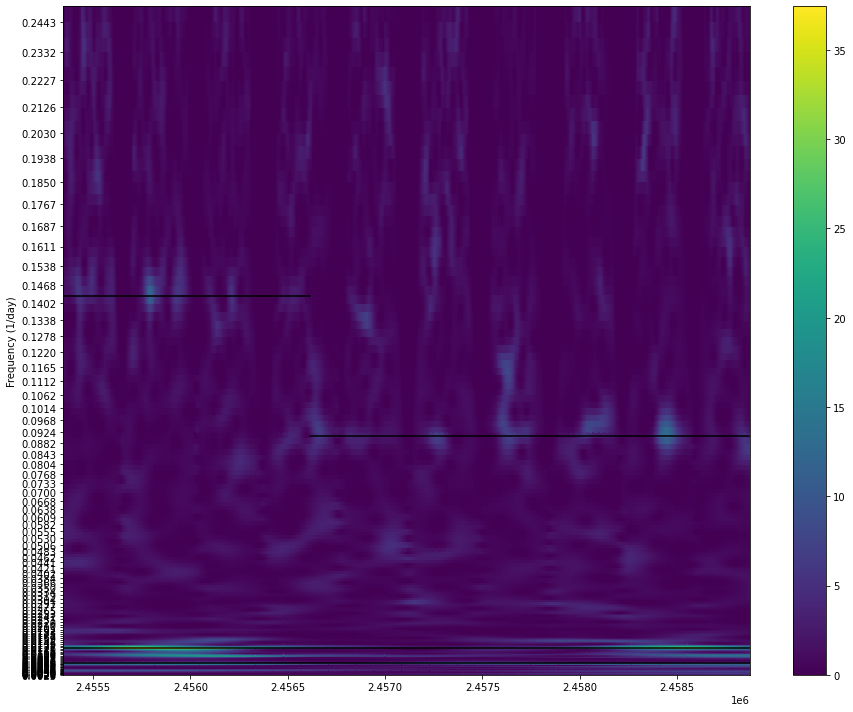

In [1789]:
import libwwz.plot_methods as libplot

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

libplot.linear_plotter(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[2])
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, linear frequency axis')
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
# plt.axhline(y=1/11, zorder=1, c="black")
# plt.axhline(y=1/7, zorder=1, c="black")
# plt.axvline(x=x[400], zorder=1, c="black")
plt.plot([x[0],x[400]],[1/7,1/7], zorder=1, c="black")
plt.plot([x[400],x[-1]],[1/11,1/11], zorder=1, c="black")

plt.locator_params(axis='y', nbins=100)
plt.tight_layout()
plt.show()

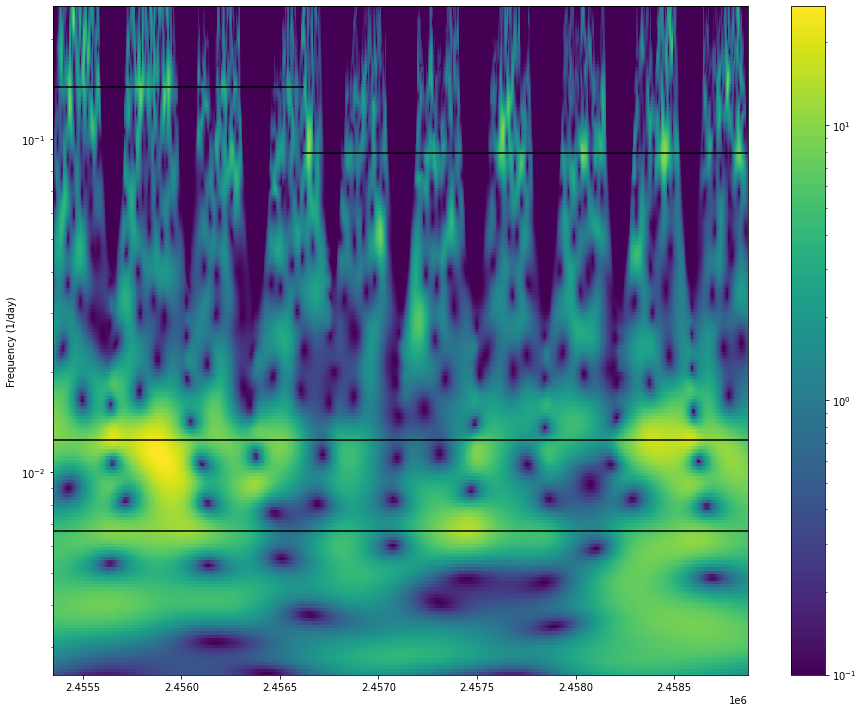

In [1798]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
# ax.set_title('WWA of SXP264 in 20-200 day period range, log frequency axis')
# plt.locator_params(axis='y', nbins=100)
plt.yscale("log")
plt.axhline(y=1/150, zorder=1, c="black")
plt.axhline(y=1/80, zorder=1, c="black")
# plt.axhline(y=1/11, zorder=1, c="black")
# plt.axhline(y=1/7, zorder=1, c="black")
# plt.axvline(x=x[400], zorder=1, c="black")
plt.plot([x[0],x[400]],[1/7,1/7], zorder=1, c="black")
plt.plot([x[400],x[-1]],[1/11,1/11], zorder=1, c="black")

plt.tight_layout()
plt.show()

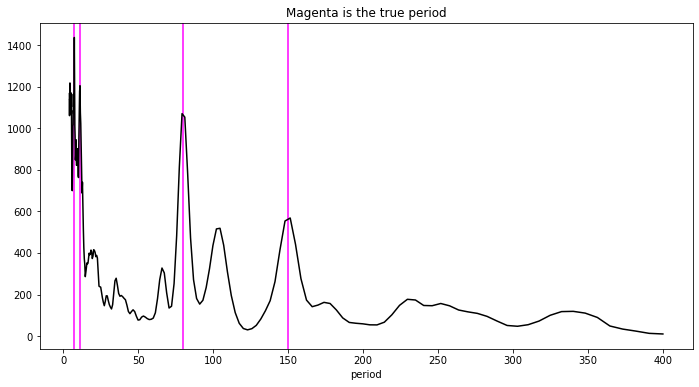

In [1782]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.axvline(x=period2, c="magenta", zorder=1)
plt.axvline(x=period3, c="magenta", zorder=1)

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

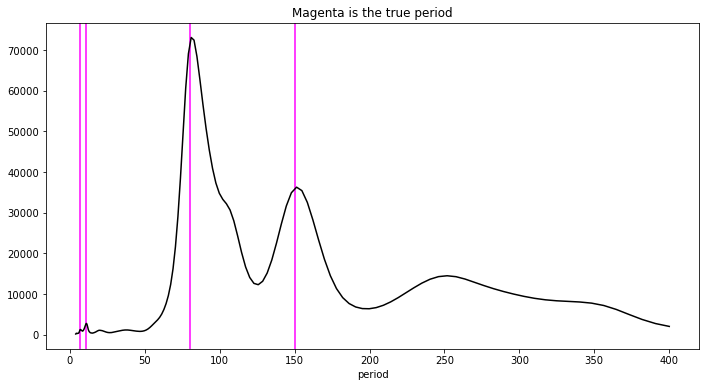

In [1795]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")
plt.axvline(x=period, c="magenta", zorder=1)
plt.axvline(x=period1, c="magenta", zorder=1)
plt.axvline(x=period2, c="magenta", zorder=1)
plt.axvline(x=period3, c="magenta", zorder=1)

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

# try simple signals

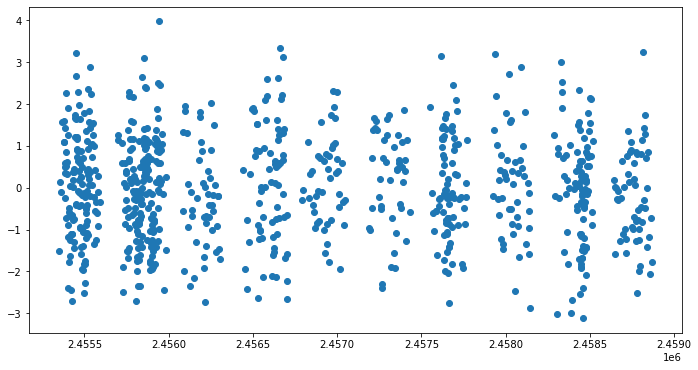

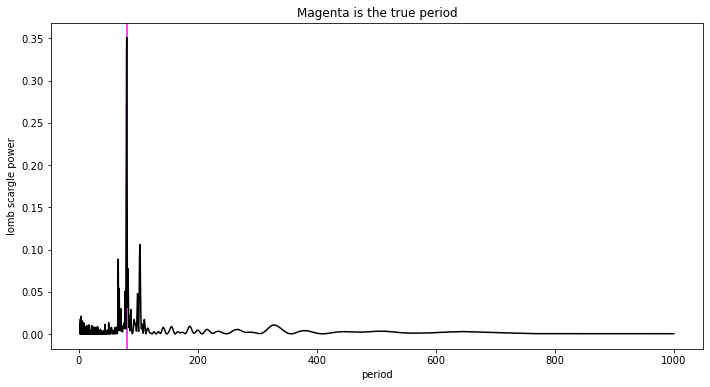

In [1799]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp6.88.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 80
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

plt.scatter(x,y)
plt.show()
plt.xlabel("value")
plt.ylabel("amplitude")
plt.title("Sine wave with random noise, randomly missing data and regular epochs")

f = np.linspace(1/1000, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="magenta", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")

# for harm in range(2,7):
#     plt.axvline(x=period*harm, c="cyan", zorder=1)
#     plt.axvline(x=period/harm, c="cyan", zorder=1)


plt.show()

In [1800]:
# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/4
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True

In [1801]:
# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_80d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  809
Pseudo sample frequency (median) is  0.499
largest tau window is  4.36
102.0 seconds has passed to complete Weighted Wavelet Z-transform 



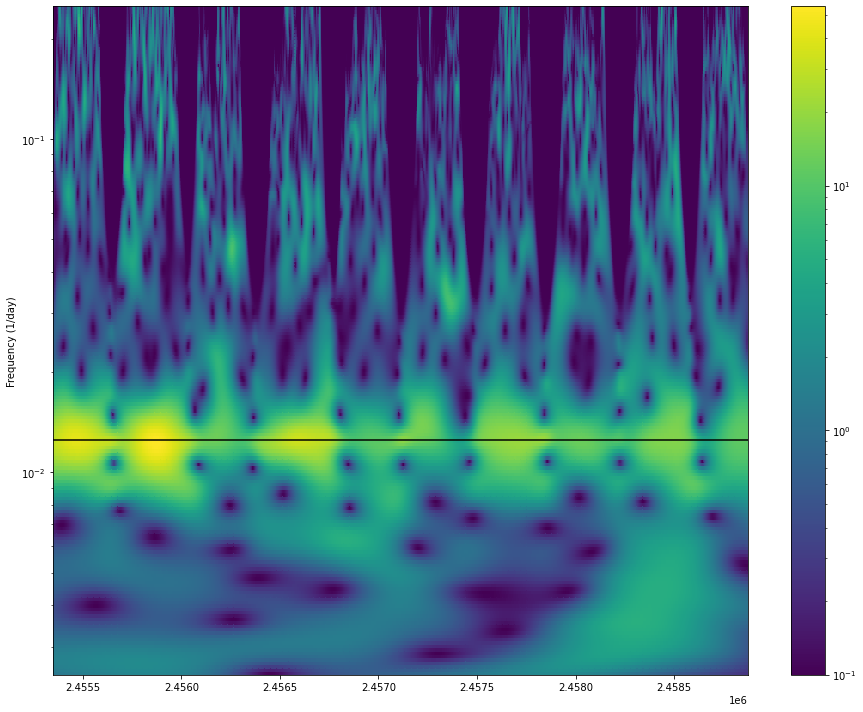

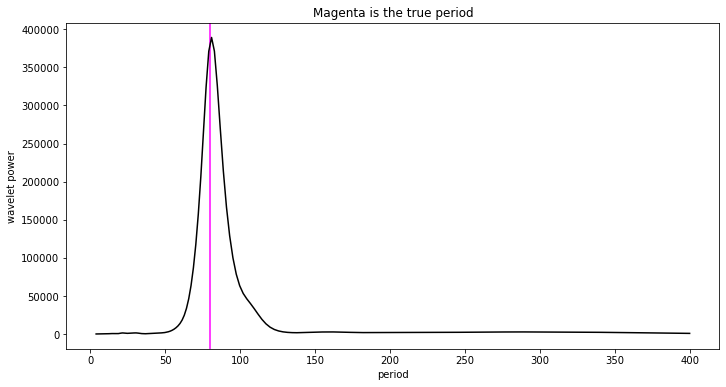

In [1810]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_sxp89[0],
                       FREQ=wwt_sxp89[1],
                       DATA=wwt_sxp89[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/80, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("Magenta is the true period")
plt.axvline(x=period, c="magenta", zorder=1)


plt.show()

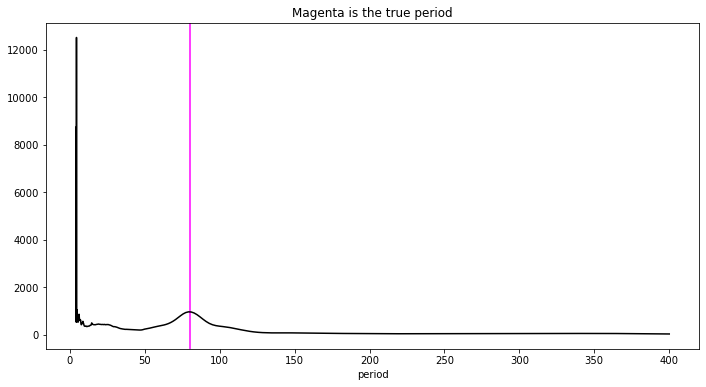

In [1805]:
plt.plot(1/wwt_sxp89[1][0], np.sum(np.abs(wwt_sxp89[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
# plt.ylabel("lomb scargle power")
plt.title("Magenta is the true period")
plt.axvline(x=period, c="magenta", zorder=1)


plt.show()

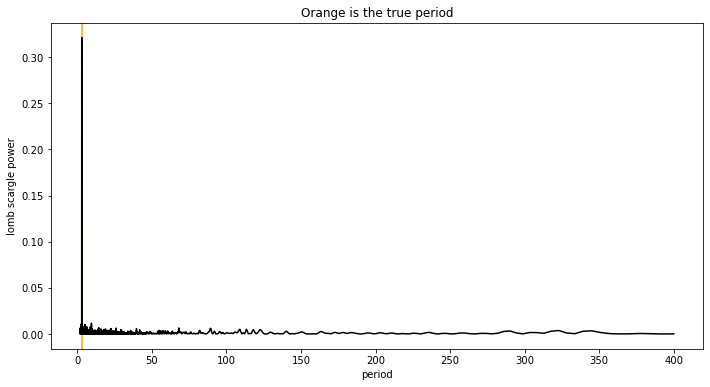

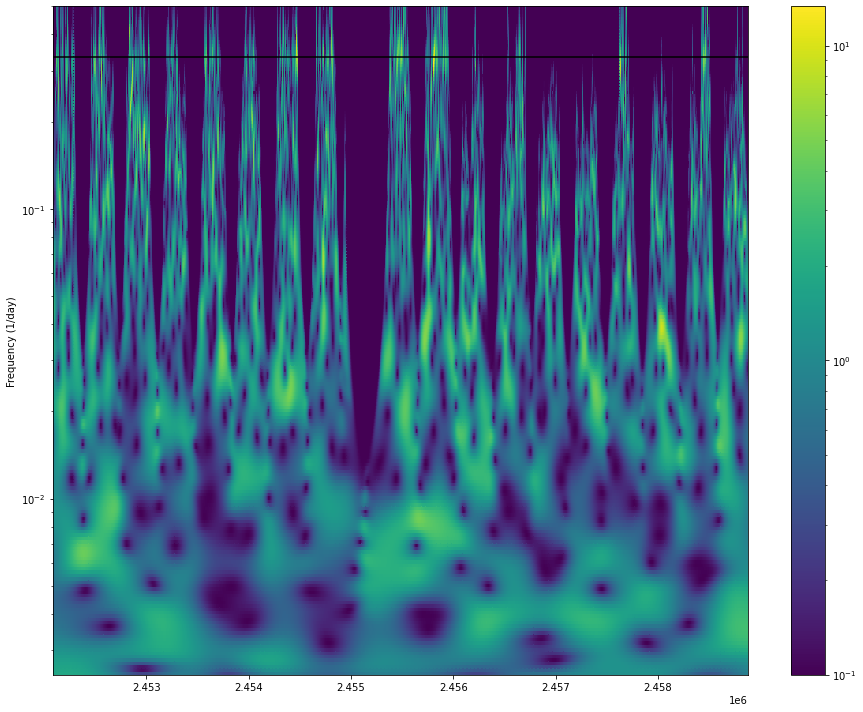

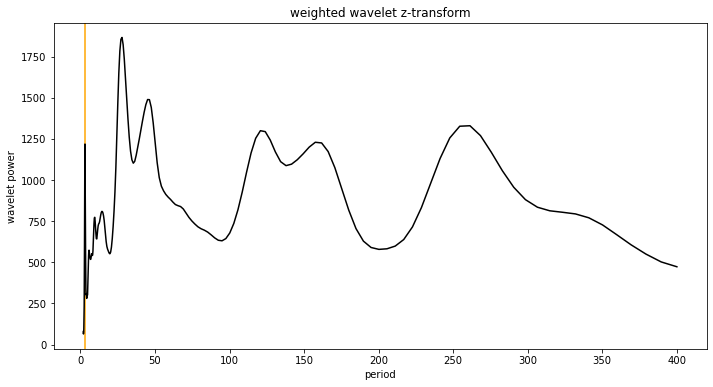

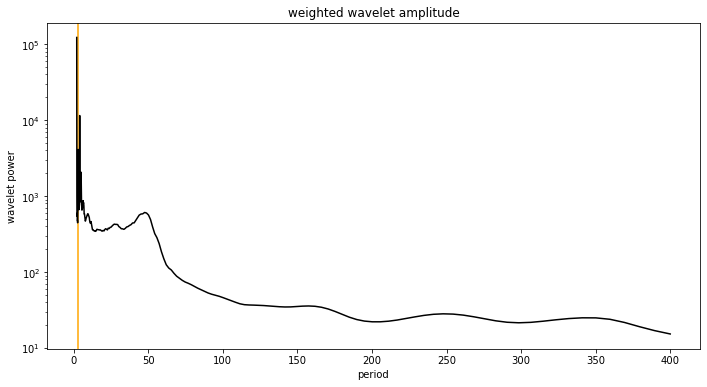

In [1878]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_3d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)
wwt_spec = wwt_3d 
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.yscale("log")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1854]:
1/wwt_3d[1][0][-50:][np.argmax(np.sum(np.abs(wwt_3d[2])**2, axis=0)[-50:])]

3.0622273603455006

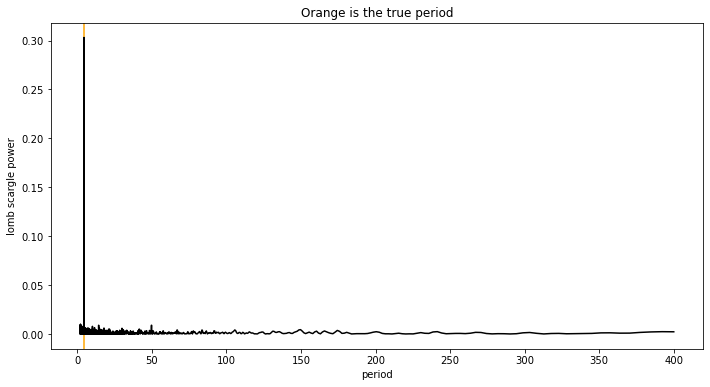

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  7.708
116.19 seconds has passed to complete Weighted Wavelet Z-transform 



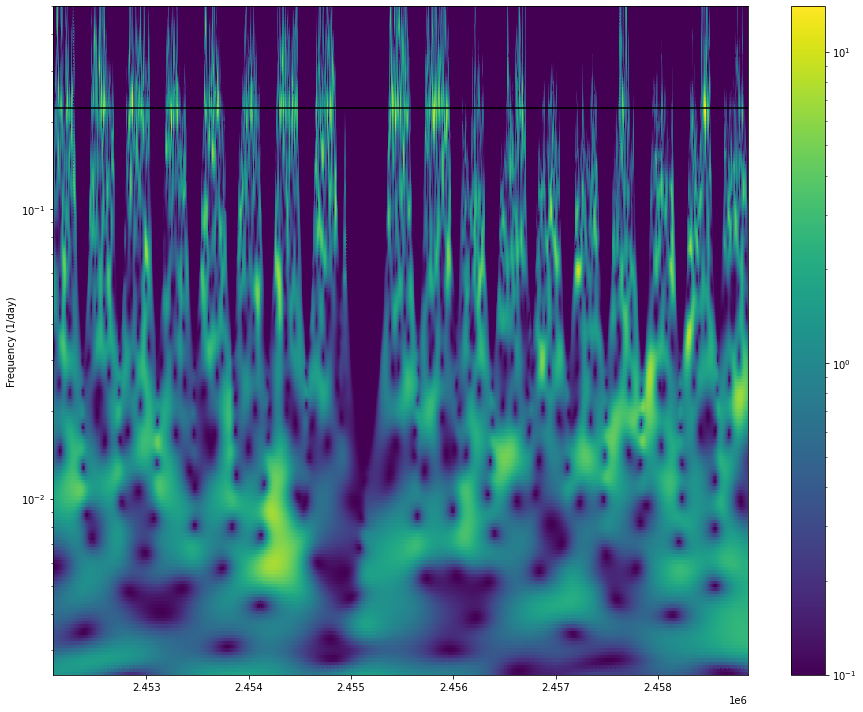

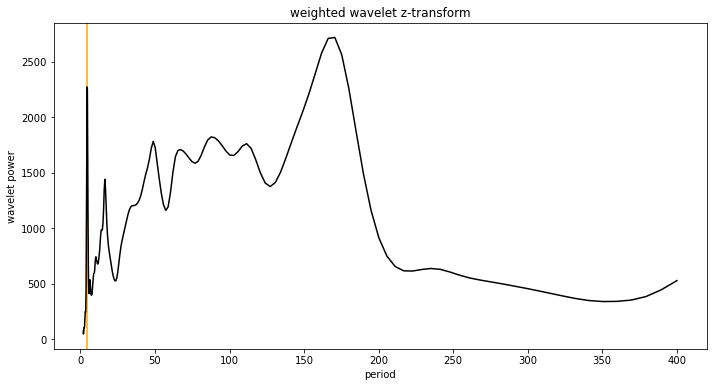

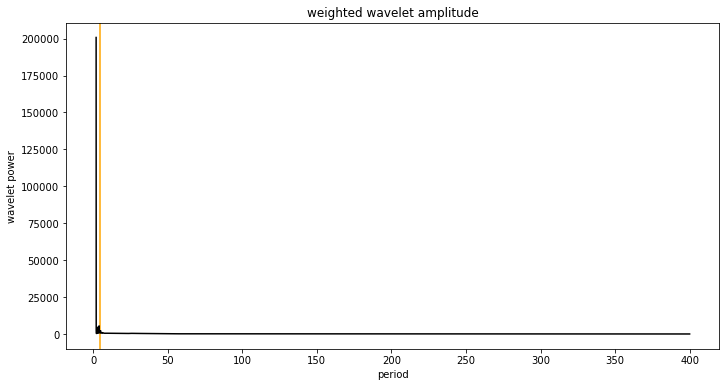

In [1836]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 4.5
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_4_5d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1856]:
1/wwt_4_5d[1][0][-50:][np.argmax(np.sum(np.abs(wwt_4_5d[2])**2, axis=0)[-50:])]

4.565432273182875

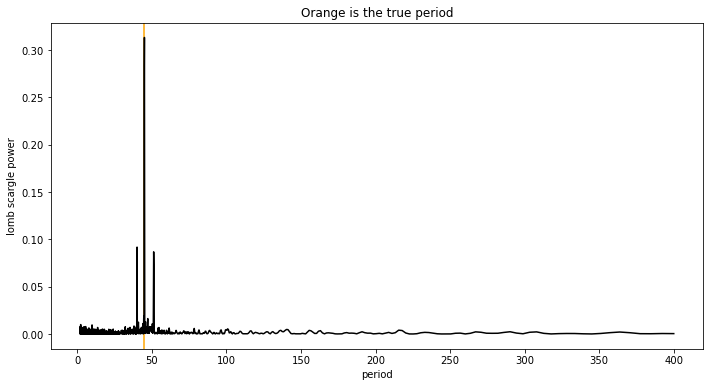

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  7.708
115.68 seconds has passed to complete Weighted Wavelet Z-transform 



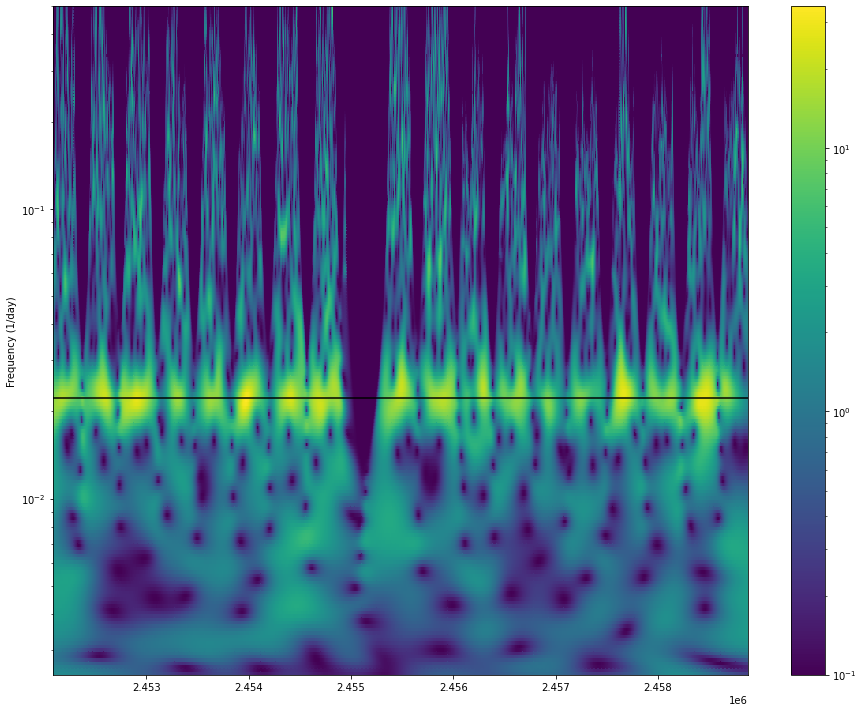

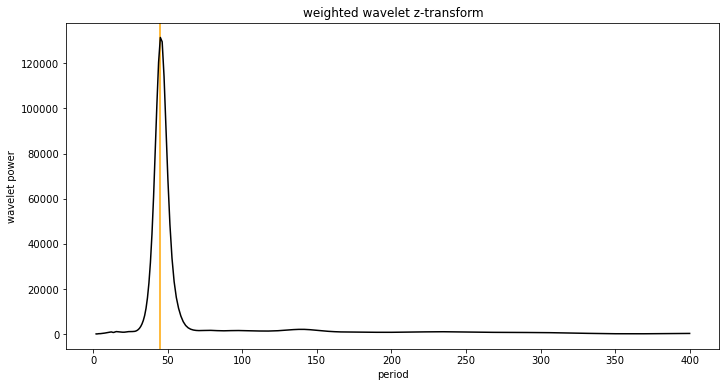

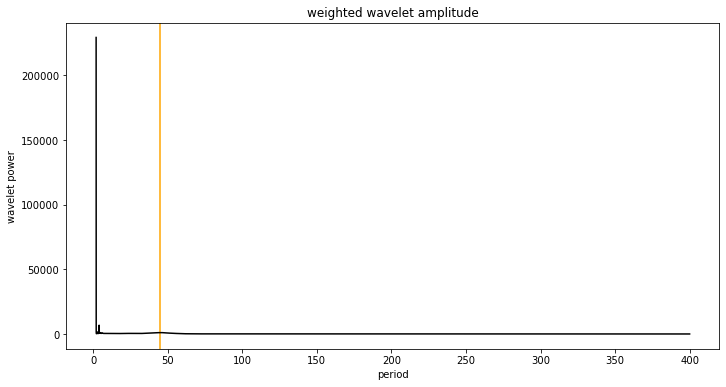

In [1837]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 45
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_45d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1858]:
1/wwt_45d[1][0][np.argmax(np.sum(np.abs(wwt_45d[2])**2, axis=0))]

45.0709671613333

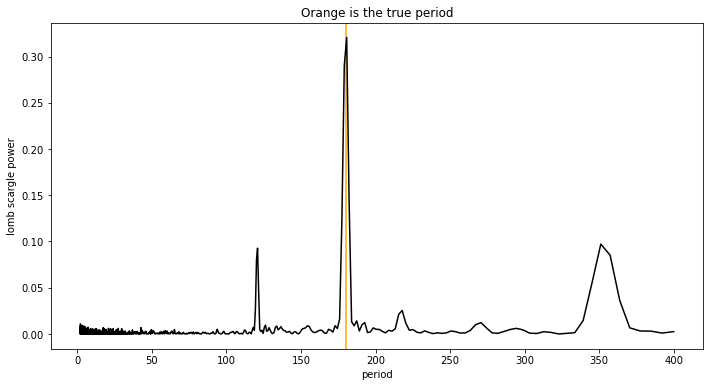

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  7.708
115.94 seconds has passed to complete Weighted Wavelet Z-transform 



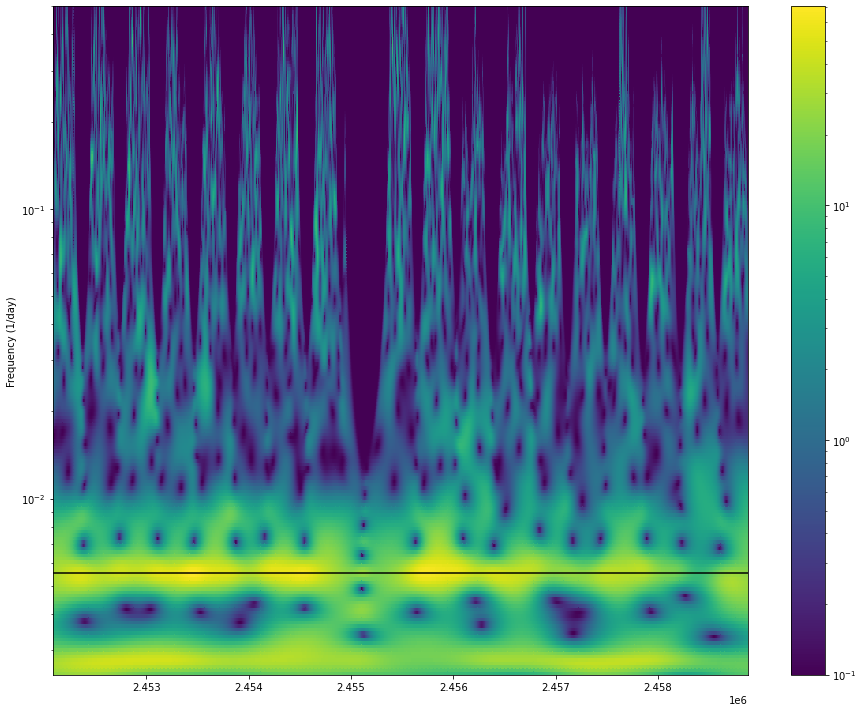

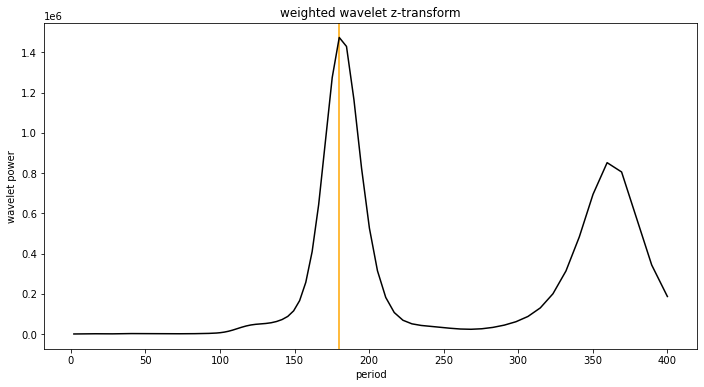

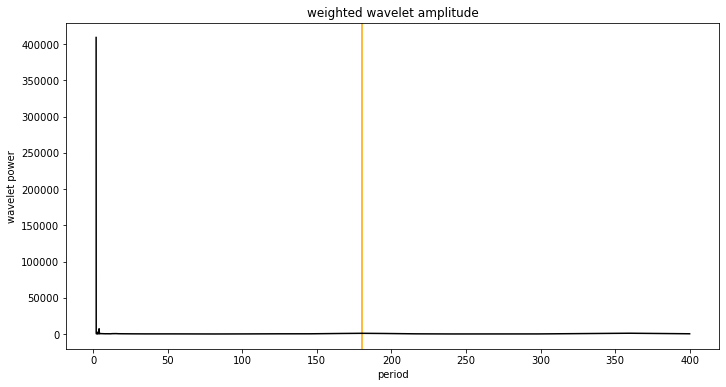

In [1838]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 180
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_180d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1859]:
1/wwt_180d[1][0][np.argmax(np.sum(np.abs(wwt_180d[2])**2, axis=0))]

180.1169213183198

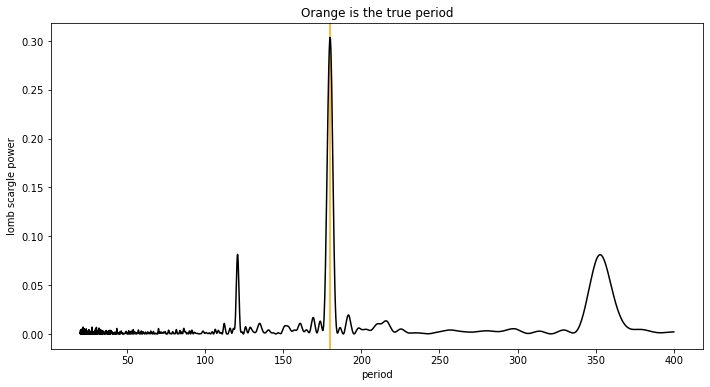

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  7.708
193.93 seconds has passed to complete Weighted Wavelet Z-transform 



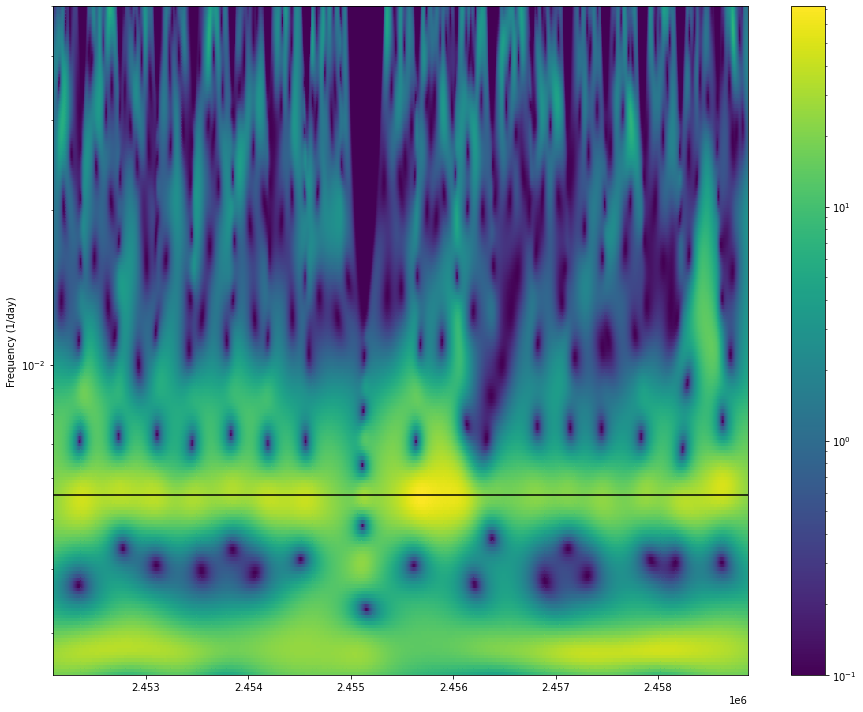

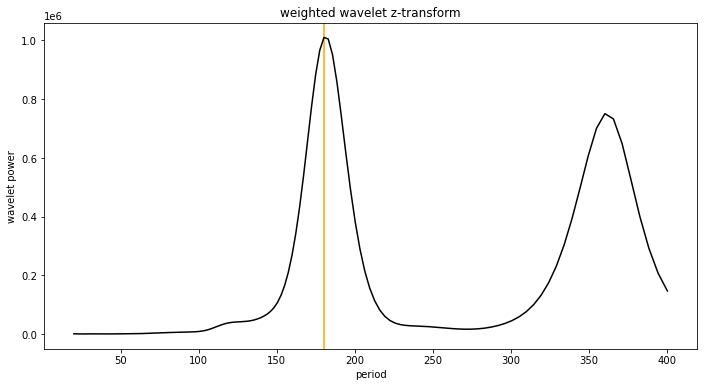

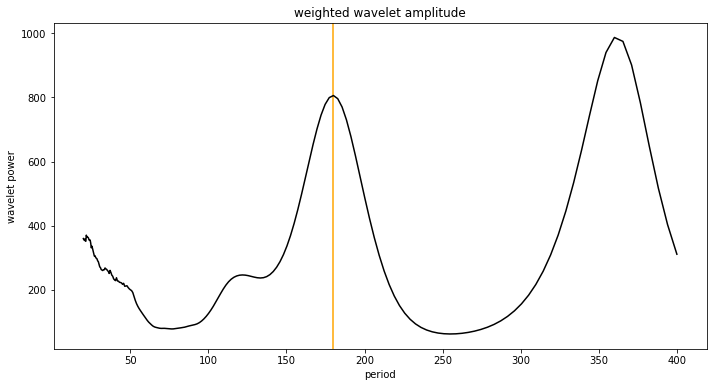

In [1845]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 180
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/20, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/20
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_180d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

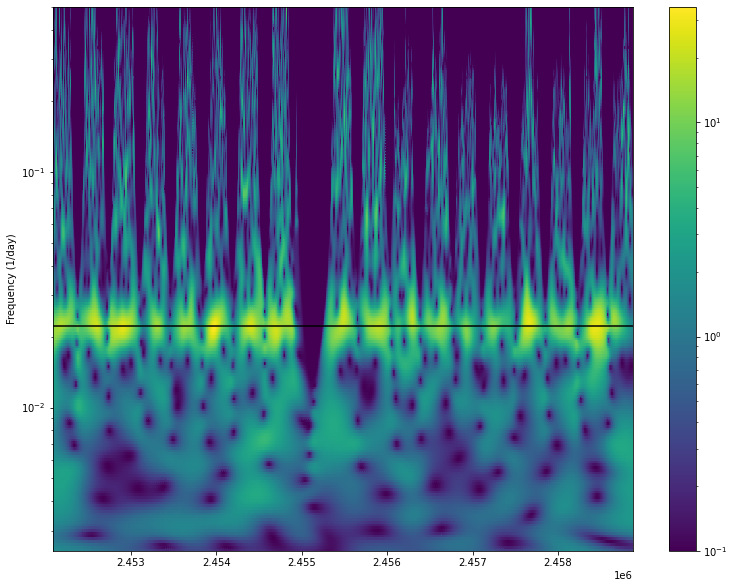

In [1863]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_45d[0],
                       FREQ=wwt_45d[1],
                       DATA=wwt_45d[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/45, zorder=1, c="black")

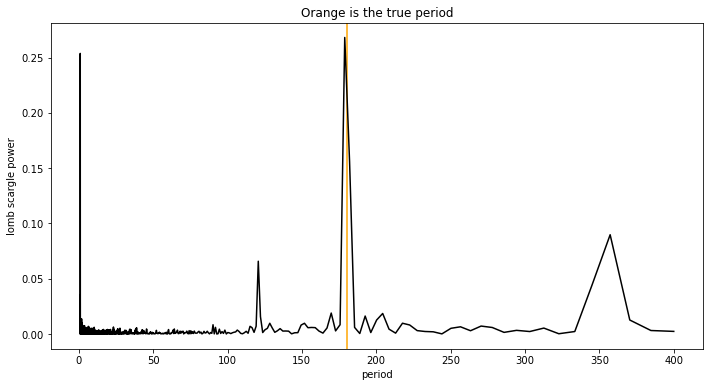

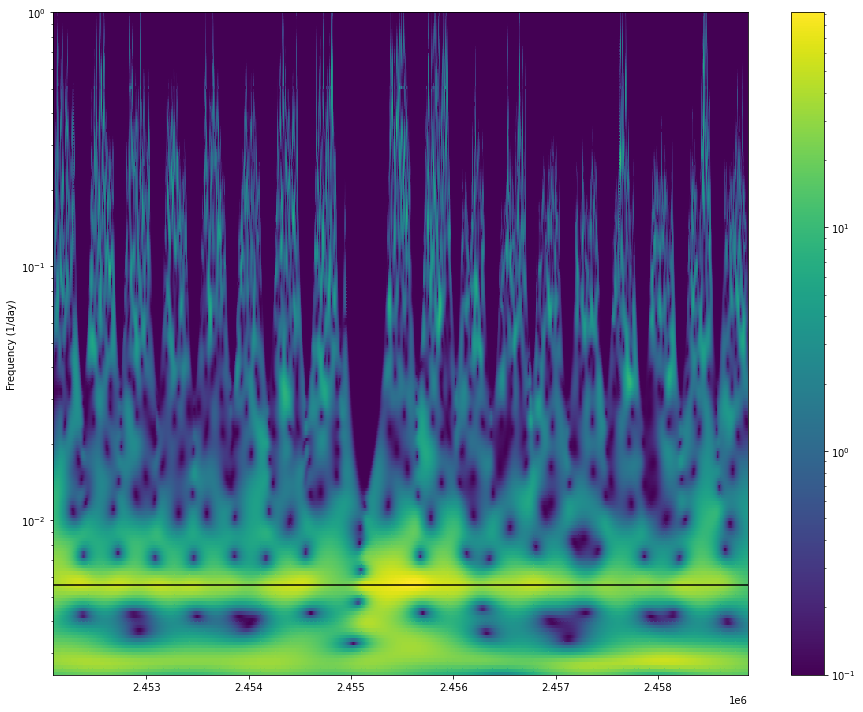

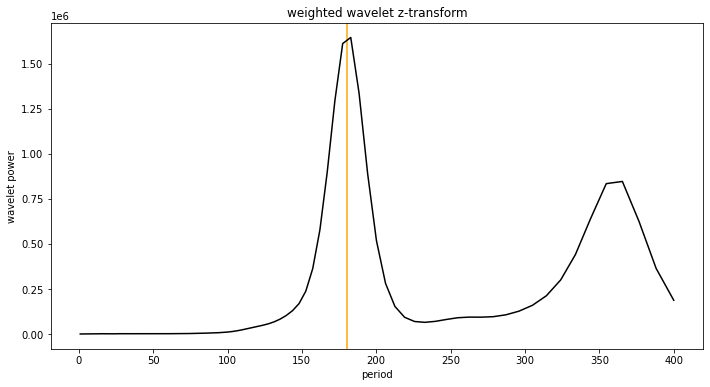

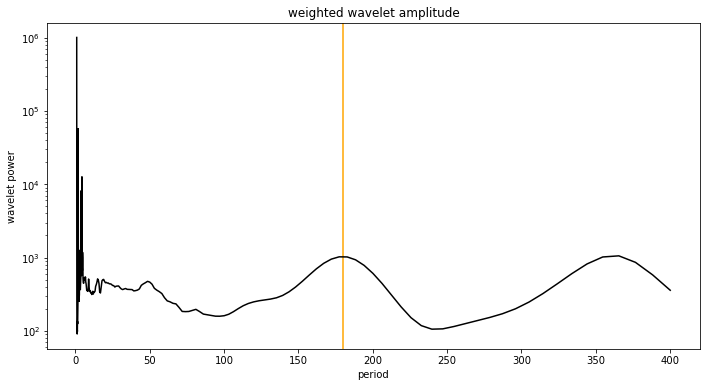

In [1876]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
period = 180
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/1, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/1
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_180d = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.yscale("log")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1865]:
1/wwt_spec[1][0][np.argmax(np.sum(np.abs(wwt_spec[3])**2, axis=0))]

1.0

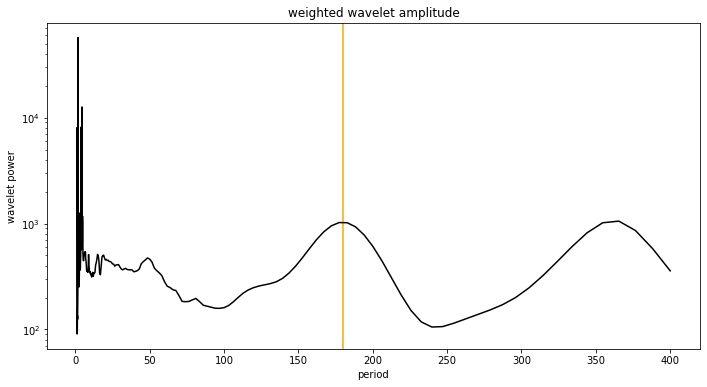

In [1875]:
plt.plot(1/wwt_spec[1][0][:-1], np.sum(np.abs(wwt_spec[3])**2, axis=0)[:-1], c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.yscale("log")

plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [1874]:
np.sum(np.abs(wwt_spec[3])**2, axis=0)

array([3.57517126e+02, 5.80195862e+02, 8.58969587e+02, 1.05366409e+03,
       1.01670441e+03, 8.17525056e+02, 6.03208688e+02, 4.36634766e+02,
       3.21690639e+02, 2.46787103e+02, 1.99932413e+02, 1.71060202e+02,
       1.52264144e+02, 1.38126661e+02, 1.25754794e+02, 1.14583652e+02,
       1.06364228e+02, 1.05314340e+02, 1.17743157e+02, 1.50937999e+02,
       2.12437596e+02, 3.08995910e+02, 4.43066936e+02, 6.07462338e+02,
       7.81307080e+02, 9.30581386e+02, 1.01771470e+03, 1.02156927e+03,
       9.50568455e+02, 8.33321974e+02, 7.00568265e+02, 5.75718124e+02,
       4.72611245e+02, 3.95185147e+02, 3.40322431e+02, 3.03792705e+02,
       2.82299798e+02, 2.71058087e+02, 2.64105983e+02, 2.57126305e+02,
       2.48191169e+02, 2.36125957e+02, 2.19987074e+02, 2.00852977e+02,
       1.82351101e+02, 1.68278329e+02, 1.60652374e+02, 1.58200306e+02,
       1.58432031e+02, 1.61825274e+02, 1.65574613e+02, 1.69163026e+02,
       1.83131610e+02, 1.96278606e+02, 1.89864367e+02, 1.83645230e+02,
      

In [ ]:
def make_tau(timestamps: np.ndarray,
             time_divisions: int) -> np.ndarray:
    """
    Creates an array of times with given timestamps and time divisions to iterate over in the wwt code.
    :param timestamps: An array with corresponding times for the magnitude (payload).
    :param time_divisions: number of divisions for the new timestamps
    :return: tau
    """

    # Check to see if time_divisions is smaller than timestamps (replace if larger)
    if time_divisions > len(timestamps):
        time_divisions = len(timestamps)
        print('adjusted time_divisions to: ', time_divisions)

    # Make tau
    tau: np.ndarray = np.linspace(timestamps[0], timestamps[-1], time_divisions)

    return tau


(array([1.577e+03, 1.000e+00, 6.000e+00, 1.000e+01, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([3.35999997e-03, 3.94027150e+01, 7.88020700e+01, 1.18201425e+02,
        1.57600780e+02, 1.97000135e+02, 2.36399490e+02, 2.75798845e+02,
        3.15198200e+02, 3.54597555e+02, 3.93996910e+02]),
 <a list of 10 Patch objects>)

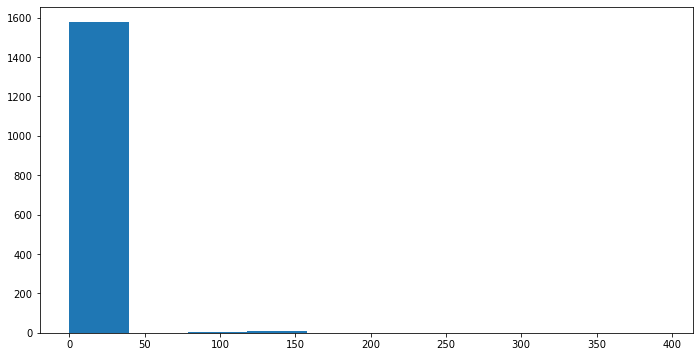

In [1831]:
plt.hist(data[1:,0]-data[:-1,0])

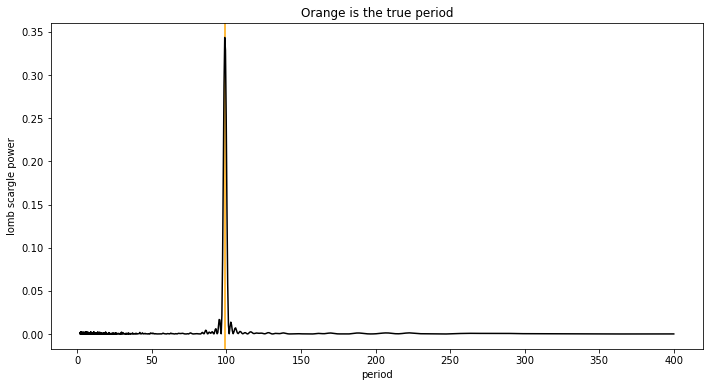

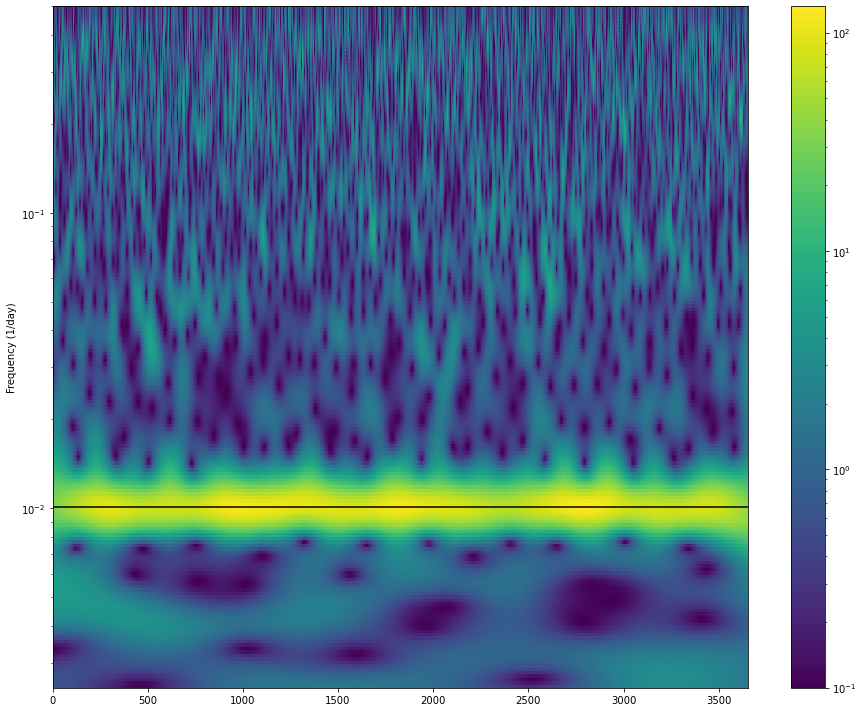

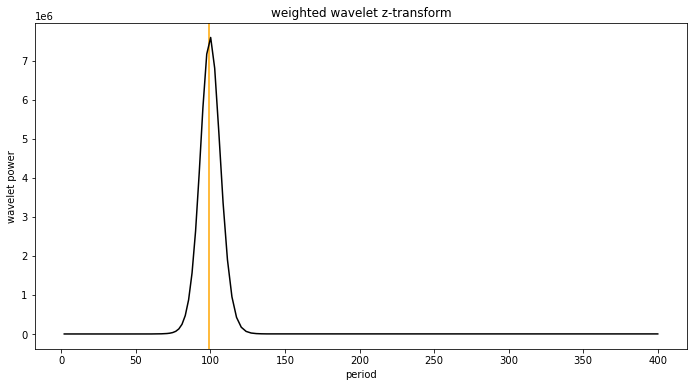

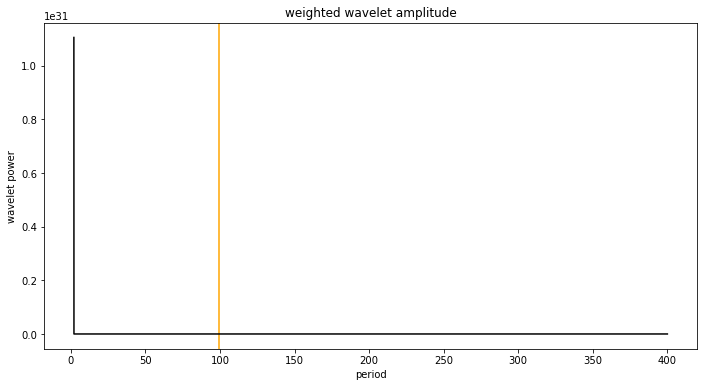

In [1903]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.array(range(3650))
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_1 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

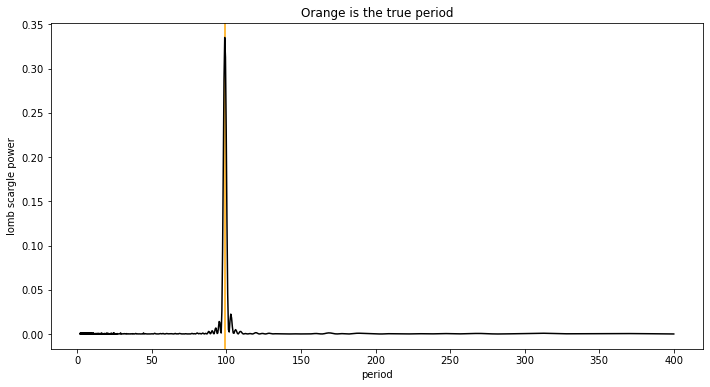

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  2.0
largest tau window is  4.148
916.96 seconds has passed to complete Weighted Wavelet Z-transform 



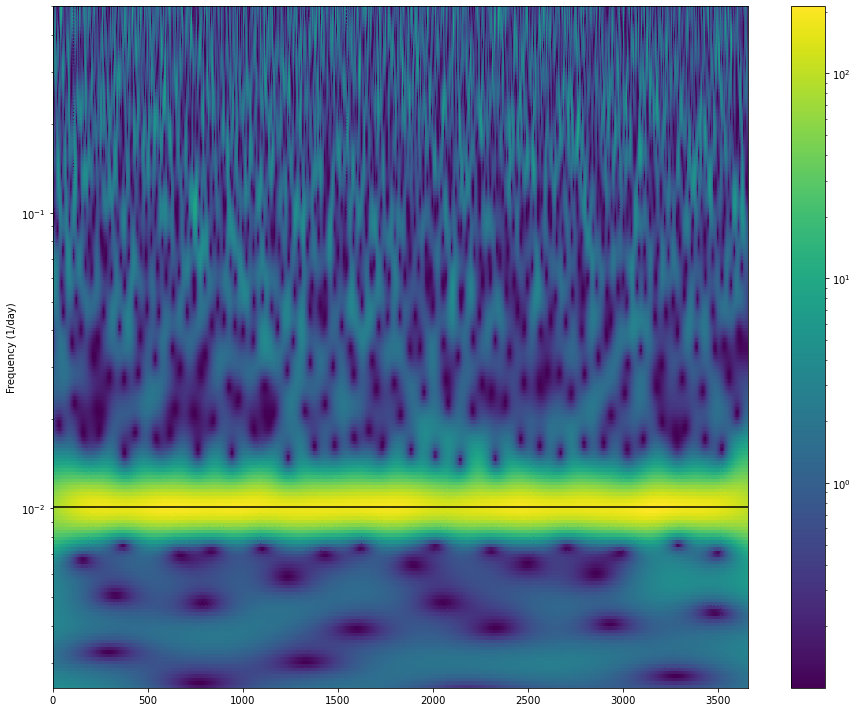

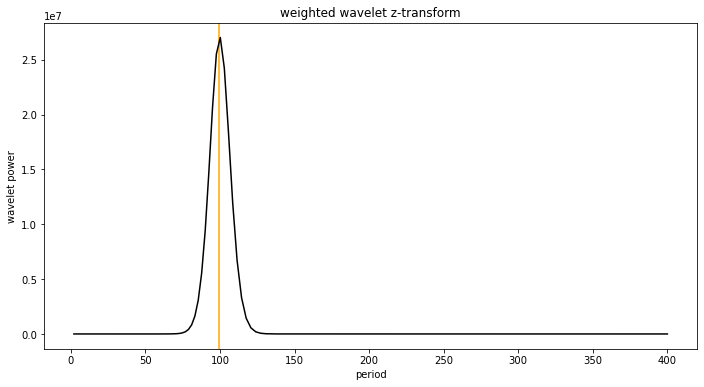

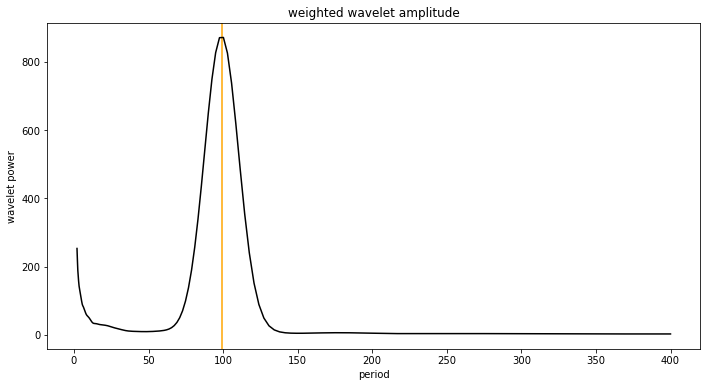

In [1904]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 3650, num=3650*2)
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvlineconvolve(x=period, c="orange", zorder=1)
plt.show()

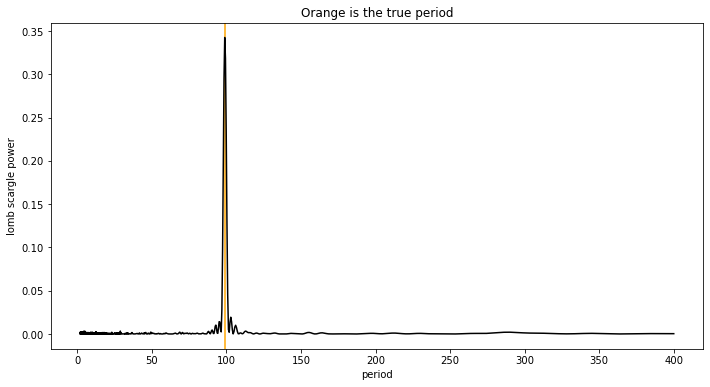

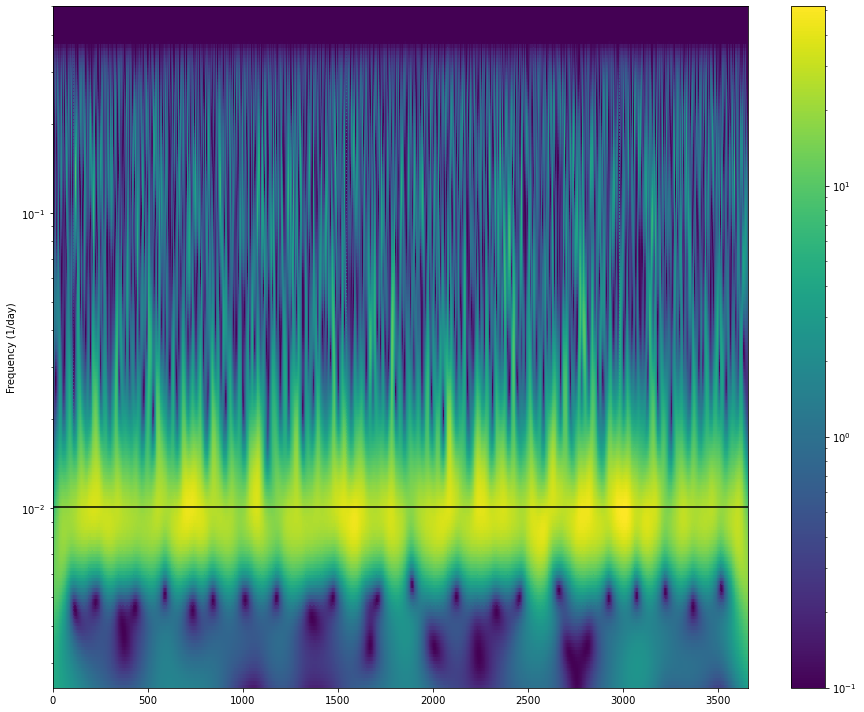

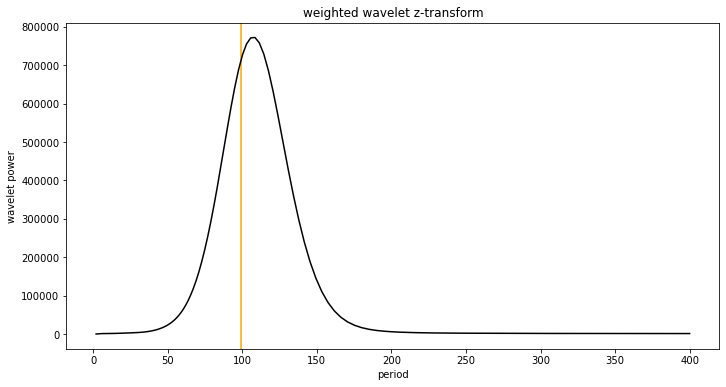

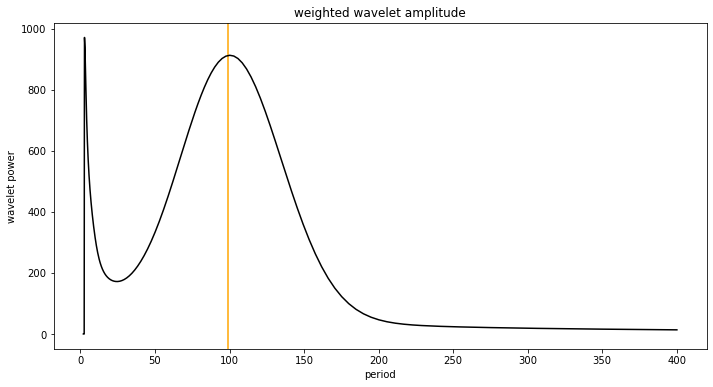

In [1906]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 3650, num=3650)
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)*10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

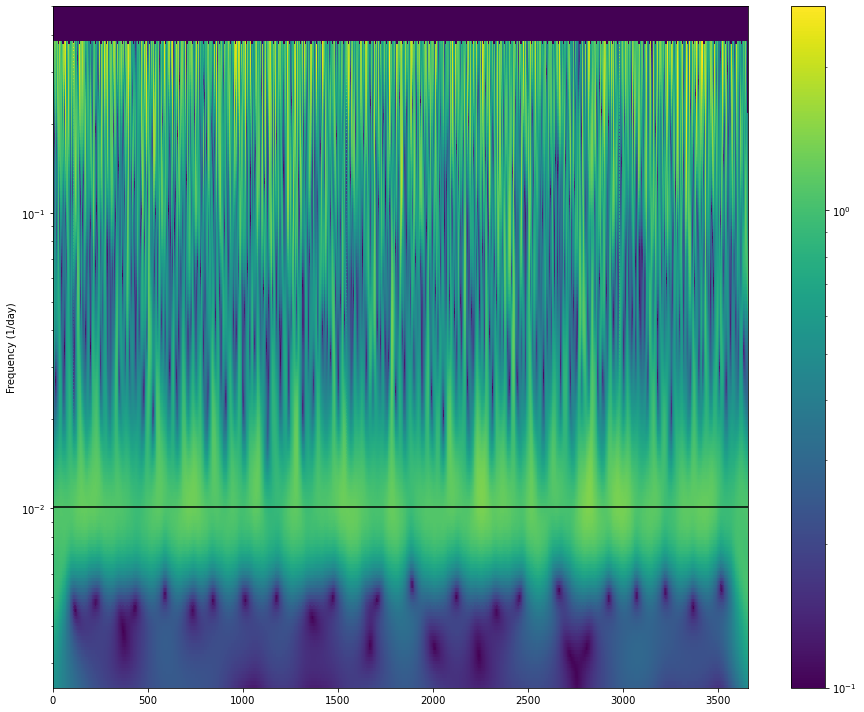

In [1908]:

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

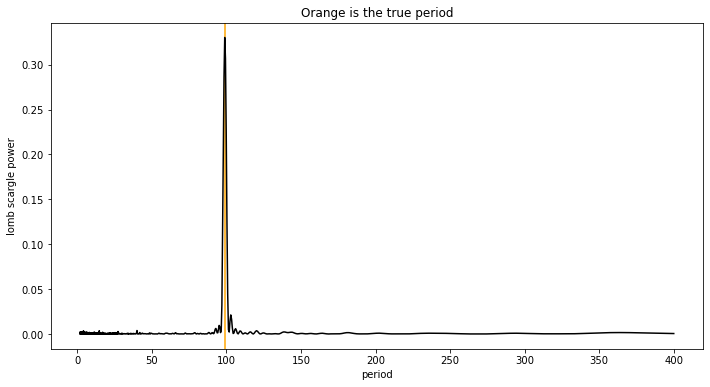

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.0
largest tau window is  4.148
875.42 seconds has passed to complete Weighted Wavelet Z-transform 



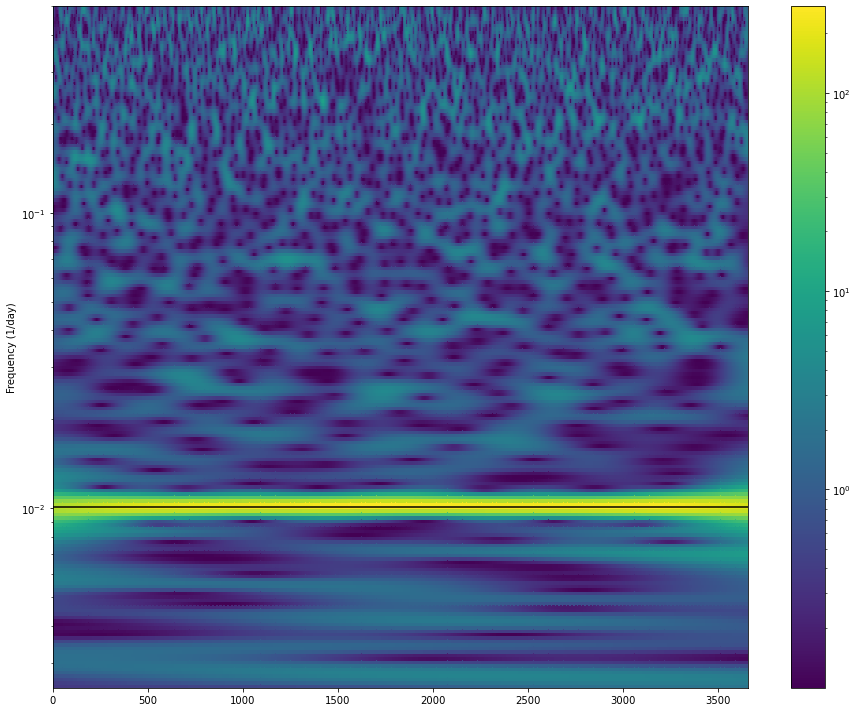

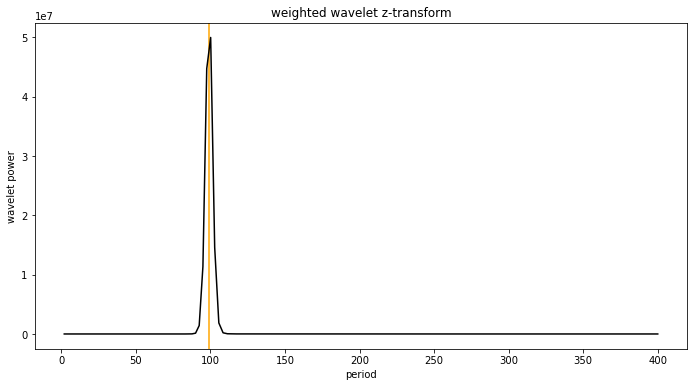

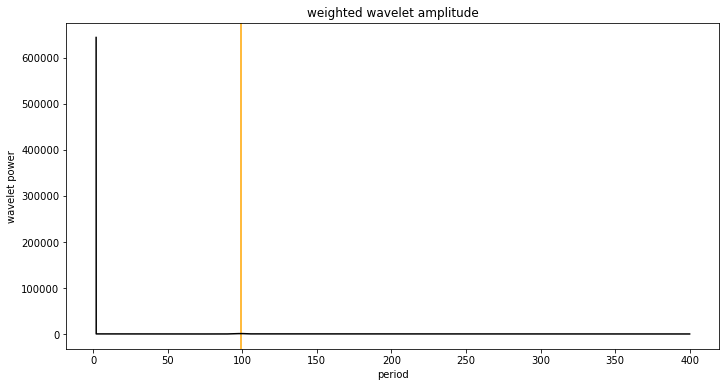

In [1909]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 3650, num=3650)
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 881 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/https://www.islandbuses.info/services/SQ/7#disruptions10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

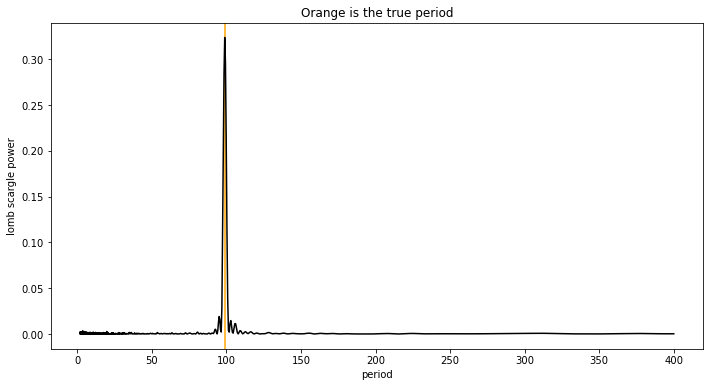

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.0
largest tau window is  1.0
1887.06 seconds has passed to complete Weighted Wavelet Z-transform 



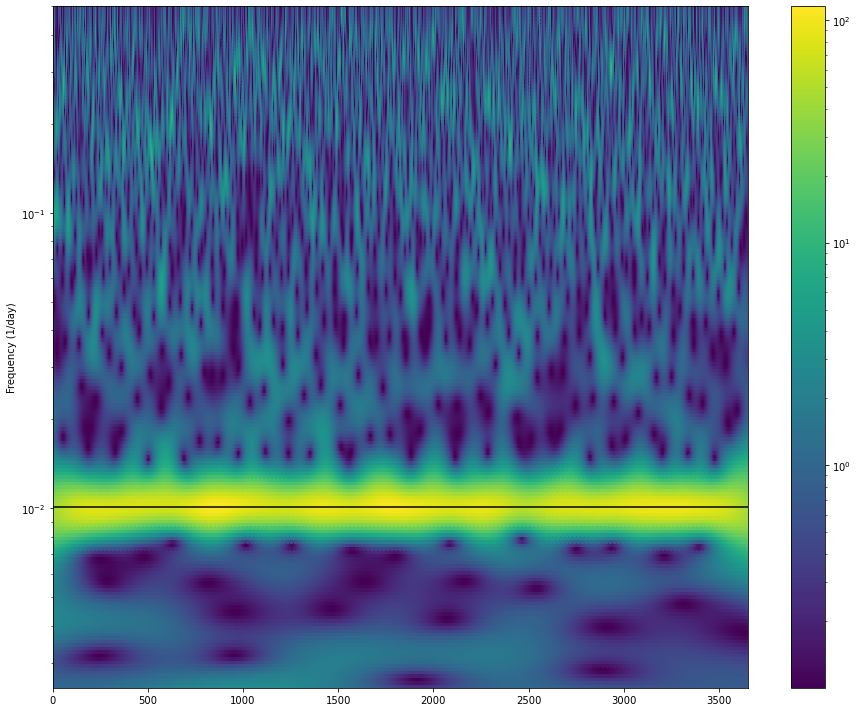

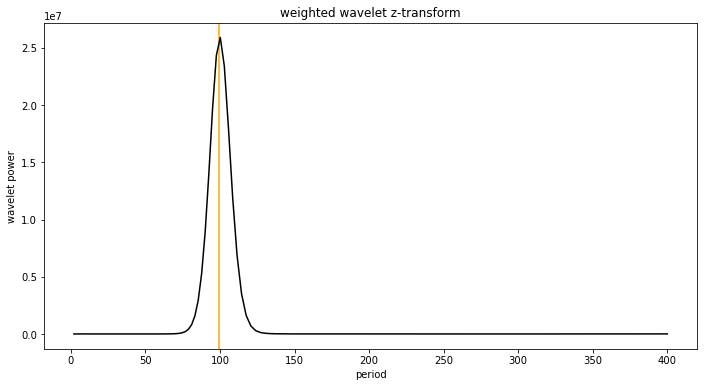

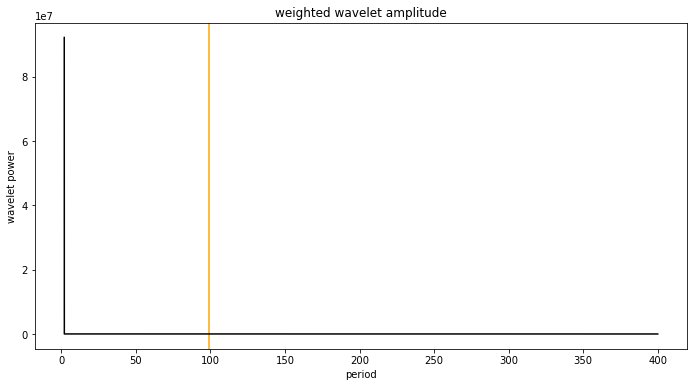

In [1910]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 3650, num=3650)
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 3650 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

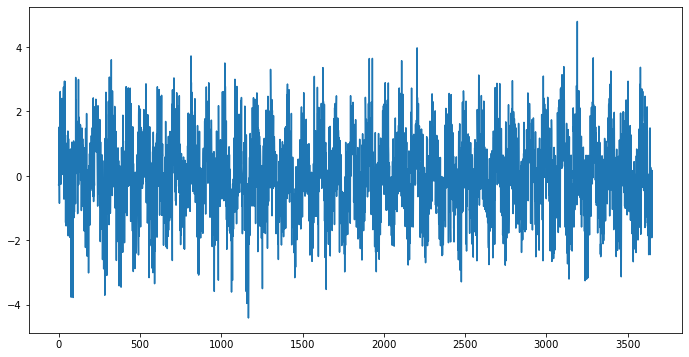

In [1911]:
plt.plot(x,y)
plt.show()

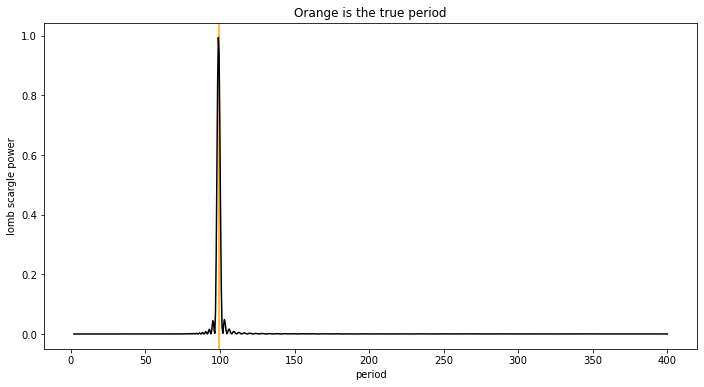

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.0
largest tau window is  1.0
1908.93 seconds has passed to complete Weighted Wavelet Z-transform 



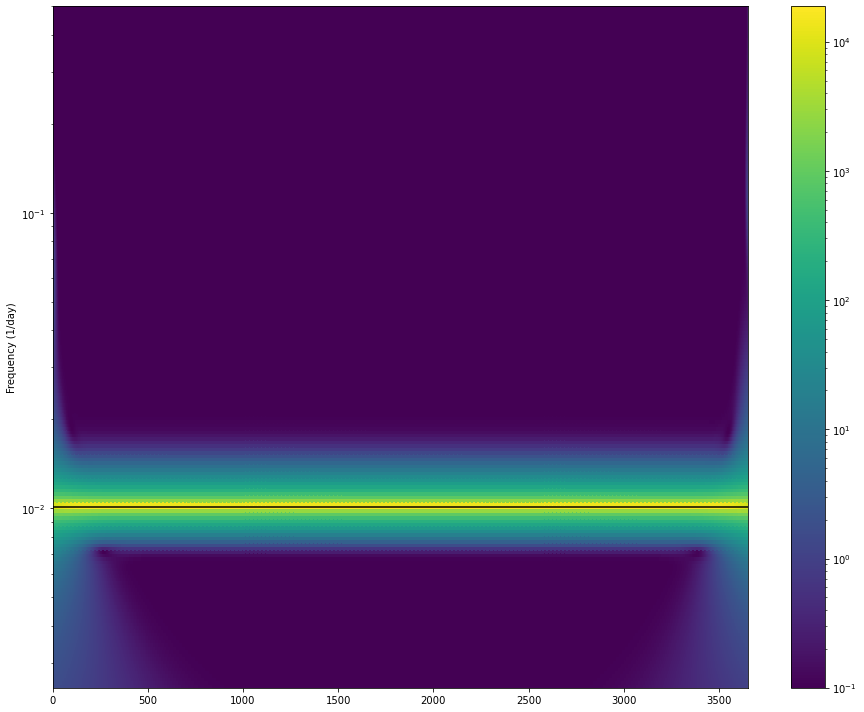

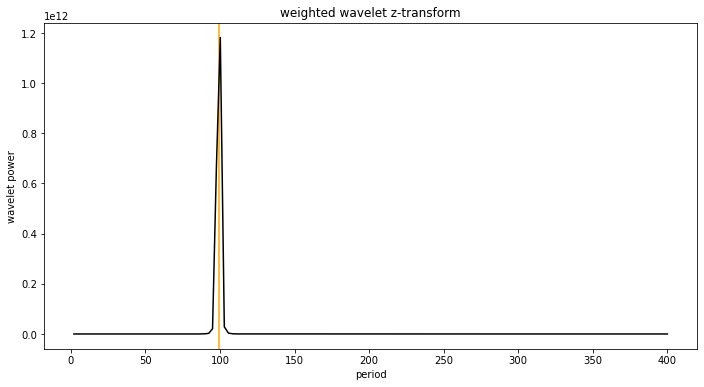

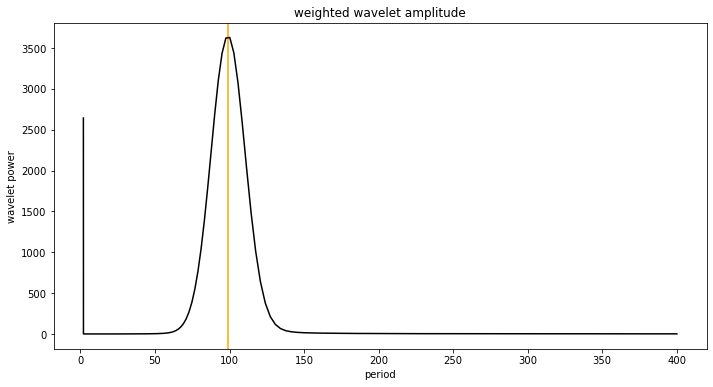

In [1913]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 3650, num=3650)
period = 99
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 3650 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_3 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

# short simulated light curve

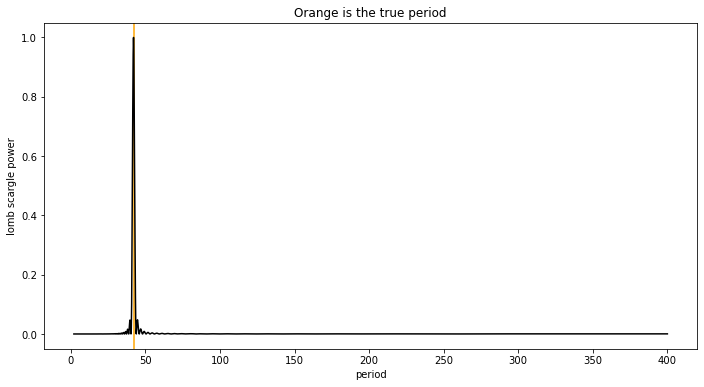

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.999
largest tau window is  1.001
292.57 seconds has passed to complete Weighted Wavelet Z-transform 



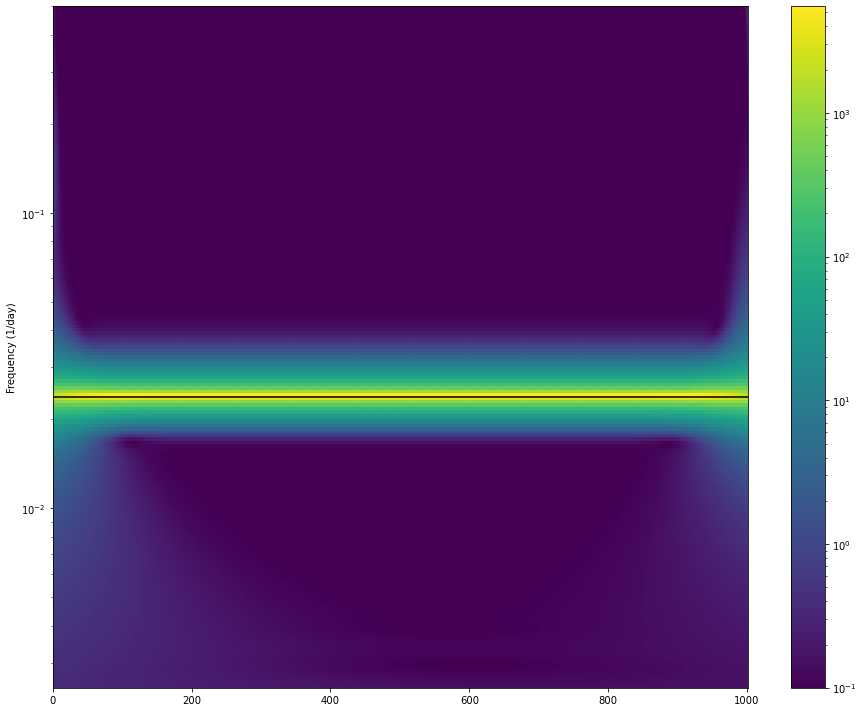

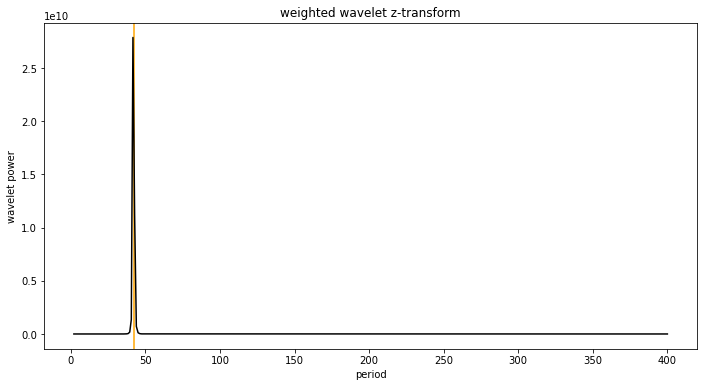

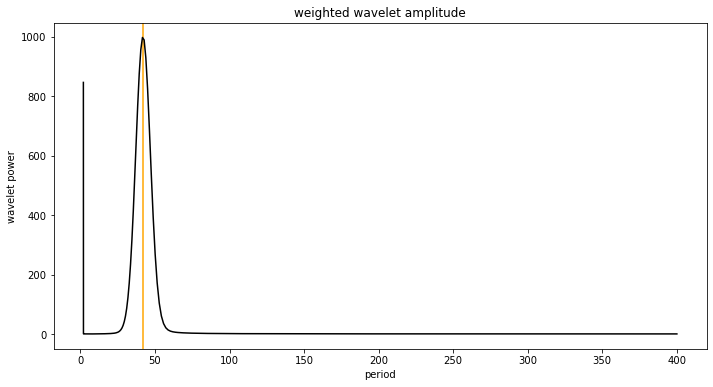

In [1914]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 1000, num=1000)
period = 42
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,1,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 1000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_1 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

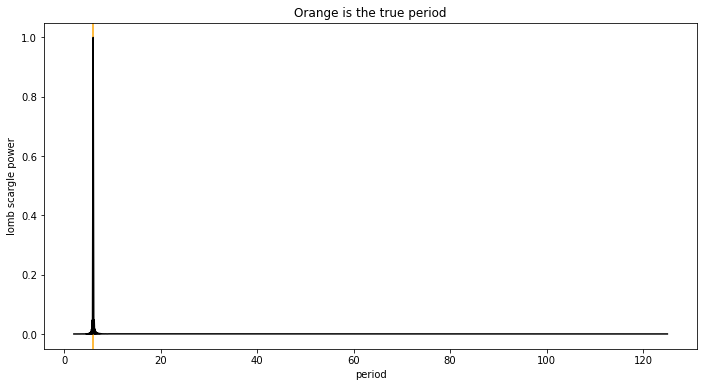

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.996
largest tau window is  0.501
96.93 seconds has passed to complete Weighted Wavelet Z-transform 



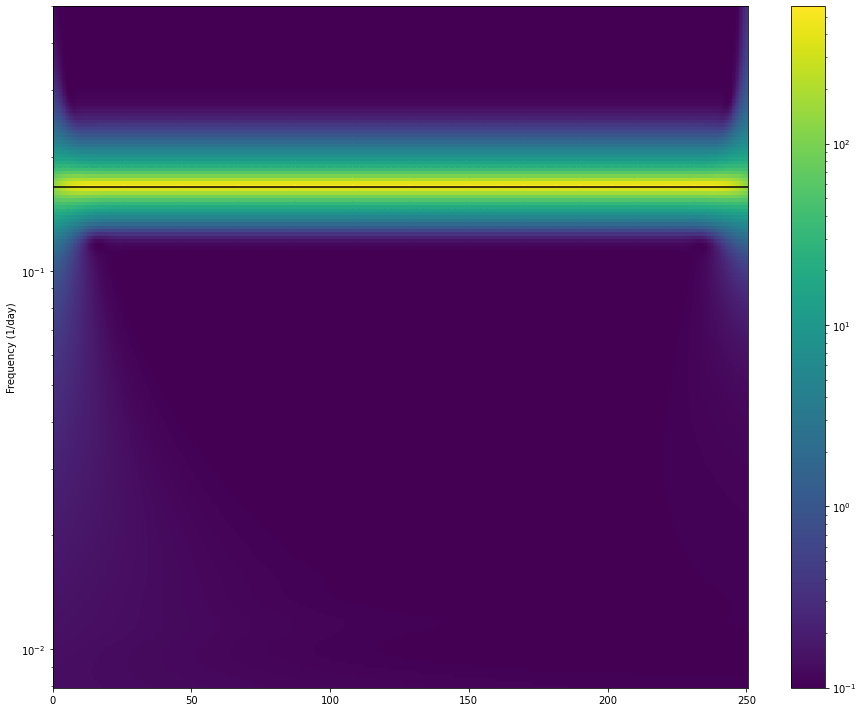

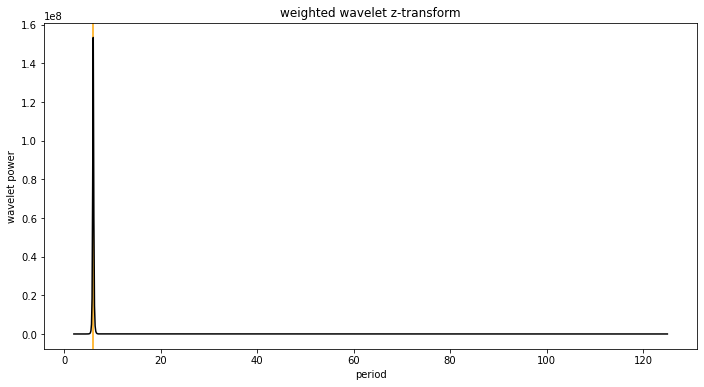

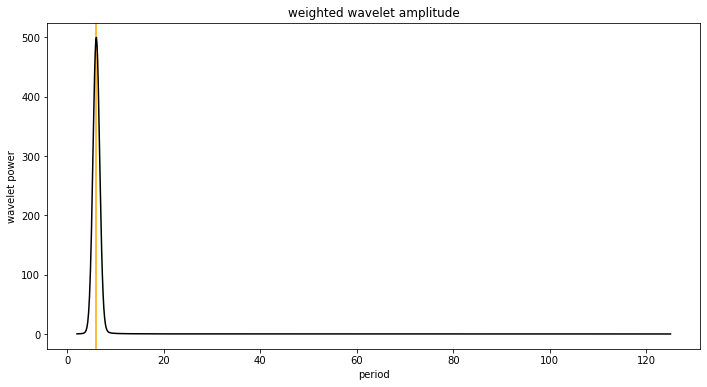

In [1915]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=500)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,1,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 500 data points, 6 period, 500 ntau, 2-125 tested periods, 200 test periods, 1/(8*pi**2) decay, no noise")

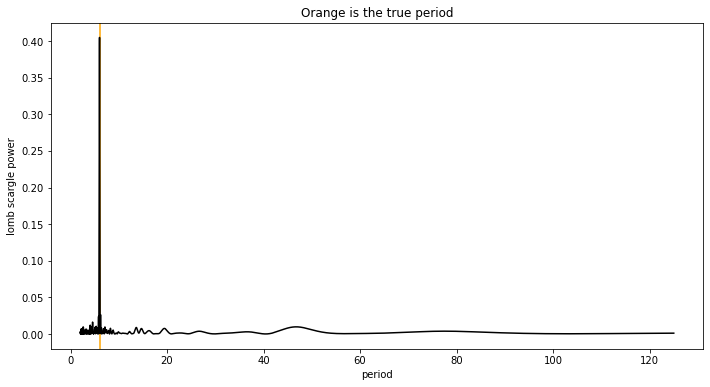

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.996
largest tau window is  0.501
96.08 seconds has passed to complete Weighted Wavelet Z-transform 



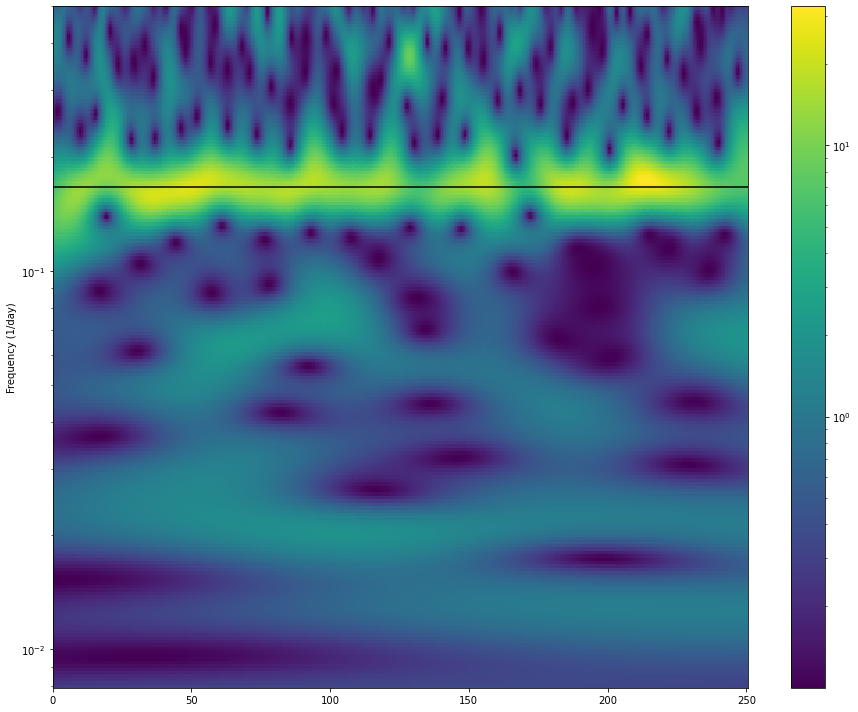

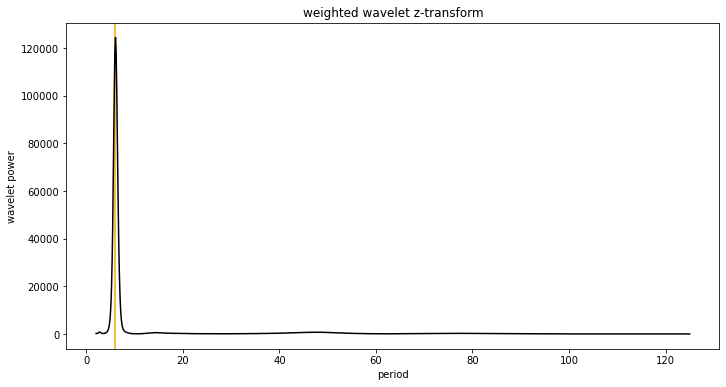

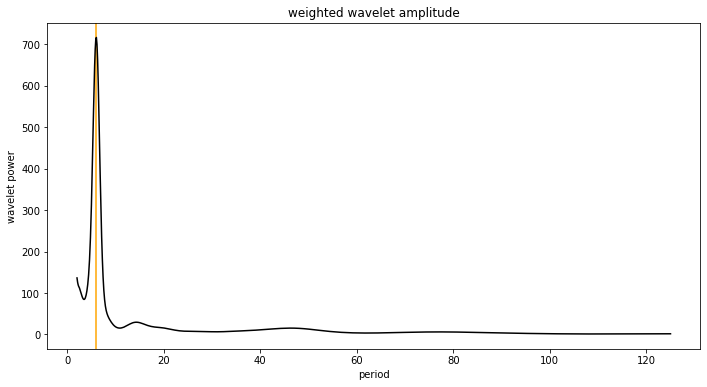

In [1916]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=500)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_2 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 500 data points, 6 period, 500 ntau, 2-125 tested periods, 200 test periods, 1/(8*pi**2) decay, 1std Gaussian noise")

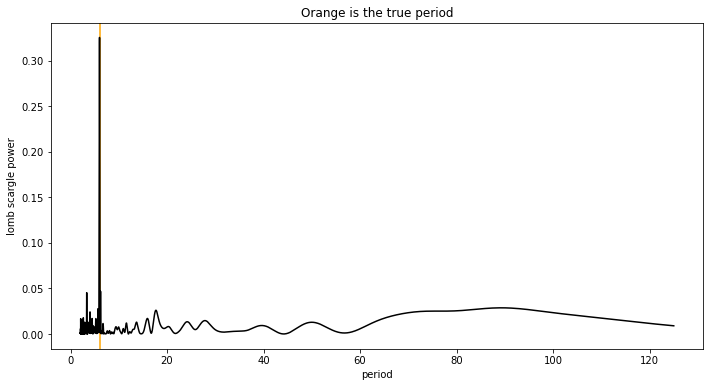

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  250
Pseudo sample frequency (median) is  0.996
largest tau window is  1.004
25.73 seconds has passed to complete Weighted Wavelet Z-transform 



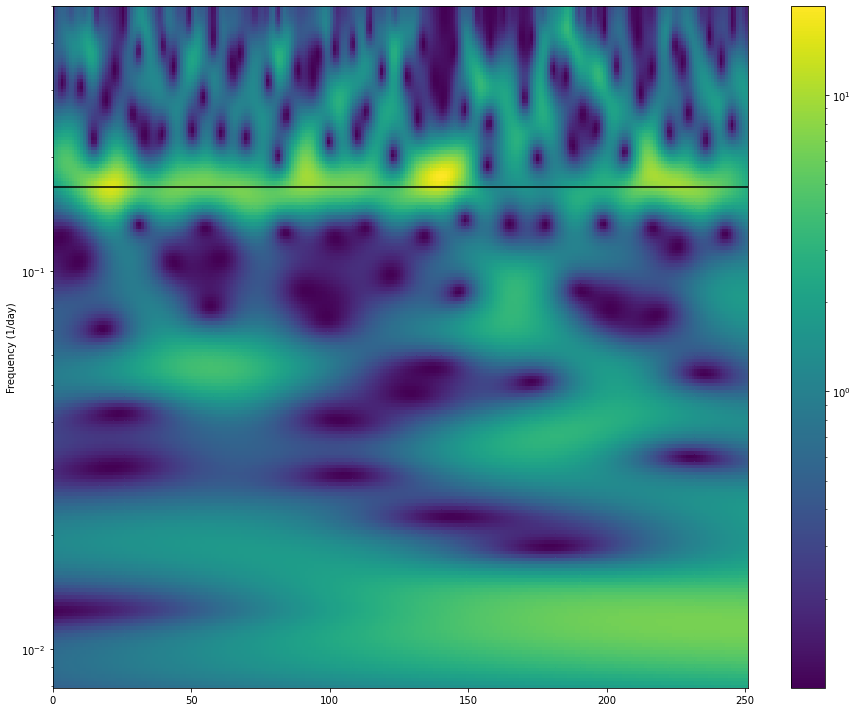

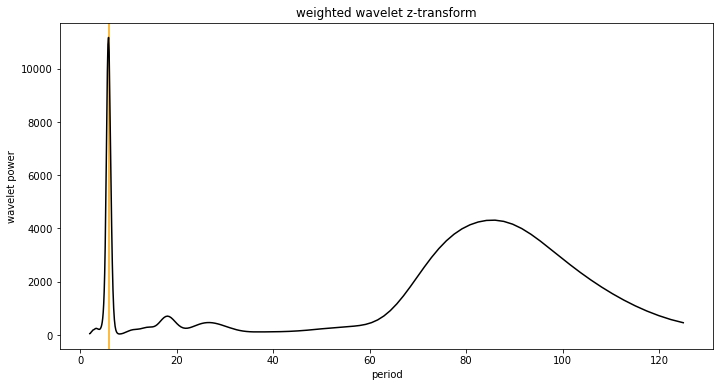

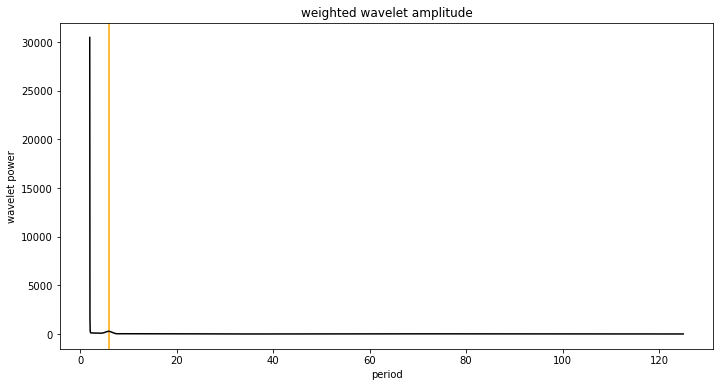

250 days, 250 data points, 6 period, 500 ntau, 2-125 tested periods, 1/(8*pi**2) decay, 1std Gaussian noise


In [1917]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=250)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_3 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 250 data points, 6 period, 500 ntau, 2-125 tested periods, 200 test periods, 1/(8*pi**2) decay, 1std Gaussian noise")

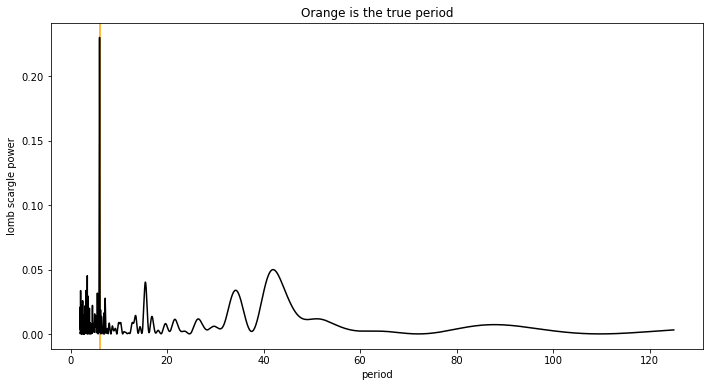

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  200
Pseudo sample frequency (median) is  0.796
largest tau window is  1.256
16.25 seconds has passed to complete Weighted Wavelet Z-transform 



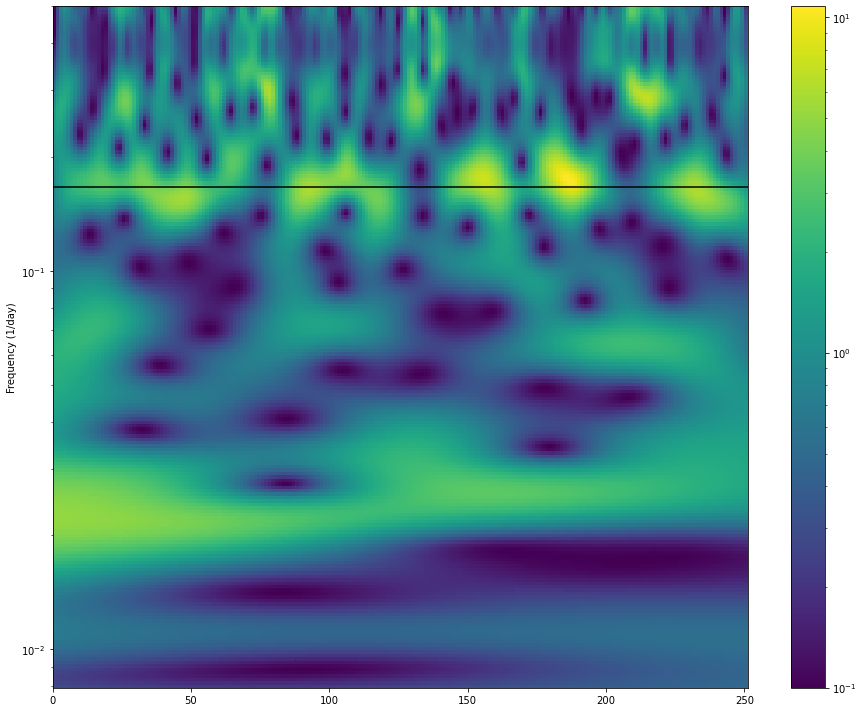

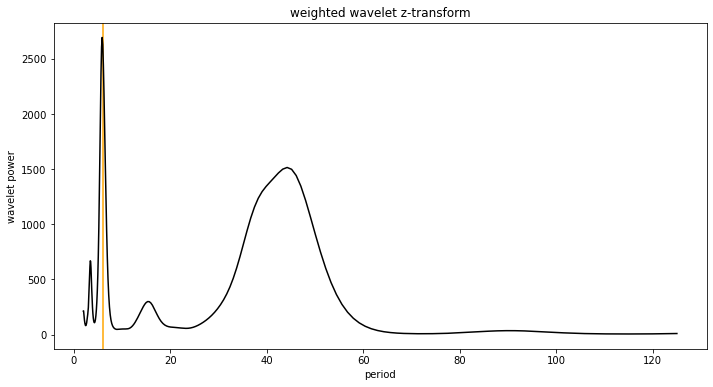

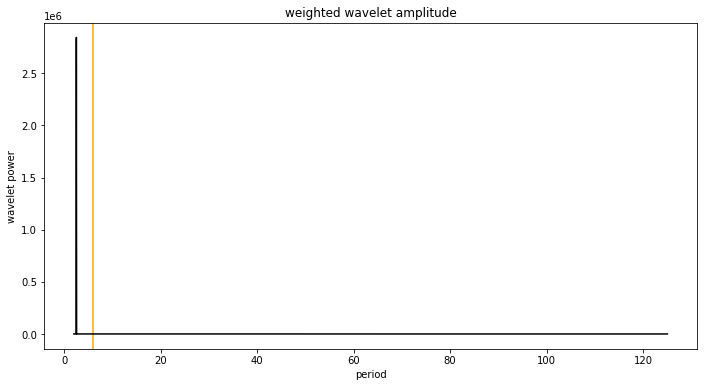

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 1/(8*pi**2) decay, 1std Gaussian noise


In [1918]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=200)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=200)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_4 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 200 test periods, 1/(8*pi**2) decay, 1std Gaussian noise")

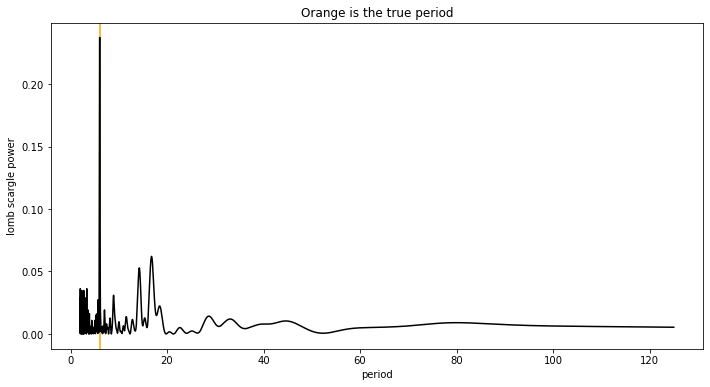

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  200
Pseudo sample frequency (median) is  0.796
largest tau window is  1.256
31.99 seconds has passed to complete Weighted Wavelet Z-transform 



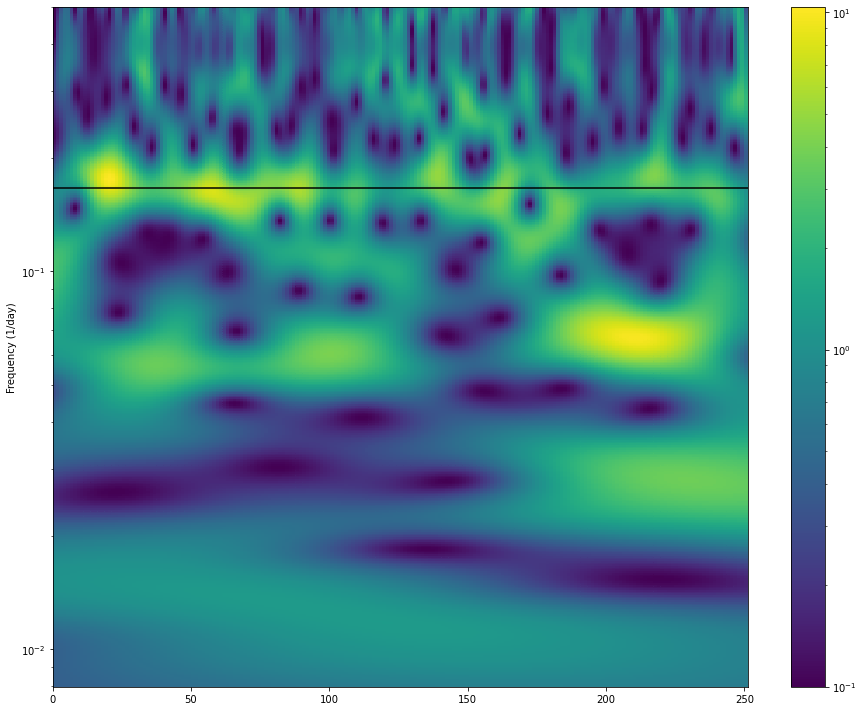

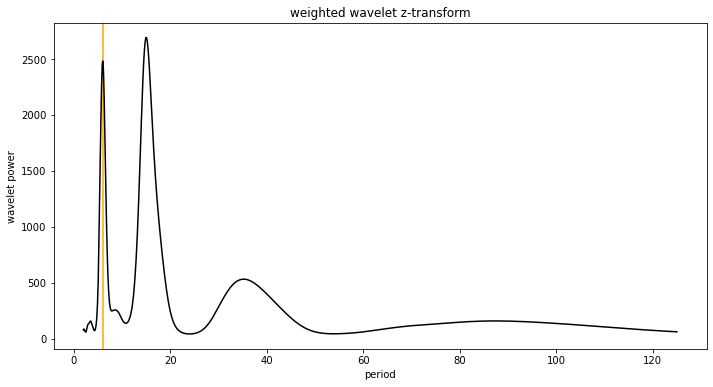

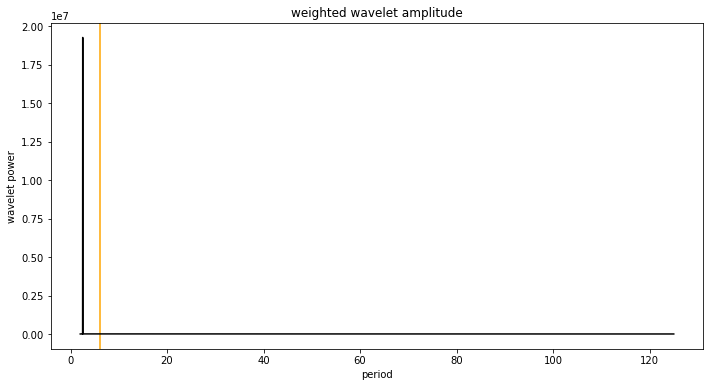

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 1std Gaussian noise


In [1919]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=200)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,1,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_5 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 1std Gaussian noise")

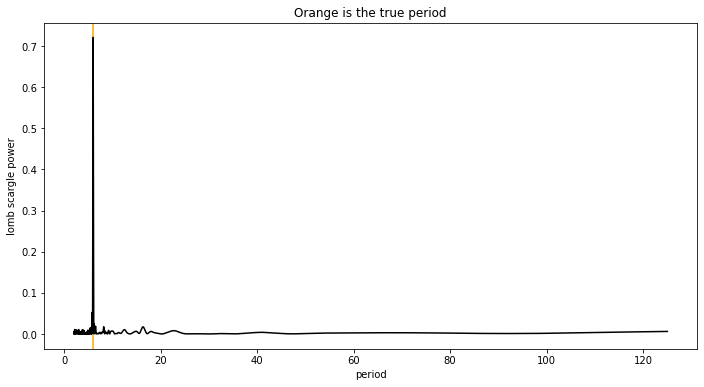

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  200
Pseudo sample frequency (median) is  0.796
largest tau window is  1.256
31.98 seconds has passed to complete Weighted Wavelet Z-transform 



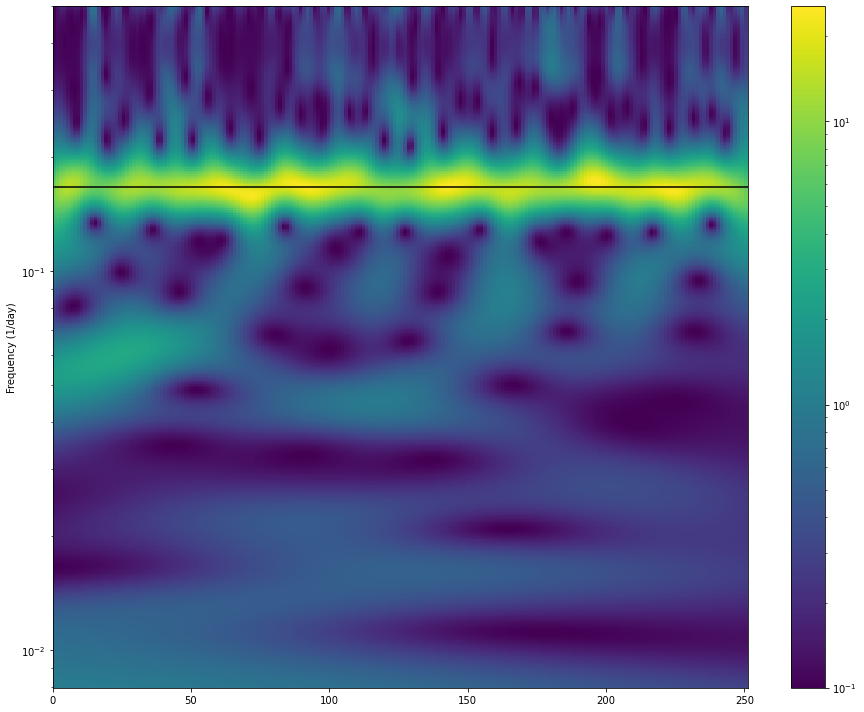

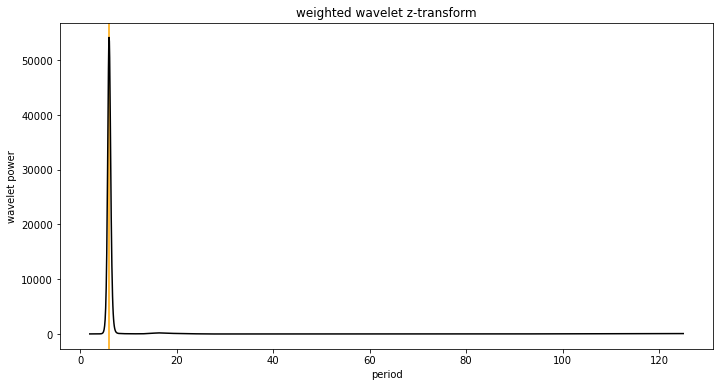

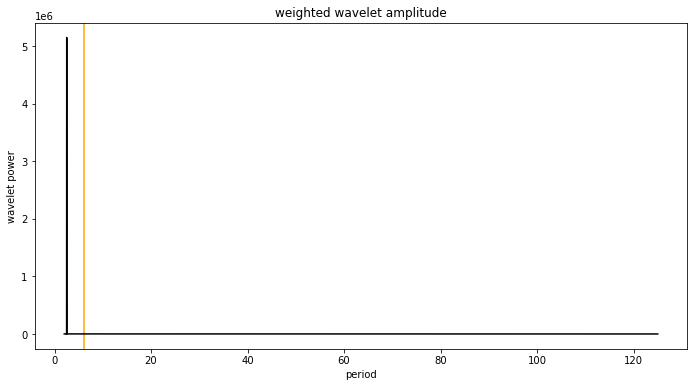

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [1978]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=200)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

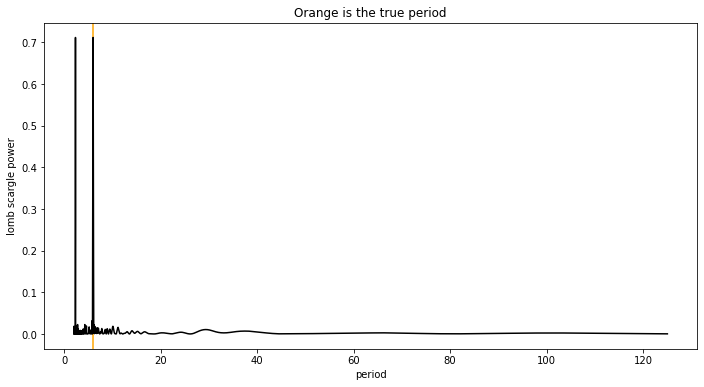

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  150
Pseudo sample frequency (median) is  0.596
largest tau window is  1.678
18.3 seconds has passed to complete Weighted Wavelet Z-transform 



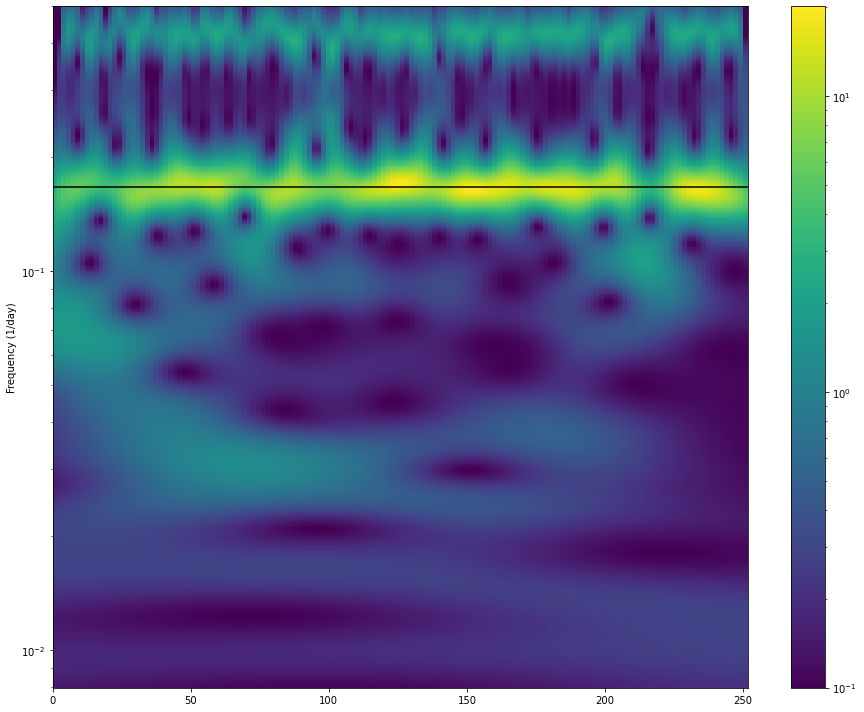

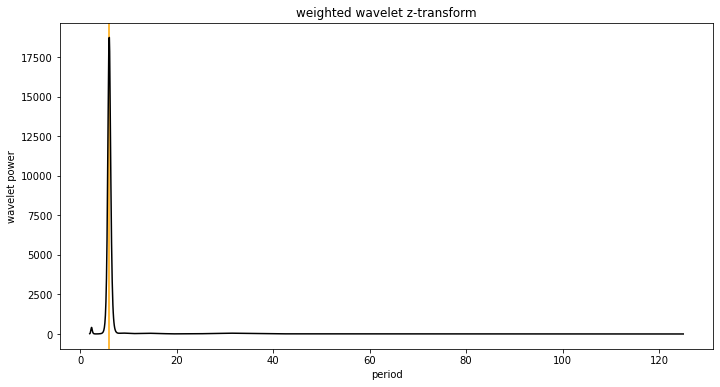

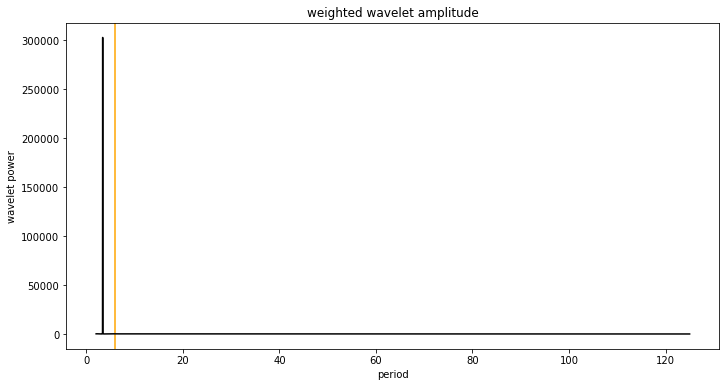

250 days, 150 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [1979]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=150)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 150 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

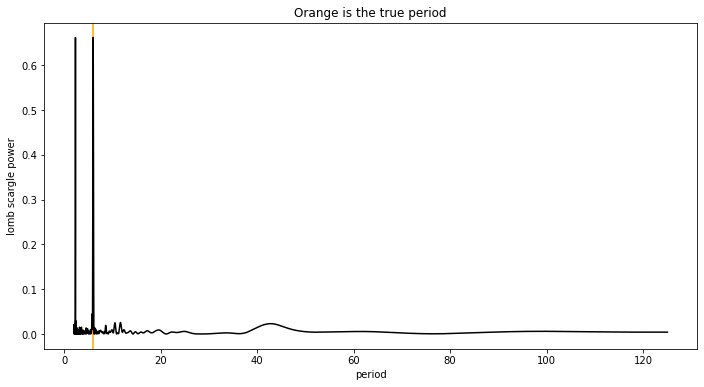

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  150
Pseudo sample frequency (median) is  0.596
largest tau window is  1.678
18.52 seconds has passed to complete Weighted Wavelet Z-transform 



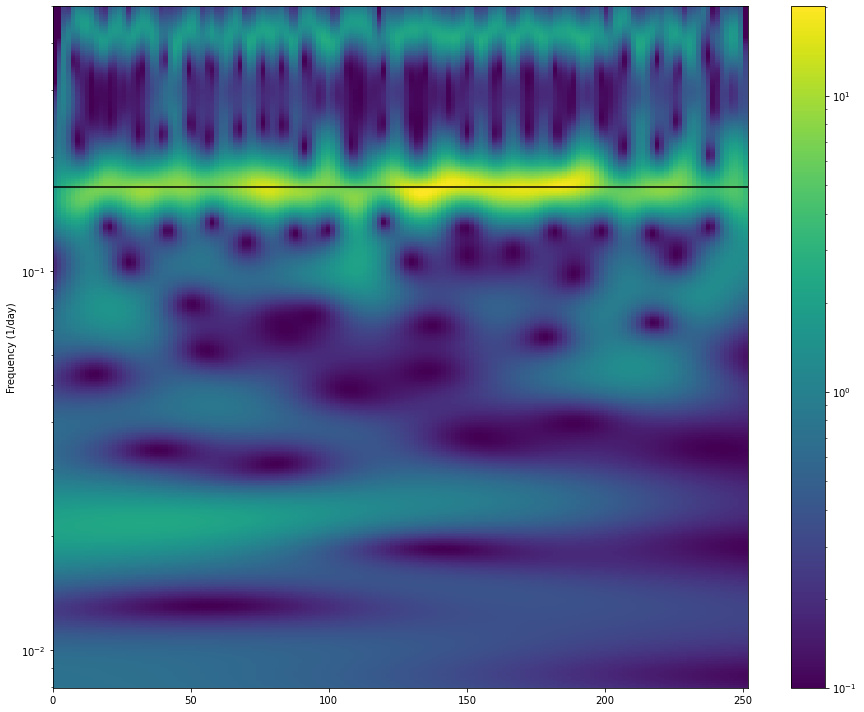

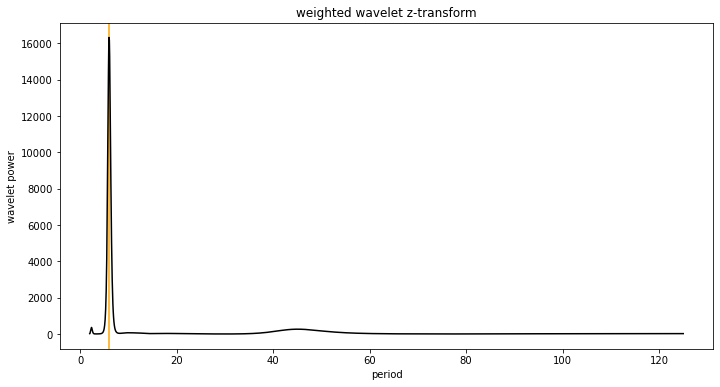

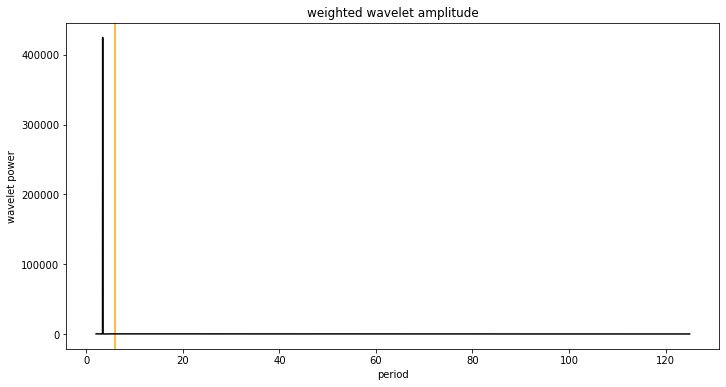

250 days, 150 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [1981]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=150)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 150 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

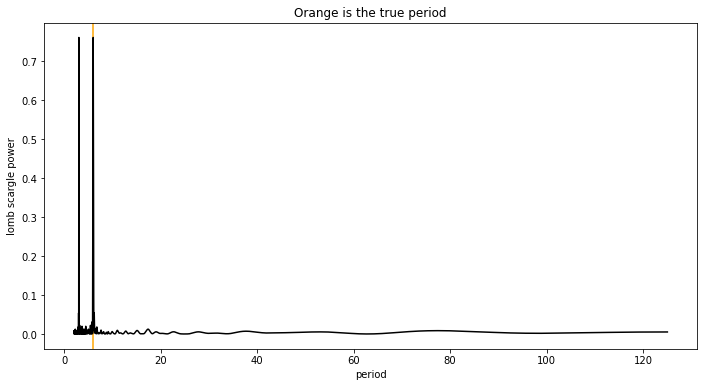

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  125
Pseudo sample frequency (median) is  0.496
largest tau window is  2.016
13.36 seconds has passed to complete Weighted Wavelet Z-transform 



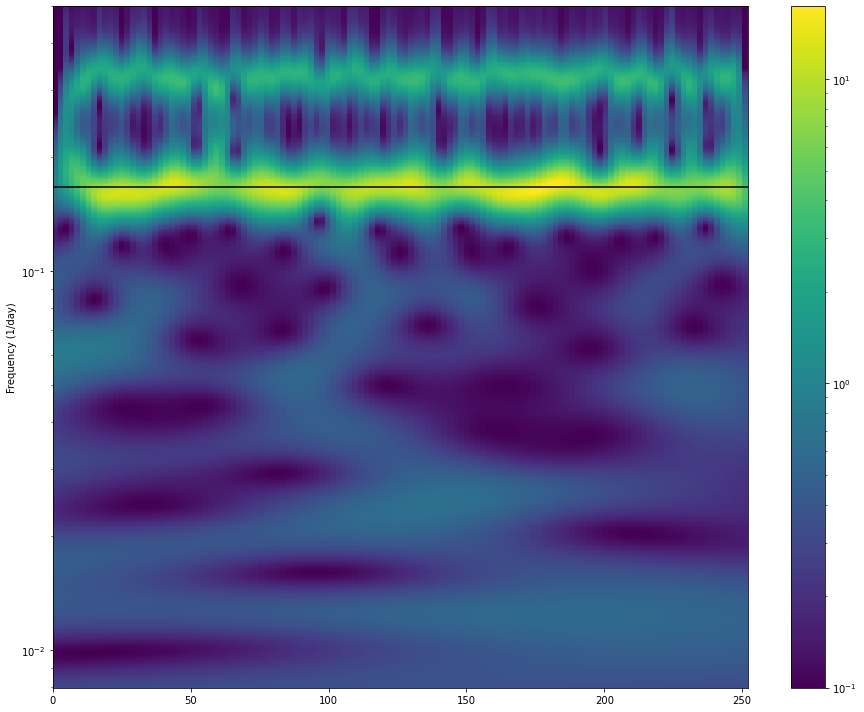

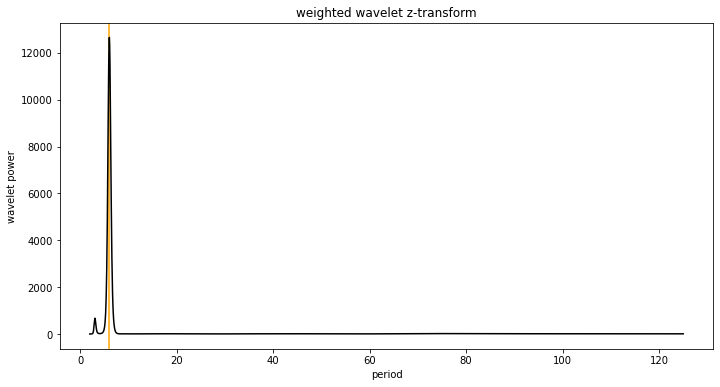

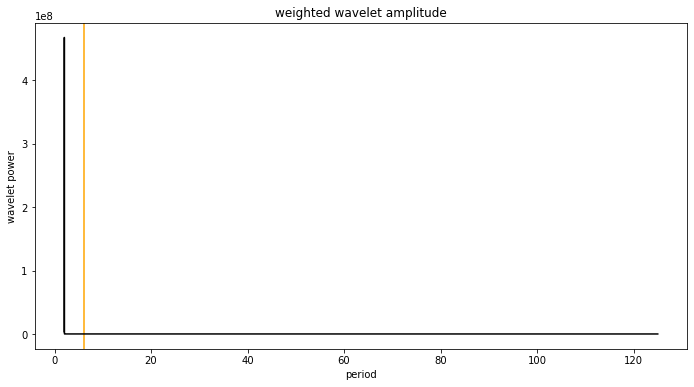

250 days, 125 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [1982]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=125)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 125 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

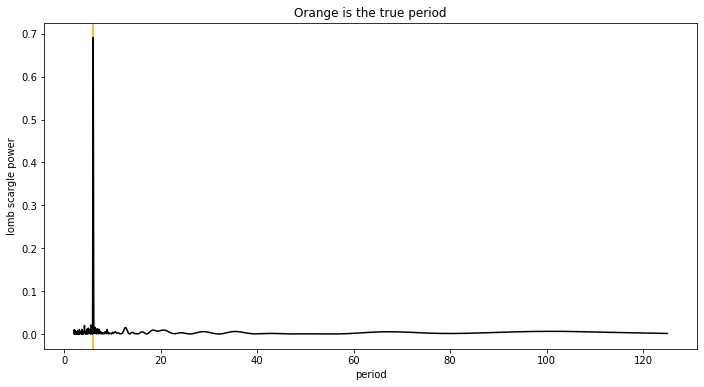

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  200
Pseudo sample frequency (median) is  0.796
largest tau window is  1.256
19.13 seconds has passed to complete Weighted Wavelet Z-transform 



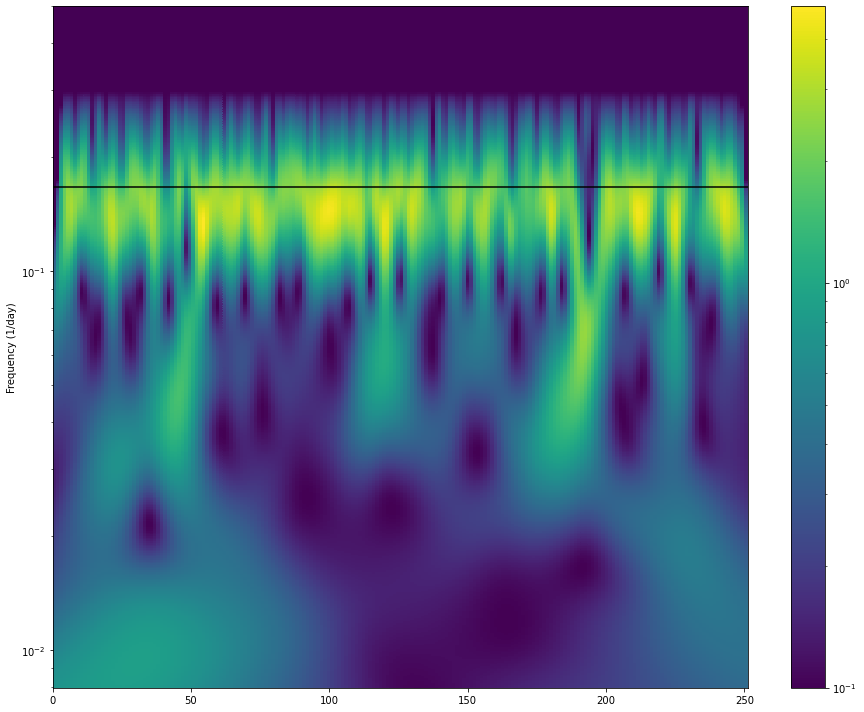

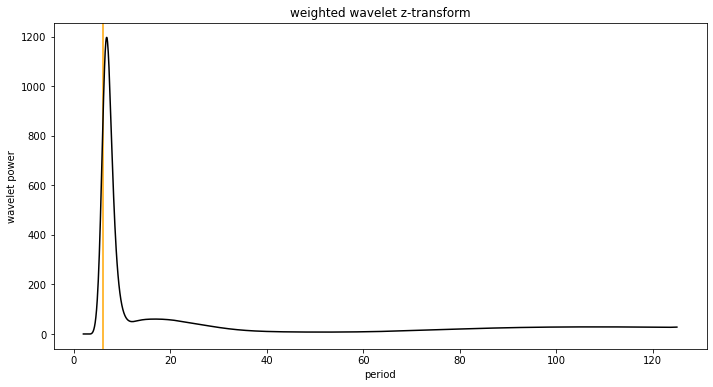

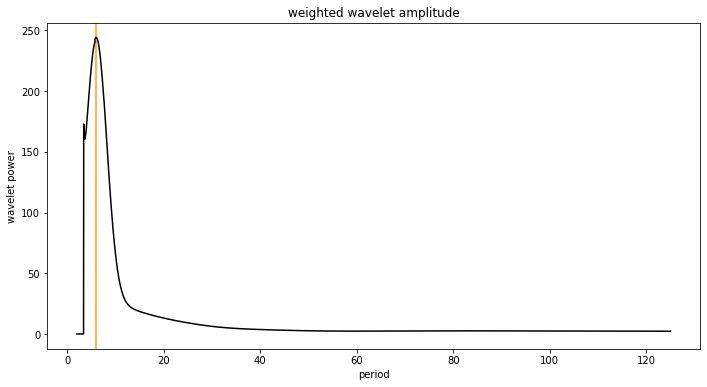

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [1990]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=200)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)*10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

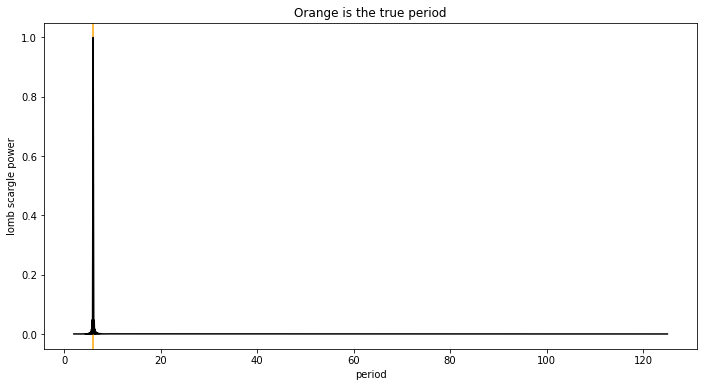

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  200
Pseudo sample frequency (median) is  0.796
largest tau window is  1.256
42.53 seconds has passed to complete Weighted Wavelet Z-transform 



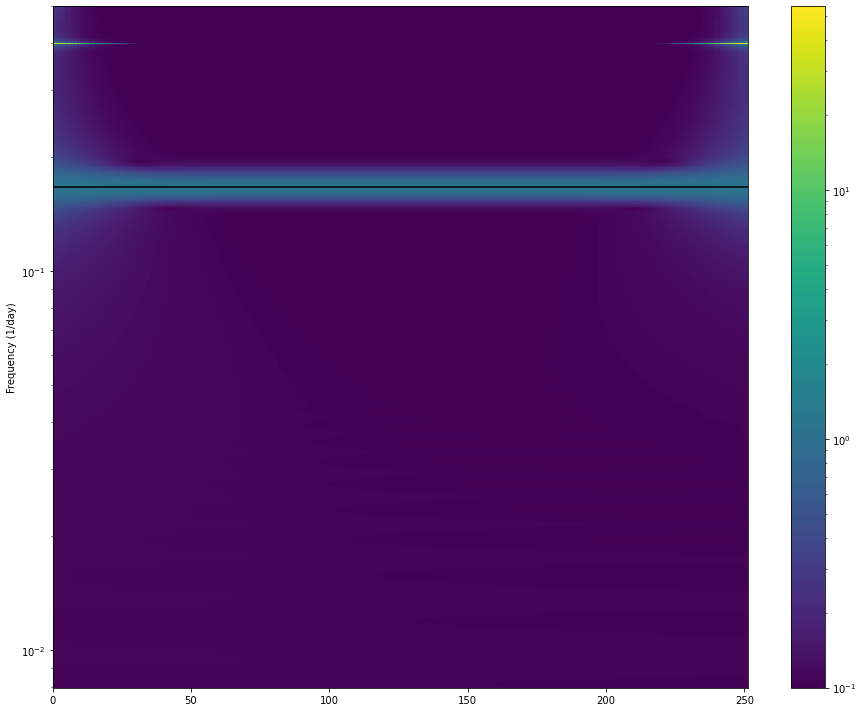

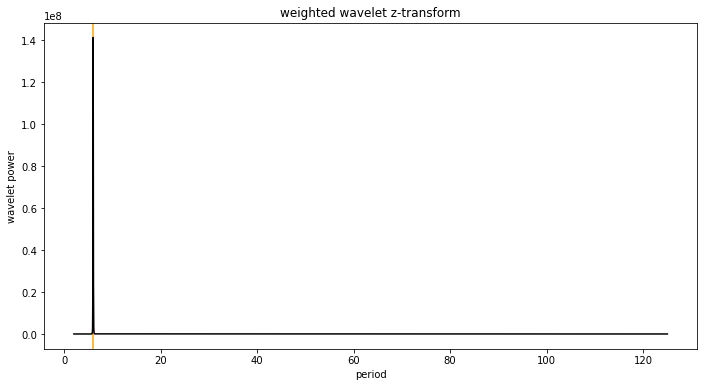

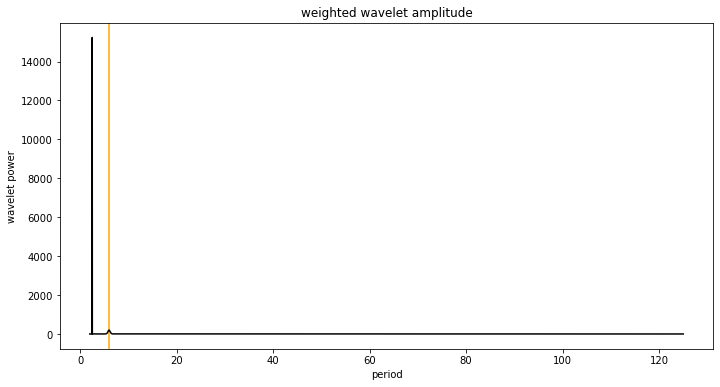

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [2005]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=200)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

In [2006]:
1/wwt_spec[1][0][np.argsort(np.sum(np.abs(wwt_spec[3])**2, axis=0))][-2:]

array([5.99971958, 2.51218113])

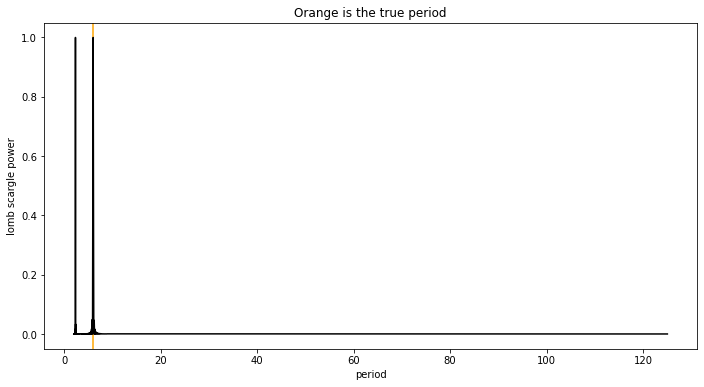

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  150
Pseudo sample frequency (median) is  0.596
largest tau window is  1.678
24.53 seconds has passed to complete Weighted Wavelet Z-transform 



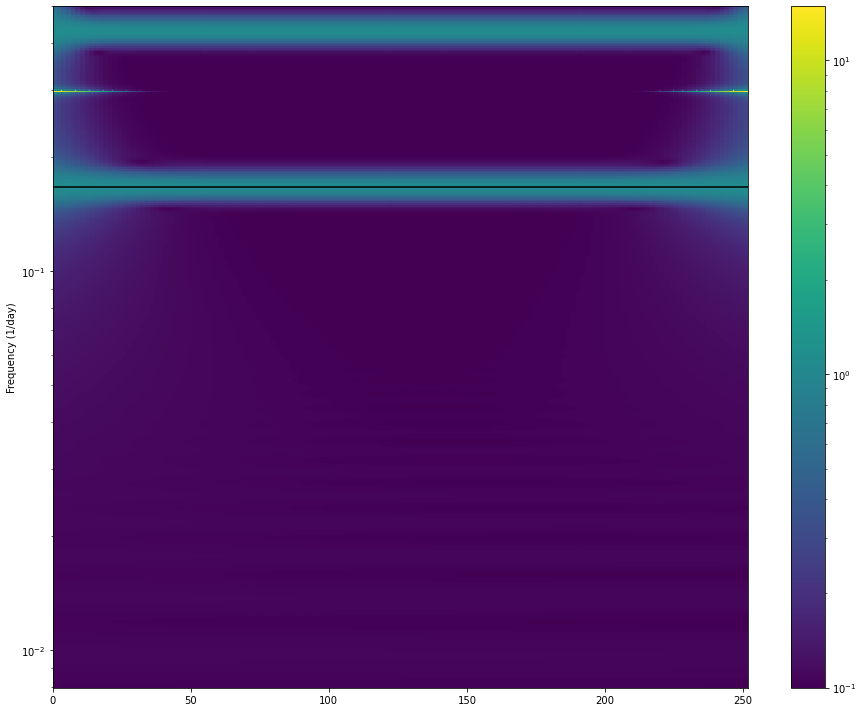

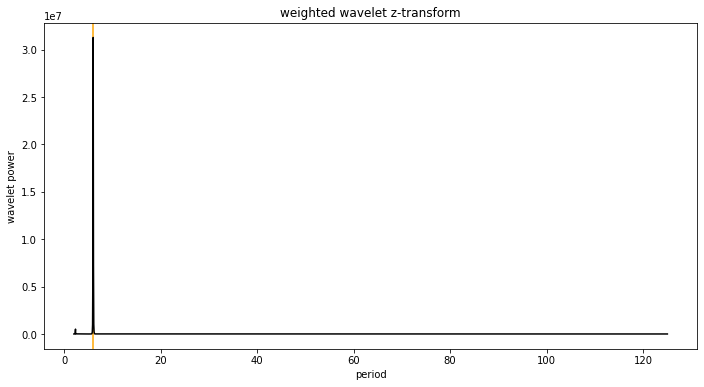

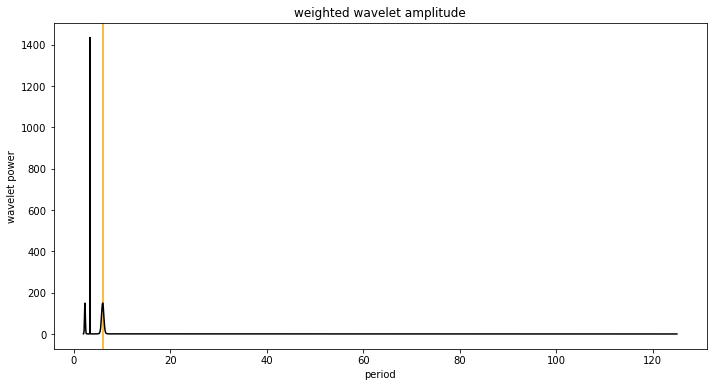

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise


In [2007]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 250, num=150)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)/10
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet powSecond lomb-scargle peak appears when the number of data points in the 250 day period is less than 168​er")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 150 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0.5std Gaussian noise")

In [2009]:
1/wwt_spec[1][0][np.argsort(np.sum(np.abs(wwt_spec[3])**2, axis=0))][-5:]

array([6.06222296, 2.31229548, 2.33638432, 5.99971958, 3.35797622])

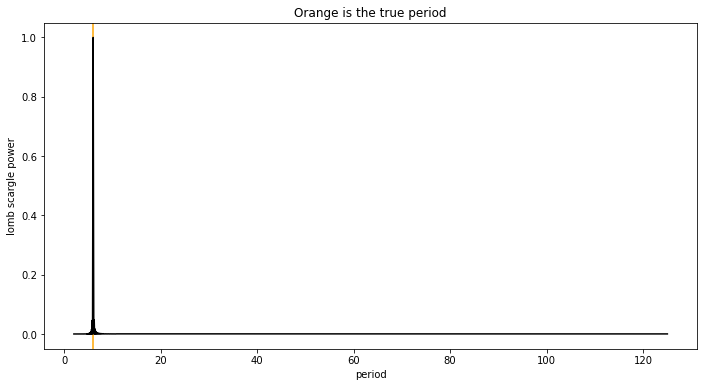

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  260
Pseudo sample frequency (median) is  1.04
largest tau window is  0.961
53.94 seconds has passed to complete Weighted Wavelet Z-transform 



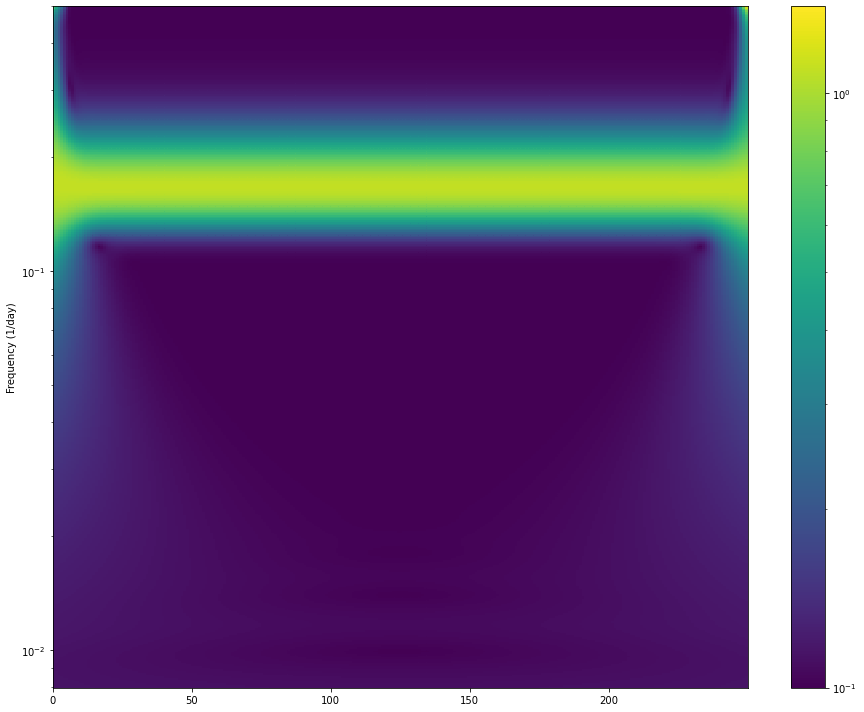

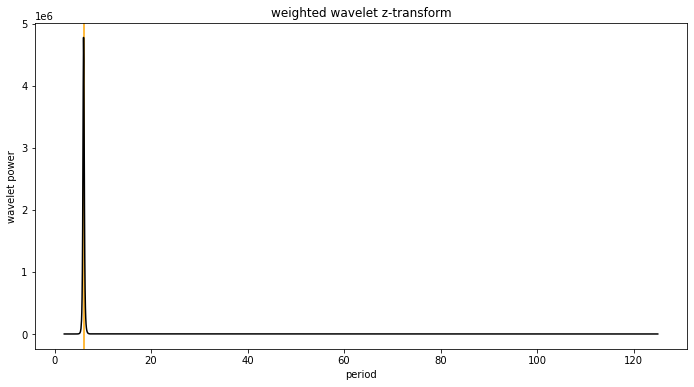

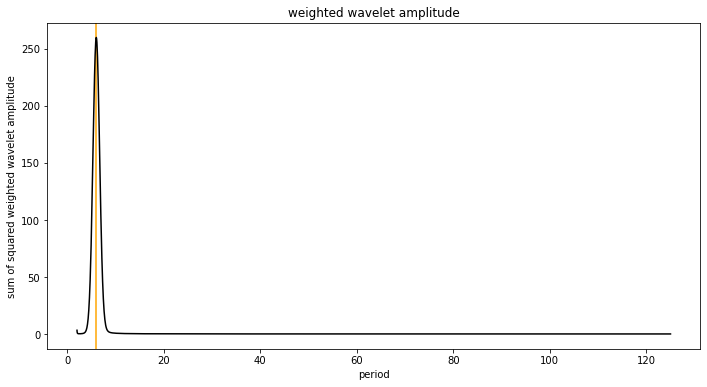

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [2268]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=260)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3]+0.1)
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
# plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("sum of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

In [2227]:
1/wwt_spec[1][0][np.argsort(np.sum(np.abs(wwt_spec[3])**2, axis=0))][-5:]

#array([26.40992387, 25.60143401, 26.13762946, 25.86814249,  2.78650915])
# 26

# array([12.78499256, 13.18874092, 12.91818299, 13.05276095,  2.78650915])
# 13 period, 250/180 cadence

#array([6.06222296, 5.93786063, 5.99971958, 2.75777938, 2.78650915])
# 6 period, 250/180 cadence

#array([2.84486969, 2.72934583, 2.81553821, 2.75777938, 2.78650915])
#3

array([6.12537748, 5.87663947, 5.93786063, 6.06222296, 5.99971958])

In [2212]:
250/3

83.33333333333333

In [2157]:
147/250 #cycles per day
250/147 # days per cycle

1.7006802721088434

In [2211]:
250/260*2

1.9230769230769231

In [2152]:
6*(75/250)

1.7999999999999998

In [2245]:
1/(8*np.pi**2)

0.012665147955292222

In [2140]:
1/(f/(2.0*np.pi))[np.argsort(pgram)]

array([2.        , 3.01817971, 4.0487748 , ..., 5.99930881, 2.3379892 ,
       7.66164625])

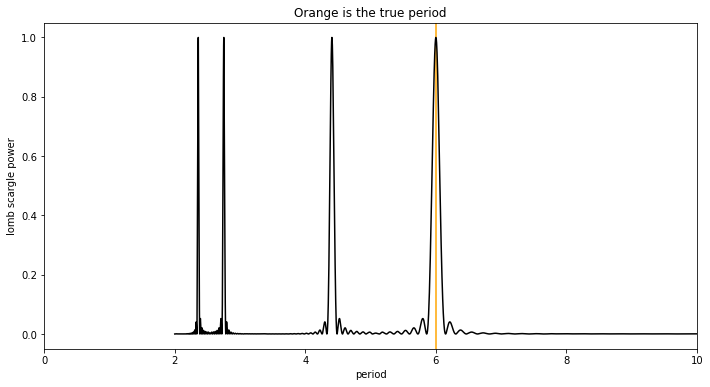

In [2240]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=50)
period =6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.xlim((0,10))
plt.title("Orange is the true period")

plt.show()

In [2100]:
6/(250/166)

3.984

In [2103]:
1/(8*np.pi**2)

0.012665147955292222

In [2258]:
M = 100

s = 4.0

w = 2.0

c=1/(2*w**2)

x = np.arange(0, M) - (M - 1.0) / 2
x = x / s
wavelet = np.exp(1j * w * x) * np.exp(-0.5 * x**2) * np.pi**(-0.25)
wavelet2 = np.exp(1j * x) * np.exp(-c * x**2)* np.pi**(-0.25)
output = np.sqrt(1/s) * wavelet
output2 = np.sqrt(1/s) * wavelet2

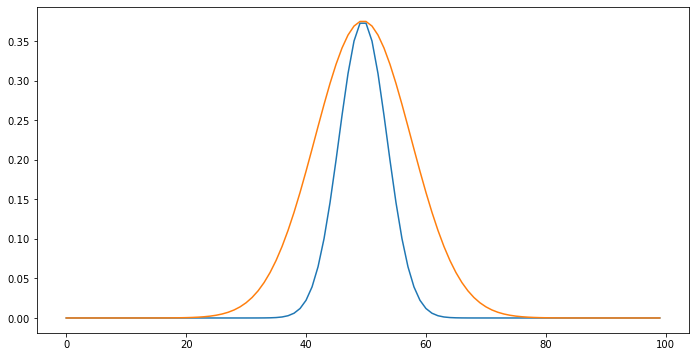

In [2259]:
plt.plot(abs(output))
plt.plot(abs(output2))

plt.show()

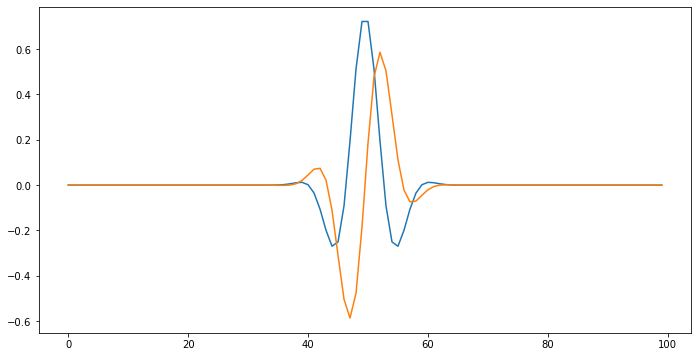

In [2265]:
# extract real part using numpy array
x = wavelet.real
# extract imaginary part using numpy array
y = wavelet.imag
  
# plot the complex numbers
plt.plot(x)
plt.plot(y)
# plt.ylabel('Imaginary')
# plt.xlabel('Real')
plt.show()

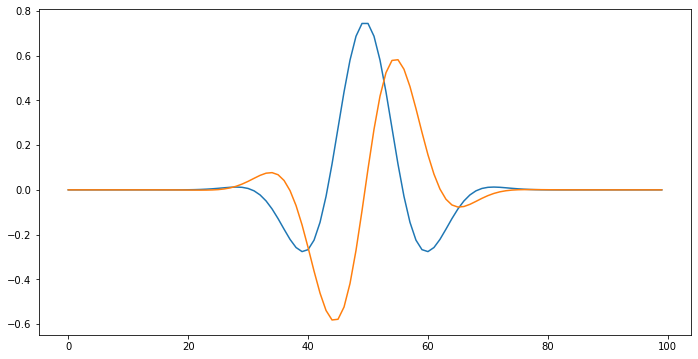

In [2266]:
# extract real part using numpy array
x = wavelet2.real
# extract imaginary part using numpy array
y = wavelet2.imag
  
# plot the complex numbers
plt.plot(x)
plt.plot(y)
# plt.ylabel('Imaginary')
# plt.xlabel('Real')
plt.show()

In [3080]:
y

array([ 0.00000000e+00,  8.45106961e-01,  9.03583722e-01,  1.20999793e-01,
       -7.74211408e-01, -9.48782379e-01, -2.40221501e-01,  6.91938869e-01,
        9.80038740e-01,  3.55913170e-01, -5.99498333e-01, -9.96893496e-01,
       -4.66374718e-01,  4.98248208e-01,  9.99098966e-01,  5.69982920e-01,
       -3.89676358e-01, -9.86622742e-01, -6.65215260e-01,  2.75378239e-01,
        9.59648161e-01,  7.50672305e-01, -1.57033454e-01, -9.18571612e-01,
       -8.25098269e-01,  3.63810738e-02,  8.63996714e-01,  8.87399468e-01,
        8.48059245e-02, -7.96725439e-01, -9.36660389e-01, -2.04746705e-01,
        7.17746336e-01,  9.72157146e-01,  3.21678746e-01, -6.28219997e-01,
       -9.93368118e-01, -4.33883739e-01,  5.29462006e-01,  9.99981609e-01,
        5.39712839e-01, -4.22923606e-01, -9.91900435e-01, -6.37610893e-01,
        3.10170370e-01,  9.69243349e-01,  7.26139297e-01, -1.92859201e-01,
       -9.32343295e-01, -8.03997130e-01,  7.27139782e-02,  8.81742517e-01,
        8.70040279e-01,  

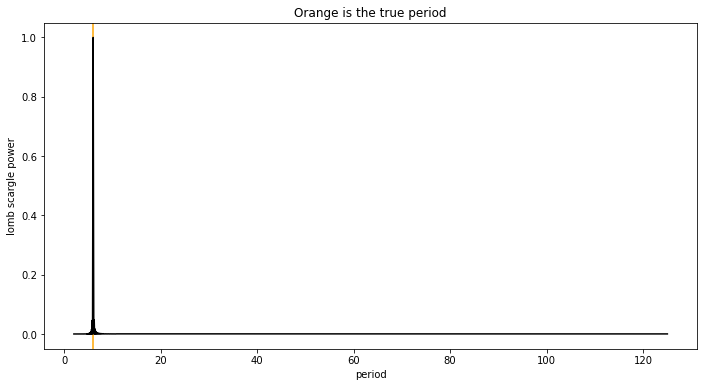

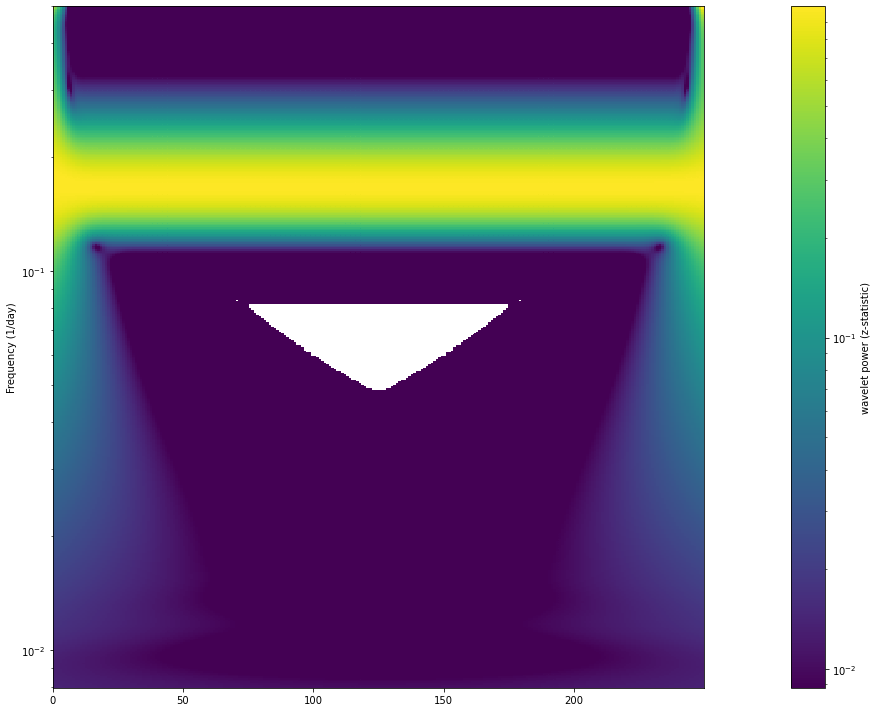

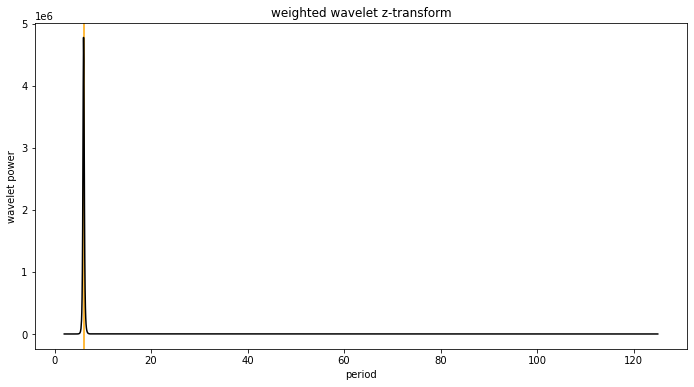

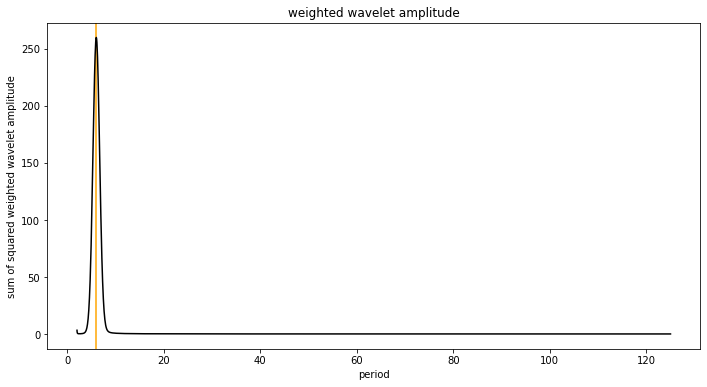

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3087]:
# generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=260)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 500 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
# wwt_spec = wwt_6 = wwt(timestamps=x,
#                      magnitudes=y,
#                      time_divisions=ntau,
#                      freq_params=frequency_parameters,
#                      decay_constant=decay_constant,
#                      method='linear',
#                      parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3],
                    clip=(np.percentile(wwt_spec[3], 50),np.percentile(wwt_spec[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
# plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("sum of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

In [2714]:
def make_wavelet(t_freq, t_tau, dec=1/(8*np.pi**2)):
    tau=wwt_spec[0][:,0]
    domega = 2*np.pi*frequency_parameters[frequency_ind] # 400 max t_freq
    dz = domega*(x-tau[t_tau]) #260 max t_tau
    c=dec#decay_constant
    return np.exp(1j * dz) * np.exp(-c * dz**2)
# wavelet_wwt

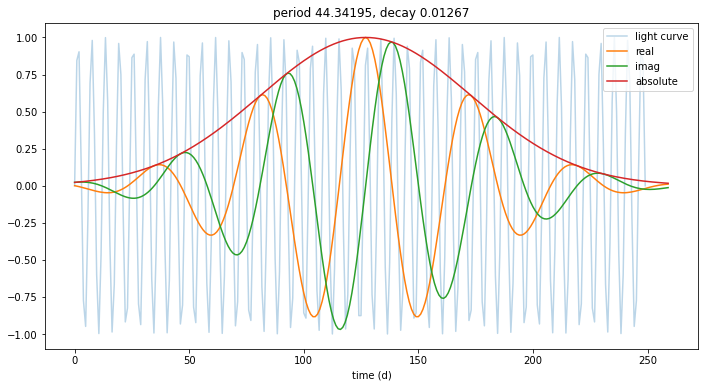

In [2716]:
frequency_ind=100
dec = 1/(8*np.pi**2)
# wavelet_wwt1 = make_wavelet(frequency_ind, 0, dec=dec)
wavelet_wwt2 = make_wavelet(frequency_ind, 127, dec=dec)
wavelet_wwt = wavelet_wwt2#+wavelet_wwt2
plt.plot(x,y, alpha=0.3, label="light curve")
plt.plot(wavelet_wwt.real, label="real")
plt.plot(wavelet_wwt.imag, label="imag")
plt.plot(abs(wavelet_wwt), label="absolute")
plt.legend(loc="upper right")
plt.title("period {:.5f}, decay {:.5f}".format(1/frequency_parameters[frequency_ind],dec))

# plt.ylabel('Imaginary')
plt.xlabel('time (d)')
plt.show()

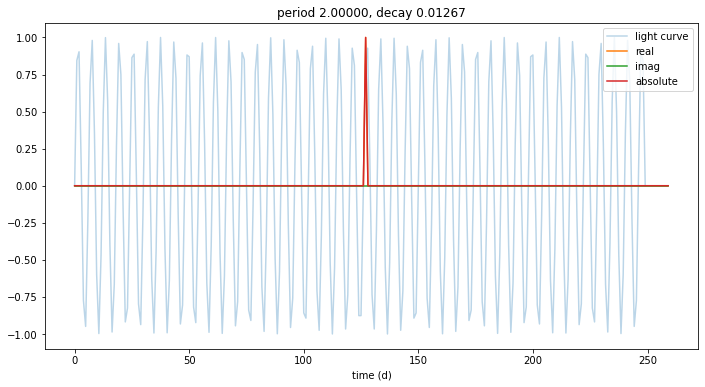

In [2709]:
frequency_ind=342
dec = 1/(8*np.pi**2)
wavelet_wwt1 = make_wavelet(frequency_ind, 0, dec=dec)
wavelet_wwt2 = make_wavelet(frequency_ind, 127, dec=dec)
wavelet_wwt = wavelet_wwt2#+wavelet_wwt2
plt.plot(x,y, alpha=0.3, label="light curve")
plt.plot(wavelet_wwt.real, label="real")
plt.plot(wavelet_wwt.imag, label="imag")
plt.plot(abs(wavelet_wwt), label="absolute")
plt.legend(loc="upper right")
plt.title("period {:.5f}, decay {:.5f}".format(2,dec))

# plt.ylabel('Imaginary')
plt.xlabel('time (d)')
plt.show()

In [2415]:
1/wwt_spec[1][0][np.argsort(np.sum(np.abs(wwt_spec[3])**2, axis=0))][-5:]

array([1.03697012, 1.02449732, 1.01217455, 1.        , 1.92217238])

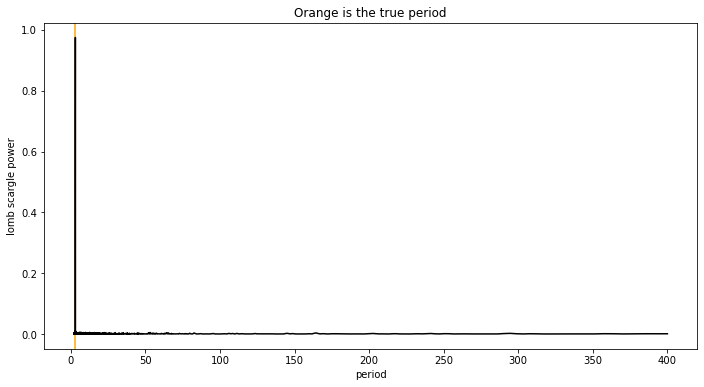

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  1596
Pseudo sample frequency (median) is  0.5
largest tau window is  4.252
421.82 seconds has passed to complete Weighted Wavelet Z-transform 



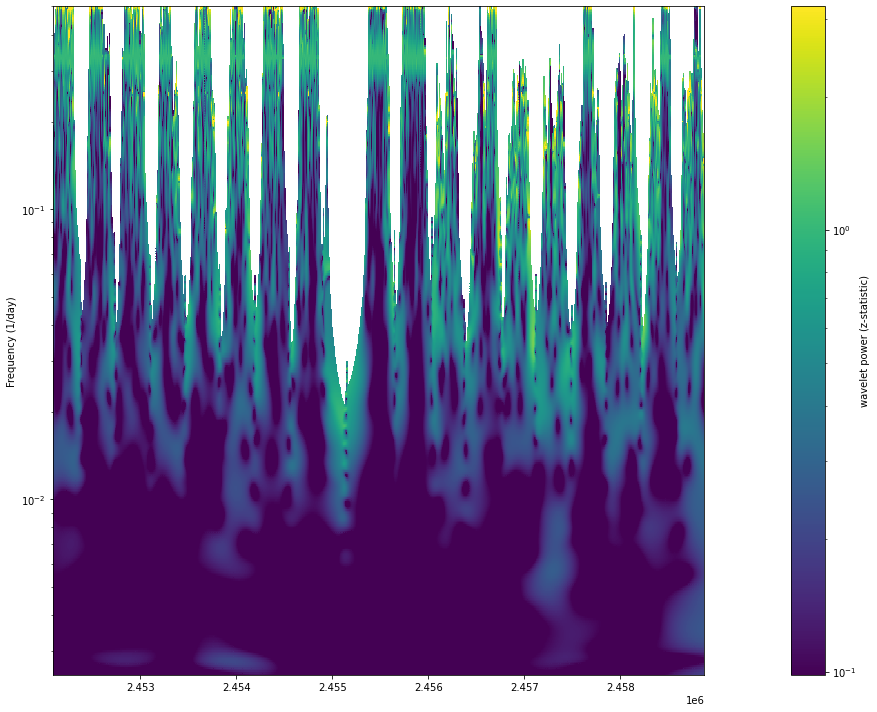

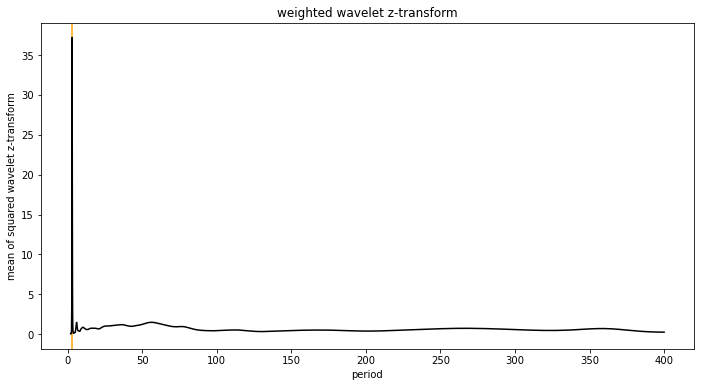

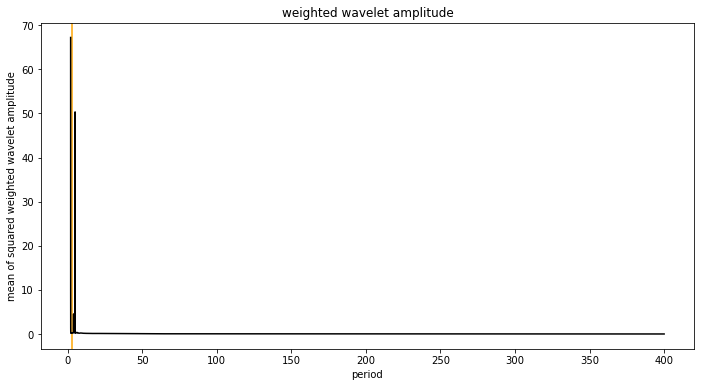

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3322]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt_6 = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[3],
                    clip=(np.percentile(wwt_spec[3], 50),np.percentile(wwt_spec[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.mean(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.mean(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

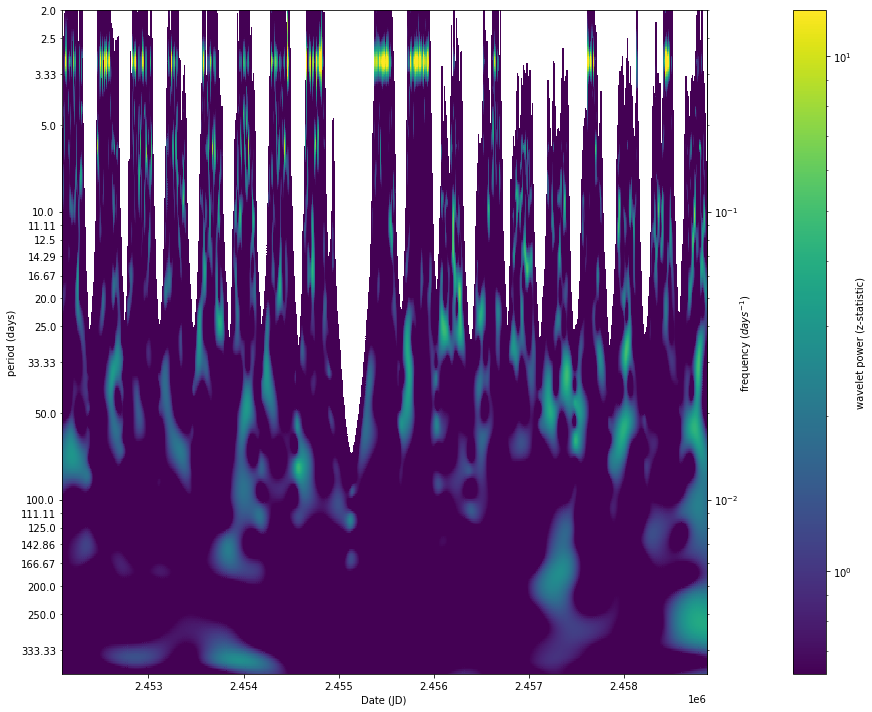

In [3136]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2],
                    clip=(np.percentile(wwt_spec[2], 75),np.percentile(wwt_spec[2], 99.9)))
plt.locator_params(axis='y', nbins=100)
# ax.set_ylabel('Frequency (1/day)')

ax.set_yscale('log')


# plt.axhline(1/period,xmin=0.43, xmax=0.47, zorder=1, c="black")#.axhline(y=1/period, zorder=1, c="black")

# from matplotlib.ticker import ScalarFormatter
# # for axis in [ax.xaxis, ax.yaxis]:
# ax.yaxis.set_major_formatter(ScalarFormatter())
import matplotlib.ticker as ticker


def forward(x):
    return 1 / x


def inverse(x):
    return 1 / x

secax = ax.secondary_yaxis('right')#, functions=(forward, inverse))
secax.set_ylabel('frequency ($days^{-1}$)', labelpad=0)


from matplotlib.ticker import FormatStrFormatter
ax.tick_params(axis='y', which='minor')

# ax.yaxis.set_minor_formatter(ticker.LogFormatterMathtext(labelOnlyBase=False))


ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: 1/y))
ax.yaxis.set_minor_formatter(ticker.FuncFormatter(lambda y, _: np.round(1/y, decimals=2)))

ax.set_ylabel('period (days)')
ax.set_xlabel('Date (JD)')


plt.tight_layout()
plt.show()

In [2975]:
def linear_plotter_log_1(ax: axes, TAU: np.ndarray, FREQ: np.ndarray, DATA: np.ndarray, clip=None):
    """
    Creates a plot for the 'linear' method.
    You can add titles after calling the plotter.
    :param ax: axis from a matplotlib.pyplot.subplots() to plot the data
    :param TAU: TAU output of the wwz.py (the time shifts)
    :param FREQ: FREQ output of the wwz.py (the frequencies)
    :param DATA: Desired data to be plotted
    :return:
    """
    #mask zero values, required to allow log scale axis
    DATA_masked = np.ma.masked_where(DATA == 0, DATA)
    data_mean = DATA_masked.mean()
    data_std = DATA_masked.std()
    if clip:
        DATA_clipped = np.clip(DATA_masked, clip[0], clip[1])
    else:
        DATA_clipped = DATA_masked

    # Create grid for pcolormesh boundaries
    tau_grid = make_tau_plot_grid(TAU)
    freq_grid = make_linear_freq_plot_grid(FREQ)

    # Plot using subplots
    im = ax.pcolormesh(tau_grid, freq_grid, DATA_clipped, norm=colors.LogNorm(vmin=DATA_clipped.min(), vmax=DATA_clipped.max()))
    
    # Add color bar and fix y_ticks
    cbar = ax.figure.colorbar(im, ax=ax, pad=0.1)
    ax.set_yticks(FREQ[0, :])
    ax.get_yaxis().set_major_formatter(ticker.ScalarFormatter())
    cbar.ax.set_ylabel('wavelet power (z-statistic)', rotation=90)

In [2891]:
x

array([2452086.89212, 2452103.89894, 2452105.92907, ..., 2458857.57788,
       2458862.59113, 2458869.57316])

In [2837]:
epoch_break

array([  88,  194,  304,  382,  470,  545,  655,  782,  786,  929, 1103,
       1151, 1225, 1271, 1315, 1395, 1443, 1538])

In [2836]:
x[:int(epoch_break+1)]

TypeError: only size-1 arrays can be converted to Python scalars

In [3069]:
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)

In [3062]:
epoch_breaks=np.where(np.diff(data[:,0])>50)[0]
print("start date \t median\t histogram(0-5 day bins)")
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)
for n_break, epoch_break in enumerate(epoch_breaks):
    if n_break == 0:
        diffs = np.diff(x[0:epoch_break+1])
        print("{}".format(data_df.ds.dt.date[epoch_break]),"\t", np.round(np.median(diffs), decimals=2),"\t", np.histogram(np.clip(diffs, 0,4.9), range=(0,5), bins=5)[0])
    elif n_break == len(epoch_breaks)-1:
        diffs = np.diff(x[epoch_break+1:])
        print("{}".format(data_df.ds.dt.date[epoch_break]),"\t", np.round(np.median(diffs), decimals=2),"\t",np.histogram(np.clip(diffs, 0,4.9), range=(0,5), bins=5)[0])
    else:
        diffs=np.diff(x[epoch_breaks[n_break-1]+1:epoch_break])
        print("{}".format(data_df.ds.dt.date[epoch_break]),"\t", np.round(np.median(diffs), decimals=2),"\t",np.histogram(np.clip(diffs, 0,4.9), range=(0,5), bins=5)[0])

start date 	 median	 histogram(0-5 day bins)
2002-01-29 	 1.99 	 [15 34 22  4 14]
2003-02-12 	 1.1 	 [23 41 20  9  9]
2004-02-05 	 2.0 	 [18 37 25 14  9]
2005-02-01 	 2.02 	 [10 21 22  9 14]
2006-02-14 	 2.02 	 [ 7 24 27  7 13]
2007-01-26 	 2.12 	 [ 4 22 18  8 20]
2008-02-06 	 2.02 	 [ 8 31 26 13 18]
2009-02-04 	 1.9 	 [31 31 10  9 10]
2011-01-31 	 1.03 	 [54 50 20  4 11]
2012-02-27 	 1.02 	 [58 72 23  5 10]
2013-01-13 	 1.01 	 [17 19  6  1  1]
2014-01-26 	 2.99 	 [12  6  7  3 17]
2015-01-22 	 3.09 	 [ 2  5  9 10 19]
2016-02-15 	 2.02 	 [ 6 17 10  7 13]
2017-01-19 	 4.02 	 [ 0  1  2 13 26]
2018-01-24 	 5.03 	 [ 2  1  5  9 40]
2019-02-02 	 3.03 	 [37 31 34 36 79]


In [3046]:
data_df.ds.dt.date#[epoch_break]

0       2001-06-30
1       2001-07-15
2       2001-07-16
3       2001-07-23
4       2001-07-26
           ...    
1427    2019-12-27
1428    2019-12-31
1429    2020-01-09
1430    2020-01-14
1431    2020-01-21
Name: ds, Length: 1432, dtype: object

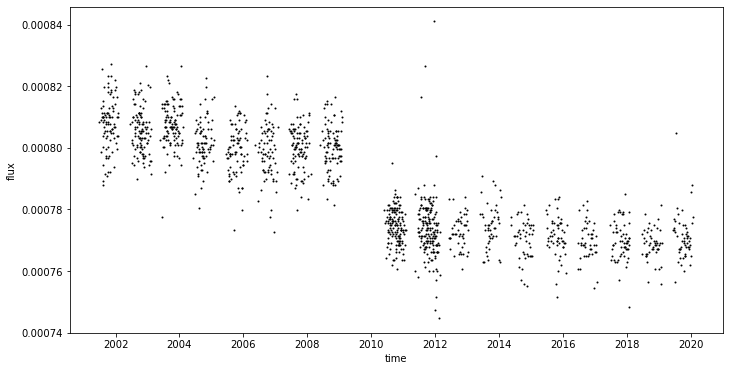

In [3063]:
plt.scatter(data_df["ds"],data_df["y"], alpha=1, label="light curve", s=1, c="black")
plt.xlabel("time")
plt.ylabel("flux")
plt.show()

In [3030]:
plt.plot(data[:,0], data[0])

0       2001-06-26
1       2001-07-13
2       2001-07-15
3       2001-07-16
4       2001-07-22
           ...    
1591    2019-12-27
1592    2019-12-31
1593    2020-01-09
1594    2020-01-14
1595    2020-01-21
Name: ds, Length: 1596, dtype: object

In [2848]:
np.diff(x[195:304])

array([26.967  ,  0.97688,  6.05757,  3.03567,  2.98655,  7.98011,
        4.99699,  0.87774,  0.96599,  0.17795,  0.93997,  2.00863,
        2.00108,  1.05718,  1.89274,  3.00145,  1.0458 ,  1.04599,
        3.93745,  1.03275,  1.04357,  0.87067,  1.13942,  0.88632,
        1.98695,  2.09405,  1.96599,  0.87118,  1.179  ,  0.90924,
        1.99686,  1.04966,  0.94003,  0.94765,  1.13299,  0.9136 ,
        1.04293,  3.94637,  0.9709 ,  2.96352,  4.08617,  1.93479,
        3.04831,  3.99139,  1.92917,  1.99708,  2.02096,  1.99887,
        1.99952,  3.00719,  2.00139,  1.98911,  1.99137,  3.97147,
        2.02611,  3.99776,  2.02193,  1.96299,  1.99749,  3.0181 ,
        2.00651,  1.9798 ,  2.92403,  2.05265,  0.94009,  1.04985,
        0.95015,  0.97119,  0.98461,  1.01677,  2.00949,  1.9813 ,
        1.04477,  0.98717,  1.02891,  2.02493,  1.94598,  1.9944 ,
        2.97111,  4.0384 ,  2.96134,  2.01925,  1.98449,  2.00073,
        1.94971,  2.02609,  2.01685,  1.94521,  2.0909 ,  2.01

In [2808]:
wwt_spec[3]()

AttributeError: 'numpy.ndarray' object has no attribute 'median'

In [2718]:
def make_wavelet(t_freq, t_tau, dec=1/(8*np.pi**2)):
    tau=wwt_spec[0][:,0]
    domega = 2*np.pi*frequency_parameters[frequency_ind] # 400 max t_freq
    dz = domega*(x-tau[t_tau]) #260 max t_tau
    c=dec#decay_constant
    return np.exp(1j * dz) * np.exp(-c * dz**2)
# wavelet_wwt

In [2790]:
np.diff(np.linspace(wwt_spec[0][0,0], wwt_spec[0][-1,0], 10000))

array([0.67833594, 0.67833594, 0.67833594, ..., 0.67833594, 0.67833594,
       0.67833594])

In [3140]:
(x[-1]-x[0])/10000

0.678268104000017

In [3070]:
data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})

data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

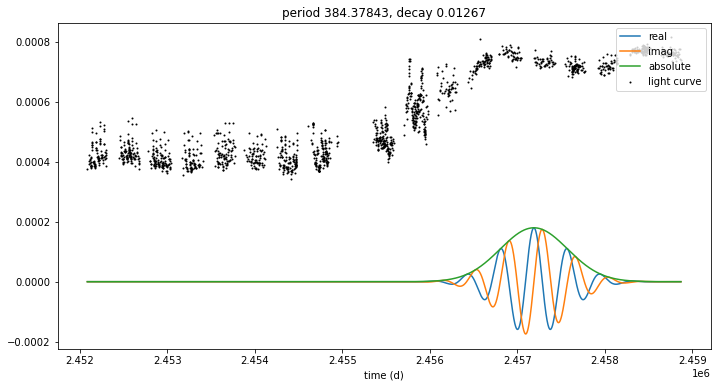

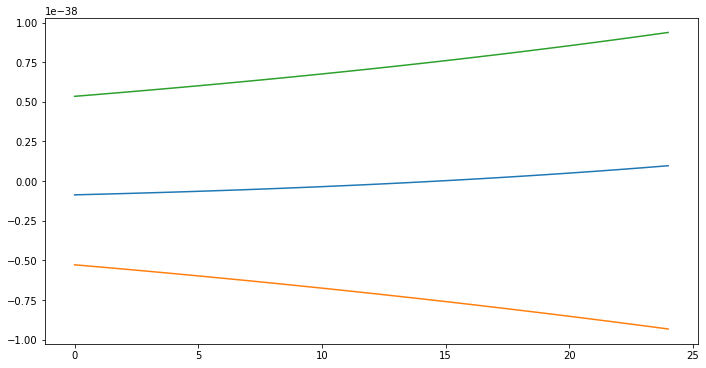

In [3077]:
frequency_ind=3
dec = 1/(8*np.pi**2)
# wavelet_wwt1 = make_wavelet(frequency_ind, 0, dec=dec)
wavelet_wwt2 = make_wavelet_even(frequency_ind, 1200, dec=dec)
wavelet_wwt = wavelet_wwt2#+wavelet_wwt2
plt.scatter(x,data_df["y"]-data_df["y"].mean()*0.1, alpha=1, label="light curve", s=1, c="black")
plt.plot(oversampling, wavelet_wwt.real*data_df["y"].mean()*0.3, label="real")
plt.plot(oversampling, wavelet_wwt.imag*data_df["y"].mean()*0.3, label="imag")
plt.plot(oversampling, abs(wavelet_wwt)*data_df["y"].mean()*0.3, label="absolute")
plt.legend(loc="upper right")
plt.title("period {:.5f}, decay {:.5f}".format(1/frequency_parameters[frequency_ind],dec))

# plt.ylabel('Imaginary')
plt.xlabel('time (d)')
plt.show()

plt.plot(wavelet_wwt.real[:25], label="real")
plt.plot(wavelet_wwt.imag[:25], label="imag")
plt.plot(abs(wavelet_wwt)[:25], label="absolute")
plt.show()

In [3318]:
wavelet_wwt.shape

(10000,)

In [2791]:
def make_wavelet_even(t_freq, t_tau, dec=1/(8*np.pi**2)):
    tau=wwt_spec[0][:,0]
    domega = 2*np.pi*frequency_parameters[frequency_ind] # 400 max t_freq
    oversampling = np.linspace(wwt_spec[0][0,0], wwt_spec[0][-1,0], 10000)
    dz = domega*(oversampling-tau[t_tau]) #260 max t_tau
    c=dec#decay_constant
    return np.exp(1j * dz) * np.exp(-c * dz**2)
# wavelet_wwt

In [3331]:
def make_wavelet_even_weights(t_freq, t_tau, dec=1/(8*np.pi**2)):
    tau=wwt_spec[0][:,0]
    domega = 2*np.pi*frequency_parameters[frequency_ind] # 400 max t_freq
    oversampling = np.linspace(wwt_spec[0][0,0], wwt_spec[0][-1,0], 10000)
    dz = domega*(oversampling-tau[t_tau]) #260 max t_tau
    c=dec#decay_constant
    return np.exp(-c * dz**2)
# wavelet_wwt

In [3344]:
wavelet_wwt_weights = make_wavelet_even_weights(frequency_ind, 10, dec=dec)

In [3443]:
wavelet_wwt_weights

array([6.77157924e-99, 8.66212872e-96, 9.87643647e-93, ...,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00])

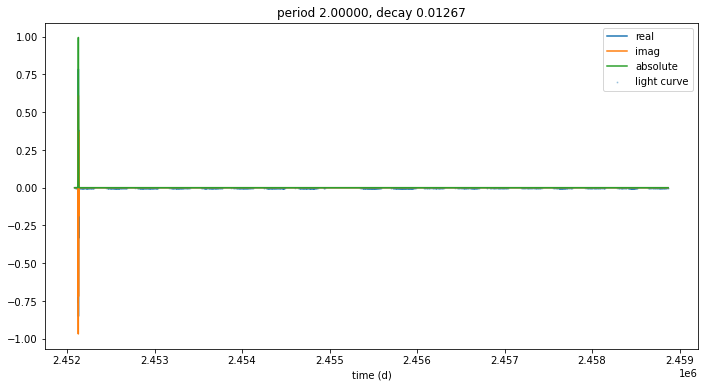

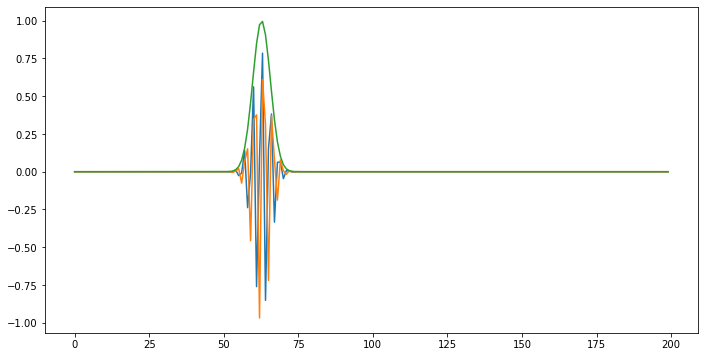

In [3343]:
frequency_ind=399
dec = 1/(8*np.pi**2)
# wavelet_wwt1 = make_wavelet(frequency_ind, 0, dec=dec)
wavelet_wwt2 = make_wavelet_even(frequency_ind, 10, dec=dec)
wavelet_wwt = wavelet_wwt2#+wavelet_wwt2
plt.scatter(x,data_df["y"], alpha=0.3, label="light curve", s=1)
plt.plot(oversampling, wavelet_wwt.real, label="real")
plt.plot(oversampling, wavelet_wwt.imag, label="imag")
plt.plot(oversampling, abs(wavelet_wwt), label="absolute")
plt.legend(loc="upper right")
plt.title("period {:.5f}, decay {:.5f}".format(1/frequency_parameters[frequency_ind],dec))

# plt.ylabel('Imaginary')
plt.xlabel('time (d)')
plt.show()

plt.plot(wavelet_wwt.real[:200], label="real")
plt.plot(wavelet_wwt.imag[:200], label="imag")
plt.plot(abs(wavelet_wwt)[:200], label="absolute")
plt.show()

In [3339]:
x[-1]-x[0]

6782.6810400001705

In [3451]:
np.sum(wavelet_wwt_weights>0)

177

In [3452]:
177*(6782.6810400001705/10000)

/home/jkok1g14/anaconda3/envs/py38/lib/python3.8/site-packages/IPython/core/displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


120.05345440800302

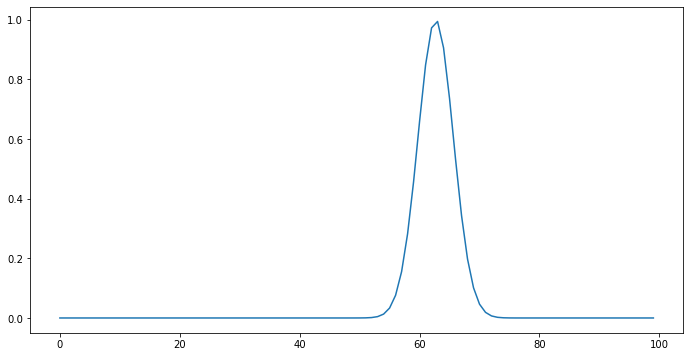

In [3450]:
plt.plot(wavelet_wwt_weights[:100])
plt.show()

In [3345]:
(wavelet_wwt_weights>10 ** -9).sum()

38

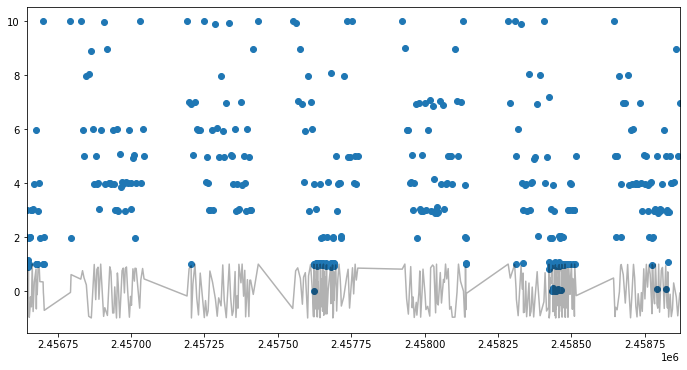

In [2754]:
plt.plot(x,y, alpha=0.3, label="light curve", c="black")
plt.scatter(x[1:], np.clip(np.diff(x),0,10))
plt.xlim((x[1200],x[-1]))
plt.show()

In [2752]:
x[1200]

2456645.56347

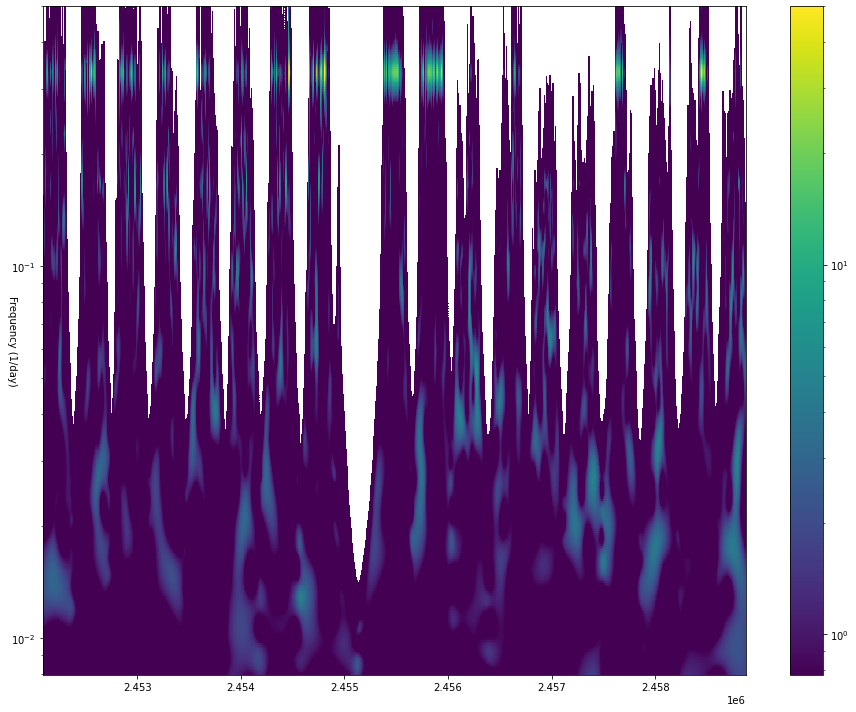

In [2960]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

# wwt_spec[3][wwt_spec[3]==0.] = np.nan

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2],
                    clip=(0.775, 50))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")#, linthreshy=0.1)
# plt.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

In [3342]:
wwt_spec[5]

array([[209.43059134, 206.67783971, 203.95007103, ...,   0.        ,
          0.        ,   0.        ],
       [210.52429348, 207.77508075, 205.05064662, ...,   1.        ,
          1.        ,   1.        ],
       [211.62308676, 208.87761159, 206.15671719, ...,   1.02216549,
          1.01949711,   1.01709646],
       ...,
       [157.65216831, 156.15321252, 154.66630949, ...,   1.56719118,
          1.5524832 ,   1.5376266 ],
       [157.02721442, 155.52208205, 154.02854171, ...,   1.52961056,
          1.51385681,   1.49809122],
       [156.40245097, 154.89105493, 153.39079493, ...,   1.00618752,
          1.00529634,   1.00451458]])

In [3351]:
wwt_spec[1][0][-1]

0.5

In [3347]:
wwt_spec[5].shape

(1596, 400)

In [3358]:
print(wwt_spec[0][:,-1][1:55])

[2452091.1445846  2452095.3970492  2452099.64951381 2452103.90197841
 2452108.15444301 2452112.40690761 2452116.65937221 2452120.91183682
 2452125.16430142 2452129.41676602 2452133.66923062 2452137.92169522
 2452142.17415982 2452146.42662443 2452150.67908903 2452154.93155363
 2452159.18401823 2452163.43648283 2452167.68894744 2452171.94141204
 2452176.19387664 2452180.44634124 2452184.69880584 2452188.95127045
 2452193.20373505 2452197.45619965 2452201.70866425 2452205.96112885
 2452210.21359345 2452214.46605806 2452218.71852266 2452222.97098726
 2452227.22345186 2452231.47591646 2452235.72838107 2452239.98084567
 2452244.23331027 2452248.48577487 2452252.73823947 2452256.99070408
 2452261.24316868 2452265.49563328 2452269.74809788 2452274.00056248
 2452278.25302708 2452282.50549169 2452286.75795629 2452291.01042089
 2452295.26288549 2452299.51535009 2452303.7678147  2452308.0202793
 2452312.2727439  2452316.5252085 ]


In [3359]:
2452316.5252085-2452091.1445846

225.38062390033156

In [3357]:
print(wwt_spec[5][:,-1][1:55])

[1.         1.01709646 1.16630348 2.52968999 2.39565215 2.06129018
 2.30127499 2.87083248 4.2572337  5.77233937 6.32469661 4.33478452
 4.92013896 2.73312533 2.50950583 1.98330248 3.21788482 3.64607707
 5.31833622 3.80609382 2.78052596 3.14466443 4.56990578 4.69879117
 3.80319463 2.18301507 1.15874999 1.86604245 3.46823488 5.26638397
 3.4099241  3.04142627 4.18330613 4.92539896 3.70850135 2.99909599
 1.89104668 1.99766404 2.98454196 2.56661708 2.19012812 1.98627591
 2.35179309 3.8132077  3.79581748 2.49385246 1.57335643 1.95604641
 3.23233597 3.30148806 2.16382683 1.04957441 1.00200163 1.        ]


In [2459]:
np.median(np.diff(x))

1.9991299998946488

In [ ]:
np.min(a[np.nonzero(a)])

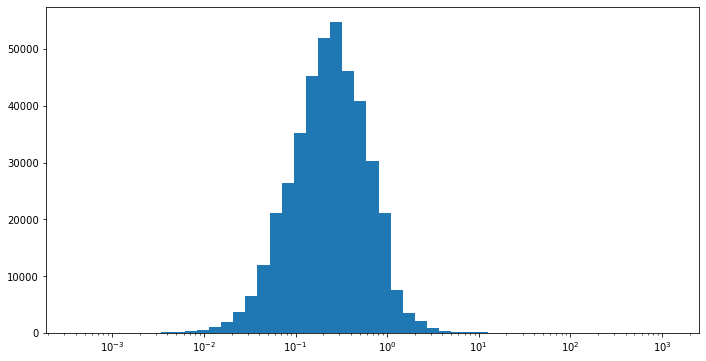

In [2615]:
xxx = np.ma.masked_where(wwt_spec[3] == 0, wwt_spec[3])

plt.hist(xxx.flatten(), bins=np.logspace(np.log10(xxx.min()), np.log10(xxx.max()), 50))
plt.xscale('log')
plt.show()

In [2666]:
xxx.mean()

0.7756695831921789

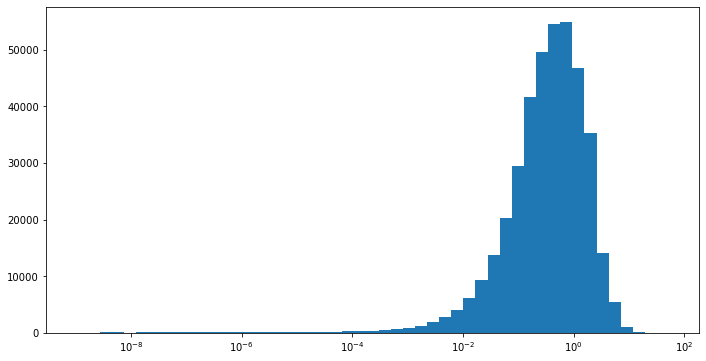

In [2665]:
no_freqs_below_Nyq = np.where(wwt_spec[1] < 1/np.median(np.diff(x)))[1][-1]
wwt_below_Nyq = wwt_spec[2][:,:no_freqs_below_Nyq]



xxx = np.ma.masked_where(wwt_below_Nyq == 0, wwt_below_Nyq)

plt.hist(xxx.flatten(), bins=np.logspace(np.log10(xxx.min()), np.log10(xxx.max()), 50))
plt.xscale('log')
plt.show()

In [2641]:
np.where(wwt_spec[1] < 1/np.median(np.diff(x)))#[0]

(array([   0,    0,    0, ..., 1595, 1595, 1595]),
 array([  0,   1,   2, ..., 339, 340, 341]))

In [2644]:
wwt_below_Nyq.shape

(1596, 341)

In [2645]:
wwt_below_Nyq.max()

533.2702222681269

In [2629]:
freq_below_Nyq

array([   0,    0,    0, ..., 1595, 1595, 1595])

In [2616]:
xxx.flatten().max()

1198.9552324437404

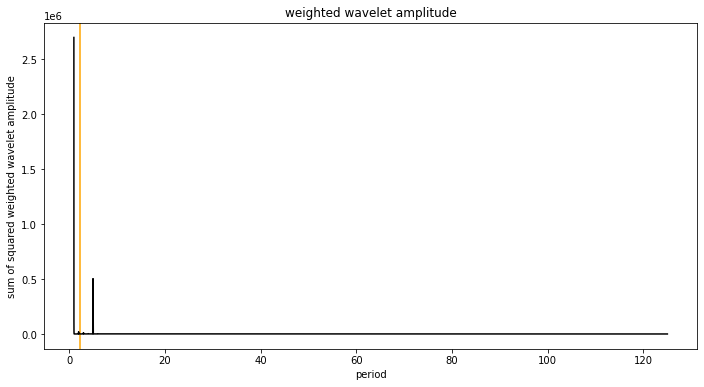

In [2612]:
plt.plot(1/wwt_spec[1][0], np.sum(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("sum of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [2613]:
np.sum(np.abs(wwt_spec[3])**2, axis=0)

array([2.45685461e+01, 2.52340655e+01, 2.59305288e+01, 2.66426090e+01,
       2.73461403e+01, 2.80053019e+01, 2.85730234e+01, 2.89986931e+01,
       2.92448854e+01, 2.93076224e+01, 2.92281848e+01, 2.90874483e+01,
       2.89847029e+01, 2.90105660e+01, 2.92244499e+01, 2.96457566e+01,
       3.02631121e+01, 3.10559539e+01, 3.20161818e+01, 3.31600913e+01,
       3.45267812e+01, 3.61632630e+01, 3.80994069e+01, 4.03168824e+01,
       4.27134860e+01, 4.50680807e+01, 4.70470111e+01, 4.83487034e+01,
       4.89883521e+01, 4.93783941e+01, 4.99599860e+01, 5.08696842e+01,
       5.20062269e+01, 5.32279034e+01, 5.44544156e+01, 5.56792262e+01,
       5.69375814e+01, 5.82642085e+01, 5.96590623e+01, 6.10615401e+01,
       6.23330552e+01, 6.32712515e+01, 6.37062534e+01, 6.36613241e+01,
       6.33946517e+01, 6.31937460e+01, 6.31613020e+01, 6.33173669e+01,
       6.39032091e+01, 6.52659119e+01, 6.73726707e+01, 6.99412126e+01,
       7.28110275e+01, 7.59071311e+01, 7.90590784e+01, 8.20370763e+01,
      

In [2605]:
np.array(((2.0000e+00, 2.0000e+00, 4.0000e+00, 1.3000e+01, 1.6000e+01,
        2.4000e+01, 4.2000e+01, 9.6000e+01, 1.7300e+02, 3.4800e+02,
        6.0600e+02, 1.0580e+03, 1.9650e+03, 3.6910e+03, 6.5300e+03,
        1.1960e+04, 2.1143e+04, 2.6421e+04, 3.5175e+04, 4.5251e+04,
        5.1931e+04, 5.4684e+04, 4.6131e+04, 4.0778e+04, 3.0349e+04,
        2.1179e+04, 7.6380e+03, 3.5520e+03, 2.1010e+03, 9.1600e+02,
        3.6900e+02, 2.1900e+02, 1.3900e+02, 9.9000e+01, 5.5000e+01,
        3.1000e+01, 3.7000e+01, 1.6000e+01, 2.1000e+01, 1.1000e+01,
        8.0000e+00, 4.0000e+00, 0.0000e+00, 4.0000e+00, 2.0000e+00,
        2.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00),
(3.99091660e-04, 5.41092146e-04, 7.33617712e-04, 9.94645646e-04,
    1.34854972e-03, 1.82837613e-03, 2.47892918e-03, 3.36095500e-03,
    4.55681372e-03, 6.17816998e-03, 8.37641973e-03, 1.13568270e-02,
    1.53976905e-02, 2.08763305e-02, 2.83043211e-02, 3.83752591e-02,
    5.20295294e-02, 7.05421149e-02, 9.56416487e-02, 1.29671828e-01,
    1.75810257e-01, 2.38365165e-01, 3.23177685e-01, 4.38167279e-01,
    5.94071230e-01, 8.05447242e-01, 1.09203278e+00, 1.48058810e+00,
    2.00739497e+00, 2.72164458e+00, 3.69003077e+00, 5.00297769e+00,
    6.78308320e+00, 9.19656663e+00, 1.24687897e+01, 1.69052998e+01,
    2.29203611e+01, 3.10756365e+01, 4.21326340e+01, 5.71238130e+01,
    7.74489914e+01, 1.05006055e+02, 1.42368176e+02, 1.93024084e+02,
    2.61703830e+02, 3.54820461e+02, 4.81068847e+02, 6.52237571e+02,
    8.84309701e+02, 1.19895523e+03)), dtype=float)

ValueError: setting an array element with a sequence.

In [3106]:
x

array([  0.        ,   0.96138996,   1.92277992,   2.88416988,
         3.84555985,   4.80694981,   5.76833977,   6.72972973,
         7.69111969,   8.65250965,   9.61389961,  10.57528958,
        11.53667954,  12.4980695 ,  13.45945946,  14.42084942,
        15.38223938,  16.34362934,  17.30501931,  18.26640927,
        19.22779923,  20.18918919,  21.15057915,  22.11196911,
        23.07335907,  24.03474903,  24.996139  ,  25.95752896,
        26.91891892,  27.88030888,  28.84169884,  29.8030888 ,
        30.76447876,  31.72586873,  32.68725869,  33.64864865,
        34.61003861,  35.57142857,  36.53281853,  37.49420849,
        38.45559846,  39.41698842,  40.37837838,  41.33976834,
        42.3011583 ,  43.26254826,  44.22393822,  45.18532819,
        46.14671815,  47.10810811,  48.06949807,  49.03088803,
        49.99227799,  50.95366795,  51.91505792,  52.87644788,
        53.83783784,  54.7992278 ,  55.76061776,  56.72200772,
        57.68339768,  58.64478764,  59.60617761,  60.56

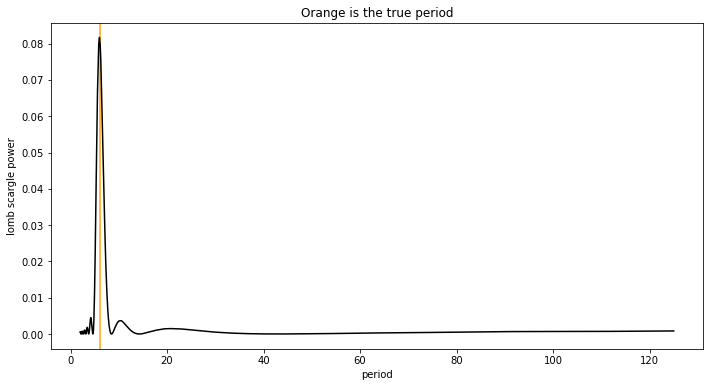

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  0.961
53.75 seconds has passed to complete Weighted Wavelet Z-transform 



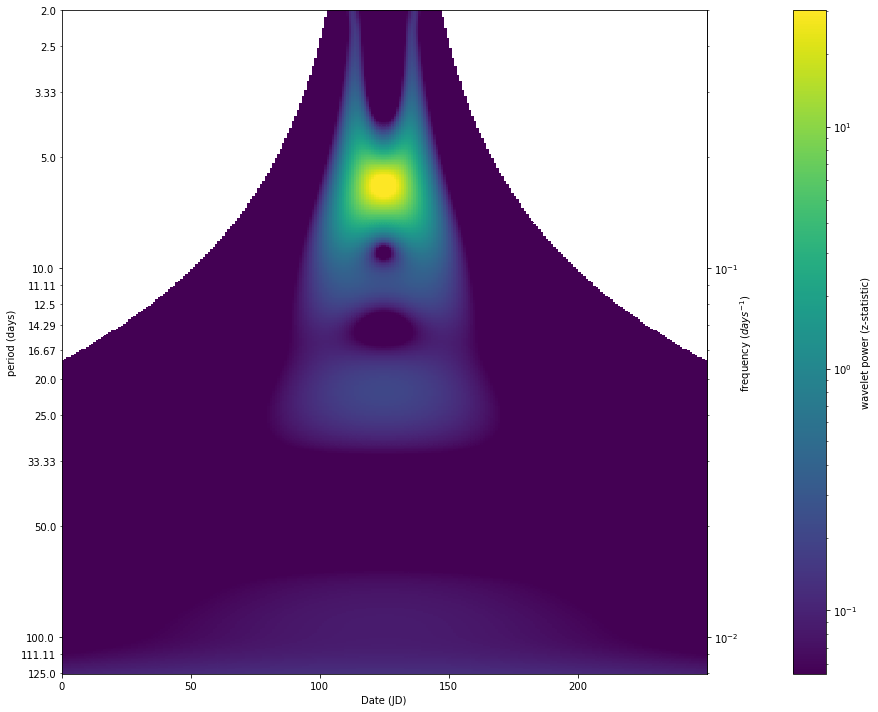

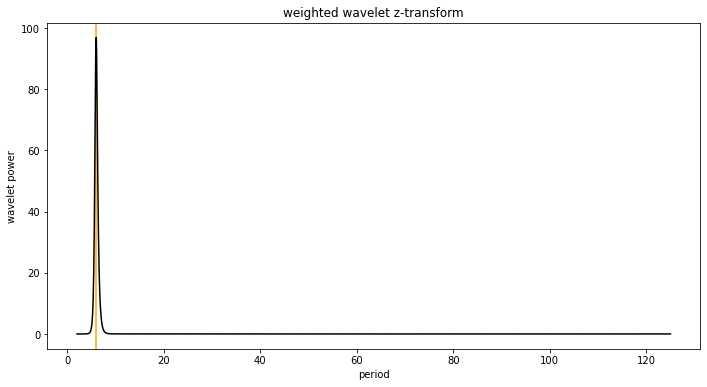

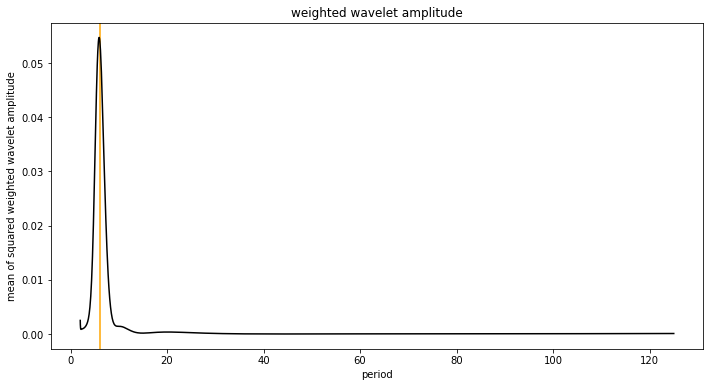

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3312]:
# generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=260)
period = 6
f=1/period
y = np.sin(x*f*np.pi*2 - np.pi*0)#+np.random.normal(0,0.5,size=len(x))
y[:120] = 0
y[140:] = 0

f = np.linspace(1/125, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 260 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec = wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2],
                    clip=(np.percentile(wwt_spec[2], 75),np.percentile(wwt_spec[2], 99.9)))
plt.locator_params(axis='y', nbins=100)
# ax.set_ylabel('Frequency (1/day)')

ax.set_yscale('log')

import matplotlib.ticker as ticker


def forward(x):
    return 1 / x


def inverse(x):
    return 1 / x

secax = ax.secondary_yaxis('right')#, functions=(forward, inverse))
secax.set_ylabel('frequency ($days^{-1}$)', labelpad=0)


from matplotlib.ticker import FormatStrFormatter
ax.tick_params(axis='y', which='minor')

# ax.yaxis.set_minor_formatter(ticker.LogFormatterMathtext(labelOnlyBase=False))


ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: 1/y))
ax.yaxis.set_minor_formatter(ticker.FuncFormatter(lambda y, _: np.round(1/y, decimals=2)))

ax.set_ylabel('period (days)')
ax.set_xlabel('Date (JD)')


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec[1][0], np.mean(np.abs(wwt_spec[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("wavelet power")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec[1][0], np.mean(np.abs(wwt_spec[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

In [3296]:
print((np.round(np.mean(np.abs(wwt_spec[2])**2, axis=0).max(), decimals=4), np.round(np.mean(np.abs(wwt_spec[3])**2, axis=0).max(), decimals=4)))

(2.467, 0.0152)


In [3316]:
wwt_spec[5][0]

array([210.32995697, 209.0403356 , 207.73250862, 206.40695405,
       205.06418018, 203.70472464, 202.32915349, 200.93806003,
       199.53206362, 198.11180825, 196.67796107, 195.2312108 ,
       193.77226602, 192.30185335, 190.82071555, 189.3296096 ,
       187.82930462, 186.32057978, 184.80422221, 183.2810248 ,
       181.75178402, 180.21729775, 178.6783631 , 177.13577423,
       175.59032025, 174.0427831 , 172.4939356 , 170.9445394 ,
       169.39534317, 167.84708079, 166.30046966, 164.75620912,
       163.21497898, 161.67743817, 160.14422352, 158.61594864,
       157.09320302, 155.57655113, 154.06653178, 152.56365754,
       151.06841432, 149.58126112, 148.1026298 , 146.6329251 ,
       145.17252473, 143.72177953, 142.28101382, 140.85052578,
       139.43058799, 138.02144802, 136.62332907, 135.23643075,
       133.86092989, 132.49698137, 131.14471906, 129.80425676,
       128.47568913, 127.15909277, 125.85452715, 124.56203568,
       123.28164667, 122.01337438, 120.75722003, 119.51

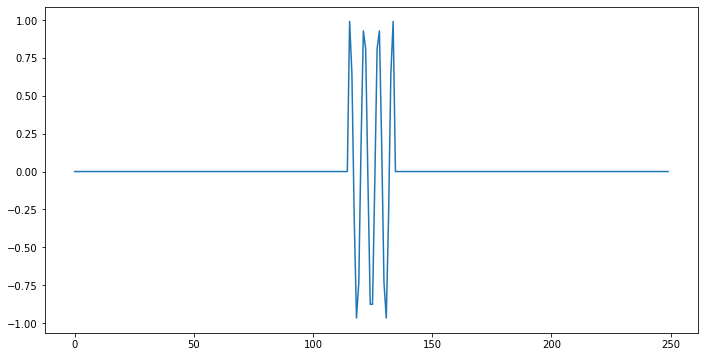

In [3313]:
plt.plot(x,y)
plt.show()

In [3262]:
np.mean(np.abs(wwt_spec[2])**2, axis=0).max()

18380.11595250237

In [3263]:
np.mean(np.abs(wwt_spec[3])**2, axis=0).max()

1.0000011426283584

In [3301]:
maxes[:,2]

array([0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.04,
       0.04, 0.04, 0.04, 0.04, 0.04, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05, 0.05, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.05, 0.05, 0.05,
       0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05, 0.05, 0.05, 0.05, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.05,
       0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.04, 0.04, 0.04, 0.04,
       0.04, 0.04, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05,
       0.05])

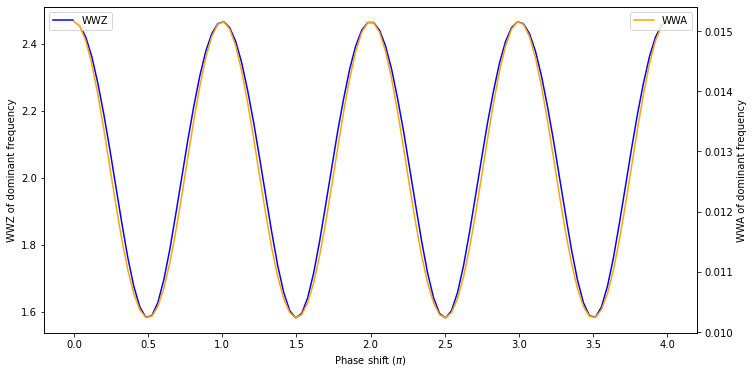

In [3305]:
maxes = np.array(maxes)
fig = plt.figure()
ax = fig.add_subplot(111)
ax.plot(maxes[:,0], maxes[:,1], label="WWZ", c="blue")
ax.legend(loc="upper left")

ax2 = ax.twinx()
ax2.plot(maxes[:,0], maxes[:,2], label="WWA", c="orange")
ax2.legend(loc="upper right")

ax.set_xlabel("Phase shift ($\pi$)")
ax.set_ylabel("WWZ of dominant frequency")
ax2.set_ylabel("WWA of dominant frequency")

plt.show()

In [3304]:
maxes = []
for phase_shift in np.linspace(0,4,100):

    # generate data for a sine wave observed for 10 years with random noise added
    # data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
    x = data[:,0]
    x = np.linspace(0, 249, num=260)
    period = 6
    f=1/period
    y = np.sin(x*f*np.pi*2 - np.pi*phase_shift)#+np.random.normal(0,0.5,size=len(x))
    y[:120] = 0
    y[140:] = 0

    # Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
    # This will also limit the minimum possible frequecny
    ntau = 10 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

    # Set the low and high frequency bounds and steps to iterate 
    frequency_low = 1/125
    frequency_high = 1/2
    # frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
    # frequency_steps = frequency_steps[1]-frequency_steps[0]

    # Set the override to False (Setting to True will ignore the low and high frequency limitations)
    override = False

    # gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
    frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

    # We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
    # The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

    # f = 20     # we choose 4 since our signal of interest is at 4 h
    # w = 2 * np.pi * f
    # decay_constant = 1/(2*w**2)
    decay_constant = 1/(8*np.pi**2)
    # Finally, we select to wether to run with parallization (recommend True)
    parallel = True


    # Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
    wwt_spec = wwt_6 = wwt(timestamps=x,
                         magnitudes=y,
                         time_divisions=ntau,
                         freq_params=frequency_parameters,
                         decay_constant=decay_constant,
                         method='linear',
                         parallel=parallel)
    maxes.append((phase_shift, np.mean(np.abs(wwt_spec[2])**2, axis=0).max(), np.mean(np.abs(wwt_spec[3])**2, axis=0).max()))

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  27.667
2.77 seconds has passed to complete Weighted Wavelet Z-transform 

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  27.667
2.32 seconds has passed to complete Weighted Wavelet Z-transform 

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  27.667
2.3 seconds has passed to complete Weighted Wavelet Z-transform 

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  27.667
2.33 seconds has passed to complete Weighted Wavelet Z-transform 

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  1.04
largest tau window is  27.667
2.31 seconds has passed to complete Weighted Wavelet Z-transform 

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency 

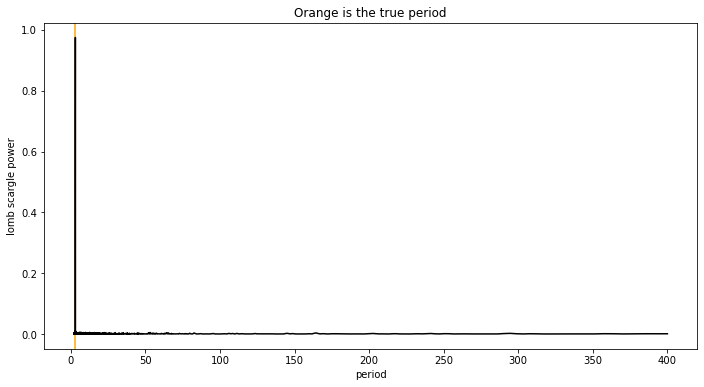

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  1596
Pseudo sample frequency (median) is  0.5
largest tau window is  4.252
201.85 seconds has passed to complete Weighted Wavelet Z-transform 



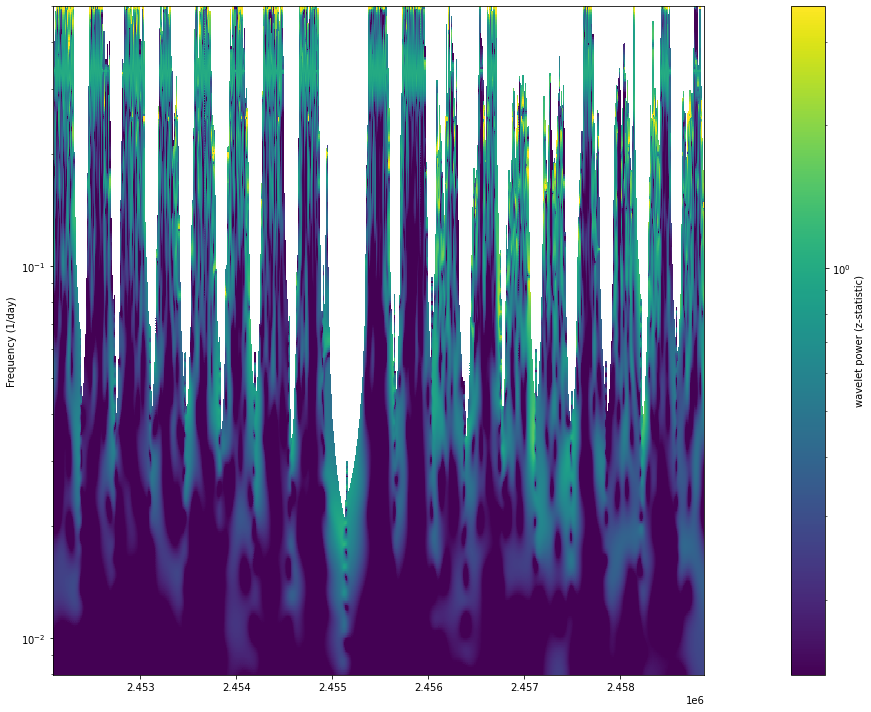

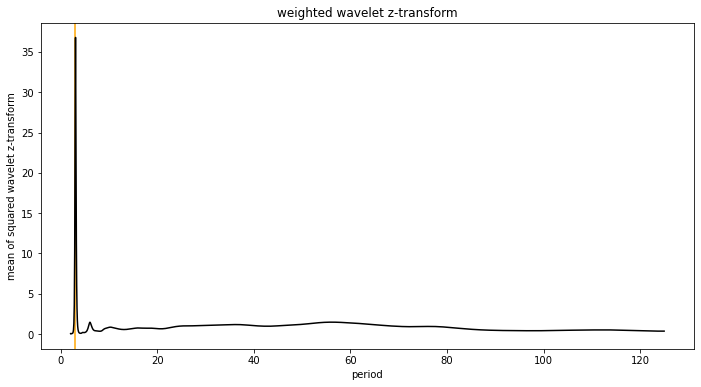

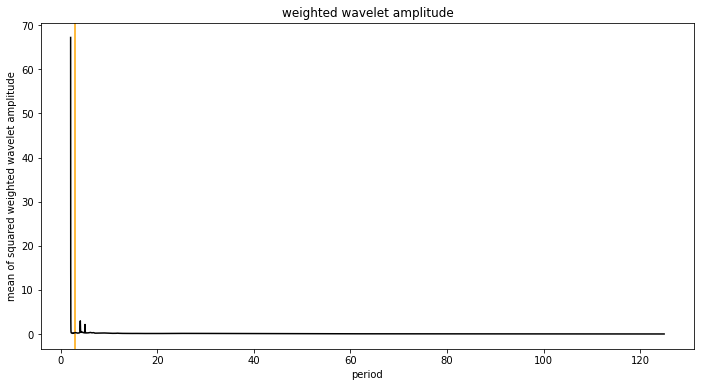

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3442]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq[3],
                    clip=(np.percentile(wwt_spec_Nyq[3], 50),np.percentile(wwt_spec_Nyq[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

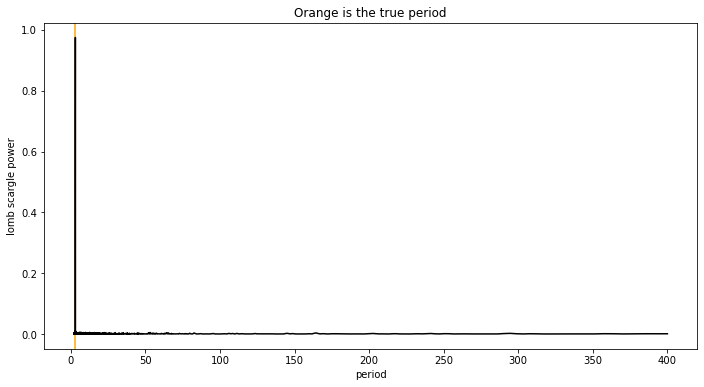

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  1596
Pseudo sample frequency (median) is  0.5
largest tau window is  4.252
453.23 seconds has passed to complete Weighted Wavelet Z-transform 



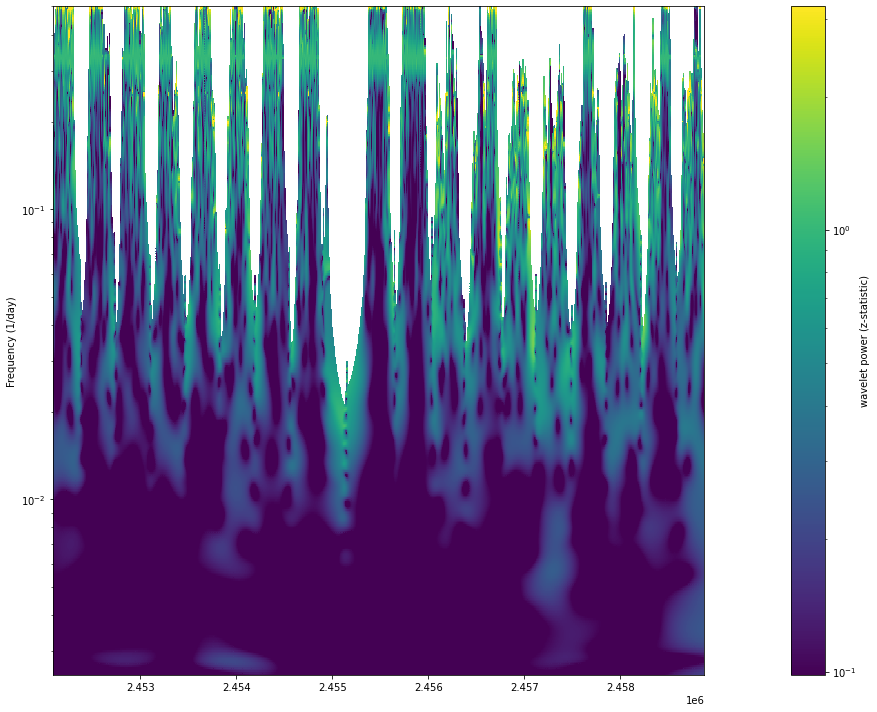

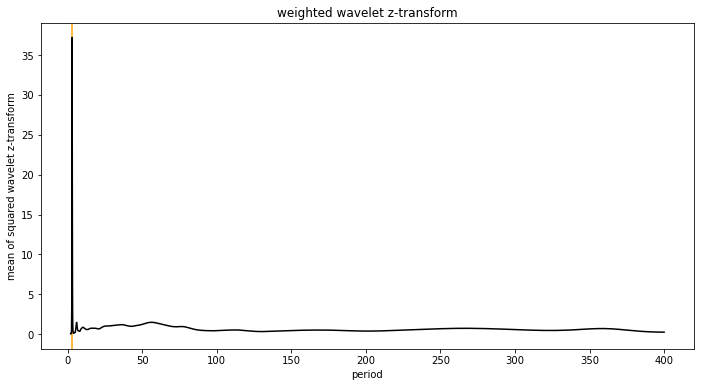

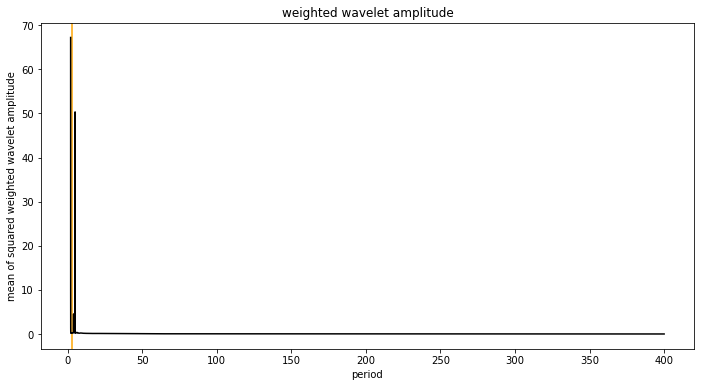

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3441]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq[3],
                    clip=(np.percentile(wwt_spec_Nyq[3], 50),np.percentile(wwt_spec_Nyq[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

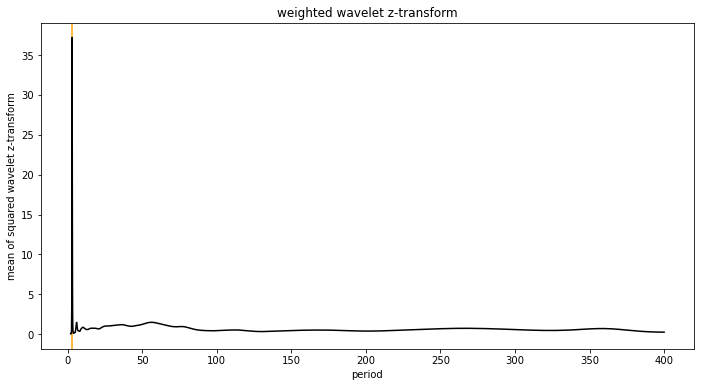

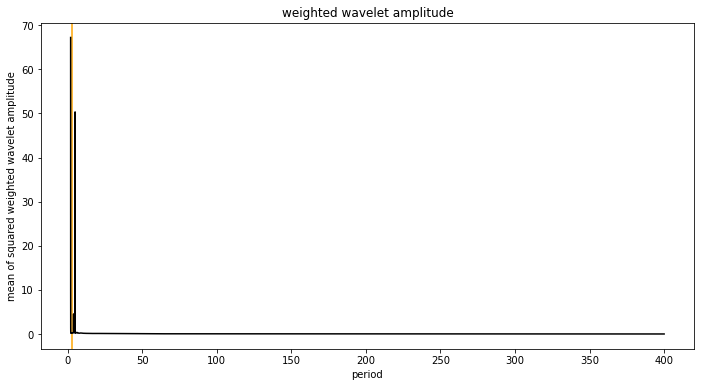

In [3439]:
plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

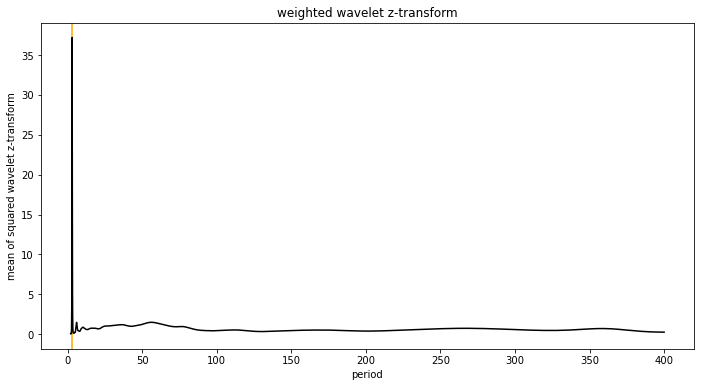

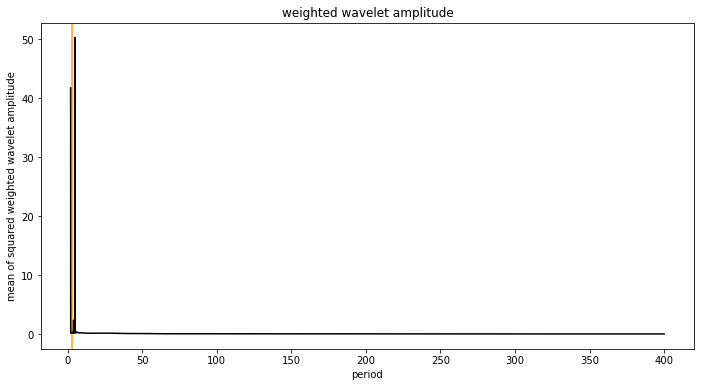

In [3440]:
plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq2)**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq3)**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

In [3393]:
wwt_spec_Nyq[3]#[:,-1][:1000]

array([[0.03217736, 0.0319365 , 0.03183168, ..., 0.        , 0.        ,
        0.        ],
       [0.03166731, 0.03139944, 0.03127649, ..., 0.        , 0.        ,
        0.        ],
       [0.03115603, 0.03086241, 0.03072359, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.19394702, 0.1854245 , 0.17468401, ..., 0.        , 0.        ,
        0.        ],
       [0.19485785, 0.18631677, 0.17555386, ..., 0.        , 0.        ,
        0.        ],
       [0.1957644 , 0.18720454, 0.17641912, ..., 0.        , 0.        ,
        0.        ]])

In [3424]:
wwt_spec_Nyq3 = np.copy(wwt_spec_Nyq[3])
wwt_spec_Nyq2 = np.copy(wwt_spec_Nyq[2])

# if the median sampling cadence for a wavelet time shift is larger than the tested period, change the WWA and WWZ 
# for that time shift and frequency to zero 
wwt_spec_Nyq2[1/wwt_spec_Nyq[1] < wwt_spec_Nyq[6]] = 0.
wwt_spec_Nyq3[1/wwt_spec_Nyq[1] < wwt_spec_Nyq[6]] = 0.


for time_shift_n, time_shift in enumerate(wwt_spec_Nyq2):
    if 0. in time_shift:
        top_freq_zero = np.where(time_shift == 0.)[0][0]
        wwt_spec_Nyq2[time_shift_n, top_freq_zero:] = 0.
    
for time_shift_n, time_shift in enumerate(wwt_spec_Nyq3):
    if 0. in time_shift:
        top_freq_zero = np.where(time_shift == 0.)[0][0]
        wwt_spec_Nyq3[time_shift_n, top_freq_zero:] = 0.

In [3422]:
np.where(time_shift == 0.)[0][0]

291

In [3394]:
wwt_spec_Nyq2[1/wwt_spec_Nyq[1] < wwt_spec_Nyq[6]] = 0.

In [3395]:
wwt_spec_Nyq3[1/wwt_spec_Nyq[1] < wwt_spec_Nyq[6]] = 0.

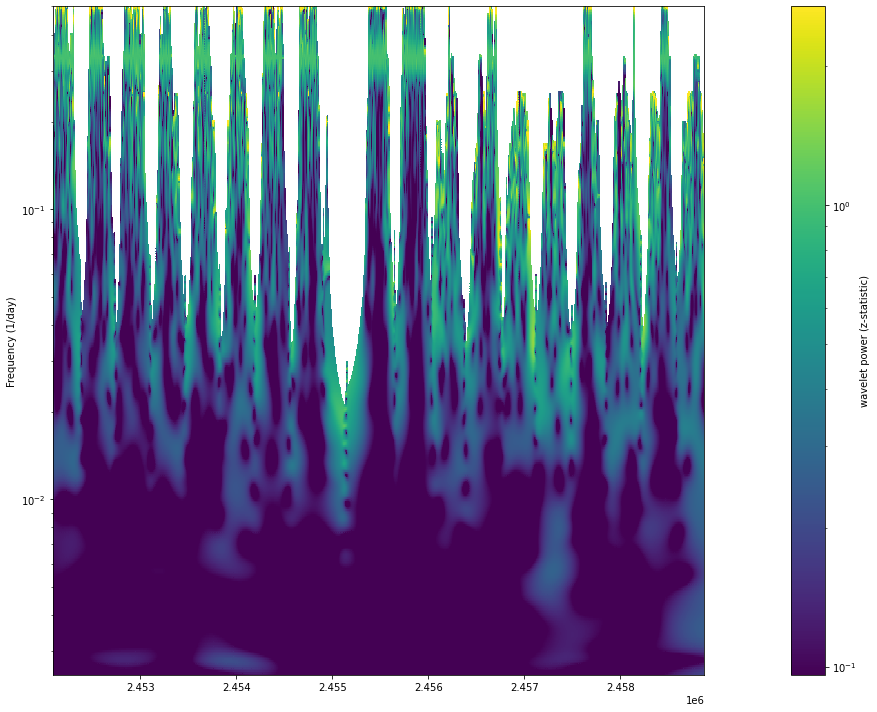

In [3425]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq3,
                    clip=(np.percentile(wwt_spec_Nyq3, 50),np.percentile(wwt_spec_Nyq3, 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

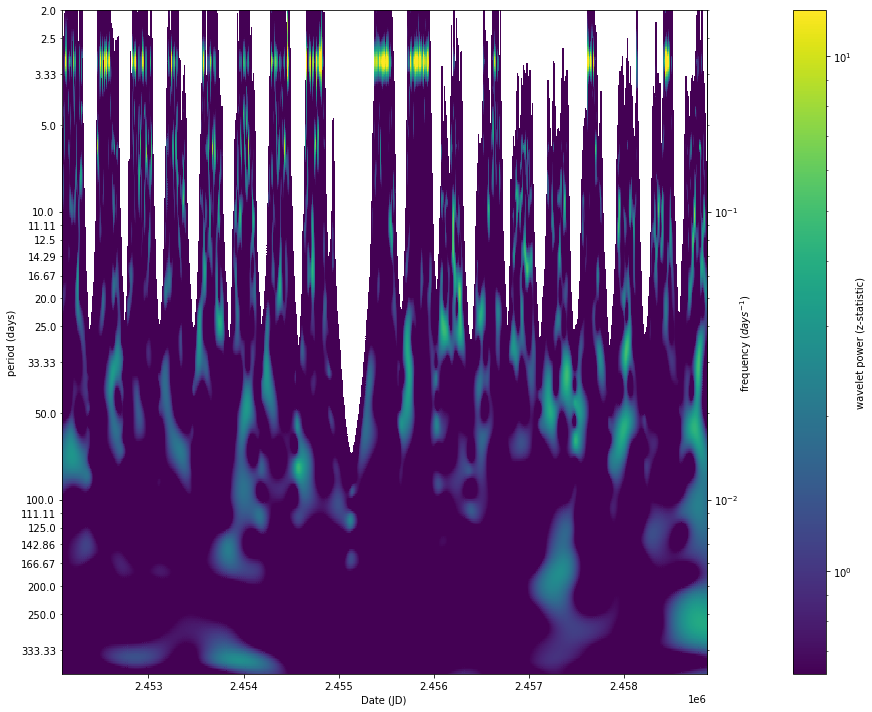

In [3372]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq[2],
                    clip=(np.percentile(wwt_spec_Nyq[2], 75),np.percentile(wwt_spec_Nyq[2], 99.9)))
plt.locator_params(axis='y', nbins=100)
# ax.set_ylabel('Frequency (1/day)')

ax.set_yscale('log')

import matplotlib.ticker as ticker


def forward(x):
    return 1 / x


def inverse(x):
    return 1 / x

secax = ax.secondary_yaxis('right')#, functions=(forward, inverse))
secax.set_ylabel('frequency ($days^{-1}$)', labelpad=0)


from matplotlib.ticker import FormatStrFormatter
ax.tick_params(axis='y', which='minor')

# ax.yaxis.set_minor_formatter(ticker.LogFormatterMathtext(labelOnlyBase=False))


ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: 1/y))
ax.yaxis.set_minor_formatter(ticker.FuncFormatter(lambda y, _: np.round(1/y, decimals=2)))

ax.set_ylabel('period (days)')
ax.set_xlabel('Date (JD)')


plt.tight_layout()
plt.show()

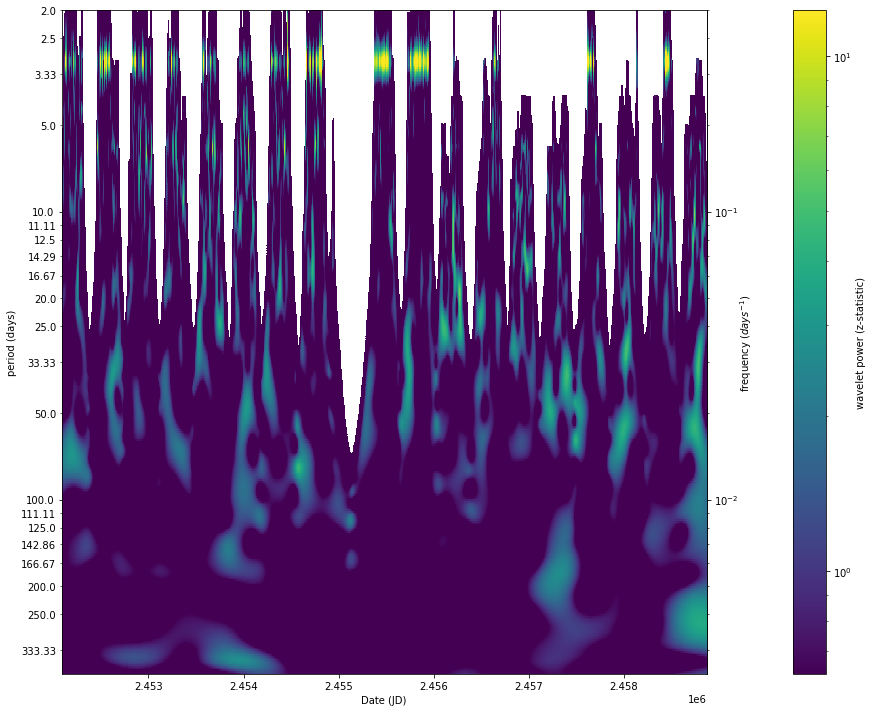

In [3428]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq2,
                    clip=(np.percentile(wwt_spec_Nyq2, 75),np.percentile(wwt_spec_Nyq2, 99.9)))
plt.locator_params(axis='y', nbins=100)
# ax.set_ylabel('Frequency (1/day)')

ax.set_yscale('log')

import matplotlib.ticker as ticker


def forward(x):
    return 1 / x


def inverse(x):
    return 1 / x

secax = ax.secondary_yaxis('right')#, functions=(forward, inverse))
secax.set_ylabel('frequency ($days^{-1}$)', labelpad=0)


from matplotlib.ticker import FormatStrFormatter
ax.tick_params(axis='y', which='minor')

# ax.yaxis.set_minor_formatter(ticker.LogFormatterMathtext(labelOnlyBase=False))


ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: 1/y))
ax.yaxis.set_minor_formatter(ticker.FuncFormatter(lambda y, _: np.round(1/y, decimals=2)))

ax.set_ylabel('period (days)')
ax.set_xlabel('Date (JD)')


plt.tight_layout()
plt.show()

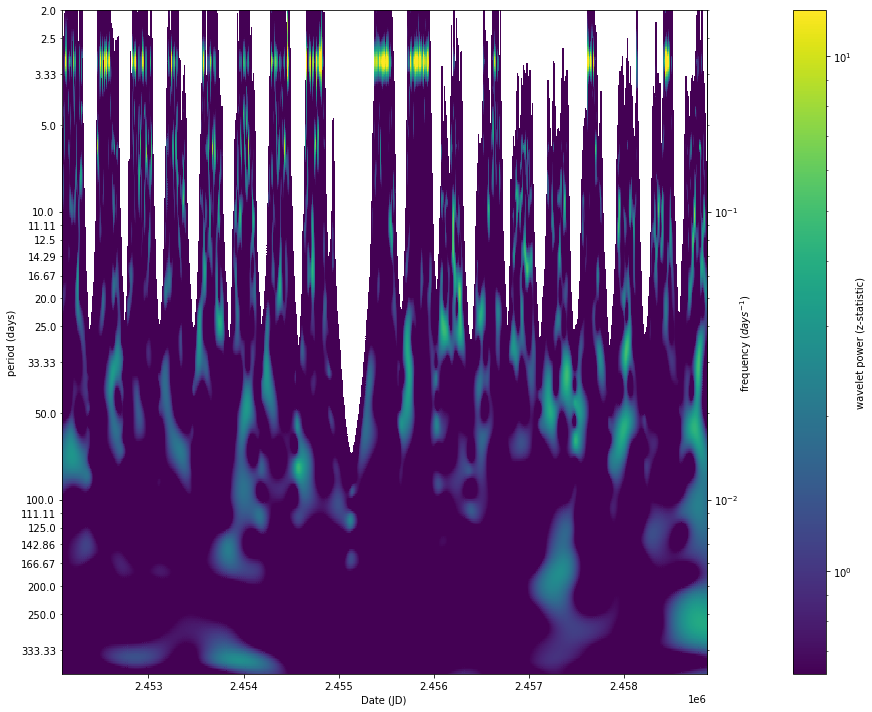

In [3279]:
fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec[0],
                       FREQ=wwt_spec[1],
                       DATA=wwt_spec[2],
                    clip=(np.percentile(wwt_spec[2], 75),np.percentile(wwt_spec[2], 99.9)))
plt.locator_params(axis='y', nbins=100)
# ax.set_ylabel('Frequency (1/day)')

ax.set_yscale('log')

import matplotlib.ticker as ticker


def forward(x):
    return 1 / x


def inverse(x):
    return 1 / x

secax = ax.secondary_yaxis('right')#, functions=(forward, inverse))
secax.set_ylabel('frequency ($days^{-1}$)', labelpad=0)


from matplotlib.ticker import FormatStrFormatter
ax.tick_params(axis='y', which='minor')

# ax.yaxis.set_minor_formatter(ticker.LogFormatterMathtext(labelOnlyBase=False))


ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: 1/y))
ax.yaxis.set_minor_formatter(ticker.FuncFormatter(lambda y, _: np.round(1/y, decimals=2)))

ax.set_ylabel('period (days)')
ax.set_xlabel('Date (JD)')


plt.tight_layout()
plt.show()

In [3365]:
np.diff(wwt_spec[0][:,0])

array([4.2524646, 4.2524646, 4.2524646, ..., 4.2524646, 4.2524646,
       4.2524646])

In [ ]:
for dfreq in freq:
    # Initialize a vector (3) and matrix (3,3) and dweight2 (sum of dweight**2)
    dvec: np.ndarray = np.zeros(3)
    dmat: np.ndarray = np.zeros([3, 3])
    dweight2: float = 0.0
    # Get Scale Factor (referred in paper as "frequency")
    domega: float = 2.0 * np.pi * dfreq

    # Discrete wavelet transform (DWT)
    # Lots of math here, but basically doing the summations shown in the paper
    for idat in range(nstart, numdat):
        # Get dweight (an element of "local data number" viewed as "weights" in the paper)
        dz: float = domega * (timestamps[idat] - dtau)
        dweight: float = np.exp(-1 * decay_constant * dz ** 2)

In [3459]:
"""
This module provides functions for computing the weighted wavelet z transform over input values.
"""

from typing import List

# noinspection Mypy
import numpy as np
# noinspection Mypy
from joblib import Parallel, delayed
import multiprocessing
import time


def make_tau(timestamps: np.ndarray,
             time_divisions: int) -> np.ndarray:
    """
    Creates an array of times with given timestamps and time divisions to iterate over in the wwt code.
    :param timestamps: An array with corresponding times for the magnitude (payload).
    :param time_divisions: number of divisions for the new timestamps
    :return: tau
    """

    # Check to see if time_divisions is smaller than timestamps (replace if larger)
    if time_divisions > len(timestamps):
        time_divisions = len(timestamps)
        print('adjusted time_divisions to: ', time_divisions)

    # Make tau
    tau: np.ndarray = np.linspace(timestamps[0], timestamps[-1], time_divisions)

    return tau


def make_freq(freq_low: float,
              freq_high: float,
              freq_steps: float, ) -> np.ndarray:
    """
    Creates an array of frequencies with given low, high, and steps to iterate over in the wwt code.
    :param freq_low: The low end of frequency to cast WWZ
    :param freq_high: The high end of frequency to cast WWZ
    :param freq_steps: The frequency steps for casting WWZ
    :return: freq
    """
    freq: np.ndarray = np.arange(freq_low, freq_high + freq_steps, freq_steps)

    return freq


def make_octave_freq(freq_target: float,
                     freq_low: float,
                     freq_high: float,
                     band_order: float,
                     log_scale_base: float,
                     freq_pseudo_sr: float,
                     largest_tau_window: float,
                     override: bool) -> np.ndarray:
    """
    Creates an array of frequencies based on Milton Garces' Constant-Q standardized Inferno framework (2013)
    Recommend "Constant-Q Gabor Atoms for Sparse Binary Representations of Cyber-Physical Signatures" (Garces 2020)
    :param freq_target: target frequency / frequency of interest
    :param freq_low: desired minimum frequency to be contained
    :param freq_high: desired maximum frequncy to be contained
    :param band_order: octave band order (N => 1) *Recommend N = (1, 3, 6, 12, 24,...)
    :param log_scale_base: logarithmic scale base to create the octaves
    :param freq_pseudo_sr: pseudo sample rate of the data by taking the average
    :param largest_tau_window: largest tau window made from make_tau function
    :param override: Override the freq_low and freq_high restrictions
    :return:
    """
    # Check and fix if the freq_low and freq_high meet requirements [CAN BE OVERRIDE]
    # Calculate j_min / j_max (band number min / max)
    if freq_low <= 2 / largest_tau_window and override is False:
        print('largest data window duration is too small for freq_low... taking lowest possible...')
        # This is taken from equation 69b
        j_min = np.floor(band_order * np.log2(2 / (largest_tau_window * freq_target))) + 1
    else:
        j_min = np.floor(band_order * np.log2(freq_low / freq_target))

    if freq_high >= freq_pseudo_sr / 2 and override is False:
        print('Nyquist Frequency is too small for freq_high... taking largest possible...')
        # This is taken from equation 69a
        j_max = np.ceil(band_order * np.log2(freq_pseudo_sr / (2 * freq_target))) - 1
    else:
        j_max = np.ceil(band_order * np.log2(freq_high / freq_target))

    # Create an array with the j_min to j_max (equation 70)
    band_numbers = np.arange(j_min, j_max + 1)

    # Compute the octave frequency bands (center frequencies) (equation 70)
    freq = freq_target * log_scale_base ** (band_numbers / band_order)

    return freq


def wwt_Nyquist(timestamps: np.ndarray,
        magnitudes: np.ndarray,
        time_divisions: int,
        freq_params: list,
        decay_constant: float,
        method: str = 'linear',
        parallel: bool = True) -> np.ndarray:
    """
    The code is based on G. Foster's FORTRAN
    code as well as eaydin's python 2.7 code. The code is updated to use numpy methods and allow for float value tau.
    It returns an array with matrix of new evenly spaced timestamps, frequencies, wwz-power, amplitude, coefficients,
    and effective number. Specific equations can be found on Grant Foster's "WAVELETS FOR PERIOD ANALYSIS OF UNEVENLY
    SAMPLED TIME SERIES". Some of the equations are labeled in the code with corresponding numbers.

    :param timestamps: An array with corresponding times for the magnitude (payload).
    :param magnitudes: An array with payload values
    :param time_divisions: number of divisions for the new timestamps
    :param freq_params: A list containing parameters for making frequency bands to analyze over with given 'method'
            'linear' -> [freq_low, freq_high, freq_step, override]
            'octave' -> [freq_tg, freq_low, freq_high, band_order, log_scale_base, override]
    :param decay_constant: decay constant for the Morlet wavelet (should be <0.02) eq. 1-2
            c = 1/(2w), the wavelet decays significantly after a single cycle of 2 * pi / w
    :param method: determines method of creating freq ('linear', 'octave') default 'linear'
    :param parallel: boolean indicate to use parallel processing or not
    :return: Tau, Freq, WWZ, AMP, COEF, NEFF in a numpy array
    """

    # Starting Weighted Wavelet Z-transform and start timer...
    print("*** Starting Weighted Wavelet Z-transform ***\n")
    process_starttime: float = time.time()

    # Get taus to compute WWZ (referred in paper as "time shift(s)")
    tau: np.ndarray = make_tau(timestamps, time_divisions)
    ntau: int = len(tau)

    # Calculate pseudo sample rate and largest time window to check for requirements
    freq_pseudo_sr = 1 / np.median(np.diff(timestamps))  # 1 / median period

    # noinspection PyArgumentList
    largest_tau_window = tau[1] - tau[0]
    print('Pseudo sample frequency (median) is ', np.round(freq_pseudo_sr, 3))
    print('largest tau window is ', np.round(largest_tau_window, 3))

    # Frequencies to compute WWZ
    if method == 'linear':
        freq: np.ndarray = freq_params
            #np.arange(freq_params[0], freq_params[1] + freq_params[2], freq_params[2])
            #np.ndarray = make_freq(freq_low=freq_params[0],
             #                        freq_high=freq_params[1],
              #                       freq_steps=freq_params[2])
        nfreq: int = len(freq)

    elif method == 'octave':
        freq = make_octave_freq(freq_target=freq_params[0],
                                freq_low=freq_params[1],
                                freq_high=freq_params[2],
                                band_order=freq_params[3],
                                log_scale_base=freq_params[4],
                                freq_pseudo_sr=freq_pseudo_sr,
                                largest_tau_window=largest_tau_window,
                                override=freq_params[5])
        nfreq = len(freq)

    # Get number of data from timestamps
    numdat: int = len(timestamps)

    # Get number of CPU cores on current device (used for parallel)
    num_cores = multiprocessing.cpu_count()

    # WWT Stars Here
    def tau_loop(dtau):
        """
        Replaced the for loop of the taus ("time shifts") for parallel processing.
        Comments include connections to the formula given in the Foster96.
        :param dtau: one of the taus being iterated
        :return: a single entry of Tau, Freq, WWZ, AMP, COEF, NEFF, (median sampling diff) corresponding to dtau
        """
        # Initialize the outputs for each iteration
        index: int = 0
        output: np.ndarray = np.empty((len(freq), 7))
        nstart: int = 1
        dvarw: float = 0.0

        # loop over each interested "frequency" over the "time shifts"
        for dfreq in freq:
            non_zero_dats = []
            # Initialize a vector (3) and matrix (3,3) and dweight2 (sum of dweight**2)
            dvec: np.ndarray = np.zeros(3)
            dmat: np.ndarray = np.zeros([3, 3])
            dweight2: float = 0.0
            # Get Scale Factor (referred in paper as "frequency")
            domega: float = 2.0 * np.pi * dfreq

            # Discrete wavelet transform (DWT)
            # Lots of math here, but basically doing the summations shown in the paper
            for idat in range(nstart, numdat):
                # Get dweight (an element of "local data number" viewed as "weights" in the paper)
                dz: float = domega * (timestamps[idat] - dtau)
                dweight: float = np.exp(-1 * decay_constant * dz ** 2)

                # get upper triangular matrix of the weights and vector
                # These are used later to calculate Neff, DWT, DWP, etc in the paper
                if dweight > 10 ** -9:
                    non_zero_dats.append(timestamps[idat])
                    cos_dz: float = np.cos(dz)
                    sin_dz: float = np.sin(dz)
                    dweight2 += dweight ** 2
                    dvarw += dweight * magnitudes[idat] ** 2  # Used to get "weighted variation" later

                    dmat[0, 0] += dweight
                    dmat[0, 1] += dweight * cos_dz
                    dmat[0, 2] += dweight * sin_dz
                    dmat[1, 1] += dweight * cos_dz ** 2
                    dmat[1, 2] += dweight * cos_dz * sin_dz
                    dmat[2, 2] += dweight * sin_dz ** 2

                    # parallel to the 3 trial functions (5-5, 6, 7)
                    dvec[0] += dweight * magnitudes[idat]
                    dvec[1] += dweight * magnitudes[idat] * cos_dz
                    dvec[2] += dweight * magnitudes[idat] * sin_dz

                elif dz > 0:
                    break
                else:
                    nstart = idat + 1

            # Get dneff ("effective number" for weighted projection)
            if dweight2 > 0:
                # This is equation 5-4 in the paper
                dneff: float = (dmat[0, 0] ** 2) / dweight2
            else:
                dneff = 0.0

            # Get damp, dpower, dpowz
            dcoef: List[int] = [0, 0, 0]

            if dneff > 3:
                dvec = dvec / dmat[0, 0]
                # avoid for loops
                dmat[..., 1:] /= dmat[0, 0]

                if dmat[0, 0] > 0.005:
                    dvarw = dvarw / dmat[0, 0]
                else:
                    dvarw = 0.0

                # some initialize
                dmat[0, 0] = 1.0
                davew: float = dvec[0]
                dvarw = dvarw - (davew ** 2)  # "weighted variation" eq. 5-9

                if dvarw <= 0.0:
                    dvarw = 10 ** -12

                # avoid for loops
                dmat[1, 0] = dmat[0, 1]
                dmat[2, 0] = dmat[0, 2]
                dmat[2, 1] = dmat[1, 2]

                if np.linalg.det(dmat) == 0:
                    dmat = np.linalg.pinv(dmat)
                    print("determinant is zero, using pseudo-inverse.")
                else:
                    dmat = np.linalg.inv(dmat)

                # set dcoef and dpower
                dcoef = dmat.dot(dvec)  # y1, y2, and y3 from eq. 4-4, with 5-5, 6, 7
                dpower = np.dot(dcoef, dvec) - (davew ** 2)  # weighted model function eq. 5-10

                dpowz: float = (dneff - 3.0) * dpower / (2.0 * (dvarw - dpower))  # WWZ eq. 5-12
                damp = np.sqrt(dcoef[1] ** 2 + dcoef[2] ** 2)  # WWA eq. 5-14
            else:
                dpowz = 0.0
                damp = 0.0

            if dneff < (10 ** (-9)):
                dneff = 0.0

            if damp < (10 ** (-9)):
                damp = 0.0

            if dpowz < (10 ** (-9)):
                dpowz = 0.0
                
                
            # calculate the median sampling frequency
            samp_med = np.median(np.diff(np.array(non_zero_dats)))

            # Let's write everything out.
            output[index] = [dtau, dfreq, dpowz, damp, dcoef[0], dneff, samp_med]

            index = index + 1

        return output

    # Check if parallel or not
    if parallel:
        output = np.array(Parallel(n_jobs=num_cores)(delayed(tau_loop)(dtau) for dtau in tau))
    else:
        output = np.empty([ntau, nfreq, 7])
        for i, dtau in enumerate(tau):
            output[i] = tau_loop(dtau)

    # Format the output to be in len(tau) by len(freq) matrix for each value with correct labels

    tau_mat: np.ndarray = output[:, :, 0].reshape([ntau, nfreq])
    freq_mat: np.ndarray = output[:, :, 1].reshape([ntau, nfreq])
    wwz_mat: np.ndarray = output[:, :, 2].reshape([ntau, nfreq])
    amp_mat: np.ndarray = output[:, :, 3].reshape([ntau, nfreq])
    dcoef_mat: np.ndarray = output[:, :, 4].reshape([ntau, nfreq])
    dneff_mat: np.ndarray = output[:, :, 5].reshape([ntau, nfreq])
    samp_med_mat: np.ndarray = output[:, :, 6].reshape([ntau, nfreq])

    output = np.array([tau_mat, freq_mat, wwz_mat, amp_mat, dcoef_mat, dneff_mat, samp_med_mat])

    # Finished Weighted Wavelet Z-transform and finish timer...
    print(round(time.time() - process_starttime, 2), 'seconds has passed to complete Weighted Wavelet Z-transform \n')

    return output

In [3433]:
names_period#.iloc[35]

,Object,P_orb (d),P_orb (d) II,file
0,SXP2.37,18.600,0,sxp2.37.csv
1,SXP2.76,82.400,0,
2,SXP3.34,10.720,0,sxp3.34.csv
3,SXP5.05,17.200,0,
4,SXP6.85,21.900,0,sxp6.85.csv
5,SXP7.78,44.900,0,sxp7.78.csv
6,SXP8.80-8.88,28.500,0,sxp8.80.csv
7,SXP9.13,77.200,0,sxp9.13.csv
8,SXP11.5,36.300,0,sxp11.5.csv
9,SXP15.3,74.300,0,sxp15.3.csv


Source: SXP1323 prophet model Period: 26.188000000000002


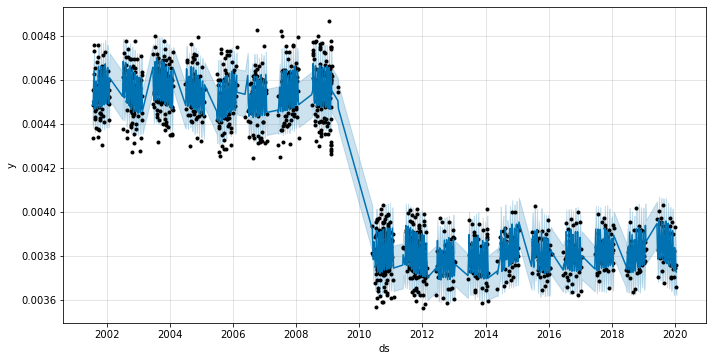

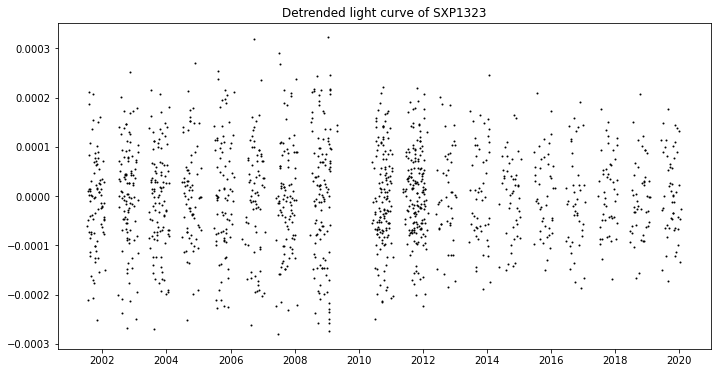

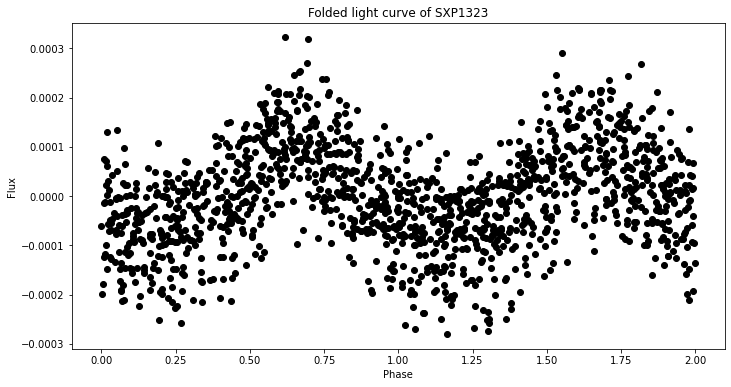

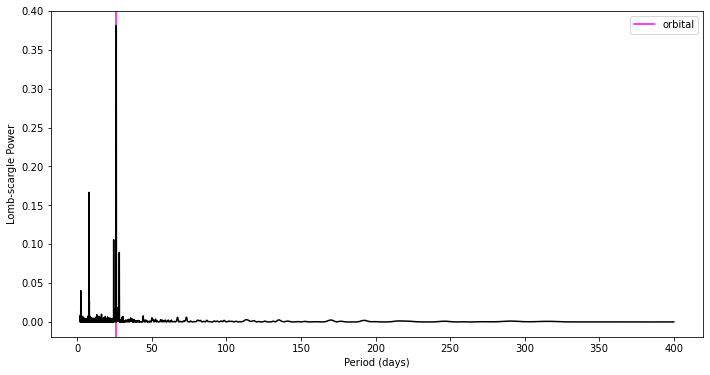

In [3436]:
plt.rcParams['figure.figsize'] = (11.7, 6.0)
f = np.linspace(1/400, 1/2, 10000)*2*np.pi
import scipy.signal as signal


for source_index, source in enumerate([names_period.iloc[38]]):
    if len(source["file"])>0:
        data = np.loadtxt(data_path+"ogle_merged/"+source["file"], delimiter=",", dtype=float)
        #     plt.plot([2455081.5,2455081.5], np.array([np.min(data[:,1]), np.max(data[:,1])])*-1, color="r")
        data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
        
        data_df = pd.DataFrame({"ds": data[:,0],"y": data[:,1]})
        data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
        data_df["y"] = float(2430)*10**(-1.0*data_df["y"]/2.5)

        # fit prophet model with orbital periodicity component
        m = Prophet(
            growth='linear',
            changepoints=None,
            n_changepoints=200,
            changepoint_range=0.99,
            yearly_seasonality=False,
            weekly_seasonality=False,
            daily_seasonality=False,
            holidays=None,
            seasonality_mode='additive',
            seasonality_prior_scale=10.0,
            holidays_prior_scale=10.0,
            changepoint_prior_scale=15,
            mcmc_samples=0,
            interval_width=0.8,
            uncertainty_samples=1000,
            stan_backend=None,
        ) #"07-09-2009"
        m.add_seasonality(name='orbital', period=source["P_orb (d)"], fourier_order=5)
        m.fit(data_df)
        
        forecast = m.predict(pd.DataFrame(data_df["ds"]))
        forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()
        
        # plot data with prophet model
        print("Source: {}".format(source["Object"]) + " prophet model" + " Period: {}".format(source["P_orb (d)"]))
        fig1 = m.plot(forecast)
        fig = plt.gcf()
        fig.set_size_inches(10,5)
        plt.show()
        # plot data with trend subtracted
        detrended = data_df.copy(deep=True)
        detrended["y"] = data_df["y"].values-forecast['trend'].values
        plt.scatter(data_df["ds"].values,detrended["y"], s=1, c="black")
        plt.title("Detrended light curve of {}".format(source["Object"]))
        plt.show()
        
#         data_df["ds"] = pd.to_datetime(data_df["ds"], origin="julian", unit="D")
#         data_df["y"] = float(2430)*10**(-1.0*data[:,1]/2.5)
#         data_df["y"][data_df["ds"]<2455081.5] = data_df["y"][data_df["ds"]<2455081.5]- np.median(data_df["y"][data_df["ds"]<2455081.5])
#         data_df["y"][data_df["ds"]>2455081.5] = data_df["y"][data_df["ds"]>2455081.5]- np.median(data_df["y"][data_df["ds"]>2455081.5])
        
        # fold detrended lightcurve
        foldTimes=(data[:,0]-data[:,0][0])/source["P_orb (d)"]
        foldTimes=foldTimes%2
        plt.scatter(foldTimes, detrended["y"], color="black")
    #     plt.axvline(2455081.5-data[:,0][0], color="r")
#         plt.gca().invert_yaxis()
        #     plt.ylim([10,20])
        plt.xlabel("Phase")
        plt.ylabel("Flux")
        plt.title("Folded light curve of {}".format(source["Object"]))
        # plt.ylim([-17,-13])
        plt.show()
        
        # 

        pgram = signal.lombscargle(data[:,0], detrended["y"].values, f, normalize=True) # angular frequencies
        plt.plot(1/(f/(2*np.pi)), pgram, zorder=2, c="black") # per day frequencies
#         plt.yscale("log")
#         plt.xscale("log")
        plt.xlabel('Period (days)')
        plt.ylabel('Lomb-scargle Power')
        plt.axvline(x=source["P_orb (d)"], zorder=1, c="magenta", label="orbital")
        plt.legend()
        plt.show()
    #     break
    
#     foldTimes=time/period# divide by period to convert to phase
#     foldTimes=foldTimes%1# take fractional part of phase only (i.e. discard whole number part)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  1415
Pseudo sample frequency (median) is  0.492
largest tau window is  4.784
2341.52 seconds has passed to complete Weighted Wavelet Z-transform 



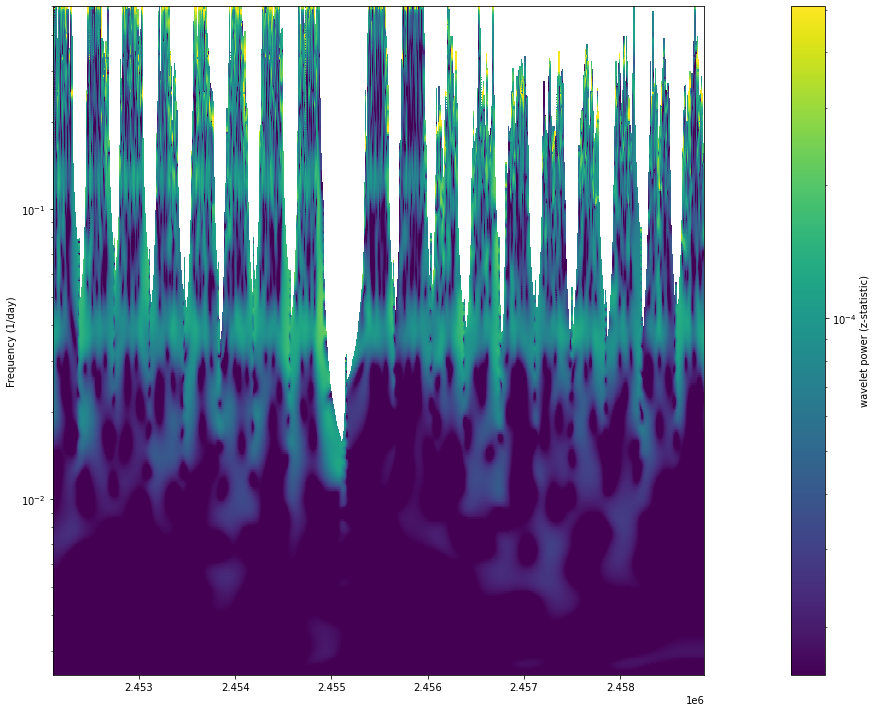

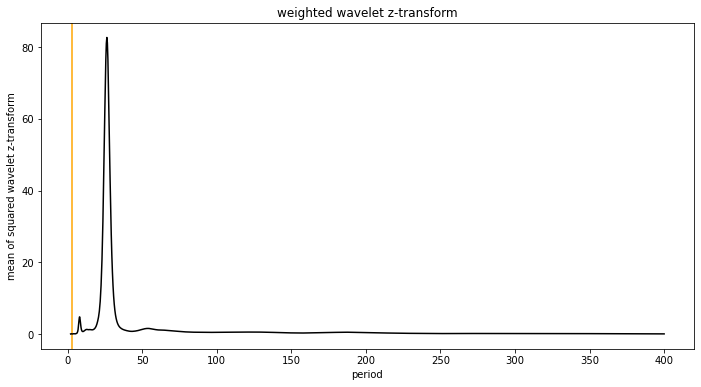

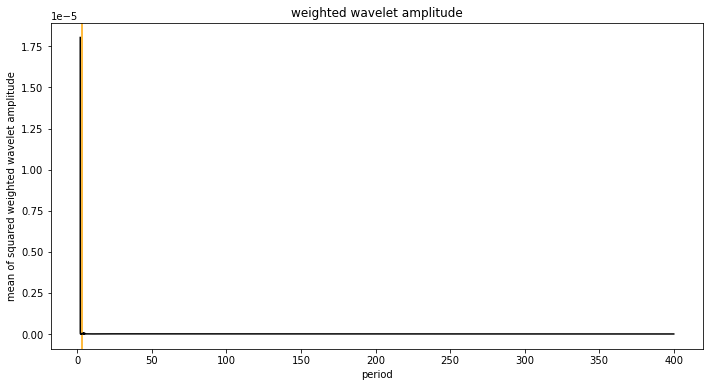

250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise


In [3438]:
# # generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
# x = data[:,0]
# # x = np.linspace(0, 249, num=250)
# period = 3
# f=1/period
# y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

# f = np.linspace(1/400, 1/2, 10000)*np.pi*2
# pgram = signal.lombscargle(x,y, f, normalize=True)
# plt.axvline(x=period, c="orange", zorder=1)

# plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
# plt.xlabel("period")
# plt.ylabel("lomb scargle power")
# plt.title("Orange is the true period")

# plt.show()

x=data[:,0]
y=detrended["y"]


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq_1323 = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq_1323[0],
                       FREQ=wwt_spec_Nyq_1323[1],
                       DATA=wwt_spec_Nyq_1323[3],
                    clip=(np.percentile(wwt_spec_Nyq_1323[3], 50),np.percentile(wwt_spec_Nyq_1323[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec_Nyq_1323[1][0], np.mean(np.abs(wwt_spec_Nyq_1323[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq_1323[1][0], np.mean(np.abs(wwt_spec_Nyq_1323[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

# Timing 

In [3456]:
# generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  250
Pseudo sample frequency (median) is  1.0
largest tau window is  1.0
53.52 seconds has passed to complete Weighted Wavelet Z-transform 



In [3460]:
# generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=False)

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  250
Pseudo sample frequency (median) is  1.0
largest tau window is  1.0
288.31 seconds has passed to complete Weighted Wavelet Z-transform 



In [3457]:
#https://stackoverflow.com/questions/3927628/how-can-i-profile-python-code-line-by-line
import pprofile
profiler = pprofile.Profile()
with profiler:
    wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                         magnitudes=y,
                         time_divisions=ntau,
                         freq_params=frequency_parameters,
                         decay_constant=decay_constant,
                         method='linear',
                         parallel=parallel)
# Process profile content: generate a cachegrind file and send it to user.

# You can also write the result to the console:
profiler.print_stats()

*** Starting Weighted Wavelet Z-transform ***

adjusted time_divisions to:  250
Pseudo sample frequency (median) is  1.0
largest tau window is  1.0
53.82 seconds has passed to complete Weighted Wavelet Z-transform 

Total duration: 53.8238s
File: /home/jkok1g14/anaconda3/envs/py38/lib/python3.8/threading.py
File duration: 53.1987s (98.84%)
Line #|      Hits|         Time| Time per hit|      %|Source code
------+----------+-------------+-------------+-------+-----------
     1|         0|            0|            0|  0.00%|"""Thread module emulating a subset of Java's threading model."""
     2|         0|            0|            0|  0.00%|
     3|         0|            0|            0|  0.00%|import os as _os
     4|         0|            0|            0|  0.00%|import sys as _sys
     5|         0|            0|            0|  0.00%|import _thread
     6|         0|            0|            0|  0.00%|
     7|         0|            0|            0|  0.00%|from time import monotonic as

In [3481]:
from wwz import wwt_Nyquist_c

# generate data for a sine wave observed for 10 years with random noise added
# data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist_c(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

ImportError: Building module wwz failed: ["distutils.errors.CompileError: command 'gcc' failed with exit status 1\n"]

In [ ]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

f = np.linspace(1/400, 1/2, 10000)*np.pi*2
pgram = signal.lombscargle(x,y, f, normalize=True)
plt.axvline(x=period, c="orange", zorder=1)

plt.plot(1/(f/(2.0*np.pi)), pgram, c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("lomb scargle power")
plt.title("Orange is the true period")

plt.show()


# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = 5000 #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/400
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwt_Nyquist(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant,
                     method='linear',
                     parallel=parallel)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])

linear_plotter_log_1(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq[3],
                    clip=(np.percentile(wwt_spec_Nyq[3], 50),np.percentile(wwt_spec_Nyq[3], 99.9)))
plt.locator_params(axis='y', nbins=100)
ax.set_ylabel('Frequency (1/day)')
plt.yscale("log")
plt.axhline(1/period, 2455000, 245200)#.axhline(y=1/period, zorder=1, c="black")


plt.tight_layout()
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[2])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared wavelet z-transform")
plt.title("weighted wavelet z-transform")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()

plt.plot(1/wwt_spec_Nyq[1][0], np.mean(np.abs(wwt_spec_Nyq[3])**2, axis=0), c="black", zorder=2)
plt.xlabel("period")
plt.ylabel("mean of squared weighted wavelet amplitude")
plt.title("weighted wavelet amplitude")
plt.axvline(x=period, c="orange", zorder=1)
plt.show()
print("250 days, 200 data points, 6 period, 500 ntau, 2-125 tested periods, 400 test periods, 1/(8*pi**2) decay, 0 noise")

In [4]:
%load_ext autoreload
%autoreload 2
import cython
import wwz_edited
import plot_methods_edited
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.ticker as ticker
import matplotlib.axes as axes
import matplotlib.colors as colors
from datetime import datetime
data_path = "../data/"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.252
1077.93 seconds has passed to complete Weighted Wavelet Z-transform 



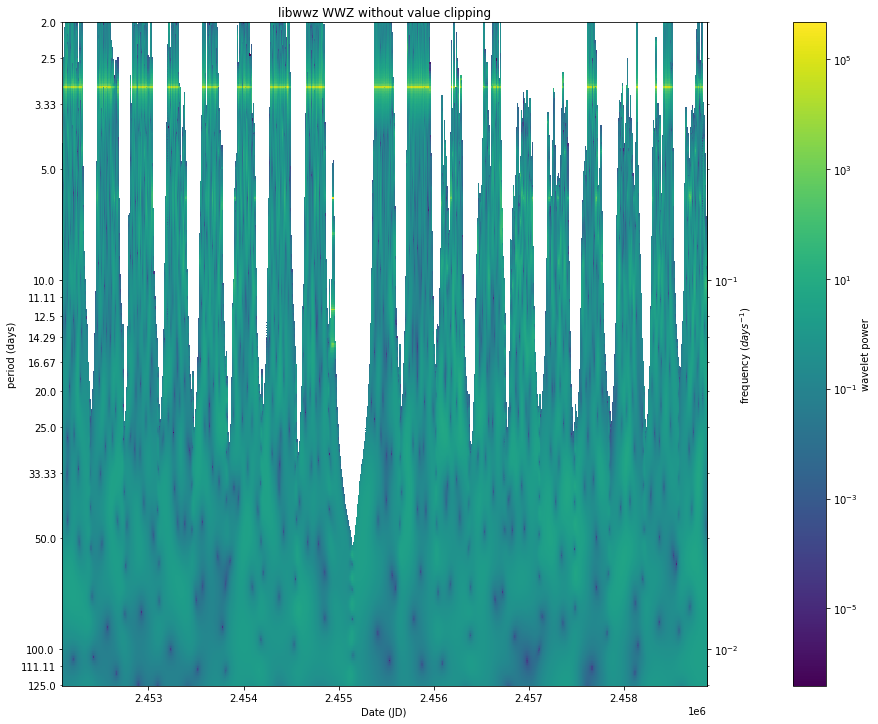

In [8]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = len(x) #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_spec_Nyq = wwz_edited.wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant, parallel=True)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])
plot_methods_edited.log_plotter(ax=ax,
                       TAU=wwt_spec_Nyq[0],
                       FREQ=wwt_spec_Nyq[1],
                       DATA=wwt_spec_Nyq[2],
                    clip=None)#(np.percentile(wwt_spec_Nyq[2], 75),np.percentile(wwt_spec_Nyq[2], 99.9)))
fig.tight_layout()
now = datetime.now()
dt_string = now.strftime("%d-%m-%Y_%H-%M-%S")
plt.title("libwwz WWZ without value clipping")
# plt.savefig('test_images/test_spectrogram_{}.png'.format(dt_string))
plt.show()

In [22]:
%load_ext autoreload
%autoreload 2
import cython
import wwzp
import plot_methods_edited
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.ticker as ticker
import matplotlib.axes as axes
import matplotlib.colors as colors
from datetime import datetime

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.252
103.13 seconds has passed to complete Weighted Wavelet Z-transform 



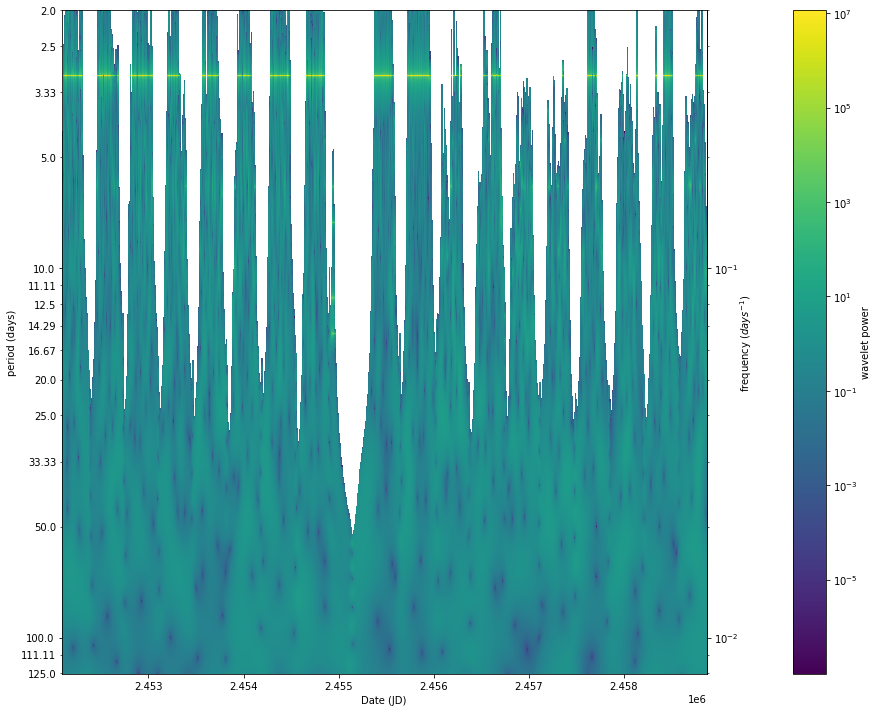

In [25]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = len(x) #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_p = wwzp.wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant, parallel=True)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])
plot_methods_edited.log_plotter(ax=ax,
                       TAU=wwt_p[0],
                       FREQ=wwt_p[1],
                       DATA=wwt_p[2],
                    clip=None)#(np.percentile(wwt_p[2], 75),np.percentile(wwt_p[2], 99.9)))
fig.tight_layout()
now = datetime.now()
dt_string = now.strftime("%d-%m-%Y_%H-%M-%S")
# plt.title("vectorized WWZ without value clipping")
# plt.savefig('test_images/test_spectrogram_{}.png'.format(dt_string))
plt.show()

In [24]:
1077/42.14

25.55766492643569

In [ ]:
# generate data for a sine wave observed for 10 years with random noise added
data = np.loadtxt(data_path+"ogle_merged/sxp327.csv", delimiter=",", dtype=float)
x = data[:,0]
# x = np.linspace(0, 249, num=250)
period = 3
f=1/period
y = np.sin(x*f*np.pi*2)#+np.random.normal(0,0.5,size=len(x))

# Select the size for the newly generated timestamps (tau), it should be less than the length of the given data.
# This will also limit the minimum possible frequecny
ntau = len(x) #(x[-1]-x[0])/4 # no. linear divisions between first and last time stamps of the time series

# Set the low and high frequency bounds and steps to iterate 
frequency_low = 1/125
frequency_high = 1/2
# frequency_steps = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=1000)
# frequency_steps = frequency_steps[1]-frequency_steps[0]

# Set the override to False (Setting to True will ignore the low and high frequency limitations)
override = False

# gather the frequency parameters into a list [freq_low, freq_high, freq_step, override]
frequency_parameters = np.logspace(np.log10(frequency_low), np.log10(frequency_high), num=400)#[frequency_low, frequency_high, frequency_steps, override]

# We will then select the decay constant for our analyzing wavelet (should be < 0.2), where c = 1/(2*w^2) 
# The analyzing wavelet decays significantly in a single cycle 2*pi/w, where w = 2*pi*f

# f = 20     # we choose 4 since our signal of interest is at 4 h
# w = 2 * np.pi * f
# decay_constant = 1/(2*w**2)
decay_constant = 1/(8*np.pi**2)
# Finally, we select to wether to run with parallization (recommend True)
parallel = True


# Using the above settings, we will now compute the WWZ/WWA for the full timeseries and removed timeseries
wwt_p = wwzp.wwt(timestamps=x,
                     magnitudes=y,
                     time_divisions=ntau,
                     freq_params=frequency_parameters,
                     decay_constant=decay_constant, parallel=True)

fig, ax = plt.subplots(nrows=1, sharex=False, figsize=[13, 10])
plot_methods_edited.log_plotter(ax=ax,
                       TAU=wwt_p[0],
                       FREQ=wwt_p[1],
                       DATA=wwt_p[2],
                    clip=None)#(np.percentile(wwt_p[2], 75),np.percentile(wwt_p[2], 99.9)))
fig.tight_layout()
now = datetime.now()
dt_string = now.strftime("%d-%m-%Y_%H-%M-%S")
# plt.title("vectorized WWZ without value clipping")
# plt.savefig('test_images/test_spectrogram_{}.png'.format(dt_string))
plt.show()

*** Starting Weighted Wavelet Z-transform ***

Pseudo sample frequency (median) is  0.5
largest tau window is  4.252


In [1]:
x

NameError: name 'x' is not defined